In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% ! important; }<style>"))

## prepare

In [2]:

import numpy as np
from astropy.io import fits
import matplotlib.pylab as plt
import os

import matplotlib
%matplotlib notebook


from matplotlib import rcParams
import matplotlib as mpl

from matplotlib.ticker import MultipleLocator, FixedLocator
from matplotlib.gridspec import GridSpec

from astropy import units,constants

from astropy.table import Column
from astropy.time import Time

from scipy.interpolate import interp1d
from astropy.table import Table, Column


from scipy.signal import savgol_filter

from scipy.integrate import trapz
import pysynphot as S

from kapteyn import kmpfit

### some functions

In [3]:

def galactic_reddening_NED(target, flt):
    '''
    Get the Galactic Extinction from NED 'http://ned.ipac.caltech.edu/'
    '''

    A_lambda = {'2022jli': {'U': 0.193,
                                'B': 0.161,
                                'V': 0.122,
                                'R': 0.096,
                                'I': 0.067,
                                'u': 0.189,
                                'g': 0.147,
                                'r': 0.102,
                                'i': 0.076,
                                'z': 0.056,
                                'J': 0.032,
                                'H': 0.020,
                                'K': 0.013,
                                'L': 0.007}}

    return A_lambda[target][flt]


def galactic_dereddening_swift_bands(flt, AV, spec_type='BB_10000K'):
    '''

    The value for U B V r i from NED

    For swift bands the extinction are adopted from 
    'http://iopscience.iop.org/0004-637X/721/2/1608/suppdata/apj343574t14_mrt.txt'

    which is a table for R_X, where A_X = R_X*E(B-V) in filter X = W2, M2, W1, U, B, V

    '''

    RX = {'SN_1992A': {'W2': 6.44, 'M2': 8.06, 'W1': 5.45, 'U': 4.91, 'B': 4.16, 'V': 3.16},
          'SN_1994I': {'W2': 6.32, 'M2': 8.30, 'W1': 5.35, 'U': 4.88, 'B': 4.10, 'V': 3.14},
          'SN_1999em': {'W2': 7.63, 'M2': 8.37, 'W1': 6.18, 'U': 5.00, 'B': 4.16, 'V': 3.16},
          'BB_2000K': {'W2': 2.65, 'M2': 4.90, 'W1': 3.33, 'U': 4.65, 'B': 3.92, 'V': 3.09},
          'BB_2200K': {'W2': 2.83, 'M2': 5.32, 'W1': 3.52, 'U': 4.71, 'B': 3.95, 'V': 3.10},
          'BB_2400K': {'W2': 3.03, 'M2': 5.79, 'W1': 3.71, 'U': 4.75, 'B': 3.97, 'V': 3.11},
          'BB_2600K': {'W2': 3.23, 'M2': 6.22, 'W1': 3.91, 'U': 4.79, 'B': 3.98, 'V': 3.11},
          'BB_2800K': {'W2': 3.45, 'M2': 6.58, 'W1': 4.12, 'U': 4.81, 'B': 4.00, 'V': 3.12},
          'BB_3000K': {'W2': 3.70, 'M2': 6.86, 'W1': 4.32, 'U': 4.83, 'B': 4.01, 'V': 3.12},
          'BB_3200K': {'W2': 3.97, 'M2': 7.07, 'W1': 4.53, 'U': 4.85, 'B': 4.02, 'V': 3.13},
          'BB_3400K': {'W2': 4.26, 'M2': 7.25, 'W1': 4.72, 'U': 4.86, 'B': 4.04, 'V': 3.13},
          'BB_3600K': {'W2': 4.57, 'M2': 7.39, 'W1': 4.90, 'U': 4.87, 'B': 4.05, 'V': 3.13},
          'BB_3800K': {'W2': 4.87, 'M2': 7.51, 'W1': 5.07, 'U': 4.88, 'B': 4.06, 'V': 3.13},
          'BB_4000K': {'W2': 5.18, 'M2': 7.61, 'W1': 5.22, 'U': 4.89, 'B': 4.06, 'V': 3.14},
          'BB_4200K': {'W2': 5.47, 'M2': 7.70, 'W1': 5.35, 'U': 4.90, 'B': 4.07, 'V': 3.14},
          'BB_4400K': {'W2': 5.74, 'M2': 7.77, 'W1': 5.48, 'U': 4.91, 'B': 4.08, 'V': 3.14},
          'BB_4600K': {'W2': 6.00, 'M2': 7.84, 'W1': 5.59, 'U': 4.92, 'B': 4.08, 'V': 3.14},
          'BB_4800K': {'W2': 6.23, 'M2': 7.90, 'W1': 5.69, 'U': 4.92, 'B': 4.09, 'V': 3.14},
          'BB_5000K': {'W2': 6.44, 'M2': 7.96, 'W1': 5.78, 'U': 4.93, 'B': 4.10, 'V': 3.15},
          'BB_5200K': {'W2': 6.63, 'M2': 8.01, 'W1': 5.86, 'U': 4.93, 'B': 4.10, 'V': 3.15},
          'BB_5600K': {'W2': 6.95, 'M2': 8.09, 'W1': 6.00, 'U': 4.94, 'B': 4.11, 'V': 3.15},
          'BB_6000K': {'W2': 7.21, 'M2': 8.17, 'W1': 6.12, 'U': 4.95, 'B': 4.12, 'V': 3.15},
          'BB_6600K': {'W2': 7.50, 'M2': 8.25, 'W1': 6.27, 'U': 4.96, 'B': 4.13, 'V': 3.15},
          'BB_7000K': {'W2': 7.64, 'M2': 8.30, 'W1': 6.35, 'U': 4.97, 'B': 4.13, 'V': 3.15},
          'BB_8000K': {'W2': 7.89, 'M2': 8.40, 'W1': 6.52, 'U': 4.98, 'B': 4.14, 'V': 3.16},
          'BB_9000K': {'W2': 8.05, 'M2': 8.47, 'W1': 6.64, 'U': 4.99, 'B': 4.15, 'V': 3.16},
          'BB_10000K': {'W2': 8.14, 'M2': 8.53, 'W1': 6.74, 'U': 5.00, 'B': 4.16, 'V': 3.16},
          'BB_12000K': {'W2': 8.25, 'M2': 8.60, 'W1': 6.89, 'U': 5.01, 'B': 4.17, 'V': 3.16},
          'BB_13000K': {'W2': 8.27, 'M2': 8.63, 'W1': 6.94, 'U': 5.01, 'B': 4.17, 'V': 3.17},
          'BB_14000K': {'W2': 8.29, 'M2': 8.65, 'W1': 6.99, 'U': 5.01, 'B': 4.18, 'V': 3.17},
          'BB_15000K': {'W2': 8.31, 'M2': 8.67, 'W1': 7.03, 'U': 5.02, 'B': 4.18, 'V': 3.17},
          'BB_20000K': {'W2': 8.33, 'M2': 8.73, 'W1': 7.17, 'U': 5.03, 'B': 4.19, 'V': 3.17},
          'BB_25000K': {'W2': 8.33, 'M2': 8.76, 'W1': 7.25, 'U': 5.03, 'B': 4.19, 'V': 3.17},
          'BB_30000K': {'W2': 8.33, 'M2': 8.78, 'W1': 7.30, 'U': 5.04, 'B': 4.20, 'V': 3.17},
          'BB_35000K': {'W2': 8.33, 'M2': 8.79, 'W1': 7.33, 'U': 5.04, 'B': 4.20, 'V': 3.17}}

    A_X_mag = AV/RX[spec_type]['V']*RX[spec_type][flt]

    return A_X_mag


def Vega_AB_mag_convertion(mag, flt, mode, direction='Vega2AB'):
    '''
    transform the magnitude from vega system to AB magnitude system

    For mode == 'Swift', ref to "http://swift.gsfc.nasa.gov/analysis/uvot_digest/zeropts.html"

    For mode == 'Bessell', refer to 'http://www.astronomy.ohio-state.edu/~martini/usefuldata.html'
    These data are mostly from Blanton et al. (2007)


    INPUT:
    mode: 'Swift' or 'Bessell'
    direction: 'Vega2AB' or 'AB2Vega'

    '''

    if mode not in ['Swift', 'Bessell']:
        raise IOError('Only Swift and Bessell bands are supported now!')

    # Values for m_AB - m_Vega
    offset_dict = {'Swift': {'V': -0.01,
                             'B': -0.13,
                             'U': +1.02,
                             'W1': +1.51,
                             'M2': +1.69,
                             'W2': +1.73,
                             'White': +0.80},
                   'Bessell': {'U': +0.79,
                               'B': -0.09,
                               'V': +0.02,
                               'R': +0.21,
                               'I': +0.45,
                               'J': +0.91,
                               'H': +1.39,
                               'K': +1.85,
                               'u': +0.91,
                               'g': -0.08,
                               'r': +0.16,
                               'i': +0.37,
                               'z': +0.54,
                               'Y': +0.634}}
    if direction == 'Vega2AB':
        mag_new = mag + offset_dict[mode][flt]
    elif direction == 'AB2Vega':
        mag_new = mag - offset_dict[mode][flt]
    else:
        raise IOError('directions Vega2AB or AB2Vega are supported!')

    return mag_new


def mag2flux(mag, flt=None, bp_mp=None, mode='wavelength', I_unit='cgs', wavelength_units='Angstroms'):
    '''
    convert magnitude in AB system into flux

    if 'I_unit' == 'Jy' then F_nu in Jy unit; 
    if 'I_unit' == 'cgs' then F_nu in  unit of erg/s/cm^2/Hz; 

    F_lambda is in unit of erg/s/cm^2/A
    '''
    f0_nu = 3631  # Jy
    if flt is None and bp_mp is None:
        raise ValueError('no input of wavelength')

    if mode == 'frequency':
        f0 = f0_nu*1e-23  # frequence F_\nu = 3631 Jy and 1 Jy = 10^-23 erg/s/cm^2/Hz
    elif mode == 'wavelength':

        if bp_mp is None:
            bp_mp = get_weff(flt)

        f0_lambda = f0_nu / (3.34*10**4*bp_mp**2)  # erg/s/cm^2/A
        f0 = f0_lambda
    else:
        raise IOError(
            'unrecognized mode for experssion of zero point of flux!')

    if bp_mp is None:
        lam = get_weff(flt)
    else:
        lam = bp_mp

    flux = f0*10**(-0.4*mag)

    return lam, flux


def get_weff(flt):
    lambda_eff_dict = {'W2': 2030.5,
                       'M2': 2228.1,
                       'W1': 2589.1,
                       'UVOT_U': 3501.2,
                       'UVOT_B': 4328.6,
                       'UVOT_V': 5402.1,
                       'U': 3462.8,
                       'B': 4379.7,
                       'R': 6400,
                       'I': 7900,
                       'J': 12600,
                       'H': 16000,
                       'K': 22200,
                       'u': 3608,
                       'g': 5200,
                       'V': 5485.1,
                       'r': 6169.5,
                       'i': 7496.6,
                       'z': 9100,
                       'G': 5822,
                        'c':5182.4,
                        'o':6630,
                       'unit': 'Angstroms'}

    return lambda_eff_dict[flt]


def flux2mag(flux, flt, bp_mp=None,  mode='wavelength', I_unit='cgs', wavelength_units='Angstroms'):
    '''
    convert magnitude in AB system into flux

    if 'I_unit' == 'Jy' then F_nu in Jy unit; 
    if 'I_unit' == 'cgs' then F_nu in  unit of erg/s/cm^2/Hz; 

    F_lambda is in unit of erg/s/cm^2/A
    '''
    f0_nu = 3631  # Jy

    if mode == 'frequency':
        f0 = f0_nu*1e-23  # frequence F_\nu = 3631 Jy and 1 Jy = 10^-23 erg/s/cm^2/Hz
    elif mode == 'wavelength':
        if bp_mp is None:
            bp_mp = get_weff(flt)
        f0_lambda = f0_nu / (3.34*10**4*bp_mp**2)  # erg/s/cm^2/A
        f0 = f0_lambda
    else:
        raise IOError(
            'unrecognized mode for experssion of zero point of flux!')

    mag = -2.5*np.log10(flux/f0)

    return mag


unitdict = {'cgs': {'h': 6.626068e-27,
                    'k': 1.3806503e-16,
                    'c': 2.99792458e10,
                    'mh': 1.67262158e-24 * 1.00794,
                    'length': 'cm'},
            'mks': {'h': 6.626068e-34,
                    'k': 1.3806503e-23,
                    'c': 2.99792458e8,
                    'mh': 1.67262158e-27 * 1.00794,
                    'length': 'm'}
            }

wavelength_dict = {'meters': 1.0, 'm': 1.0,
                   'centimeters': 1e-2, 'cm': 1e-2,
                   'millimeters': 1e-3, 'mm': 1e-3,
                   'nanometers': 1e-9, 'nm': 1e-9,
                   'micrometers': 1e-6, 'micron': 1e-6, 'microns': 1e-6, 'um': 1e-6,
                   'kilometers': 1e3, 'km': 1e3,
                   'angstroms': 1e-10, 'A': 1e-10, 'Angstroms': 1e-10,
                   }


def blackbody_wavelength(lam, temperature, scale=1.0, units='cgs', wavelength_units='Angstroms', normalize=max, beta=0):
    '''
    INPUTS:
            lam:
            temperature:

    '''
    # load constants in desired units
    h, k, c = unitdict[units]['h'], unitdict[units]['k'], unitdict[units]['c']

    # converta lambd to cm/m
    lam = lam * wavelength_dict[wavelength_units] / \
        (1e-2 if units == 'cgs' else 1)

    I = 2*h*c**2 / lam**5 * (exp(h*c/(k*temperature*lam)) - 1)**-1

    if normalize and hasattr(I, '__len__'):
        if len(I) > 1:
            return I/normalize(I) * scale
        else:
            return I * scale
    else:
        return I * scale


def BB_angs_cgs(p, x):
    '''
    input wavelength in angstrom and temperaute in K
    the output intensity density in erg/s/cm^2/A/sr
    '''
    scale, T = p
    h, k, c = unitdict['cgs']['h'], unitdict['cgs']['k'], unitdict['cgs']['c']
    x = x*1e-8
    I = 2*h*c**2 / x**5 * (np.exp(h*c/(k*T*x)) - 1)**-1
    return scale*I*1e-8 # without *1e-8 the unit is erg/s/cm^2/cm/sr
    
def BB_residual(p, data):
    x, y, yerr = data
    model = BB_angs_cgs(p, x)
    return (y-model)/yerr




def fit_blackbody_kmpfit(x, y, yerr, params0 = None):
    '''
    blackbody fitting 
    '''
    
    fitdata = [x, y, yerr]

    if params0 is None:
        T0 = 10000
        ys0 = BB_angs_cgs([1, T0], x)
        scale0 = np.mean(y)/np.mean(ys0)
        params0 = [scale0, T0]
    print(params0)
    
    fitobj = kmpfit.Fitter(residuals=BB_residual, data=fitdata)

    fitobj.fit(params0=params0)

    return fitobj


def fit_blackbody_lmfit(xdata, flux, guesses=(0, 0), err=None, blackbody_function=blackbody_wavelength, quiet=True, **kwargs):
    """
    Parameters
    ----------
    xdata : array
        Array of the X-values (frequency, wavelength) of the data
    flux : array
        The fluxes corresponding to the xdata values
    guesses : (Temperature,Scale) or (Temperature,Beta,Scale)
        The input guesses.  3 parameters are used for greybody
        fitting, two for temperature fitting.
    blackbody_function: function
        Must take x-axis (e.g. frequency), temperature, scale, and then
        optionally beta args
    quiet : bool
        quiet flag passed to mpfit

    kwargs are past to blackbody function

    Examples
    --------
    >>> wavelength = np.array([20,70,160,250,350,500,850,1100])
    >>> flux = modified_blackbody_wavelength(wavelength, 15, beta=1.75,
            wavelength_units='microns', normalize=False, logN=22, logscale=16)
    >>> err = 0.1 * flux
    >>> flux += np.random.randn(len(wavelength)) * err
    >>> tguess, bguess, nguess = 20.,2.,21.5
    >>> lm = fit_blackbody_lmfit(wavelength, flux, err=err,
             blackbody_function=modified_blackbody_wavelength, logscale=16,
             guesses=(tguess,bguess,nguess),
             wavelength_units='microns')
    >>> print lm.params

    >>> # If you want to fit for a fixed beta, do this:
    >>> parameters = lmfit.Parameters(OrderedDict([ (n,lmfit.Parameter(x)) for n,x
            in zip(('T','beta','N'),(20.,2.,21.5)) ]))
    >>> import lmfit
    >>> parameters['beta'].vary = False
    >>> lm = fit_blackbody_lmfit(wavelength, flux, err=err,
             blackbody_function=modified_blackbody_wavelength, logscale=16,
             guesses=parameters,
             wavelength_units='microns')
    >>> print lm.params
    """

    def lmfitfun(x, y, err):
        if err is None:
            def f(p): return (y-blackbody_function(x, *
                                                   [p[par].value for par in p], normalize=False, **kwargs))
        else:
            def f(p): return (y-blackbody_function(x, *
                                                   [p[par].value for par in p], normalize=False, **kwargs))/err
        return f

    if not isinstance(guesses, lmfit.Parameters):
        guesspars = lmfit.Parameters(OrderedDict([(n, lmfit.Parameter(
            value=x, name=n)) for n, x in zip(('T', 'beta', 'N'), guesses)]))
    else:
        guesspars = guesses

    minimizer = lmfit.minimize(lmfitfun(xdata, np.array(flux), err),
                               guesspars)

    return minimizer


def read_and_prepare_mags(data, flts):
    '''
    Read data into data dictionary 
    'data' format: JD mag1 magerr1 mag2 magerr2 mag3 magerr3 mag4 magerr4...
    flts =[flt1 flt2 flt3 flt4 ...]
    '''

    data_dict = {}
    data_err_dict = {}

    for i, flt in enumerate(flts):

        data_dict[flt] = data[2*i+1]
        data_err_dict[flt] = data[2*i+2]

    return data_dict, data_err_dict


def get_SED_AB_mag(sed_input_data, target_name=None, A_V=None, correct_gal_extinction=False):
    '''
    INPUTS:
            sed_input_data: if file, it should have the following format

                    #flt    mag    magerr    sys
                     B      13.5   0.04      Vega
                     g      14.5   0.03      AB
                     r      14.0   0.00      AB
            otherwise, it should be a table as read from the above file
    '''

    lambda_eff_dict = {'W2': 2056.6,
                       'M2': 2246.4,
                       'W1': 2581.0,
                       'U': 3462.8,
                       'B': 4379.7,
                       'V': 5485.1,
                       'R': 6400,
                       'I': 7900,
                       'J': 12600,
                       'H': 16000,
                       'K': 22200,
                       'u': 3608,
                       'g': 5200,
                       'r': 6169.5,
                       'i': 7496.6,
                       'z': 9100,
                        'G':5822,
                        'c':5182.4,
                        'o':6630}
    
    if type(sed_input_data) is str and os.path.isfile(sed_input_data):
        data = Table.read(sed_input_data, format='ascii')
    else:
        data = sed_input_data.copy()

    flts = []
    lams = []
    mags = []
    magerrs = []
    
    swift_flts = ['W1', 'M2', 'W2']

    for fltdata in data:
        flt = fltdata['flt']
        if flt in ['UVW1', 'UVM2', 'UVW2']:
            flt  = flt[2:4]
        flts.append(flt)
        lams.append(lambda_eff_dict[flt])
        magsys = fltdata['sys']
        mag = fltdata['mag']

        if correct_gal_extinction:
            if flt in swift_flts:
                if A_V is None:
                    A_V = galactic_reddening_NED(target_name, 'V')
                A_mag = galactic_dereddening_swift_bands(flt, A_V, spec_type='BB_10000K')
                mag = mag - A_mag
            else:
                if target_name is not None:
                    try:
                        A_mag = galactic_reddening_NED(target_name, flt)
                        mag = mag - A_mag
                    except:
                        print(
                            "extinction for %s not implemented in bolometric_toolkit.py yet" % target_name)

        magerr = fltdata['magerr']

        if magsys == 'AB':
            mags.append(mag)
            magerrs.append(magerr)
        else:
            if flt in swift_flts:
                mag_AB = Vega_AB_mag_convertion(
                    mag, flt, 'Swift', direction='Vega2AB')
            else:
                mag_AB = Vega_AB_mag_convertion(
                    mag, flt, 'Bessell', direction='Vega2AB')
            mags.append(mag_AB)
            magerrs.append(magerr)

    output_data = [flts, lams, mags, magerrs]
    output_table = Table(output_data, names=('flt', 'lam', 'mag', 'magerr'))

    return output_table




def get_SED_flux(sed_mags_table, waveeff_dict=None,  target_name=None):
    '''
    INPUTS:
            sed_mags_table:

    '''
    lams = []
    fluxs = []
    fluxerrs = []

    for fltdata in sed_mags_table:
        flt = fltdata['flt']
        mag = fltdata['mag']
        magerr = fltdata['magerr']

        if (waveeff_dict is not None) and (flt in waveeff_dict.keys()):
            bp_mp = waveeff_dict[flt]
        else:
            bp_mp = None

        lamb, flux = mag2flux(mag, flt, bp_mp=bp_mp, mode='wavelength', I_unit='cgs', wavelength_units='Angstroms')
        lamb, flux_upper = mag2flux(mag-magerr, flt, bp_mp=bp_mp, mode='wavelength', I_unit='cgs', wavelength_units='Angstroms')
        fluxerr = flux_upper - flux

        lams.append(lamb)
        fluxs.append(flux)
        fluxerrs.append(fluxerr)

    output_data = [lams, fluxs, fluxerrs]
    output_table = Table(output_data, names=('lam', 'flux', 'fluxerr'))

    return output_table


def spectrum_flux_calibrate(specdata, filter_curves, calflts, cal_abmags, polyorder=1, display=0, nircal=0, verbose=0):
    '''
    specdata:
    filter_curves: a dictionary with keyword as the filter name and value as the filter response curve data
    calflts: a list of filter in which the photometry is available to calibrate the spectrum 
    cal_abmags: AB magnitudes measurements for the input spectrum; in table format with columns of filter, mag, and magerr 
    '''
    specwave = specdata[:,0]
    specflux = specdata[:,1]
    
    synwaves = []
    synfluxs = []
    obswaves = []
    obsfluxs = []

    for flt in calflts:
        synwave, synflux, synmag = mag_flux_from_spec_bandpass(flt, specwave, specflux, filter_curves[flt][:, 0], filter_curves[flt][:, 1], fill_mode=1, display=False, verbose=verbose)
        synwaves.append(synwave)
        synfluxs.append(synflux)
        lamtemp, obsflux = mag2flux(cal_abmags[cal_abmags['flt'] == flt]['mag'].data[0], bp_mp=synwave)
        obsfluxs.append(obsflux)

    factors = np.array(obsfluxs)/np.array(synfluxs)        
    polyobj = polyfit(np.array(synwaves), factors, np.ones(len(factors))*0.05, polyorder)
    polyfunc = polyfunctions(polyorder)
    
    
    if display:
        fig, (ax0, ax, ax2) = plt.subplots(3, 1, figsize=(16, 8), sharex=True)
        ax.plot(specdata[:, 0], specdata[:, 1])

        if not nircal:
            for flt in filter_curves.keys():
                #print(flt)
                if flt[:-1] == 'ztf':
                    color = 'k'
                elif flt[:-1] == 'lcogt':
                    color = 'c'
                elif flt[:-1] == 'lt':
                    color = 'm'
                elif flt[:-1] == 'sdss':
                    color = 'b'
                else:
                    color = 'g'
                ax0.plot(filter_curves[flt][:, 0], filter_curves[flt][:, 1], color=color)     
                
            ax2.plot(np.linspace(3400, 9700,  200), polyfunc(polyobj.params, np.linspace(3400, 9700,  200)))
            ax.set_xlim(2500, 11000)
        else:
            ax0.plot(filter_curves['J'][:, 0], filter_curves['J'][:, 1], color='r')    
            ax2.plot(np.linspace(9500, 20000,  200), polyfunc(polyobj.params, np.linspace(3400, 9700,  200)))
            ax.set_xlim(9000, 21000)                
            
        ax.plot(synwaves, synfluxs, 'yo', label='syn mag')
        ax.plot(synwaves, obsfluxs, 'go', label='phot obs mag')
        ax2.plot(synwaves, factors, 'ko')

        
        ax.legend(loc=0)

        for flt, wave, factor in zip(calflts, synwaves, factors):
            ax2.text(wave, factor, flt)

        #ax2.set_ylim([0.5, 2.5])
        ax2.grid()
        
    return polyfunc, polyobj





def mag_flux_from_spec_bandpass(flt, spec_wave, spec_flux, bp_wave, bp_resp, fill_mode = 0, display=False, verbose=True):
    ''' 
    first calculate pivot wavelength, then calculate integrant flux
    
    INPUTS:
        fill_mode: 0 --> fill_value = 0; -1 --> fill_value = spec_flux[0]; 1 --> fill_value = spec_flux[-1]  #assuming the flux is sorted to wavelength
    '''

    if fill_mode == 0:
        fill_value = 0
    elif fill_mode == -1:
        fill_value = spec_flux[0]
    elif fill_mode == 1:
        fill_value = spec_flux[-1]
    else:
        raise ValueError('fill_mode=%s not supported'%fill_mode)
        
    spec_interp = interp1d(spec_wave, spec_flux, bounds_error=False, fill_value=fill_value)
    pivot_wave = np.sqrt(trapz(bp_resp*bp_wave, x=bp_wave) /
                         trapz(bp_resp/bp_wave, x=bp_wave))
    flux_interg = trapz(bp_wave*bp_resp*spec_interp(bp_wave),
                        x=bp_wave)/trapz(bp_wave*bp_resp, x=bp_wave)
    mag = flux2mag(flux_interg, flt, bp_mp=pivot_wave)
    if verbose:
        print("flux %s at %s A ---> magnitude %s" %
              (flux_interg, pivot_wave, mag))

    return pivot_wave, flux_interg, mag

def spectrum_extinction_effect(wave, flux, EBV, extmodel='gal3', compare_display=False):
    ''' 
    apply or remove the effects of interstellar reddening on a source spectrum using Extinction provided bypysynphot. 

    INPUTS:
            wave: spectrum wavelength
            flux: spectrum flux
            EBV: extinction is defined R(V) = A(V)/E(B-V); negative value effectively dereddens the spectrum
            extmodel: extinction model, see here for details http://pysynphot.readthedocs.io/en/latest/spectrum.html

    '''
    sp = S.ArraySpectrum(wave=wave, flux=flux,
                         waveunits='angstrom', fluxunits='flam', keepneg=True)
    sp_deext = sp*S.Extinction(EBV, extmodel)

    wave_out = sp_deext.wave
    flux_out = sp_deext.flux

    if compare_display:
        plt.plot(sp.wave, sp.flux)
        plt.plot(sp_deext.wave, sp_deext.flux)
        plt.show()

    mask = np.logical_and(wave_out >= np.min(wave), wave_out <= np.max(wave))

    return wave_out[mask], flux_out[mask]




from kapteyn import kmpfit


def poly0(p, x):
    return np.ones(len(x))*p


def resd_poly0(p, data):
    x,y,yerr = data
    model = poly0(p, x)
    return (y-model)/yerr

def poly1(p, x):
    a0, a1 = p
    return a0+a1*x


def resd_poly1(p, data):
    x, y, yerr = data
    model = poly1(p, x)
    return (y-model)/yerr

def poly2(p, x):
    a0, a1, a2 = p
    return a0+a1*x+a2*x**2


def resd_poly2(p, data):
    x, y, yerr = data
    model = poly2(p, x)
    return (y-model)/yerr

def poly3(p, x):
    a0, a1, a2, a3 = p
    return a0+a1*x+a2*x**2+a3*x**3


def resd_poly3(p, data):
    x, y, yerr = data
    model = poly3(p, x)
    return (y-model)/yerr

def poly4(p, x):
    a0, a1, a2, a3, a4 = p
    return a0+a1*x+a2*x**2+a3*x**3+a4*x**4


def resd_poly4(p, data):
    x, y, yerr = data
    model = poly4(p, x)
    return (y-model)/yerr

def poly5(p, x):
    a0, a1, a2, a3, a4, a5 = p
    return a0+a1*x+a2*x**2+a3*x**3+a4*x**4+a5*x**5


def resd_poly5(p, data):
    x, y, yerr = data
    model = poly5(p, x)
    return (y-model)/yerr

def polyfunctions(polyorder):
    
    if polyorder == 0:
        return poly0
    elif polyorder ==1:
        return poly1
    elif polyorder ==2:
        return poly2
    elif polyorder == 3:
        return poly3
    elif polyorder == 4:
        return poly4
    elif polyorder == 5:
        return poly5
    else:
        raise ValueError('input poly order not supported')



def polyfit(x, y, yerr, polyorder, params0=None):

    fitdata = [x, y, yerr]
    if polyorder not in [0,1, 2, 3, 4, 5]:
        raise ValueError("the polynomial orders options: 1, 2,3,4,5")
    else:
        if polyorder == 0:
            resd_poly = resd_poly0
            polymodel = poly0
            if params0 is None:
                params0 = [0]
        if polyorder == 1:
            resd_poly = resd_poly1
            polymodel = poly1
            if params0 is None:
                params0 = [1, 0]                
        if polyorder == 2:
            resd_poly = resd_poly2
            polymodel = poly2
            if params0 is None:
                params0 = [1, 0, 0]            
        if polyorder == 3:
            resd_poly = resd_poly3
            polymodel = poly3
            if params0 is None:
                params0 = [1, 0, 0, 0]
        if polyorder == 4:
            resd_poly = resd_poly4
            polymodel = poly4
            if params0 is None:
                params0 = [1, 0, 0, 0, 0]
        if polyorder == 5:
            resd_poly = resd_poly5
            polymodel = poly5
            if params0 is None:
                params0 = [1, 0, 0, 0, 0, 0]

    fitobj = kmpfit.Fitter(residuals=resd_poly, data=fitdata)

    # print "Input fit data: "
    # print fitdata
    fitobj.fit(params0=params0)

    return fitobj



def wavelength_convert_air_vacuum(lambda1, verbose=1):
	'''
	lambda_air = lambda_vac / n; where n is tmospheric refractivity

	n = 1 + 6.4328e-5 + (2.94981e6)/(1.46e10-sigma**2) + (2.5540e4)/(4.1e9-sigma**2); (old) where sigma is wave number

	n = 1 + 8.34213e-5 + (2.406030e6)/(1.30e10-sigma**2) + (1.5997e4)/(3.89e9-sigma**2)

	'''
	
	sigma = 1.0/lambda1*1e8

	#n = 1 + 6.4328e-5 + (2.94981e6)/(1.46e10-sigma**2) + (2.5540e4)/(4.1e9-sigma**2)
	n = 1 + 8.34213e-5 + (2.406030e6)/(1.30e10-sigma**2) + (1.5997e4)/(3.89e9-sigma**2)

	lambda2 = lambda1/n

	if verbose:
		print ("The atmospheric refractivity at %s angstrom is %s"%(lambda1, n))

	return lambda2

telluriclines2= np.loadtxt('/Users/chenping/SNeData/Ping_collections/Telluric/telluric_example.dat')  #wavelength in vacuum 
print(telluriclines2.shape)
tellsmooth2 = savgol_filter(telluriclines2[:,1], 151, 3)
print(tellsmooth2.shape)
tell2_wave_air = wavelength_convert_air_vacuum(telluriclines2[:,0], verbose=0) #wavelength convertion to air 

### filter curve response

In [6]:
filter_curves = {}

uvotu = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SWIFT_UVOT/Swift_UVOT.U.dat')
uvotb = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SWIFT_UVOT/Swift_UVOT.B.dat')
uvotv = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SWIFT_UVOT/Swift_UVOT.V.dat')
uvm2  = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SWIFT_UVOT/Swift_UVOT.UVM2.dat')
uvw1  = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SWIFT_UVOT/Swift_UVOT.UVW1.dat')
uvw2  = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SWIFT_UVOT/Swift_UVOT.UVW2.dat')

lcogtu = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/lco_filter_curves/SDSS.up.lambA.txt')
lcogtB = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/lco_filter_curves/bssl-bx-004.lambA.txt')
lcogtV = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/lco_filter_curves/bssl-vx-022.lambA.txt')
lcogtg = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/lco_filter_curves/SDSS.gp.lambA.txt')
lcogtr = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/lco_filter_curves/SDSS.rp.lambA.txt')
lcogti = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/lco_filter_curves/SDSS.ip.lambA.txt')

sdssu = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SDSS/SLOAN_SDSS.u.dat')
sdssg = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SDSS/SLOAN_SDSS.g.dat')
sdssr = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SDSS/SLOAN_SDSS.r.dat')
sdssi = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SDSS/SLOAN_SDSS.i.dat')
sdssz = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/SDSS/SLOAN_SDSS.z.dat')

ltu = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/LT_filters/from_svo/Liverpool_IOO.SDSS-u.dat')
ltg = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/LT_filters/from_svo/Liverpool_IOO.SDSS-g.dat')
ltr = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/LT_filters/from_svo/Liverpool_IOO.SDSS-r.dat')
lti = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/LT_filters/from_svo/Liverpool_IOO.SDSS-i.dat')
ltz = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/LT_filters/from_svo/Liverpool_IOO.SDSS-z.dat')
ltB = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/LT_filters/from_svo/Liverpool_IOO.B.dat')
ltV = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/LT_filters/from_svo/Liverpool_IOO.V.dat')

gaiaG = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/Gaia/Gaia3/GAIA_GAIA3.G.dat')
atlaso = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/ATLAS_survey/Misc_Atlas.orange.dat')
atlasc = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/ATLAS_survey/Misc_Atlas.cyan.dat')
efoscV = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/NTT_EFOSC/LaSilla_EFOSC.ESO641.dat')
JohnsonR = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/Generic/Johnson/Generic_Johnson.R.dat')


ztfg = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/Palomar/ZTF/Palomar_ZTF.g.dat')
ztfr = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/Palomar/ZTF/Palomar_ZTF.r.dat')
ztfi = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/Palomar/ZTF/Palomar_ZTF.i.dat')
sofiJ = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/NTT_SOFI/J.dat')
sofiH = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/NTT_SOFI/H.dat')
sofiKs = np.loadtxt('/Users/chenping/SNeData/Ping_collections/filter_curves/NTT_SOFI/Ks.dat')
sofiJ[:,0] = sofiJ[:,0]*10000
sofiH[:,0] = sofiH[:,0]*10000
sofiKs[:,0] = sofiKs[:,0]*10000

filter_curves['uvotu'] = uvotu
filter_curves['uvotb'] = uvotb
filter_curves['uvotv'] = uvotv
filter_curves['uvotw1']= uvw1
filter_curves['uvotw2']= uvw2
filter_curves['uvotm2']= uvm2

filter_curves['lcogtu'] = lcogtu
filter_curves['lcogtB'] = lcogtB
filter_curves['lcogtV'] = lcogtV
filter_curves['lcogtg'] = lcogtg
filter_curves['lcogtr'] = lcogtr
filter_curves['lcogti'] = lcogti

filter_curves['u'] = sdssu
filter_curves['B'] = uvotb
filter_curves['V'] = uvotv
filter_curves['g'] = ztfg
filter_curves['r'] = ztfr
filter_curves['i'] = ztfi
filter_curves['z'] = ltz

filter_curves['ztfg'] = ztfg
filter_curves['ztfr'] = ztfr
filter_curves['ztfi'] = ztfi

filter_curves['ltu'] = ltu
filter_curves['ltg'] = ltg
filter_curves['ltr'] = ltr
filter_curves['lti'] = lti
filter_curves['ltz'] = ltz


filter_curves['sdssu'] = sdssu
filter_curves['sdssg'] = sdssg
filter_curves['sdssr'] = sdssr
filter_curves['sdssi'] = sdssi
filter_curves['sdssz'] = sdssz

filter_curves['J'] = sofiJ
filter_curves['H'] = sofiH
filter_curves['Ks'] = sofiKs

filter_curves['G'] = gaiaG
filter_curves['R'] = JohnsonR
filter_curves['c'] = atlasc
filter_curves['o'] = atlaso
filter_curves['efoscV'] = efoscV

## collect spec data

In [459]:
specs_22jli = {}


In [9]:
t0_22jli = 2459704.67 # discovery time 2022-05-05T04:04:48.00 by Libert Monard see https://www.wis-tns.org/object/2022jli
tmaxg_22jli = 2459700  #abitrary def used for phase of light curve data

z_22jli = 0.0055
EBV_host = 0.25
EBV_mw = 0.039
EBV = EBV_host + EBV_mw#total EBV, MW+host 

## public spectra


In [462]:
jd = Time('2022-05-11T03:27:00', format='isot').jd 
print(jd)
phase = jd-t0_22jli
print(phase) 
specs_22jli['psh0511'] = {'phase':phase,'jd': jd,  'instrument':'other', 'telescope':'other', 'specfile':'../data/spectra/tns/tns_2022jli_2022-05-11_03-27-00_Other_Other_PSH.dat', "exptime":999}

specdata = np.loadtxt(specs_22jli['psh0511']['specfile'])
specs_22jli['psh0511']['spec'] = specdata


2459710.64375
5.973749999888241


<IPython.core.display.Javascript object>


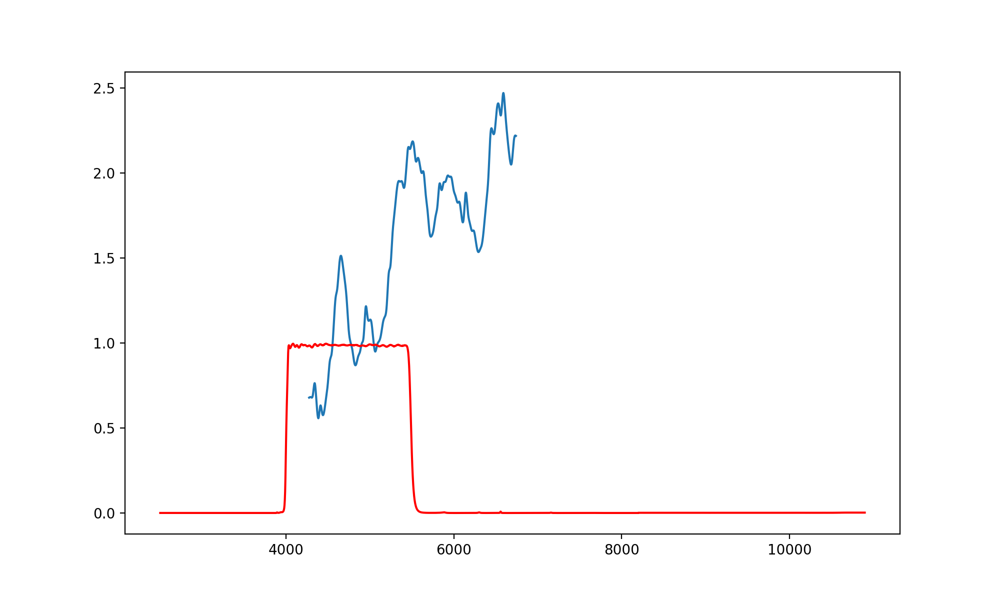

In [12]:
fig, ax = plt.subplots(figsize=(10,6))

specdata = specs_22jli['psh0511']['spec']  
ax.plot(specdata[:,0], specdata[:,1], )

ax.plot(filter_curves['lcogtg'][:,0], filter_curves['lcogtg'][:,1], 'r')

#### EFOSC 05-24

In [463]:
jd = Time('2022-05-24T10:00:31', format='isot').jd 
print(jd)
phase = jd-t0_22jli
print(phase) 
specs_22jli['efosc0524'] = {'phase':phase,'jd': jd,  'instrument':'EFOSC2', 'telescope':'NTT', 'specfile':'../data/spectra/tns/tns_2022jzy_2022-05-24_10-00-31_ESO-NTT_EFOSC2-NTT_ePESSTO+.asci', "exptime":999}

specdata = np.loadtxt(specs_22jli['efosc0524']['specfile'])
specs_22jli['efosc0524']['spec'] = specdata



##Note: the V band magntiude obtained from acq image ~ 15.05 mag

2459723.917025463
19.247025463264436


## fritz (ZTF)

### SEDM

In [464]:
sedm_specfiles = np.array([specfile for specfile in os.listdir('../data/spectra/fritz/') if 'spec_auto_robot_lstep1__crr_b' in specfile])
sedm_specfiles = sedm_specfiles[np.argsort(sedm_specfiles)]
print(len(sedm_specfiles))
print(sedm_specfiles)

26
['spec_auto_robot_lstep1__crr_b_ifu20220629_10_10_08_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220707_10_10_53_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220719_10_53_38_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220726_08_07_44_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220804_10_03_14_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220811_07_27_32_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220816_06_56_05_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220818_07_48_02_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220823_08_55_16_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220828_06_06_26_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220908_09_17_33_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20220916_05_11_37_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20221002_07_20_16_ZTF22aapubuy.txt'
 'spec_auto_robot_lstep1__crr_b_ifu20221005_03_35_30_ZTF22aapubuy.txt'
 's

In [465]:
for i, specfile in enumerate(sedm_specfiles):
    specfile_abspath = os.path.join('../data/spectra/fritz/', specfile)
    timeseg = specfile[33:50]
    obstime = timeseg[0:4]+'-'+timeseg[4:6]+'-'+timeseg[6:8]+'T'+timeseg[9:].replace('_',':')
    specname = 'sedm'+timeseg[4:8]
    
    jd = Time(obstime, format='isot').jd 
    phase = jd-t0_22jli
    print(i, specname, np.round(jd, 2), np.round(phase,1)) 
    specs_22jli[specname] = {'phase':phase,'jd': jd,  'instrument':'SEDM', 'telescope':'P60', 'specfile':specfile_abspath, "exptime":1800}
    specdata = np.loadtxt(specs_22jli[specname]['specfile'])
    specs_22jli[specname]['spec'] = specdata


0 sedm0629 2459759.92 55.3
1 sedm0707 2459767.92 63.3
2 sedm0719 2459779.95 75.3
3 sedm0726 2459786.84 82.2
4 sedm0804 2459795.92 91.2
5 sedm0811 2459802.81 98.1
6 sedm0816 2459807.79 103.1
7 sedm0818 2459809.83 105.2
8 sedm0823 2459814.87 110.2
9 sedm0828 2459819.75 115.1
10 sedm0908 2459830.89 126.2
11 sedm0916 2459838.72 134.0
12 sedm1002 2459854.81 150.1
13 sedm1005 2459857.65 153.0
14 sedm1011 2459863.66 159.0
15 sedm1014 2459866.7 162.0
16 sedm1021 2459873.68 169.0
17 sedm1022 2459874.87 170.2
18 sedm1030 2459882.84 178.2
19 sedm1115 2459898.63 194.0
20 sedm1127 2459910.58 205.9
21 sedm1211 2459924.62 219.9
22 sedm1220 2459933.6 228.9
23 sedm0113 2459957.6 252.9
24 sedm0113 2459957.67 253.0
25 sedm0202 2459977.61 272.9


In [478]:
# SEDM spectra extinction correction and flux calibration 

sedm_specnames = [specname for specname in specs_22jli.keys() if ('sedm' in specname and specs_22jli[specname]['instrument']=='SEDM')]
print(sedm_specnames)

spec_photcal_dir = '../data/spectra/photcal_version/'

for specname in sedm_specnames:
    
    specfile = specs_22jli[specname]['specfile'].split('/')[-1]
    
    calflts = ['g', 'r']

    calmags = sed_mag_dict[specname].copy()
    #print(calmags)
    specdata = specs_22jli[specname]['spec'].copy()
        
    polyfunc, polyobj = spectrum_flux_calibrate(specdata, filter_curves,  calflts, calmags, polyorder=0, display=0)
    specdata[:,1] = polyfunc(polyobj.params, specdata[:,0])*specdata[:,1]
    
    np.savetxt(os.path.join(spec_photcal_dir, specfile), specdata)
    
    specs_22jli[specname]['spec_photcal'] = specdata

['sedm0629', 'sedm0707', 'sedm0719', 'sedm0726', 'sedm0804', 'sedm0811', 'sedm0816', 'sedm0818', 'sedm0823', 'sedm0828', 'sedm0908', 'sedm0916', 'sedm1002', 'sedm1005', 'sedm1011', 'sedm1014', 'sedm1021', 'sedm1022', 'sedm1030', 'sedm1115', 'sedm1127', 'sedm1211', 'sedm1220', 'sedm0113', 'sedm0202']


<IPython.core.display.Javascript object>


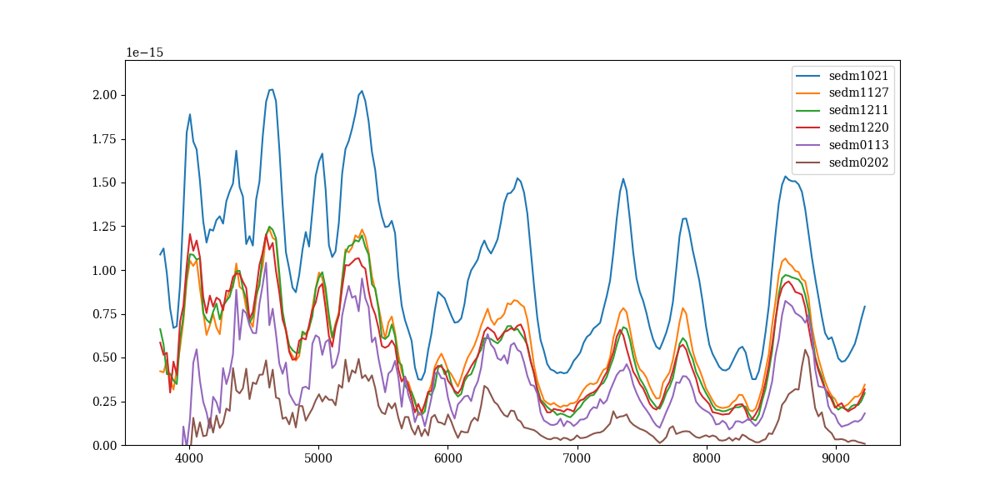

(0.0, 2.2e-15)

In [479]:
fig, ax = plt.subplots(figsize=(12,6))

specname = 'sedm1021'
specdata = specs_22jli[specname]['spec_photcal']
ax.plot(specdata[:,0], specdata[:,1], label=specname)

specname = 'sedm1127'
specdata = specs_22jli[specname]['spec_photcal']
ax.plot(specdata[:,0], specdata[:,1], label=specname)

specname = 'sedm1211'
specdata = specs_22jli[specname]['spec_photcal']
ax.plot(specdata[:,0], specdata[:,1], label=specname)

specname = 'sedm1220'
specdata = specs_22jli[specname]['spec_photcal']
ax.plot(specdata[:,0], specdata[:,1], label=specname)

specname = 'sedm0113'
specdata = specs_22jli[specname]['spec_photcal']
ax.plot(specdata[:,0], specdata[:,1], label=specname)

specname = 'sedm0202'
specdata = specs_22jli[specname]['spec_photcal']
ax.plot(specdata[:,0], specdata[:,1], label=specname)

ax.legend(loc=0)

ax.set_ylim([0, 2.2e-15])

### NOT/ALFOSC

In [527]:
jd = Time('2022-08-06T04:43:26', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['not0806'] = {'phase':phase,'jd': jd,  'instrument':'ALFOSC', 'telescope':'NOT', 'specfile':'../data/spectra/fritz/spectrum_1d.ascii', "exptime":999}

specdata = np.loadtxt(specs_22jli['not0806']['specfile'])
specs_22jli['not0806']['spec'] = specdata


jd = Time('2022-09-21T05:19:09.402', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['not0921'] = {'phase':phase,'jd': jd,  'instrument':'ALFOSC', 'telescope':'NOT', 'specfile':'../data/spectra/alfosc_NOT/Steve_reduction_redo_20230304/ZTF22aapubuy_NOT_ALFOSC_20220921_combine_3250.ascii', "exptime":999}

specdata = np.loadtxt(specs_22jli['not0921']['specfile'])
specs_22jli['not0921']['spec'] = specdata



jd = Time('2022-10-31T23:56:24.585', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['not1031'] = {'phase':phase,'jd': jd,  'instrument':'ALFOSC', 'telescope':'NOT', 'specfile':'../data/spectra/alfosc_NOT/Steve_reduction_redo_20230304/ZTF22aapubuy_NOT_ALFOSC_20221031_combine_3250.ascii', "exptime":1200}

specdata = np.loadtxt(specs_22jli['not1031']['specfile'])
specs_22jli['not1031']['spec'] = specdata


jd = Time('2022-11-25T00:01:46.61', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['not1125'] = {'phase':phase,'jd': jd,  'instrument':'ALFOSC', 'telescope':'NOT', 'specfile':'../data/spectra/fritz/spec1d_ALFk240168-ZTF22aapubuy_ALFOSC_20221125T000146.610_3500.ascii', "exptime":1200}

specdata = np.loadtxt(specs_22jli['not1125']['specfile'])
specs_22jli['not1125']['spec'] = specdata


jd = Time('2023-02-03T19:55:11.763', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['not0203'] = {'phase':phase,'jd': jd,  'instrument':'ALFOSC', 'telescope':'NOT', 'specfile':'../data/spectra/fritz/ZTF22aapubuy_NOT_ALFOSC_20230203_combine_3500.ascii', "exptime":600*2}

specdata = np.loadtxt(specs_22jli['not0203']['specfile'])
specs_22jli['not0203']['spec'] = specdata


jd = Time('2023-02-08T19:46:45.293', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['not0208'] = {'phase':phase,'jd': jd,  'instrument':'ALFOSC', 'telescope':'NOT', 'specfile':'../data/spectra/fritz/ZTF22aapubuy_NOT_ALFOSC_20230208_combine_3500.ascii', "exptime":600*2}

specdata = np.loadtxt(specs_22jli['not0208']['specfile'])
specs_22jli['not0208']['spec'] = specdata

2459797.7 93.0
2459843.7 139.1
2459884.5 179.8
2459908.5 203.8
2459979.3 274.7
2459984.3 279.7


In [528]:
# NOT spectra extinction correction and flux calibration 

not_specnames = [specname for specname in specs_22jli.keys() if ('not' in specname and (type(specs_22jli[specname]) is dict) and specs_22jli[specname]['instrument']=='ALFOSC')]
print(not_specnames)

spec_photcal_dir = '../data/spectra/photcal_version/'

for specname in not_specnames:
    
    specfile = specs_22jli[specname]['specfile'].split('/')[-1]
    
    if specname in ['not0203', 'not0208']:
        calflts = ['r']
    else:
        calflts = ['g', 'r']

    calmags = sed_mag_dict[specname].copy()
    #print(calmags)
    specdata = specs_22jli[specname]['spec'].copy()
    print(specname, calflts, calmags)
        
    polyfunc, polyobj = spectrum_flux_calibrate(specdata, filter_curves,  calflts, calmags, polyorder=0, display=0)
    specdata[:,1] = polyfunc(polyobj.params, specdata[:,0])*specdata[:,1]
    
    np.savetxt(os.path.join(spec_photcal_dir, specfile), specdata)
    
    specs_22jli[specname]['spec_photcal'] = specdata

['not0806', 'not0921', 'not1031', 'not1125', 'not0203', 'not0208']
not0806 ['g', 'r'] flt  lam          mag         magerr
--- ------ ------------------ ------
  g 5200.0 15.556334217580963   0.05
  r 6169.5  15.28868491081552   0.05
not0921 ['g', 'r'] flt  lam          mag         magerr
--- ------ ------------------ ------
  g 5200.0 16.151861579443317   0.05
  r 6169.5  16.06302299341563   0.05
not1031 ['g', 'r'] flt  lam          mag        magerr
--- ------ ----------------- ------
  g 5200.0 16.39090298103645   0.05
  r 6169.5  16.3835776226021   0.05
not1125 ['g', 'r'] flt  lam          mag         magerr
--- ------ ------------------ ------
  g 5200.0  16.77986350225466   0.05
  r 6169.5 16.684685776274307   0.05
not0203 ['r'] flt  lam          mag         magerr
--- ------ ------------------ ------
  g 5200.0  18.55507578640519   0.05
  r 6169.5 18.362270670811785   0.05
not0208 ['r'] flt  lam          mag         magerr
--- ------ ------------------ ------
  g 5200.0 19.34175

In [481]:
#get the synthetic from the NOT spectra

specname = 'not0203'
specdata_cal = specs_22jli[specname]['spec_photcal']
filter_data = filter_curves['ztfg']
wpivot, intf, gmag_0203 = mag_flux_from_spec_bandpass('g', specdata_cal[:,0], specdata_cal[:,1], filter_data[:,0], filter_data[:,1], fill_mode = 0, display=0, verbose=True)

filter_data = filter_curves['ztfr']
wpivot, intf, rmag_0203 = mag_flux_from_spec_bandpass('r', specdata_cal[:,0], specdata_cal[:,1], filter_data[:,0], filter_data[:,1], fill_mode = 0, display=0, verbose=True)

filter_data = filter_curves['ztfi']
wpivot, intf, imag_0203 = mag_flux_from_spec_bandpass('i', specdata_cal[:,0], specdata_cal[:,1], filter_data[:,0], filter_data[:,1], fill_mode = 0, display=0, verbose=True)


specname = 'not0208'
specdata_cal = specs_22jli[specname]['spec_photcal']
filter_data = filter_curves['ztfg']
wpivot, intf, gmag_0203 = mag_flux_from_spec_bandpass('g', specdata_cal[:,0], specdata_cal[:,1], filter_data[:,0], filter_data[:,1], fill_mode = 0, display=0, verbose=True)

filter_data = filter_curves['ztfr']
wpivot, intf, rmag_0203 = mag_flux_from_spec_bandpass('r', specdata_cal[:,0], specdata_cal[:,1], filter_data[:,0], filter_data[:,1], fill_mode = 0, display=0, verbose=True)

filter_data = filter_curves['ztfi']
wpivot, intf, imag_0203 = mag_flux_from_spec_bandpass('i', specdata_cal[:,0], specdata_cal[:,1], filter_data[:,0], filter_data[:,1], fill_mode = 0, display=0, verbose=True)


flux 2.896477269937653e-16 at 4789.445922499625 A ---> magnitude 18.034597773351322
flux 1.1916359164512915e-16 at 6421.166992940606 A ---> magnitude 18.362270670811785
flux 9.201396273606315e-17 at 7954.929623600653 A ---> magnitude 18.177883409218133
flux 1.9276407361921463e-16 at 4789.445922499625 A ---> magnitude 18.476707846355332
flux 8.68262992428007e-17 at 6421.166992940606 A ---> magnitude 18.706001405537307
flux 7.042025842318106e-17 at 7954.929623600653 A ---> magnitude 18.46827370983709


### P200/DBSP

In [467]:
jd = Time('2022-08-20T00:00:00', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['dbsp0820'] = {'phase':phase,'jd': jd,  'instrument':'DBSP', 'telescope':'P200', 'specfile':'../data/spectra/fritz/ZTF22aapubuy_DBSP_2022-08-20T00_00_00.csv', "exptime":300}

specdata = np.loadtxt(specs_22jli['dbsp0820']['specfile'], skiprows=1, delimiter=',')
specs_22jli['dbsp0820']['spec'] = specdata


jd = Time('2022-10-11T06:35:14', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['dbsp1011'] = {'phase':phase,'jd': jd,  'instrument':'DBSP', 'telescope':'P200', 'specfile':'../data/spectra/fritz/20221010_ZTF22aapubuy_2.spec', "exptime":600}

specdata = np.loadtxt(specs_22jli['dbsp1011']['specfile'])
specs_22jli['dbsp1011']['spec'] = specdata


jd = Time('2022-11-02T00:00:00', format='isot').jd  ##The obstime not precise
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['dbsp1102'] = {'phase':phase,'jd': jd,  'instrument':'DBSP', 'telescope':'P200', 'specfile':'../data/spectra/fritz/ZTF22aapubuy_DBSP_2022-11-02T00_00_00.txt', "exptime":420}

specdata = np.loadtxt(specs_22jli['dbsp1102']['specfile'])
specs_22jli['dbsp1102']['spec'] = specdata

2459811.5 106.8
2459863.8 159.1
2459885.5 180.8


In [482]:
# P200 spectra extinction correction and flux calibration 

dbsp_specnames = [specname for specname in specs_22jli.keys() if ('dbsp' in specname and specs_22jli[specname]['instrument']=='DBSP')]
print(dbsp_specnames)

spec_photcal_dir = '../data/spectra/photcal_version/'

for specname in dbsp_specnames:
    
    specfile = specs_22jli[specname]['specfile'].split('/')[-1]
    
    calflts = ['g', 'r']

    calmags = sed_mag_dict[specname].copy()
    #print(calmags)
    specdata = specs_22jli[specname]['spec'].copy()
        
    polyfunc, polyobj = spectrum_flux_calibrate(specdata, filter_curves,  calflts, calmags, polyorder=0, display=0)
    specdata[:,1] = polyfunc(polyobj.params, specdata[:,0])*specdata[:,1]
    
    np.savetxt(os.path.join(spec_photcal_dir, specfile), specdata)
    
    specs_22jli[specname]['spec_photcal'] = specdata

['dbsp0820', 'dbsp1011', 'dbsp1102']


<IPython.core.display.Javascript object>


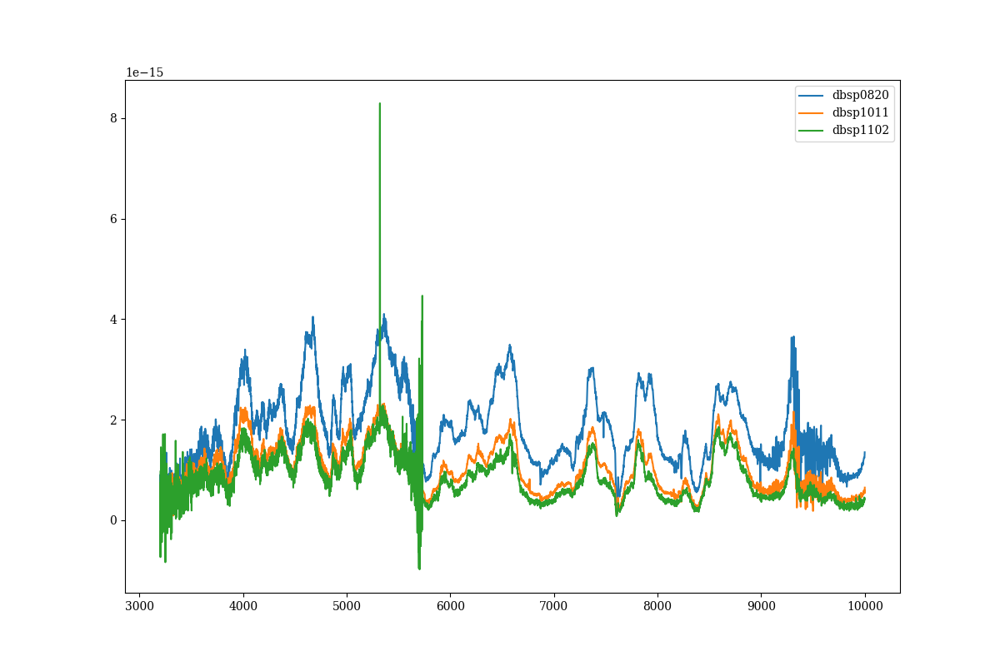

['dbsp0820', 'dbsp1011', 'dbsp1102']


In [27]:
fig, ax = plt.subplots(figsize=(12,8))


dbsp_specnames = [specname for specname in specs_22jli.keys() if ('dbsp' in specname and specs_22jli[specname]['instrument']=='DBSP')]
print(dbsp_specnames)

spec_photcal_dir = '../data/spectra/photcal_version/'

for specname in dbsp_specnames:
    
    specdata = specs_22jli[specname]['spec_photcal']
    
    ax.plot(specdata[:,0], specdata[:,1], label=specname)
    
ax.legend(loc=0)

### IMACS

<IPython.core.display.Javascript object>


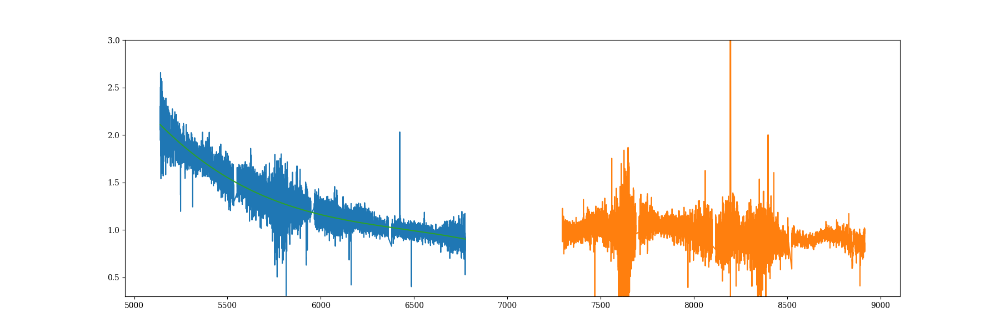

<IPython.core.display.Javascript object>


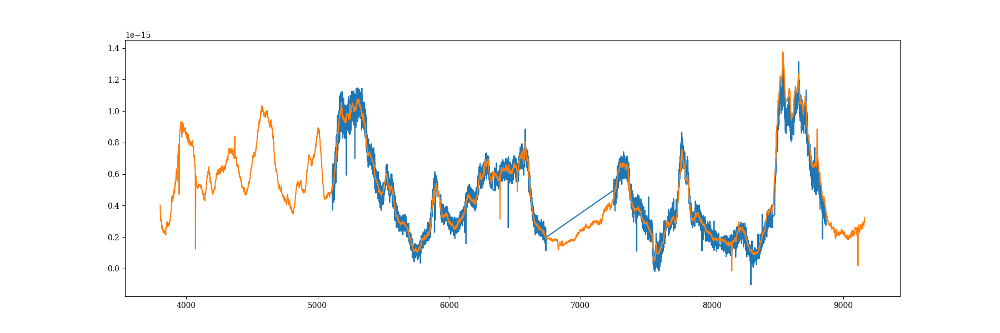

In [495]:
imacsspec01_01 = np.loadtxt('../data/spectra/magellan_fire_20221214/spec2.f.txt')
imacsspec01_02 = np.loadtxt('../data/spectra/magellan_fire_20221214/spec3.f.txt')

refspec = np.loadtxt('../data/spectra/binospec/SN2022jli_BINOSPEC_20221227.txt')

ref_interp = interp1d(refspec[:,0], refspec[:,1])
ref_spec1 = ref_interp(imacsspec01_01[:,0])
ref_spec2 = ref_interp(imacsspec01_02[:,0])

fig, ax = plt.subplots(figsize=(18, 6))
ax.plot(imacsspec01_01[:,0], imacsspec01_01[:,1]/ref_spec1)
ax.plot(imacsspec01_02[:,0], imacsspec01_02[:,1]/ref_spec2)
ax.set_ylim([0.3,3])

xs = imacsspec01_01[:,0]
ys = imacsspec01_01[:,1]/ref_spec1
yserr = np.ones_like(ys)*0.05
polyobj = polyfit(xs, ys,yserr, 3)
ys_model = poly3(polyobj.params, xs)

ax.plot(xs, ys_model)

imacsspec01_01[:,1] = imacsspec01_01[:,1]/ys_model
imacsspec = np.vstack([imacsspec01_01, imacsspec01_02])
np.savetxt('../data/spectra/magellan_imacs/SN2022jli_IMACS_20221214.txt', imacsspec)

fig, ax = plt.subplots(figsize=(18,6))
ax.plot(imacsspec[:,0]/(1+z_22jli), imacsspec[:,1])
ax.plot(refspec[:,0]/(1+z_22jli), refspec[:,1])


<IPython.core.display.Javascript object>


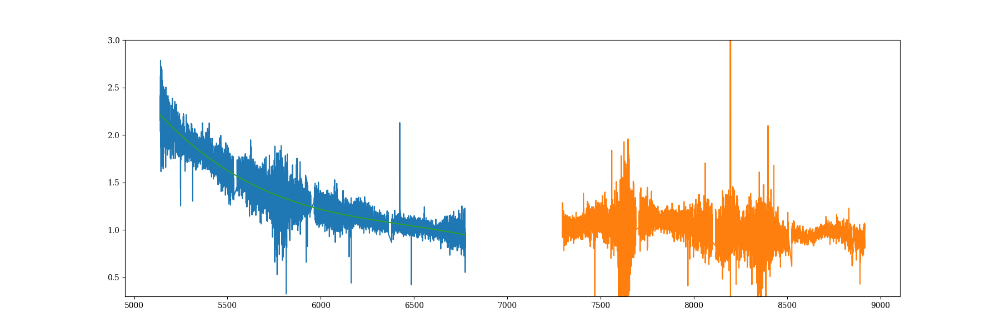

<IPython.core.display.Javascript object>


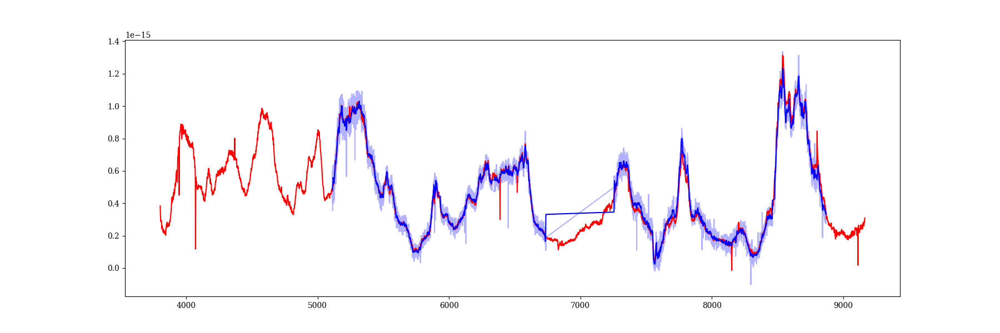

In [387]:
imacsspec01_01 = np.loadtxt('./spectra/magellan_fire_20221214/spec2.f.txt')
imacsspec01_02 = np.loadtxt('./spectra/magellan_fire_20221214/spec3.f.txt')

refspec = specs_22jli['binospec1227']['spec_photcal']

ref_interp = interp1d(refspec[:,0], refspec[:,1])
ref_spec1 = ref_interp(imacsspec01_01[:,0])
ref_spec2 = ref_interp(imacsspec01_02[:,0])

fig, ax = plt.subplots(figsize=(18, 6))
ax.plot(imacsspec01_01[:,0], imacsspec01_01[:,1]/ref_spec1)
ax.plot(imacsspec01_02[:,0], imacsspec01_02[:,1]/ref_spec2)
ax.set_ylim([0.3,3])

xs = imacsspec01_01[:,0]
ys = imacsspec01_01[:,1]/ref_spec1
yserr = np.ones_like(ys)*0.05
polyobj = polyfit(xs, ys,yserr, 3)
ys_model = poly3(polyobj.params, xs)

ax.plot(xs, ys_model)

imacsspec01_01[:,1] = imacsspec01_01[:,1]/ys_model
imacsspec = np.vstack([imacsspec01_01, imacsspec01_02])
np.savetxt('./spectra/magellan_imacs/SN2022jli_IMACS_20221214_fluxcal.txt', imacsspec)





fig, ax = plt.subplots(figsize=(18,6))
ax.plot(imacsspec[:,0]/(1+z_22jli), imacsspec[:,1], 'b', alpha=0.3)
ax.plot(refspec[:,0]/(1+z_22jli), refspec[:,1], 'r', )



ys_smooth = savgol_filter(imacsspec[:,1], 51, 2)
ax.plot(imacsspec[:,0]/(1+z_22jli), ys_smooth, 'b')

imacsspec_smooth = imacsspec.copy()
imacsspec_smooth[:,1] = ys_smooth
np.savetxt('./spectra/magellan_imacs/SN2022jli_IMACS_20221214_fluxcal_smooth.txt', imacsspec_smooth)

<IPython.core.display.Javascript object>


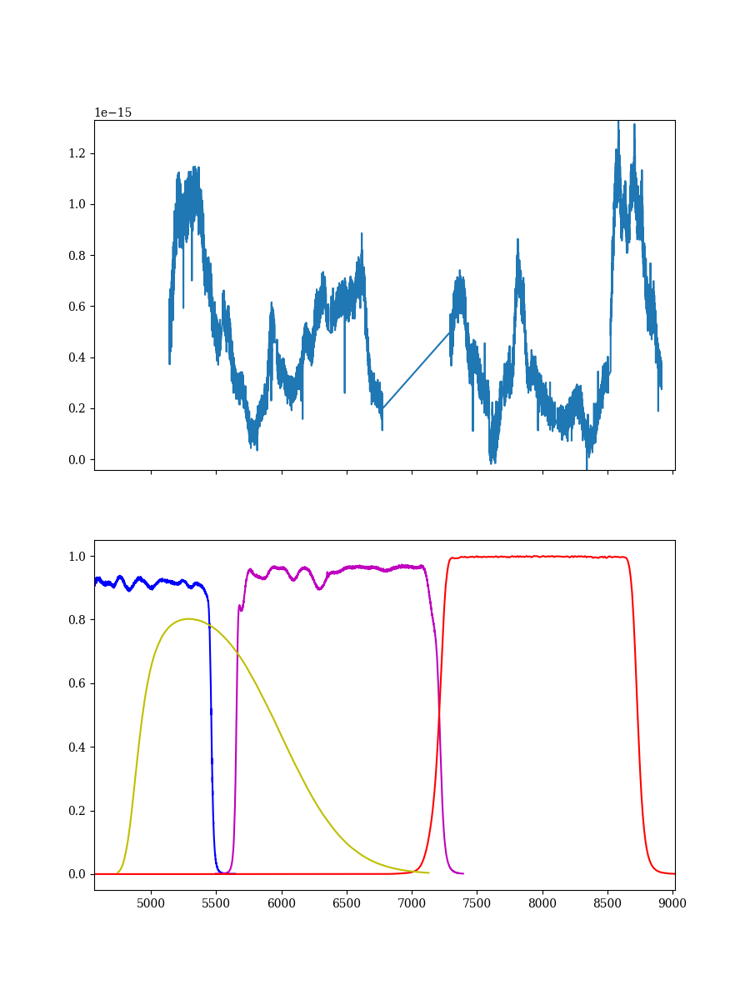

In [72]:
imacsspec = np.loadtxt('../data/spectra/magellan_imacs/SN2022jli_IMACS_20221214.txt')

fig, (ax, ax2) = plt.subplots(2,1, figsize=(9,12), sharex=True)

ax.plot(imacsspec[:,0], imacsspec[:,1])

ax2.plot(filter_curves['ztfg'][:,0], filter_curves['ztfg'][:,1], 'b')
ax2.plot(filter_curves['ztfr'][:,0], filter_curves['ztfr'][:,1], 'm')
ax2.plot(filter_curves['ztfi'][:,0], filter_curves['ztfi'][:,1], 'r')
ax2.plot(filter_curves['efoscV'][:,0], filter_curves['efoscV'][:,1], 'y')


In [469]:


jd = Time('2022-12-15T03:17:55', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['imacs1214'] = {'phase':phase,'jd': jd,  'instrument':'IMACS', 'telescope':'Magellan/Badde', 'specfile':'../data/spectra/magellan_imacs/SN2022jli_IMACS_20221214.txt', "exptime":900}

specdata = np.loadtxt(specs_22jli['imacs1214']['specfile'])
specs_22jli['imacs1214']['spec'] = specdata




2459928.6 224.0


In [484]:
#flux calibrate the IMACS spectrum


specdata = np.loadtxt('../data/spectra/magellan_imacs/SN2022jli_IMACS_20221214_fluxcal.txt')
specs_22jli['imacs1214']['spec_photcal'] = specdata

specdata = np.loadtxt('../data/spectra/magellan_imacs/SN2022jli_IMACS_20221214_fluxcal_smooth.txt')
specs_22jli['imacs1214']['spec_photcal_smooth'] = specdata

### BINOSPEC

In [471]:

jd = Time('2022-12-27T02:11:27', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,4), np.round(phase,1))
specs_22jli['binospec1227'] = {'phase':phase,'jd': jd,  'instrument':'BINOSPEC', 'telescope':'MMT', 'specfile':'../data/spectra/binospec/SN2022jli_BINOSPEC_20221227.txt', "exptime":400*6}

specdata = np.loadtxt(specs_22jli['binospec1227']['specfile'])
specs_22jli['binospec1227']['spec'] = specdata



jd = Time('2023-01-12T01:51:34', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,4), np.round(phase,1))
specs_22jli['binospec0112'] = {'phase':phase,'jd': jd,  'instrument':'BINOSPEC', 'telescope':'MMT', 'specfile':'../data/spectra/binospec/SN2022jli_BINOSPEC_20230112.txt', "exptime":450*1}

specdata = np.loadtxt(specs_22jli['binospec0112']['specfile'])
specs_22jli['binospec0112']['spec'] = specdata


jd = Time('2023-01-13T01:43:20', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,4), np.round(phase,1))
specs_22jli['binospec0113'] = {'phase':phase,'jd': jd,  'instrument':'BINOSPEC', 'telescope':'MMT', 'specfile':'../data/spectra/binospec/SN2022jli_BINOSPEC_20230113.txt', "exptime":450*3}

specdata = np.loadtxt(specs_22jli['binospec0113']['specfile'])
specs_22jli['binospec0113']['spec'] = specdata


jd = Time('2023-01-21T02:39:52', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,4), np.round(phase,1))
specs_22jli['binospec0120'] = {'phase':phase,'jd': jd,  'instrument':'BINOSPEC', 'telescope':'MMT', 'specfile':'../data/spectra/binospec/SN2022jli_BINOSPEC_20230120.txt', "exptime":450*4}

specdata = np.loadtxt(specs_22jli['binospec0120']['specfile'])
specs_22jli['binospec0120']['spec'] = specdata


jd = Time('2023-01-22T02:11:02', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,4), np.round(phase,1))
specs_22jli['binospec0121'] = {'phase':phase,'jd': jd,  'instrument':'BINOSPEC', 'telescope':'MMT', 'specfile':'../data/spectra/binospec/SN2022jli_BINOSPEC_20230121.txt', "exptime":450*5}

specdata = np.loadtxt(specs_22jli['binospec0121']['specfile'])
specs_22jli['binospec0121']['spec'] = specdata


jd = Time('2023-01-31T02:09:16', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,1), np.round(phase,1))
specs_22jli['binospec0131'] = {'phase':phase,'jd': jd,  'instrument':'BINOSPEC', 'telescope':'MMT', 'specfile':'../data/spectra/binospec/SN2022jli_BINOSPEC_20230131.txt', "exptime":450*3}

specdata = np.loadtxt(specs_22jli['binospec0131']['specfile'])
specs_22jli['binospec0131']['spec'] = specdata

2459940.5913 235.9
2459956.5775 251.9
2459957.5718 252.9
2459965.611 260.9
2459966.591 261.9
2459975.6 270.9


In [483]:
# binospec spectra extinction correction and flux calibration 

binospec_specnames = [specname for specname in specs_22jli.keys() if ('binospec' in specname and specs_22jli[specname]['instrument']=='BINOSPEC')]
print(binospec_specnames)

spec_photcal_dir = '../data/spectra/photcal_version/'

for specname in binospec_specnames:
    
    specfile = specs_22jli[specname]['specfile'].split('/')[-1]
    
    calflts = ['g', 'r']

    calmags = sed_mag_dict[specname].copy()
    #print(calmags)
    specdata = specs_22jli[specname]['spec'].copy()
        
    polyfunc, polyobj = spectrum_flux_calibrate(specdata, filter_curves,  calflts, calmags, polyorder=0, display=0)
    specdata[:,1] = polyfunc(polyobj.params, specdata[:,0])*specdata[:,1]
    
    np.savetxt(os.path.join(spec_photcal_dir, specfile), specdata)
    
    specs_22jli[specname]['spec_photcal'] = specdata

['binospec1227', 'binospec0112', 'binospec0113', 'binospec0120', 'binospec0121', 'binospec0131']


<IPython.core.display.Javascript object>


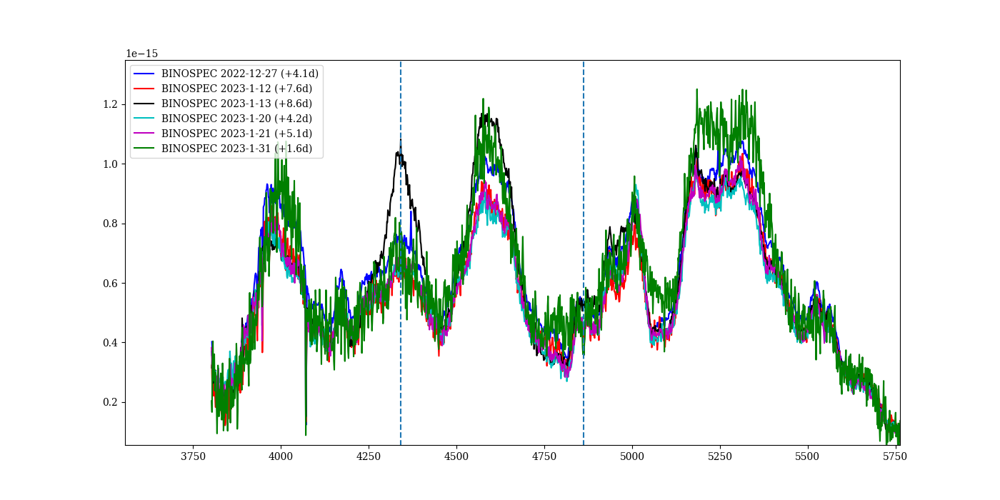

4096 4038 4081


<IPython.core.display.Javascript object>


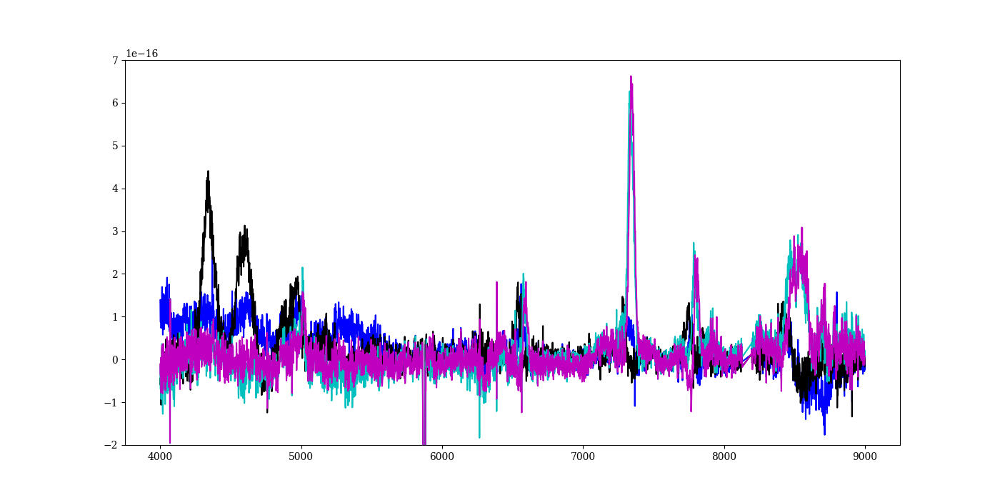

(-2e-16, 7e-16)

In [472]:

#fig, (ax,ax2) = plt.subplots(2,1,figsize=(14, 14), sharex=True)

fig, ax = plt.subplots(figsize=(14, 7))

specname = 'binospec1227'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs1 = spec[:,0]/(1+z_22jli)
ys1 = spec[:,1]
ax.plot(xs1, ys1, 'b', label='BINOSPEC 2022-12-27 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )
ax.text(9400, np.mean(ys1[-10:])+1e-16, '+{:.0f}d'.format(phase), color='b', va='center', fontsize=15)


specname = 'binospec0112'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs2 = spec[:,0]/(1+z_22jli)
ys2 = spec[:,1]*2.25
ax.plot(xs2, ys2, 'r', label='BINOSPEC 2023-1-12 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )
ax.text(9400, np.mean(ys2[-10:])+1e-16, '+{:.0f}d'.format(phase), color='r', va='center', fontsize=15)

specname = 'binospec0113'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs3 = spec[:,0]/(1+z_22jli)
ys3 = spec[:,1]*1.35
ax.plot(xs3, ys3, 'k', label='BINOSPEC 2023-1-13 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )
ax.text(9400, np.mean(ys3[-10:])+1e-16, '+{:.0f}d'.format(phase), color='k', va='center', fontsize=15)


specname = 'binospec0120'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs4 = spec[:,0]/(1+z_22jli)
ys4 = spec[:,1]*2.65
ax.plot(xs4, ys4, 'c', label='BINOSPEC 2023-1-20 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )
ax.text(9400, np.mean(ys4[-10:])+1e-16, '+{:.0f}d'.format(phase), color='c', va='center', fontsize=15)

specname = 'binospec0121'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs5 = spec[:,0]/(1+z_22jli)
ys5 = spec[:,1]*2.15
ax.plot(xs5, ys5, 'm', label='BINOSPEC 2023-1-21 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )
ax.text(9400, np.mean(ys5[-10:])+1e-16, '+{:.0f}d'.format(phase), color='m', va='center', fontsize=15)


specname = 'binospec0131'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs6 = spec[:,0]/(1+z_22jli)
ys6 = spec[:,1]*4.3
ax.plot(xs6, ys6, 'g', label='BINOSPEC 2023-1-31 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )
ax.text(9400, np.mean(ys6[-10:])+1e-16, '+{:.0f}d'.format(phase), color='g', va='center', fontsize=15)


vshift=0
ax.vlines(np.array([6563, 4861, 4340])*(1+vshift/300000.) , ymin=0, ymax=1.4e-15, linestyles='dashed')
vshift = 0
ax.vlines(np.array([6300, 6363])*(1+vshift/300000.) , ymin=0, ymax=1.4e-15, linestyles='solid', colors='c')
vshift=0
ax.vlines(np.array([8201.72, 8248.80, 8254.73, 8498.02, 8542.09, 8662.14, 8912.07, 8927.36])*(1+vshift/300000.) , ymin=0, ymax=1.4e-15, linestyles='solid', colors='m')

print(len(xs1), len(xs2), len(xs3))






fig, ax2 = plt.subplots(figsize=(14, 7))




refxs = xs2[(xs2>4000)*(xs2<9000)]
refys = ys2[(xs2>4000)*(xs2<9000)]
spec1_interp = interp1d(xs1, ys1, bounds_error=False)
spec3_interp = interp1d(xs3, ys3, bounds_error=False)
spec4_interp = interp1d(xs4, ys4, bounds_error=False)
spec5_interp = interp1d(xs5, ys5, bounds_error=False)


ax2.plot(refxs, spec1_interp(refxs) - refys, 'b', label='spec1 - ref')
ax2.plot(refxs, spec3_interp(refxs) - refys, 'k', label='spec3 - ref')
ax2.plot(refxs, spec4_interp(refxs) - refys, 'c', label='spec4 - ref')
ax2.plot(refxs, spec5_interp(refxs) - refys, 'm', label='spec5 - ref')

show_imacs1214 = 0
if show_imacs1214:
    xs4 = imacsspec[:,0]/(1+z_22jli)
    ys4 = imacsspec[:,1]
    ax.plot(xs4, ys4, 'g')

    spec4_interp = interp1d(xs4, ys4, bounds_error=False)
    ax2.plot(refxs, spec4_interp(refxs) - refys, 'g', label='spec4 - ref')


show_xsh0114 = 0
if show_xsh0114:
    specname = 'xsh0114'
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs5 = spec[:,0]/(1+z_22jli)
    ys5 = spec[:,1]*1.1/0.78
    ax.plot(xs5, ys5, 'c',  alpha=0.3, label='XSH 2023-1-14 VIS')

    spec5_interp = interp1d(xs5, ys5, bounds_error=False)
    ax2.plot(refxs, spec5_interp(refxs) - refys, 'c', label='spec5 - ref')


show_xsh0118 = 0
if show_xsh0118:
    specname = 'xsh0118'
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs6 = spec[:,0]/(1+z_22jli)
    ys6 = spec[:,1]*1.1
    ax.plot(xs6, ys6, 'y', alpha=0.3, label='XSH 2023-1-18 VIS')

    spec6_interp = interp1d(xs6, ys6, bounds_error=False)
    ax2.plot(refxs, spec6_interp(refxs) - refys, 'y', label='spec6 - ref')
    
ax.legend(loc=0)
#ax.set_xlim([5750, 7750])
ax.set_ylim([-2e-16, 1.5e-15])
ax2.set_ylim([-2e-16, 7e-16])

<IPython.core.display.Javascript object>


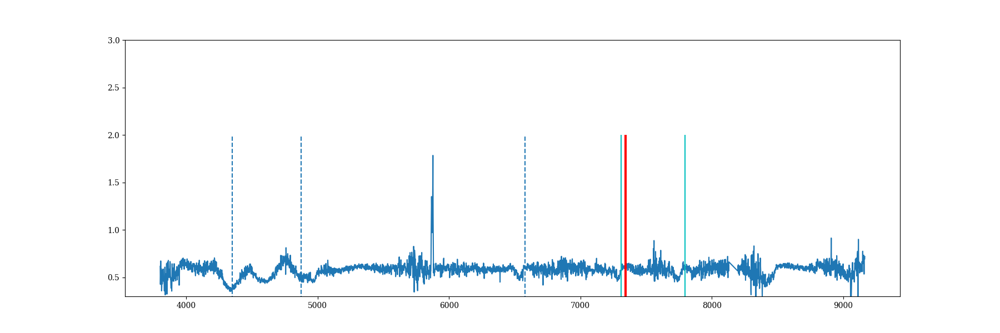

In [141]:
inspecname = 'binospec0112'
#inspecname = 'binospec1227'
refspecname = 'binospec0113'

inspec  = specs_22jli[inspecname]['spec']
refspec = specs_22jli[refspecname]['spec']

refspec_interpfunc = interp1d(refspec[:,0], refspec[:,1], bounds_error=False, fill_value='extrapolate')
refspec_interp = refspec_interpfunc(inspec[:,0])

fig, ax = plt.subplots(figsize=(18, 6))
ax.plot(inspec[:,0]/(1+z_22jli), inspec[:,1]/refspec_interp)
ax.set_ylim([0.3,3])

'''
xs = imacsspec01_01[:,0]
ys = imacsspec01_01[:,1]/ref_spec1
yserr = np.ones_like(ys)*0.05
polyobj = polyfit(xs, ys,yserr, 3)
ys_model = poly3(polyobj.params, xs)

ax.plot(xs, ys_model)

imacsspec01_01[:,1] = imacsspec01_01[:,1]/ys_model
imacsspec = np.vstack([imacsspec01_01, imacsspec01_02])
np.savetxt('./spectra/magellan_imacs/SN2022jli_IMACS_20221214.txt', imacsspec)

fig, ax = plt.subplots(figsize=(18,6))
ax.plot(imacsspec[:,0], imacsspec[:,1])
ax.plot(refspec[:,0], refspec[:,1])
'''

vshift= -1200
vshift= 800
ax.vlines(np.array([6563, 4861, 4340])*(1+vshift/300000.) , ymin=0, ymax=2, linestyles='dashed')
ax.vlines(np.array([7291, 7324, 7774])*(1+vshift/300000.) , ymin=0, ymax=2, linestyles='solid', colors='c')
ax.vlines(np.array([7320, 7330])*(1+vshift/300000.) , ymin=0, ymax=2, linestyles='solid', colors='r')

### X-shooter

In [24]:
def remove_xsh_spec_artifact(xs, ys, xls, xrs):
    
    for x1, x2 in zip(xls, xrs):
        mask = (xs>x1)*(xs<x2)
        xs = xs[~mask]
        ys = ys[~mask]
    
    return xs, ys

<IPython.core.display.Javascript object>


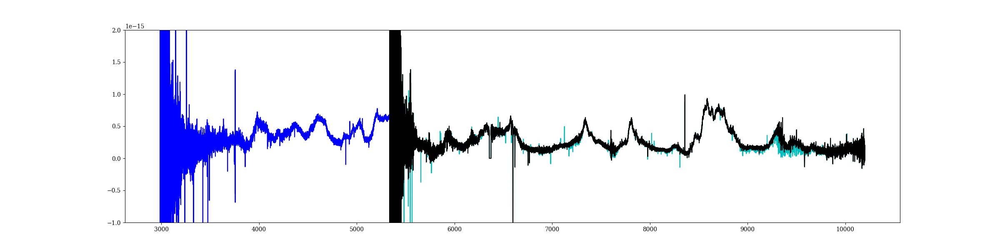

<IPython.core.display.Javascript object>


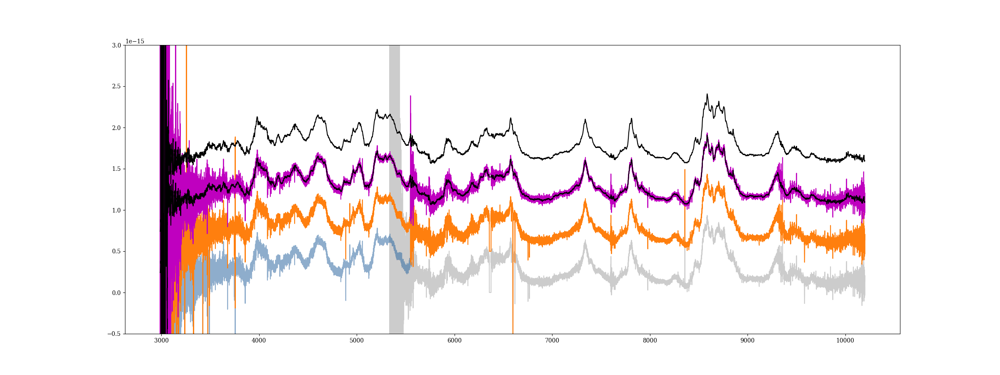

scale factor for UVB: 1.004599603535422


In [25]:
#20230114

vis1 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_VIS_20230113.txt')

vis1_01 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_VIS_20230113_01.txt')
vis1_02 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_VIS_20230113_02.txt')

uvb1 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_20230113.txt')

nir1 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_NIR_20230113.txt')

fig, ax = plt.subplots(figsize=(24,6))



ax.plot(uvb1[:,0], uvb1[:,1], 'b')

ax.plot(vis1[:,0], vis1[:,1], 'c')
#ax.plot(vis1_01[:,0], vis1_01[:,1], 'y')
#ax.plot(vis1_02[:,0], vis1_02[:,1], 'g')

# ax.plot(nir1[:,0], nir1[:,1], 'r')



#VIS band after telluric correction
hdu = fits.open('../data/spectra/xshooter/tellcorr/sn2022jli_20230114_VIS/SN2022jli_EPOCH_1_SCIENCE_TELLURIC_CORR.fits')
ws = (hdu[0].header['CRVAL1'] + np.arange(len(hdu[0].data))*hdu[0].header['CDELT1'])*10
fs = hdu[0].data
vis_tellcor = np.array([ws, fs]).transpose()

ax.plot(vis_tellcor[:,0], vis_tellcor[:,1], 'k')



ax.set_ylim([-1e-15, 2e-15])




### stitched

fig, ax = plt.subplots(figsize=(24,9))

xs_stitched = np.array([])
ys_stitched = np.array([])



vis_xs_comb = vis_tellcor[:,0]
vis_ys_comb = vis_tellcor[:,1]
uvb_xs_comb = uvb1[:,0]
uvb_ys_comb = uvb1[:,1]

ax.plot(uvb_xs_comb, uvb_ys_comb, 'r', alpha=0.1)
ax.plot(vis_xs_comb, vis_ys_comb, 'k', alpha=0.2)

#UVB+VIS
uvb_vis_overlap = [5450, 5550]

ref_xs = vis_xs_comb[(vis_xs_comb>uvb_vis_overlap[0])*(vis_xs_comb<uvb_vis_overlap[1])]
#print(ref_xs)
ref_ys = vis_ys_comb[(vis_xs_comb>uvb_vis_overlap[0])*(vis_xs_comb<uvb_vis_overlap[1])]
uvb_interp = interp1d(uvb_xs_comb, uvb_ys_comb, kind='nearest')
uvb_ys_temp = uvb_interp(ref_xs)
scale = np.median(ref_ys/uvb_ys_temp)
print('scale factor for UVB:', scale)
ax.plot(uvb_xs_comb, uvb_ys_comb*scale, alpha=0.5)

xs_stitched = np.append(xs_stitched, uvb_xs_comb[uvb_xs_comb<uvb_vis_overlap[1]])
ys_stitched = np.append(ys_stitched, uvb_ys_comb[uvb_xs_comb<uvb_vis_overlap[1]]*scale)

# xs_stitched = np.append(xs_stitched, ref_xs)
# ys_stitched = np.append(ys_stitched, (uvb_ys_temp*scale+ref_ys)/2.0)

xs_stitched1 = np.append(xs_stitched, vis_xs_comb[vis_xs_comb>uvb_vis_overlap[1]])
ys_stitched1 = np.append(ys_stitched, vis_ys_comb[vis_xs_comb>uvb_vis_overlap[1]])


ax.plot(xs_stitched1, ys_stitched1+5e-16)



xls = [3240, 3257.5, 3329, 3331.5, 3425, 3476, 3492, 3756, 4924.2, 4929.4, 6355, 8358, ]
xrs = [3242, 3258.5, 3330, 3332.5, 3426, 3477, 3493, 3759, 4924.6, 4930, 6376, 8359.5, ]

xls_hostlines = [3745,  4886.5, 6582.5, 6596.5, 6617, 6751, 6766, 9117.5, 9581] #[OII] 3726, 3729, Hbeta 4861, [NII] 6548,6583, Halpha, [SII] 6717,6731, [SIII] 9069, 9532
xrs_hostlines = [3750,  4889.5, 6585.5, 6601, 6621, 6755, 6770, 9120.5, 9586]


xs_clean, ys_clean = remove_xsh_spec_artifact(xs_stitched1, ys_stitched1, xls, xrs)
xs_clean1, ys_clean1 = remove_xsh_spec_artifact(xs_clean, ys_clean, xls_hostlines, xrs_hostlines)


ax.plot(xs_clean1, ys_clean1+1e-15, 'm')


ys_smooth1 = savgol_filter(ys_clean1, 51, 2)
ax.plot(xs_clean1, ys_smooth1+1e-15, color='k')
ax.plot(xs_clean1, ys_smooth1+1.5e-15, color='k')


ax.set_ylim([-5e-16, 3e-15])


np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113.txt', np.array([xs_stitched1, ys_stitched1]).transpose())
np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113_clean.txt', np.array([xs_clean1, ys_clean1]).transpose())
np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113_clean_smooth.txt', np.array([xs_clean1, ys_smooth1]).transpose())

<IPython.core.display.Javascript object>


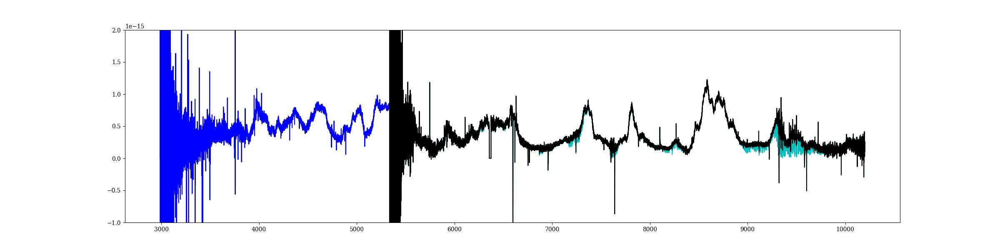

<IPython.core.display.Javascript object>


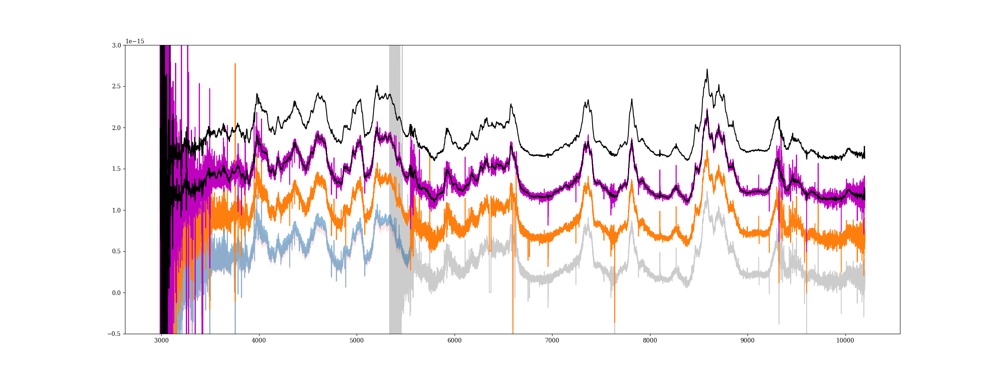

scale factor for UVB: 1.0886741263876045


In [30]:
#20230118

uvb2 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_20230117.txt')
vis2 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_VIS_20230117.txt')
nir2 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_NIR_20230117.txt')

fig, ax = plt.subplots(figsize=(24,6))



ax.plot(uvb2[:,0], uvb2[:,1], 'b')
ax.plot(vis2[:,0], vis2[:,1], 'c')
# ax.plot(nir2[:,0], nir2[:,1], 'r')

#VIS band after telluric correction
hdu = fits.open('../data/spectra/xshooter/tellcorr/sn2022jli_20230118_VIS/SN2022jli_EPOCH_2_SCIENCE_TELLURIC_CORR.fits')
ws = (hdu[0].header['CRVAL1'] + np.arange(len(hdu[0].data))*hdu[0].header['CDELT1'])*10
fs = hdu[0].data
vis_tellcor = np.array([ws, fs]).transpose()

ax.plot(vis_tellcor[:,0], vis_tellcor[:,1], 'k')
ax.set_ylim([-1e-15, 2e-15])



### stitched

fig, ax = plt.subplots(figsize=(24,9))

xs_stitched = np.array([])
ys_stitched = np.array([])



vis_xs_comb = vis_tellcor[:,0]
vis_ys_comb = vis_tellcor[:,1]
uvb_xs_comb = uvb2[:,0]
uvb_ys_comb = uvb2[:,1]

ax.plot(uvb_xs_comb, uvb_ys_comb, 'r', alpha=0.1)
ax.plot(vis_xs_comb, vis_ys_comb, 'k', alpha=0.2)

#UVB+VIS
uvb_vis_overlap = [5450, 5550]

ref_xs = vis_xs_comb[(vis_xs_comb>uvb_vis_overlap[0])*(vis_xs_comb<uvb_vis_overlap[1])]
#print(ref_xs)
ref_ys = vis_ys_comb[(vis_xs_comb>uvb_vis_overlap[0])*(vis_xs_comb<uvb_vis_overlap[1])]
uvb_interp = interp1d(uvb_xs_comb, uvb_ys_comb, kind='nearest')
uvb_ys_temp = uvb_interp(ref_xs)
scale = np.median(ref_ys/uvb_ys_temp)
print('scale factor for UVB:', scale)
ax.plot(uvb_xs_comb, uvb_ys_comb*scale, alpha=0.5)

xs_stitched = np.append(xs_stitched, uvb_xs_comb[uvb_xs_comb<uvb_vis_overlap[1]])
ys_stitched = np.append(ys_stitched, uvb_ys_comb[uvb_xs_comb<uvb_vis_overlap[1]]*scale)

# xs_stitched = np.append(xs_stitched, ref_xs)
# ys_stitched = np.append(ys_stitched, (uvb_ys_temp*scale+ref_ys)/2.0)

xs_stitched2 = np.append(xs_stitched, vis_xs_comb[vis_xs_comb>uvb_vis_overlap[1]])
ys_stitched2 = np.append(ys_stitched, vis_ys_comb[vis_xs_comb>uvb_vis_overlap[1]])


ax.plot(xs_stitched2, ys_stitched2+5e-16)



xls = [3756, 4876,   5746,   6355, 6631, 7639,  8358, ]
xrs = [3759, 4876.5, 5747.5, 6376, 6633, 7641, 8359.5, ]

xls_hostlines = [3745,  4886.5, 6582.5, 6596.5, 6617, 6751, 6766, 9117.5, 9581] #[OII] 3726, 3729, Hbeta 4861, [NII] 6548,6583, Halpha, [SII] 6717,6731, [SIII] 9069, 9532
xrs_hostlines = [3750,  4889.5, 6585.5, 6601, 6621, 6755, 6770, 9120.5, 9586]


xs_clean, ys_clean = remove_xsh_spec_artifact(xs_stitched2, ys_stitched2, xls, xrs)
xs_clean2, ys_clean2 = remove_xsh_spec_artifact(xs_clean, ys_clean, xls_hostlines, xrs_hostlines)


ax.plot(xs_clean2, ys_clean2+1e-15, 'm')


ys_smooth2 = savgol_filter(ys_clean2, 51, 2)
ax.plot(xs_clean2, ys_smooth2+1e-15, color='k')
ax.plot(xs_clean2, ys_smooth2+1.5e-15, color='k')



ax.set_ylim([-5e-16, 3e-15])



np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230117.txt', np.array([xs_stitched2, ys_stitched2]).transpose())
np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230117_clean.txt', np.array([xs_clean2, ys_clean2]).transpose())
np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230117_clean_smooth.txt', np.array([xs_clean2, ys_smooth2]).transpose())

<IPython.core.display.Javascript object>


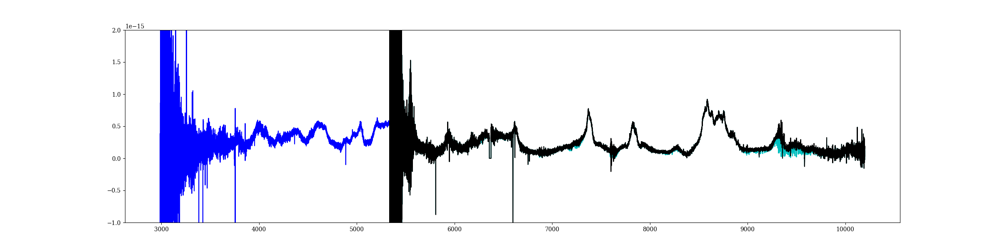

<IPython.core.display.Javascript object>


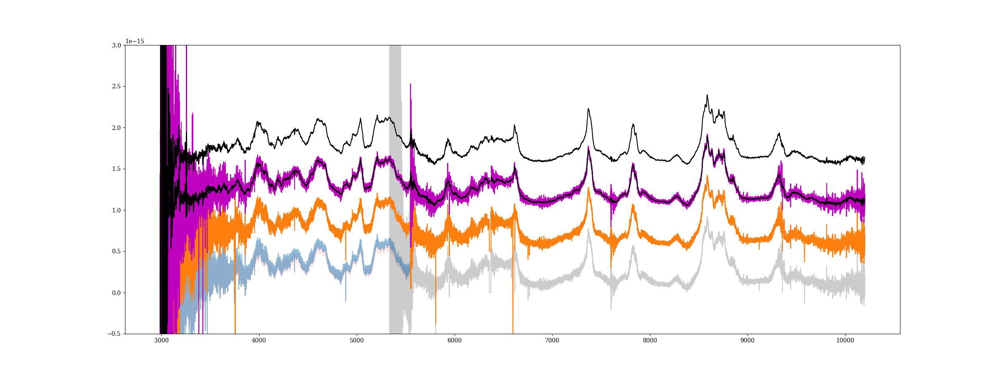

scale factor for UVB: 1.1162812282455328


In [31]:
#20230121

uvb3 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_20230120.txt')
vis3 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_VIS_20230120.txt')
nir3 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_NIR_20230120.txt')

fig, ax = plt.subplots(figsize=(24,6))



ax.plot(uvb3[:,0], uvb3[:,1], 'b')
ax.plot(vis3[:,0], vis3[:,1], 'c')
# ax.plot(nir3[:,0], nir3[:,1], 'r')

#VIS band after telluric correction
hdu = fits.open('../data/spectra/xshooter/tellcorr/sn2022jli_20230121_VIS/SN2022jli_EPOCH_3_SCIENCE_TELLURIC_CORR.fits')
ws = (hdu[0].header['CRVAL1'] + np.arange(len(hdu[0].data))*hdu[0].header['CDELT1'])*10
fs = hdu[0].data
vis_tellcor = np.array([ws, fs]).transpose()

ax.plot(vis_tellcor[:,0], vis_tellcor[:,1], 'k')


ax.set_ylim([-1e-15, 2e-15])






### stitched

fig, ax = plt.subplots(figsize=(24,9))

xs_stitched = np.array([])
ys_stitched = np.array([])



vis_xs_comb = vis_tellcor[:,0]
vis_ys_comb = vis_tellcor[:,1]
uvb_xs_comb = uvb3[:,0]
uvb_ys_comb = uvb3[:,1]

ax.plot(uvb_xs_comb, uvb_ys_comb, 'r', alpha=0.1)
ax.plot(vis_xs_comb, vis_ys_comb, 'k', alpha=0.2)

#UVB+VIS
uvb_vis_overlap = [5450, 5550]

ref_xs = vis_xs_comb[(vis_xs_comb>uvb_vis_overlap[0])*(vis_xs_comb<uvb_vis_overlap[1])]
#print(ref_xs)
ref_ys = vis_ys_comb[(vis_xs_comb>uvb_vis_overlap[0])*(vis_xs_comb<uvb_vis_overlap[1])]
uvb_interp = interp1d(uvb_xs_comb, uvb_ys_comb, kind='nearest')
uvb_ys_temp = uvb_interp(ref_xs)
scale = np.median(ref_ys/uvb_ys_temp)
print('scale factor for UVB:', scale)
ax.plot(uvb_xs_comb, uvb_ys_comb*scale, alpha=0.5)

xs_stitched = np.append(xs_stitched, uvb_xs_comb[uvb_xs_comb<uvb_vis_overlap[1]])
ys_stitched = np.append(ys_stitched, uvb_ys_comb[uvb_xs_comb<uvb_vis_overlap[1]]*scale)

# xs_stitched = np.append(xs_stitched, ref_xs)
# ys_stitched = np.append(ys_stitched, (uvb_ys_temp*scale+ref_ys)/2.0)

xs_stitched3 = np.append(xs_stitched, vis_xs_comb[vis_xs_comb>uvb_vis_overlap[1]])
ys_stitched3 = np.append(ys_stitched, vis_ys_comb[vis_xs_comb>uvb_vis_overlap[1]])


ax.plot(xs_stitched3, ys_stitched3+5e-16)



xls = [3756, 5808.5, 6355, ]
xrs = [3759, 5809.5, 6376, ]

xls_hostlines = [3745,  4886.5, 6582.5, 6596.5, 6617, 6751, 6766, 9117.5, 9581] #[OII] 3726, 3729, Hbeta 4861, [NII] 6548,6583, Halpha, [SII] 6717,6731, [SIII] 9069, 9532
xrs_hostlines = [3750,  4889.5, 6585.5, 6601, 6621, 6755, 6770, 9120.5, 9586]


xs_clean, ys_clean = remove_xsh_spec_artifact(xs_stitched3, ys_stitched3, xls, xrs)
xs_clean3, ys_clean3 = remove_xsh_spec_artifact(xs_clean, ys_clean, xls_hostlines, xrs_hostlines)


ax.plot(xs_clean3, ys_clean3+1e-15, 'm')


ys_smooth3 = savgol_filter(ys_clean3, 51, 2)
ax.plot(xs_clean3, ys_smooth3+1e-15, color='k')
ax.plot(xs_clean3, ys_smooth3+1.5e-15, color='k')


ax.set_ylim([-5e-16, 3e-15])




np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230120.txt', np.array([xs_stitched3, ys_stitched3]).transpose())
np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230120_clean.txt', np.array([xs_clean3, ys_clean3]).transpose())
np.savetxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230120_clean_smooth.txt', np.array([xs_clean3, ys_smooth3]).transpose())

In [474]:

jd = Time('2023-01-14T01:12:51.338', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,4), np.round(phase,1))
specs_22jli['xsh0114'] = {'phase':phase,'jd': jd,  'instrument':'XSHOOTER', 'telescope':'VLT', 'specfile':'../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113_clean.txt', 'specfile_smooth': '../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113_clean_smooth.txt', "exptime":450*2}

specdata = np.loadtxt(specs_22jli['xsh0114']['specfile'])
specs_22jli['xsh0114']['spec'] = specdata

specdata = np.loadtxt(specs_22jli['xsh0114']['specfile_smooth'])
specs_22jli['xsh0114']['spec_smooth'] = specdata


jd = Time('2023-01-18T01:03:33.211', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,4), np.round(phase,1))
specs_22jli['xsh0118'] = {'phase':phase,'jd': jd,  'instrument':'XSHOOTER', 'telescope':'VLT', 'specfile':'../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230117_clean.txt', 'specfile_smooth': '../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230117_clean_smooth.txt', "exptime":450*2}

specdata = np.loadtxt(specs_22jli['xsh0118']['specfile'])
specs_22jli['xsh0118']['spec'] = specdata

specdata = np.loadtxt(specs_22jli['xsh0118']['specfile_smooth'])
specs_22jli['xsh0118']['spec_smooth'] = specdata


jd = Time('2023-01-21T01:05:22.834', format='isot').jd 
phase = jd-t0_22jli
print(np.round(jd,4), np.round(phase,1))
specs_22jli['xsh0121'] = {'phase':phase,'jd': jd,  'instrument':'XSHOOTER', 'telescope':'VLT', 'specfile':'../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230120_clean.txt', 'specfile_smooth': '../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230120_clean_smooth.txt', "exptime":450*2}

specdata = np.loadtxt(specs_22jli['xsh0121']['specfile'])
specs_22jli['xsh0121']['spec'] = specdata

specdata = np.loadtxt(specs_22jli['xsh0121']['specfile_smooth'])
specs_22jli['xsh0121']['spec_smooth'] = specdata

2459958.5506 253.9
2459962.5441 257.9
2459965.5454 260.9


In [523]:
# xsh spectra extinction correction and flux calibration 

xsh_specnames = [specname for specname in specs_22jli.keys() if ('xsh' in specname and specs_22jli[specname]['instrument']=='XSHOOTER')]
print(xsh_specnames)

spec_photcal_dir = '../data/spectra/photcal_version/'

for specname in xsh_specnames:
    
    specfile = specs_22jli[specname]['specfile'].split('/')[-1]
    
    calflts = ['g', 'r']

    calmags = sed_mag_dict[specname].copy()
    #print(calmags)
    specdata = specs_22jli[specname]['spec'].copy()
        
    polyfunc, polyobj = spectrum_flux_calibrate(specdata, filter_curves,  calflts, calmags, polyorder=0, display=0)
    specdata[:,1] = polyfunc(polyobj.params, specdata[:,0])*specdata[:,1]
    np.savetxt(os.path.join(spec_photcal_dir, specfile), specdata)
    specs_22jli[specname]['spec_photcal'] = specdata
    
    
    
    
    
    specfile = specs_22jli[specname]['specfile_smooth'].split('/')[-1]
    specdata = specs_22jli[specname]['spec_smooth'].copy()
    polyfunc, polyobj = spectrum_flux_calibrate(specdata, filter_curves,  calflts, calmags, polyorder=0, display=0)
    specdata[:,1] = polyfunc(polyobj.params, specdata[:,0])*specdata[:,1]
    np.savetxt(os.path.join(spec_photcal_dir, specfile), specdata)
    specs_22jli[specname]['spec_photcal_smooth'] = specdata
    

['xsh0114', 'xsh0118', 'xsh0121']


<IPython.core.display.Javascript object>


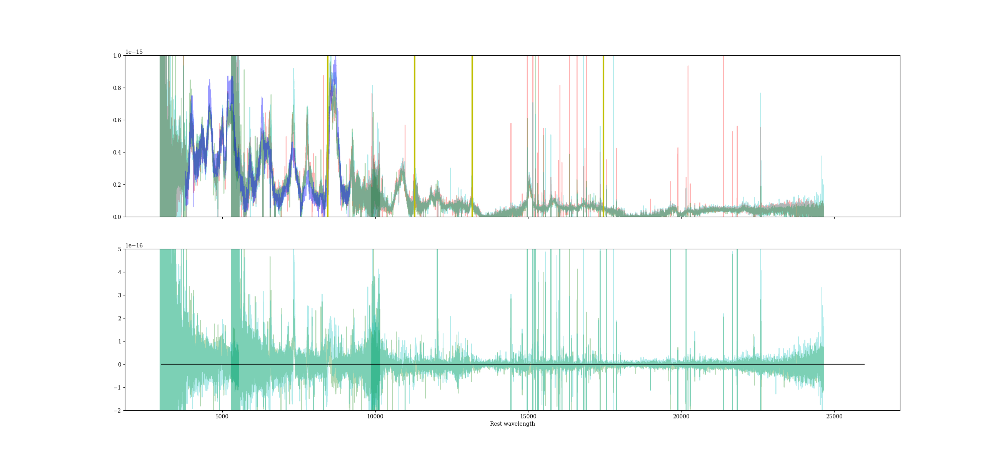

Text(0.5, 0, 'Rest wavelength')

In [346]:
fig, (ax, ax2) = plt.subplots(2,1, figsize=(26,12), sharex=True)


ubvspec1 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_20230113.txt')
ubvspec2 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_20230117.txt')
ubvspec3 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_20230120.txt')

xs = ubvspec1[:,0]/(1+z_22jli)
ys = ubvspec1[:,1]
ax.plot(xs, ys, 'r', label='XSH 2023-1-14 UBV', alpha=0.3)

xs = ubvspec2[:,0]/(1+z_22jli)
ys = ubvspec2[:,1]*0.78
ax.plot(xs, ys, 'g', label='XSH 2023-1-18 UBV', alpha=0.3)

xs = ubvspec3[:,0]/(1+z_22jli)
ys = ubvspec3[:,1]*1.2
ax.plot(xs, ys, 'c', label='XSH 2023-1-21 UBV', alpha=0.3)

ax2.plot(xs, ubvspec2[:,1]*0.78 - ubvspec1[:,1], 'g', alpha=0.3)
ax2.plot(xs, ubvspec3[:,1]*1.20 - ubvspec1[:,1], 'c', alpha=0.3)

nirspec1 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_NIR_20230113.txt')
nirspec2 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_NIR_20230117.txt')
nirspec3 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_NIR_20230120.txt')



xs = nirspec1[:,0]/(1+z_22jli)
ys = nirspec1[:,1]
ax.plot(xs, ys, 'r', label='XSH 2023-1-14 NIR', alpha=0.3)

xs = nirspec2[:,0]/(1+z_22jli)
ys = nirspec2[:,1]*0.78
ax.plot(xs, ys, 'g', label='XSH 2023-1-18 NIR', alpha=0.3)

xs = nirspec3[:,0]/(1+z_22jli)
ys = nirspec3[:,1]*1.20
ax.plot(xs, ys, 'c', label='XSH 2023-1-18 NIR', alpha=0.3)

ax2.plot(xs, nirspec2[:,1]*0.78 - nirspec1[:,1], 'g', alpha=0.3)
ax2.plot(xs, nirspec3[:,1]*1.20 - nirspec1[:,1], 'c', alpha=0.3)


specname = 'xsh0114'
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys1 = spec[:,1]
ax.plot(xs, ys1, 'r', label='XSH 2023-1-14 VIS', alpha=0.3)

specname = 'xsh0118'
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys2 = spec[:,1]*0.78
ax.plot(xs, ys2, 'g', label='XSH 2023-1-18 VIS', alpha=0.3)

specname = 'xsh0121'
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys3 = spec[:,1]*1.2
ax.plot(xs, ys3, 'c', label='XSH 2023-1-21 VIS', alpha=0.3)

ax2.plot(xs, ys2- ys1, 'g', alpha=0.3)
ax2.plot(xs, ys3- ys1, 'c', alpha=0.3)
ax2.hlines(0, xmin=3000,xmax=26000, colors='k')

show_imacs1214 = 0
if show_imacs1214:
    specname = 'imacs1214'
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]*0.7
    ax.plot(xs, ys, 'b', alpha=0.4, label='IMACS 2022-12-14')

show_binospec0131 = 1
if show_binospec0131:
    specname = 'binospec0131'
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]*3
    ax.plot(xs, ys, 'b', alpha=0.4, label='BINOSPEC 2023-01-31')

ax.vlines([11290, 13168, 17458], ymin=0, ymax=1e-15, colors='y', lw=3)  # OI lines from https://articles.adsabs.harvard.edu/pdf/2002MNRAS.329..787L    11290 and 13168 are stronger than 17458
ax.vlines([8446.5], ymin=0, ymax=1e-15, colors='y', lw=3)  # OI lines from https://articles.adsabs.harvard.edu/pdf/2002MNRAS.329..787L    


#ax.set_xlim([3000,9500])
ax.set_ylim([0,1e-15])
ax2.set_ylim([-2e-16, 5e-16])

ax2.set_xlabel('Rest wavelength')

<IPython.core.display.Javascript object>


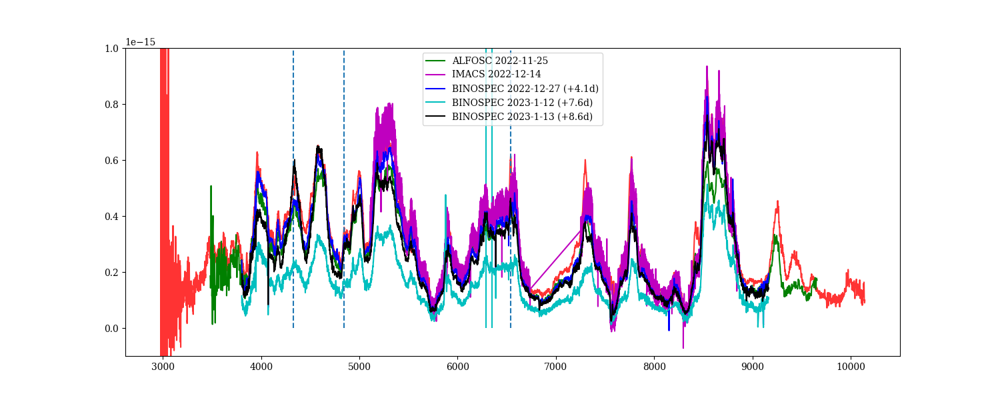

(-1e-16, 1e-15)

In [384]:
xsh0113 = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113_clean_smooth.txt')

fig, ax = plt.subplots(figsize=(15,6))


xs = xsh0113[:,0]/(1+z_22jli)
ys = xsh0113[:,1]
ax.plot(xs, ys, color='r', alpha=0.8)


vshift=-1050
ax.vlines(np.array([6563, 4861, 4340])*(1+vshift/300000.) , ymin=0, ymax=1.4e-15, linestyles='dashed')
vshift = -500
ax.vlines(np.array([6300, 6363])*(1+vshift/300000.) , ymin=0, ymax=1.4e-15, linestyles='solid', colors='c')



show_not1125 = 1
if show_not1125:
    specname = 'not1125'  #
    spec = specs_22jli[specname]['spec_photcal']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]*0.4
    ax.plot(xs, ys, 'g', label='ALFOSC 2022-11-25')
    #ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='r', va='center', fontsize=15)

show_imacs1214 = 1
if show_imacs1214:
    specname = 'imacs1214'
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]*0.7
    ax.plot(xs, ys, 'm', label='IMACS 2022-12-14')
    #ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='k', va='center', fontsize=15)
    
show_binospec1227=1
if show_binospec1227:
    specname = 'binospec1227'  #
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]*0.6
    ax.plot(xs, ys, 'b', label='BINOSPEC 2022-12-27 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )

show_binospec0112=1
if show_binospec0112:
    specname = 'binospec0112'  #
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]*0.8
    ax.plot(xs, ys, 'c', label='BINOSPEC 2023-1-12 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )

show_binospec0113 = 1
if show_binospec0113:
    specname = 'binospec0113'  #
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]*0.75
    ax.plot(xs, ys, 'k', label='BINOSPEC 2023-1-13 (+%sd)'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ) )

    
ax.legend(loc=0)
ax.set_ylim([-1e-16, 1e-15])

### zoom-in view of Halpha region

show that the host Halpha contamination 
show the 2d image Halpha shift from the host galaxy



In [7]:
hdu = fits.open('../data/spectra/xshooter/spec2d_20220113.fits')
spec2d01 = hdu[0].data
hdu = fits.open('../data/spectra/xshooter/spec2d_20220117.fits')
spec2d02 = hdu[0].data
hdu = fits.open('../data/spectra/xshooter/spec2d_20220120.fits')
spec2d03 = hdu[0].data



specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113.txt')
xs1 =  specdata[:,0]
ys1 =  specdata[:,1]
specdata = np.loadtxt('../data/spectra/photcal_version/SN2022jli_xshooter_UVB_VIS_20230113_clean.txt')
xs1_clean = specdata[:,0]
ys1_clean = specdata[:,1]
specdata = np.loadtxt('../data/spectra/photcal_version/SN2022jli_xshooter_UVB_VIS_20230113_clean_smooth.txt')
xs1_sm = specdata[:,0]
ys1_sm = specdata[:,1]

specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230117.txt')
xs2 =  specdata[:,0]
ys2 =  specdata[:,1]
specdata = np.loadtxt('../data/spectra/photcal_version/SN2022jli_xshooter_UVB_VIS_20230117_clean.txt')
xs2_clean = specdata[:,0]
ys2_clean = specdata[:,1]
specdata = np.loadtxt('../data/spectra/photcal_version/SN2022jli_xshooter_UVB_VIS_20230117_clean_smooth.txt')
xs2_sm = specdata[:,0]
ys2_sm = specdata[:,1]

specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230120.txt')
xs3 =  specdata[:,0]
ys3 =  specdata[:,1]
specdata = np.loadtxt('../data/spectra/photcal_version/SN2022jli_xshooter_UVB_VIS_20230120_clean.txt')
xs3_clean = specdata[:,0]
ys3_clean = specdata[:,1]
specdata = np.loadtxt('../data/spectra/photcal_version/SN2022jli_xshooter_UVB_VIS_20230120_clean_smooth.txt')
xs3_sm = specdata[:,0]
ys3_sm = specdata[:,1]

<IPython.core.display.Javascript object>


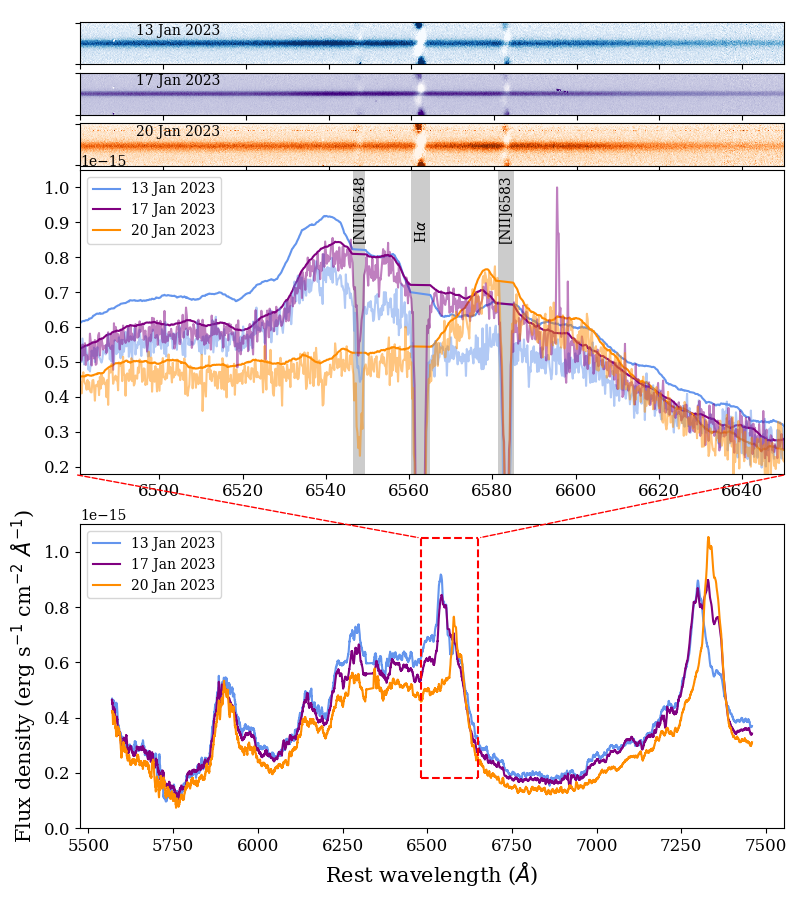

In [12]:

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'

fig = plt.figure(figsize=(8,9))

Ncol = 3
Nrow = 16
gs0 = GridSpec(Nrow, Ncol, figure=fig, hspace=0.0, wspace=0.1, left=0.1, right=0.98, bottom=0.08, top=0.98)

ax1 = fig.add_subplot(gs0[0, :])
ax2 = fig.add_subplot(gs0[1, :])
ax3 = fig.add_subplot(gs0[2, :])

ax1.imshow(spec2d01[25:76, 5900:6751],  interpolation='none', origin='lower', vmin=-1e-17, vmax=6e-17, cmap='Blues') 
ax2.imshow(spec2d02[25:76, 5900:6751],  interpolation='none', origin='lower', vmin=-7e-17, vmax=1.4e-16, cmap='Purples') #inferno  magma
ax3.imshow(spec2d03[25:76, 5900:6751],  interpolation='none', origin='lower', vmin=-1e-17, vmax=6e-17, cmap='Oranges') 
ax1.set_xticklabels([])
ax2.set_xticklabels([])
ax3.set_xticklabels([])

ax1.set_yticklabels([])
ax2.set_yticklabels([])
ax3.set_yticklabels([])

ws = np.arange(start=5900, stop=6751, step=1)*0.2+5336.6

label1 = '13 Jan 2023'
label2 = '17 Jan 2023'
label3 = '20 Jan 2023'

ax1.text(0.08, 0.7, label1, color='k', transform=ax1.transAxes)
ax2.text(0.08, 0.7, label2, color='k', transform=ax2.transAxes)
ax3.text(0.08, 0.7, label3, color='k', transform=ax3.transAxes)




ax4 = fig.add_subplot(gs0[3:9, :])

##the second epoch seeing is much better than the other two
#acquisition image fwhm: 8.9, 4.9, and 8.3

color1= 'cornflowerblue'
color2= 'purple'
color3= 'darkorange'



xcut1 = 5600
xcut2 = 7500

ax0 = fig.add_subplot(gs0[10:16, :])
mask = (xs1_clean>xcut1)*(xs1_clean<xcut2)
#ax0.plot(xs1_clean[mask],ys1_clean[mask], alpha=0.3)
ax0.plot(xs1_sm[mask]/(1+z_22jli),ys1_sm[mask], alpha=1, color=color1, label=label1)
ax4.plot(xs1_sm[mask]/(1+z_22jli),ys1_sm[mask], alpha=1, color=color1, label=label1)
mask = (xs2_clean>xcut1)*(xs2_clean<xcut2)
#ax0.plot(xs2_clean[mask],ys2_clean[mask], alpha=0.3, label=label2)
ax0.plot(xs2_sm[mask]/(1+z_22jli),ys2_sm[mask], alpha=1, color=color2, label=label2)
ax4.plot(xs2_sm[mask]/(1+z_22jli),ys2_sm[mask], alpha=1, color=color2, label=label2)
mask = (xs3_clean>xcut1)*(xs3_clean<xcut2)
#ax0.plot(xs3_clean[mask],ys3_clean[mask], alpha=0.3, label=label3)
ax0.plot(xs3_sm[mask]/(1+z_22jli),ys3_sm[mask], alpha=1, color=color3, label=label3)
ax4.plot(xs3_sm[mask]/(1+z_22jli),ys3_sm[mask], alpha=1, color=color3, label=label3)
ax0.set_ylim([0, 1.1e-15])
#ax0.set_xlim([6516.6, 6686.6])
ax0.legend(loc=2)
ax0.tick_params(labelsize=12)
ax0.set_xlabel(r'Rest wavelength ($\AA$)', fontsize=15)
ax0.set_ylabel(r'Flux density (erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$)', fontsize=15)
ax4.legend(loc=2)



xcut1 = 6516.6
xcut2 = 6686.6

xlim1 = xcut1/(1+z_22jli)
xlim2 = xcut2/(1+z_22jli)

ylim1 = 1.8e-16
ylim2 = 1.05e-15

ax0.vlines([xlim1, xlim2], ymin=ylim1, ymax=ylim2, linestyles='dashed', colors='r')
ax0.hlines([ylim1, ylim2], xmin=xlim1, xmax=xlim2, linestyles='dashed', colors='r')
ax0.annotate("",color='k', xy=(xlim1, ylim2), ha='center', xycoords='data',xytext=(5460, 1.28e-15), textcoords='data', arrowprops=dict(arrowstyle="-", connectionstyle="arc3", color='r', linestyle = "--"),)
ax0.annotate("",color='k', xy=(xlim2, ylim2), ha='center', xycoords='data',xytext=(7560, 1.28e-15), textcoords='data',arrowprops=dict(arrowstyle="-", connectionstyle="arc3", color='r', linestyle = "--"),)



mask = (xs1>xcut1)*(xs1<xcut2)
ax4.plot(xs1[mask]/(1+z_22jli),ys1[mask]*1.22, alpha=0.5, color=color1, label=label1)
mask = (xs2>xcut1)*(xs2<xcut2)
ax4.plot(xs2[mask]/(1+z_22jli),ys2[mask]*1.03, alpha=0.5, color=color2, label=label2)
mask = (xs3>xcut1)*(xs3<xcut2)
ax4.plot(xs3[mask]/(1+z_22jli),ys3[mask]*1.34, alpha=0.5,  color=color3, label=label3)
ax4.set_ylim([ylim1, ylim2])
ax4.set_xlim([xlim1, xlim2])
ax4.tick_params(labelsize=12)

ymax = 1.05e-15
ymin = 1.8e-16

#xls_hostlines = [3745,  4886.5, 6582.5, 6596.5, 6617, 6751, 6766, 9117.5, 9581] #[OII] 3726, 3729, Hbeta 4861, [NII] 6548,6583, Halpha, [SII] 6717,6731, [SIII] 9069, 9532
#xrs_hostlines = [3750,  4889.5, 6585.5, 6601, 6621, 6755, 6770, 9120.5, 9586]
ax4.fill_between([6582.5/(1+z_22jli),6585.5/(1+z_22jli)], [ymax, ymax], [ymin, ymin], alpha=0.2, color='k', edgecolor='none')
ax4.fill_between([6596.5/(1+z_22jli),6601/(1+z_22jli)], [ymax, ymax], [ymin, ymin], alpha=0.2, color='k', edgecolor='none')
ax4.fill_between([6617.5/(1+z_22jli),6621.5/(1+z_22jli)], [ymax, ymax], [ymin, ymin], alpha=0.2, color='k', edgecolor='none')

ax4.text(6548, 8.5e-16, '[NII]6548', rotation=90, ha='center')
ax4.text(6583, 8.5e-16, '[NII]6583', rotation=90, ha='center')
ax4.text(6563, 8.5e-16, r'H$\alpha$', rotation=90, ha='center')

plt.savefig('../plots/sn2022jli_Xshooter_Halpha_zoomin.pdf')

### Halpha and Hbeta coevolution

<IPython.core.display.Javascript object>


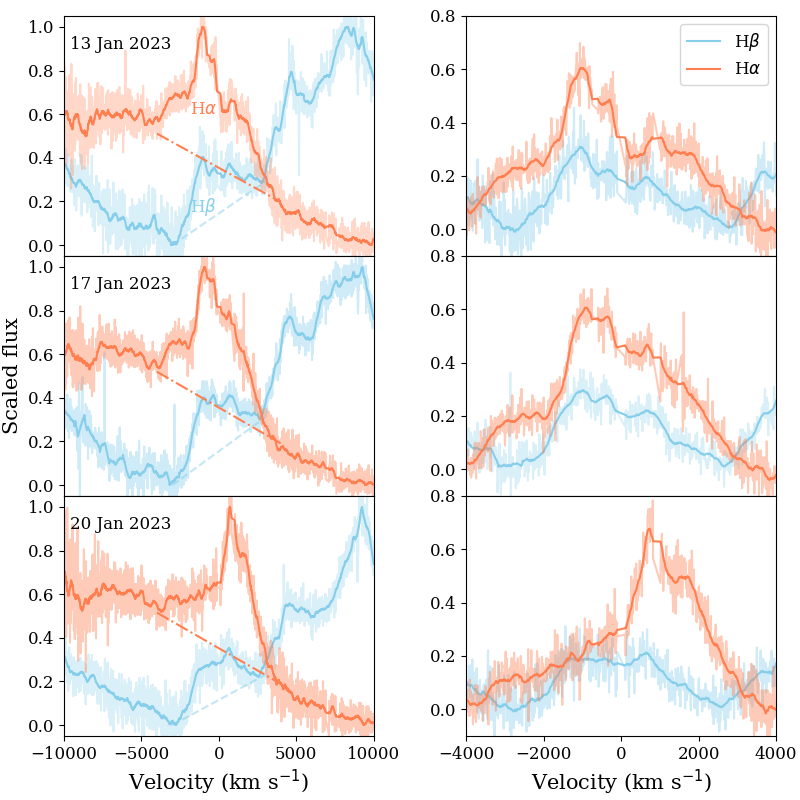

In [13]:
#fig, (ax, ax2) = plt.subplots(2,1, figsize=(8,12))
#fig, ax = plt.subplots(1,1, figsize=(8,10))


specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113_clean.txt')
xs_clean1 =  specdata[:,0]
ys_clean1 =  specdata[:,1]
specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230113_clean_smooth.txt')
ys_smooth1 =  specdata[:,1]

specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230117_clean.txt')
xs_clean2 =  specdata[:,0]
ys_clean2 =  specdata[:,1]
specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230117_clean_smooth.txt')
ys_smooth2 =  specdata[:,1]

specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230120_clean.txt')
xs_clean3 =  specdata[:,0]
ys_clean3 =  specdata[:,1]
specdata = np.loadtxt('../data/spectra/xshooter/SN2022jli_xshooter_UVB_VIS_20230120_clean_smooth.txt')
ys_smooth3 =  specdata[:,1]

wHalpha = 6562.79
wHbeta = 4861.35

vl = -10000
vr = 10000

color1 = 'skyblue'
color2 = 'coral'

fig = plt.figure(figsize=(8,8))

Ncol = 2
Nrow = 3
gs0 = GridSpec(Nrow, Ncol, figure=fig, hspace=0.0, wspace=0.3, left=0.08, right=0.97, bottom=0.08, top=0.98)

ax1 = fig.add_subplot(gs0[0, 0])


xs_hb = (xs_clean1/(1+z_22jli) - wHbeta)/wHbeta*300000
mask = (xs_hb>vl)*(xs_hb<vr)

ymax = np.max(ys_smooth1[mask])
ymin = np.min(ys_smooth1[mask])

ys_hb = (ys_clean1-ymin)/(ymax-ymin)
ys_sm_hb = (ys_smooth1-ymin)/(ymax-ymin)
ax1.plot( xs_hb, ys_hb, color=color1, alpha=0.3, )
ax1.plot( xs_hb, ys_sm_hb,color=color1, alpha=1, )

x1 = -3000
y1 = 0
x2 = 3000
y2 = 0.29
ax1.plot([x1, x2], [y1, y2], '--', alpha=0.5, color=color1)


slope = (y2-y1)/(x2-x1)


ax1r = fig.add_subplot(gs0[0, 1])

ys_model = slope*(xs_hb+3000)
ax1r.plot(xs_hb, ys_hb-ys_model, color=color1, alpha=0.4,)
ax1r.plot(xs_hb, ys_sm_hb-ys_model, color=color1, alpha=1, label=r'H$\beta$')
ax1r.set_xlim([-4000, 4000])
ax1r.set_ylim([-0.1, 0.8])



xs_ha = (xs_clean1/(1+z_22jli)- wHalpha)/wHalpha*300000
mask = (xs_ha>vl)*(xs_ha<vr)

ymax = np.max(ys_smooth1[mask])
ymin = np.min(ys_smooth1[mask])
ys_ha = (ys_clean1-ymin)/(ymax-ymin)
ys_sm_ha = (ys_smooth1-ymin)/(ymax-ymin)
ax1.plot( xs_ha, ys_ha, color=color2, alpha=0.3, )
ax1.plot( xs_ha, ys_sm_ha, color=color2, alpha=1, )



#below is to get the linear baseline model for each spectrum with left wing and right wing points
mask1_left = (xs_ha>-8000)*(xs_ha<-4000)
xsample1 = xs_ha[mask1_left]
ysample1 = ys_ha[mask1_left]

mask2_right = (xs_ha>5000)*(xs_ha<8000)
xsample2 = xs_ha[mask2_right]
ysample2 = ys_ha[mask2_right]

xsample = np.concatenate((xsample1, xsample2))
ysample = np.concatenate((ysample1, ysample2))

ysample = ysample[np.argsort(xsample)]
xsample = xsample[np.argsort(xsample)]
fitobj_linear = polyfit(xsample, ysample, np.ones_like(xsample)*0.02, 1)
polyfunc_linear = polyfunctions(1)

Ha_mask = (xs_ha>-4000)*(xs_ha<4000)
Ha_xs = xs_ha[Ha_mask]
Ha_ys = ys_ha[Ha_mask]
base_ys = polyfunc_linear(fitobj_linear.params, Ha_xs)
ax1.plot(Ha_xs, base_ys, '-.', color=color2) #show the linear base line model
ax1r.plot(Ha_xs, Ha_ys-base_ys, color=color2, alpha=0.4, )
Ha_ys_sm = ys_sm_ha[Ha_mask]
ax1r.plot(Ha_xs, Ha_ys_sm-base_ys, color=color2, alpha=1,  label=r'H$\alpha$')


ax1.set_xlim([vl, vr])
ax1.set_ylim([-0.05, 1.05])
ax1.text(-9600, 0.9, '13 Jan 2023', fontsize=12)
ax1.set_xticks([])
ax1r.set_xticks([])


ax1r.legend(loc=0, fontsize=12)



ax2 = fig.add_subplot(gs0[1, 0])

xs_hb = (xs_clean2/(1+z_22jli) - wHbeta)/wHbeta*300000
mask = (xs_hb>vl)*(xs_hb<vr)

ymax = np.max(ys_smooth2[mask])
ymin = np.min(ys_smooth2[mask])

ys_hb = (ys_clean2-ymin)/(ymax-ymin)
ys_sm_hb = (ys_smooth2-ymin)/(ymax-ymin)

ax2.plot( xs_hb, ys_hb, color=color1, alpha=0.4, )
ax2.plot( xs_hb, ys_sm_hb,color=color1, alpha=1, )

x1 = -3000
y1 = 0
x2 = 3000
y2 = 0.31
ax2.plot([x1, x2], [y1, y2], '--', alpha=0.5, color=color1)
slope = (y2-y1)/(x2-x1)


ax2r = fig.add_subplot(gs0[1, 1])

ys_model = slope*(xs_hb+3000)
ax2r.plot(xs_hb, ys_hb-ys_model, color=color1, alpha=0.3,)
ax2r.plot(xs_hb, ys_sm_hb-ys_model, color=color1, alpha=1,)
ax2r.set_xlim([-4000, 4000])
ax2r.set_ylim([-0.1, 0.8])



xs_ha = (xs_clean2/(1+z_22jli)- wHalpha)/wHalpha*300000
mask = (xs_ha>vl)*(xs_ha<vr)

ymax = np.max(ys_smooth2[mask])
ymin = np.min(ys_smooth2[mask])
ys_ha = (ys_clean2-ymin)/(ymax-ymin)
ys_sm_ha = (ys_smooth2-ymin)/(ymax-ymin)
ax2.plot( xs_ha, ys_ha, color=color2, alpha=0.4, )
ax2.plot( xs_ha, ys_sm_ha,color=color2, alpha=1, )


#below is to get the linear baseline model for each spectrum with left wing and right wing points
mask1_left = (xs_ha>-8000)*(xs_ha<-4000)
xsample1 = xs_ha[mask1_left]
ysample1 = ys_ha[mask1_left]

mask2_right = (xs_ha>5000)*(xs_ha<8000)
xsample2 = xs_ha[mask2_right]
ysample2 = ys_ha[mask2_right]

xsample = np.concatenate((xsample1, xsample2))
ysample = np.concatenate((ysample1, ysample2))

ysample = ysample[np.argsort(xsample)]
xsample = xsample[np.argsort(xsample)]
fitobj_linear = polyfit(xsample, ysample, np.ones_like(xsample)*0.02, 1)
polyfunc_linear = polyfunctions(1)

Ha_mask = (xs_ha>-4000)*(xs_ha<4000)
Ha_xs = xs_ha[Ha_mask]
Ha_ys = ys_ha[Ha_mask]
base_ys = polyfunc_linear(fitobj_linear.params, Ha_xs)
ax2.plot(Ha_xs, base_ys, '-.', color=color2) #show the linear base line model
ax2r.plot(Ha_xs, Ha_ys-base_ys, color=color2, alpha=0.4, )
Ha_ys_sm = ys_sm_ha[Ha_mask]
ax2r.plot(Ha_xs, Ha_ys_sm-base_ys, color=color2, alpha=1, )

ax2.set_xlim([vl, vr])
ax2.set_ylim([-0.05, 1.05])
ax2.text(-9600, 0.9, '17 Jan 2023', fontsize=12)
ax2.set_xticks([])
ax2r.set_xticks([])
ax2.set_ylabel('Scaled flux', fontsize=15)



ax3 = fig.add_subplot(gs0[2, 0])

xs_hb = (xs_clean3/(1+z_22jli) - wHbeta)/wHbeta*300000
mask = (xs_hb>vl)*(xs_hb<vr)

ymax = np.max(ys_smooth3[mask])
ymin = np.min(ys_smooth3[mask])

ys_hb = (ys_clean3-ymin)/(ymax-ymin)
ys_sm_hb = (ys_smooth3-ymin)/(ymax-ymin)

ax3.plot( xs_hb, ys_hb, color=color1, alpha=0.3, )
ax3.plot( xs_hb, ys_sm_hb,color=color1, alpha=1, )


x1 = -3000
y1 = 0
x2 = 3000
y2 = 0.23
ax3.plot([x1, x2], [y1, y2], '--', alpha=0.5, color=color1)

slope = (y2-y1)/(x2-x1)


ax3r = fig.add_subplot(gs0[2, 1])

ys_model = slope*(xs_hb+3000)
ax3r.plot(xs_hb, ys_hb-ys_model, color=color1, alpha=0.4,)
ax3r.plot(xs_hb, ys_sm_hb-ys_model, color=color1, alpha=1,)

ax3r.set_xlim([-4000, 4000])
ax3r.set_ylim([-0.1, 0.8])


xs_ha = (xs_clean3/(1+z_22jli)- wHalpha)/wHalpha*300000
mask = (xs_ha>vl)*(xs_ha<vr)

ymax = np.max(ys_smooth3[mask])
ymin = np.min(ys_smooth3[mask])
ys_ha = (ys_clean3-ymin)/(ymax-ymin)
ys_sm_ha = (ys_smooth3-ymin)/(ymax-ymin)
ax3.plot( xs_ha, ys_ha,  color=color2, alpha=0.4, )
ax3.plot( xs_ha, ys_sm_ha,color=color2, alpha=1, )

#below is to get the linear baseline model for each spectrum with left wing and right wing points
mask1_left = (xs_ha>-8000)*(xs_ha<-4000)
xsample1 = xs_ha[mask1_left]
ysample1 = ys_ha[mask1_left]

mask2_right = (xs_ha>5000)*(xs_ha<8000)
xsample2 = xs_ha[mask2_right]
ysample2 = ys_ha[mask2_right]

xsample = np.concatenate((xsample1, xsample2))
ysample = np.concatenate((ysample1, ysample2))

ysample = ysample[np.argsort(xsample)]
xsample = xsample[np.argsort(xsample)]
fitobj_linear = polyfit(xsample, ysample, np.ones_like(xsample)*0.02, 1)
polyfunc_linear = polyfunctions(1)

Ha_mask = (xs_ha>-4000)*(xs_ha<4000)
Ha_xs = xs_ha[Ha_mask]
Ha_ys = ys_ha[Ha_mask]

base_ys = polyfunc_linear(fitobj_linear.params, Ha_xs)
ax3.plot(Ha_xs, base_ys, '-.', color=color2) #show the linear base line model
ax3r.plot(Ha_xs, Ha_ys-base_ys, color=color2, alpha=0.4, )
Ha_ys_sm = ys_sm_ha[Ha_mask]
ax3r.plot(Ha_xs, Ha_ys_sm-base_ys, color=color2, alpha=1, )

ax3.set_xlim([vl, vr])
ax3.set_ylim([-0.05, 1.05])
ax3.text(-9600, 0.9, '20 Jan 2023', fontsize=12)

ax1.text(-1000, 0.6, r'H$\alpha$', fontsize=12, color=color2, ha='center')
ax1.text(-1000, 0.15, r'H$\beta$', fontsize=12, color=color1, ha='center')



ax3.set_xlabel(r'Velocity (km s$^{-1}$)', fontsize=15)
ax3r.set_xlabel(r'Velocity (km s$^{-1}$)', fontsize=15)

ax1.tick_params(labelsize=12)
ax1r.tick_params(labelsize=12)
ax2.tick_params(labelsize=12)
ax2r.tick_params(labelsize=12)
ax3.tick_params(labelsize=12)
ax3r.tick_params(labelsize=12)

plt.savefig('../plots/Halpha_Hbeta_coevolution.pdf')
plt.savefig('../plots/Halpha_Hbeta_coevolution.png')

<IPython.core.display.Javascript object>


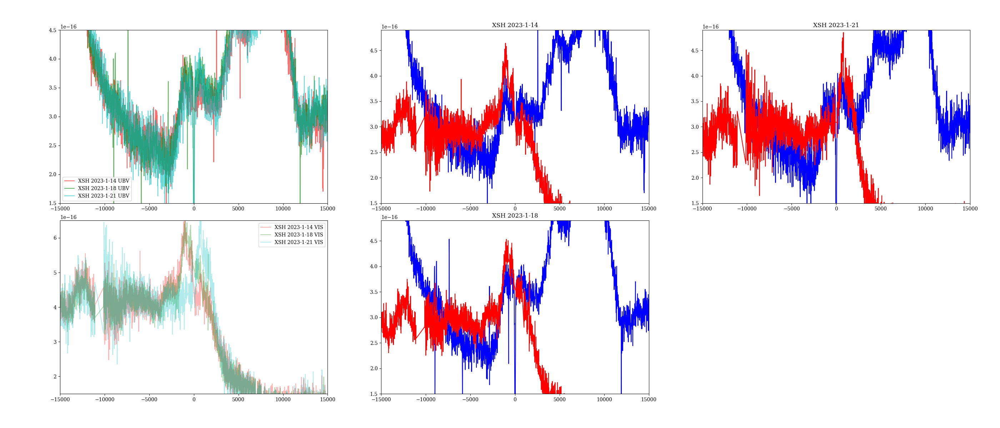

Text(0.5, 1.0, 'XSH 2023-1-21')

In [433]:
fig = plt.figure(figsize=(28,12))

Ncol = 3
Nrow = 2
gs0 = GridSpec(Nrow, Ncol, figure=fig, hspace=0.1, wspace=0.2, left=0.06, right=0.97, bottom=0.08, top=0.93)

ax = fig.add_subplot(gs0[0, 0])
ax2 = fig.add_subplot(gs0[1,0], sharex=ax)


ax3 = fig.add_subplot(gs0[0,1], sharex=ax)
ax4 = fig.add_subplot(gs0[1,1], sharex=ax)
ax5 = fig.add_subplot(gs0[0,2], sharex=ax)



xs = (xs_clean1/(1+z_22jli) - 4861.3)/4861.3 * 300000
ys = ys_clean1
ax.plot(xs, ys, 'r', label='XSH 2023-1-14 UBV', alpha=0.6)
ax3.plot(xs, ys, 'b')


xs = (ubvspec2[:,0]/(1+z_22jli)- 4861.3)/4861.3 * 300000
ys = ubvspec2[:,1]*0.78
ax.plot(xs, ys, 'g', label='XSH 2023-1-18 UBV', alpha=0.6)
ax4.plot(xs, ys, 'b')


xs = (ubvspec3[:,0]/(1+z_22jli)- 4861.3)/4861.3 * 300000
ys = ubvspec3[:,1]*1.25
ax.plot(xs, ys, 'c', label='XSH 2023-1-21 UBV', alpha=0.6)
ax5.plot(xs, ys, 'b')


ax.legend(loc=0)
ax.set_xlim([-15000,15000])
ax.set_ylim([1.5e-16, 4.5e-16])



specname = 'xsh0114'
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = (spec[:,0]/(1+z_22jli) - 6562.8)/6562.8 * 300000
ys1 = spec[:,1]
ax2.plot(xs, ys1, 'r', label='XSH 2023-1-14 VIS', alpha=0.3)
ax3.plot(xs, ys1*0.7, 'r')


specname = 'xsh0118'
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = (spec[:,0]/(1+z_22jli) - 6562.8)/6562.8 * 300000
ys2 = spec[:,1]*0.78
ax2.plot(xs, ys2, 'g', label='XSH 2023-1-18 VIS', alpha=0.3)
ax4.plot(xs, ys2*0.7, 'r')

specname = 'xsh0121'
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = (spec[:,0]/(1+z_22jli) - 6562.8)/6562.8 * 300000
ys3 = spec[:,1]*1.2
ax2.plot(xs, ys3, 'c', label='XSH 2023-1-21 VIS', alpha=0.3)
ax5.plot(xs, ys3*0.7, 'r')


ax2.legend(loc=0)
ax2.set_ylim([1.5e-16, 6.5e-16])


ax3.set_ylim([1.5e-16, 7e-16*0.7])
ax3.set_title('XSH 2023-1-14', fontsize=12)

ax4.set_ylim([1.5e-16, 7e-16*0.7])
ax4.set_title('XSH 2023-1-18', fontsize=12)

ax5.set_ylim([1.5e-16, 7e-16*0.7])
ax5.set_title('XSH 2023-1-21', fontsize=12)

### Halpha line evolution [plot for VLT proposal]

<IPython.core.display.Javascript object>


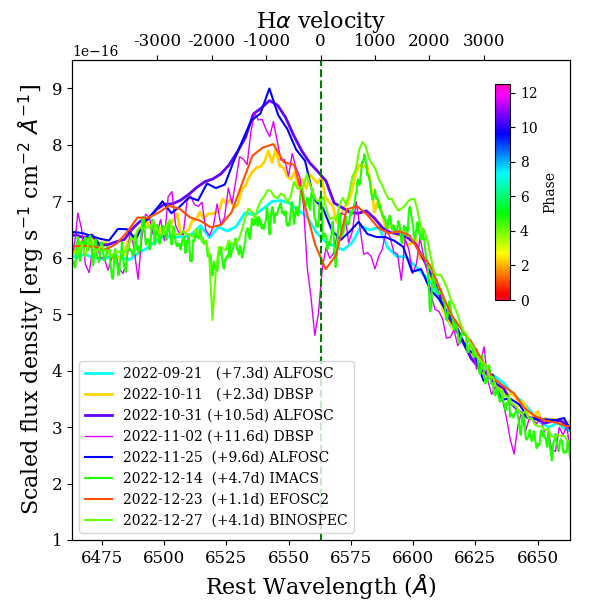

[6497.172 6519.048 6540.924 6562.8   6584.676 6606.552 6628.428]


In [347]:


cmap = mpl.cm.gist_rainbow
norm = mpl.colors.Normalize(vmin=0, vmax=12.5)


rcParams["figure.subplot.left"] = 0.12
rcParams["figure.subplot.right"] = 0.95
rcParams["figure.subplot.top"] = 0.9
rcParams["figure.subplot.bottom"] = 0.1

fig, ax = plt.subplots(figsize=(6, 6))

#ax.set_position([0.1,  0.1, 0.85, 0.8])


specname = 'not0921'  #
spec = specs_22jli[specname]['spec_photcal']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.3
bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1)
color = cmap(bumpphase/12.5)
ax.plot(xs, ys, color=color, lw=2, label='2022-09-21   (+%sd) ALFOSC'%str(bumpphase))
ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='g', va='center', fontsize=15)

specname = 'dbsp1011'  #
spec = specs_22jli[specname]['spec_photcal']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.35
bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1)
color = cmap(bumpphase/12.5)
ax.plot(xs, ys, color=color, lw=2, label='2022-10-11   (+%sd) DBSP'%str(bumpphase) )
ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='b', va='center', fontsize=15)

specname = 'not1031'  #
spec = specs_22jli[specname]['spec_photcal']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.45
bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1)
color= cmap(bumpphase/12.5)
ax.plot(xs, ys, color=color, lw=2, label='2022-10-31 (+%sd) ALFOSC'%str(bumpphase))
ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='c', va='center', fontsize=15)

specname = 'dbsp1102'  #
spec = specs_22jli[specname]['spec_photcal']
spec = np.loadtxt('/Users/chenping/Ping/docker_data/spec_reduction/DBSP/20221102/red/proc/SN2022jli_DBSP_20221102.txt')
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*1.05
bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) 
color = cmap(bumpphase/12.5)
ax.plot(xs, ys, color=color, lw=1, label='2022-11-02 (+%sd) DBSP'%str(bumpphase) )
ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='b', va='center', fontsize=15)


specname = 'not1125'  #
spec = specs_22jli[specname]['spec_photcal']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.6
bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1)
color = cmap(bumpphase/12.5)
ax.plot(xs, ys, color=color, label='2022-11-25  (+%sd) ALFOSC'%str(bumpphase))
ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='r', va='center', fontsize=15)

specname = 'imacs1214'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]
ys_sm = savgol_filter(ys, 11, 3)
bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) 
color = cmap(bumpphase/12.5)
#ax.plot(xs, ys, 'k', alpha=1, label='2022-12-14 (+%sd) IMACS'%str(np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1) ))
ax.plot(xs, ys_sm, color=color, alpha=1, label='2022-12-14  (+%sd) IMACS'%str(bumpphase))
ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='k', va='center', fontsize=15)


specname = 'efosc1223'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*1.4
bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1)
color = cmap(bumpphase/12.5)
ax.plot(xs, ys, color=color, label='2022-12-23  (+%sd) EFOSC2'%str(bumpphase))
ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='m', va='center', fontsize=15)


specname = 'binospec1227'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]
bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1)
color = cmap(bumpphase/12.5)
ax.plot(xs, ys, color=color, label='2022-12-27  (+%sd) BINOSPEC'%str(bumpphase) )
ax.text(9400, np.mean(ys[-10:])+1e-16, '+{:.0f}d'.format(phase), color='b', va='center', fontsize=15)




ax.vlines(np.array([6562.8]), ymin=0, ymax=3e-15, linestyles='dashed', colors='g')

#ax.set_xlim([4900,9100])
#ax.set_ylim([-1e-16, 3e-15])

#ax.set_yticks([])
ax.tick_params(labelsize=12)
ax.set_xlabel('Rest Wavelength ($\AA$)', fontsize=16)
ax.set_ylabel('Scaled flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]', fontsize=16)

ax.legend(loc=3)


axcolorbar =  ax.inset_axes([0.85, 0.5, 0.03, 0.45])
plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), cax=axcolorbar, orientation='vertical', label='Phase', anchor=(0, 0.5))



def func_v2lambda(v):
    c = 300000.
    w0 = 6562.8
    return v/c*w0+w0

ax.set_xlim([6563-100, 6563+100])
ax.set_ylim([1e-16,9.5e-16])

ax2 = ax.twiny()
vs_labels = [-3000, -2000, -1000, 0, 1000, 2000, 3000]
new_tick_locations = func_v2lambda(np.array(vs_labels))
print(new_tick_locations)
ax2.set_xlim(ax.get_xlim())
ax2.set_ylim(ax.get_ylim())
ax2.set_xticks(new_tick_locations)
ax2.set_xticklabels(vs_labels, fontsize=12)
ax2.set_xlabel(r'H$\alpha$ velocity', fontsize=16)

plt.savefig('./plots/imacs_spec.png')



plt.savefig('./plots/Halpha_evolution_zoomin.png')
plt.savefig('./plots/Halpha_evolution_zoomin.pdf')

### spectra comparison and subtraction 

<IPython.core.display.Javascript object>


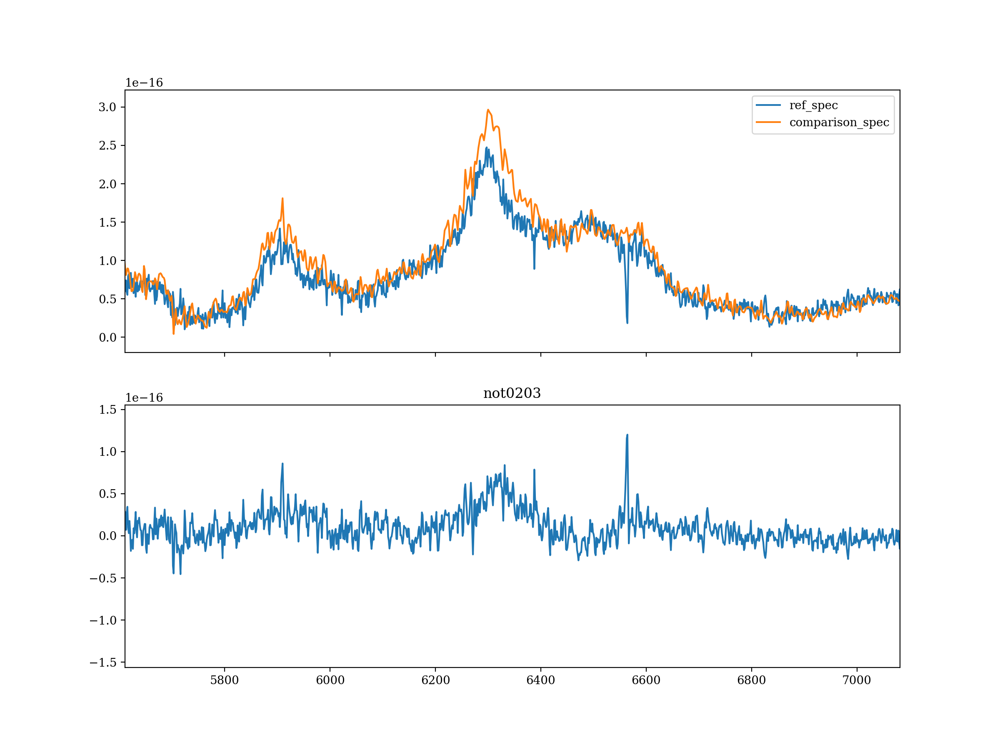

Text(0.5, 1.0, 'not0203')

In [164]:
#check individual spectrum by comparing with the reference spectrum

refspecname = 'binospec0131'
refspec = specs_22jli[refspecname]['spec']


fig, (ax, ax2) = plt.subplots(2,1, figsize=(12,9), sharex=True)

specname = 'not0203'
spec = specs_22jli[specname]['spec']


w1 = 3000
w2 = 9300

xs = refspec[:,0]
ys = refspec[:,1]
refxs = xs[(xs>w1)*(xs<w2)]
refys = ys[(xs>w1)*(xs<w2)]

scale = 6e-18
spec_interpfunc = interp1d(spec[:,0], spec[:,1]*scale, bounds_error=False, fill_value='extrapolate')
ys_interp = spec_interpfunc(refxs)
    
ax.plot(refxs/(1+z_22jli), refys, label='ref_spec')
ax.plot(refxs/(1+z_22jli), ys_interp, label='comparison_spec')
ax.legend(loc=0)
    
ax2.plot(refxs/(1+z_22jli), ys_interp-refys)
#ax2.set_ylim([0, 2])
ax2.set_title(specname)

<IPython.core.display.Javascript object>


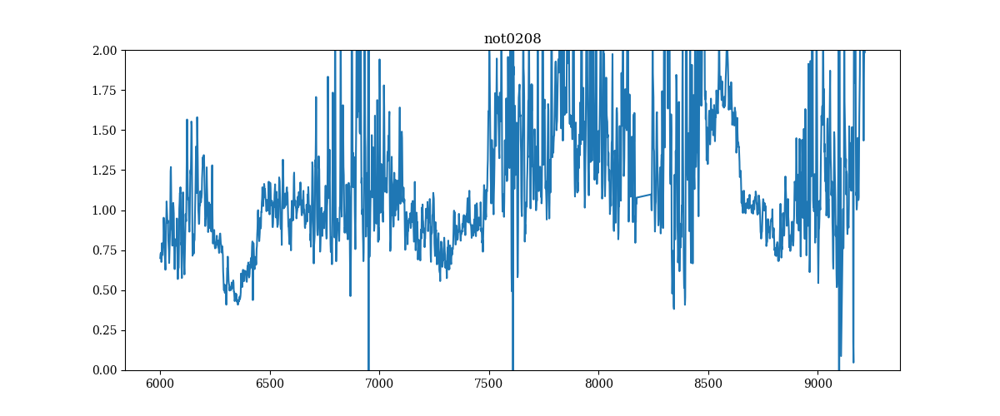

In [18]:
#specnames = ['not1031', 'dbsp1102', 'not1125', 'efosc1223',  'imacs1214', 'binospec1227', 'binospec0112', 'binospec0113', 'xsh0114', 'xsh0118', 'xsh0121', 'binospec0120', 'binospec0121']

#specnames = ['binospec0112', 'binospec0113', 'xsh0114', 'xsh0118', 'xsh0121', 'binospec0120', 'binospec0121', 'binospec0131']

#specnames = ['not1031', 'dbsp1102', 'not1125']

#specnames  = ['dbsp1011', 'not0921', 'dbsp0820']

specnames = ['not0208']

refspecname = 'binospec0112'
refspec = specs_22jli[refspecname]['spec']

w1 = 6000
w2 = 9300

xs = refspec[:,0]
ys = refspec[:,1]
refxs = xs[(xs>w1)*(xs<w2)]
refys = ys[(xs>w1)*(xs<w2)]

scales = {'dbsp0820':1.3e-18, 'not0921':3e-18, 'dbsp1011':2.8e-18, 'not1031':0.2, 'dbsp1102': 6e-18, 'not1125':5.5e-18, 'imacs1214':0.85, 'binospec1227':0.87, 'binospec0112':2, 'binospec0113':1.2, 
          'xsh0114':1.27, 'xsh0118':1, 'xsh0121':1.6, 'binospec0120':1.18*2, 'binospec0121':0.96*2, 'binospec0131':3.6, 'not0203':2.2e-17, 'not0208':4e-17,}
#for specname in specnames:
#    if specname in scales.keys():
#        scales[specname] = scales[specname]/scales[refspecname]
        
for specname in specnames:
    if specname == refspecname:
        continue
    fig, ax = plt.subplots(figsize=(12,5))
    if specname not in scales.keys():
        scale = 1
    else:
        scale = scales[specname]
        
    #ax.plot(refspec[:,0], refspec[:,1])
    spec = specs_22jli[specname]['spec']
    
    spec_interpfunc = interp1d(spec[:,0], spec[:,1]*scale, bounds_error=False, fill_value='extrapolate')
    ys_interp = spec_interpfunc(refxs)
    
    ax.plot(refxs, refys*scales[refspecname]/ys_interp)
    ax.set_ylim([0, 2])
    ax.set_title(specname)

In [20]:
def get_spec_data_dws(wavelengths):
    '''
    get the wavelength spaces 
    '''
    dws_temp = wavelengths[1:] - wavelengths[:-1]
    dws_left = np.append(dws_temp, dws_temp[-1])
    dws_right = np.append(dws_temp[::-1], dws_temp[0])[::-1]
    dws = (dws_left + dws_right)/2
    return dws


def get_intf_shift_width(f1_wavelengths, f1_fluxs, verbose=0):
    '''
    get integral flux, line center shift and line width from moments statistics
    '''
    dws = get_spec_data_dws(f1_wavelengths)
    zero_moment = np.sum(f1_fluxs*dws)
    first_moment = np.sum(f1_wavelengths*f1_fluxs*dws)
    centroid = first_moment/zero_moment  # normalized first momoent

    check = 0
    if check:
        ret = np.sum((f1_wavelengths-centroid)*f1_fluxs*dws)
        print("check result: %s" % ret)

    second_moment = np.sum((f1_wavelengths-centroid)**2*f1_fluxs*dws)
    # what to do if negative second moment obtained
    # one side (right side) tends to go negative which also affect the centroid measurement
    # ------------- to improve below -------------------
    if second_moment <= 0:
        length = np.max(f1_wavelengths) - np.min(f1_wavelengths)
        i = 0
        while i < 5:
            cutleft = centroid - 1.0/3*length
            cutright = centroid + 1.0/3*length
            mask = np.logical_and(f1_wavelengths > cutleft, f1_wavelengths < cutright)

            f1_wavelengths_new = f1_wavelengths[mask]
            f1_fluxs_new = f1_fluxs[mask]

            dws_new = get_spec_data_dws(f1_wavelengths_new)
            zero_moment = np.sum(f1_fluxs_new*dws_new)
            first_moment = np.sum(f1_wavelengths_new*f1_fluxs_new*dws_new)
            centroid = first_moment/zero_moment  # normalized first momoent
            i += 1

        second_moment = np.sum((f1_wavelengths_new-centroid)**2*f1_fluxs_new*dws_new)
        f1_wavelengths = f1_wavelengths_new
        f2_fluxs = f1_fluxs_new
    # ----------------- to improve above ------------------

    width = np.sqrt(second_moment/zero_moment)
    width = np.sqrt(second_moment/zero_moment)

    if verbose:
        print("The zeroth moment: %s" % zero_moment)
        print("The first moment: %s" % first_moment)
        print("The centroid: %s" % centroid)
        print("The second moment: %s" % second_moment)
        print("The width: %s" % width)

    return zero_moment, centroid, width

In [434]:
print(t0_22jli)
print(bump_peak_jd)

print(np.mod(t0_22jli-bump_peak_jd, 12.5))

2459704.67
2459923.9475376885
5.722462311387062


In [435]:
import warnings
warnings.filterwarnings('ignore')

### Main Fig 4

In [16]:
import pickle

outfile = '../data/spectra/2022jli.20230301.p' #load the spectra
with open(outfile, 'rb') as fp:
    specs_22jli = pickle.load(fp)

spectable = specs_22jli['spectable']
spectable.sort('phase')

<IPython.core.display.Javascript object>


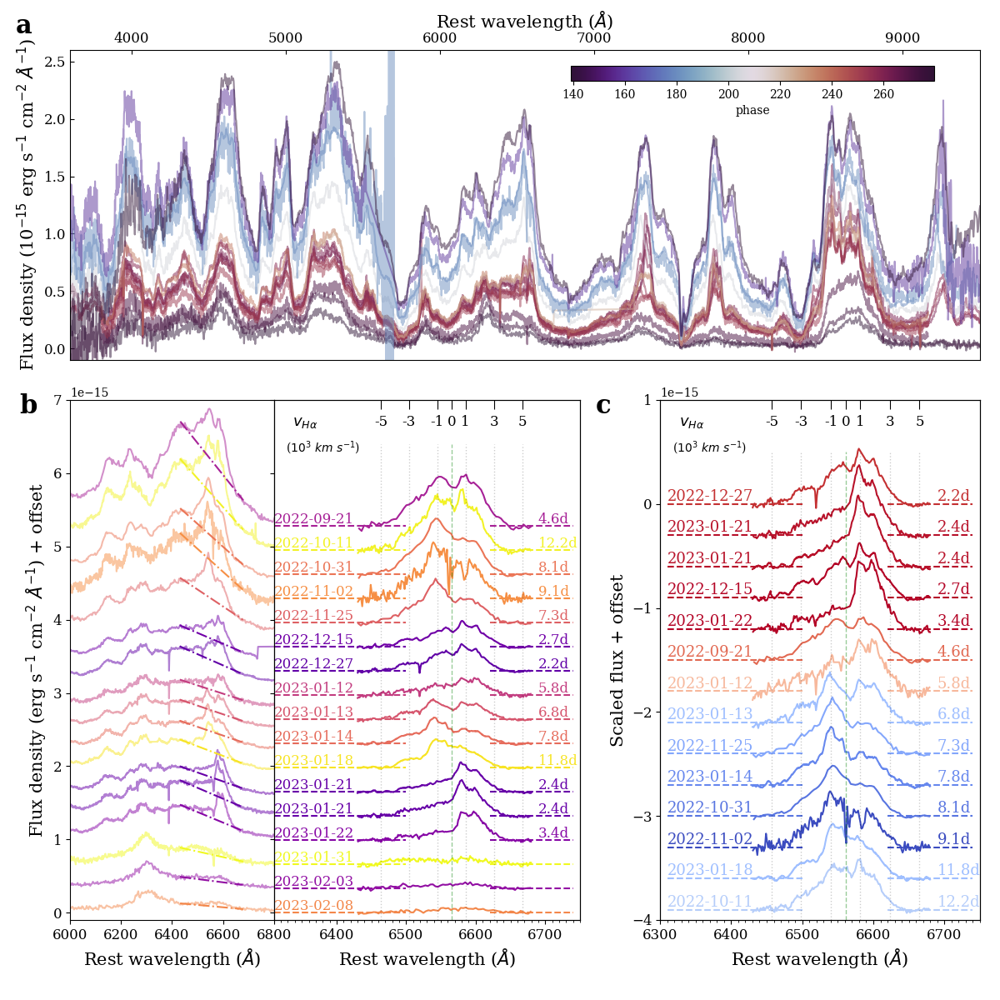

binospec0131 3.6
[False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False  True  True  True  True  True
  True  True False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False]
not0208 4e-17
bumpphase, colorphase: 8.794000000320

In [22]:
bump_peak_jd = 2459922.976
trise = 3
period = 12.4


specnames = np.array(['not0921', 'dbsp1011', 'not1031', 'dbsp1102', 'not1125', 'imacs1214', 'binospec1227', 'binospec0112', 'binospec0113', 'xsh0114', 'xsh0118', 'xsh0121', 'binospec0120', 'binospec0121', 'binospec0131', 'not0203', 'not0208'])

specnames = specnames[::-1]

#Assume the explosion time is > 10 days before the discovery (reasonable), all above spectra are > 150 days after explosion 

refspecname = 'binospec0131'
refspec = specs_22jli[refspecname]['spec']


matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]

fig = plt.figure(figsize=(12,12)) #wider version for presentation


cmap = mpl.cm.plasma
norm = mpl.colors.Normalize(vmin=0, vmax=12.5)

cmap2 = mpl.cm.twilight_shifted
phasemin = specs_22jli['not0921']['phase']
phasemax = specs_22jli['not0208']['phase']
norm = mpl.colors.Normalize(vmin=phasemin, vmax=phasemax)

cmap3 = mpl.cm.coolwarm
norm3 = mpl.colors.Normalize(vmin=0, vmax=12.5)

Ncol = 3
Nrow = 1
gs = GridSpec(Nrow, Ncol, figure=fig, hspace=0.1, wspace=0.2, left=0.07, right=0.98, bottom=0.64, top=0.95)

ax0 = fig.add_subplot(gs[0, 0:3])

Ncol = 5
Nrow = 1
gs = GridSpec(Nrow, Ncol, figure=fig, hspace=0.0, wspace=0.0, left=0.07, right=0.58, bottom=0.08, top=0.6)

ax1 = fig.add_subplot(gs[0, 0:2])
ax2 = fig.add_subplot(gs[0,2:5])


Ncol = 1
Nrow = 1
gs = GridSpec(Nrow, Ncol, figure=fig, hspace=0.2, wspace=0.0, left=0.66, right=0.98, bottom=0.08, top=0.6)

ax3 = fig.add_subplot(gs[0, 0])


offset = 3e-16
offset2 = 3.3e-16
offset3 = 3e-16
refscale = scales[refspecname]

print(refspecname, refscale)


refxs = refspec[:,0]/(1+z_22jli)
refys = refspec[:,1]*refscale
fitmask = (refxs>6470)*(refxs<6670)
fitxs = refxs[fitmask]
fitys = refys[fitmask]
Ha_mask = (fitxs>6557)*(fitxs<6567)
print(Ha_mask)
fitxs = fitxs[~Ha_mask]
fitys = fitys[~Ha_mask]
xpivot = np.mean(fitxs)
ymean = np.mean(fitys)

polyorder = 3
fitobj = polyfit(fitxs-xpivot, fitys/ymean, fitys/ymean*0.05, polyorder)  #this use one reference spectrum which we think the hydrogen emission is "negligible"
polyfunc = polyfunctions(polyorder)



spec_fwhm_resolutions = {'ALFOSC':10, 'BINOSPEC':6, 'DBSP':10,'IMACS':4,'XSHOOTER':4}


#prepare for the ax2 plot
ax2_exclude_list = ['binospec0131', 'not0203', 'not0208']
bumpphases_temp = []
specnames_temp = []
for specname in specnames:
    if specname in ax2_exclude_list:
        continue
        
    #bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1)
    
    specphase = np.round(spectable[spectable['specname']==specname]['phase'].data[0],1)
    bumpphase = np.mod(specphase+t0_22jli-bump_peak_jd-trise, period)
    
    bumpphases_temp.append(bumpphase)
    specnames_temp.append(specname)


bumpphase_table = Table([bumpphases_temp, specnames_temp], names=['bump_phase', 'specname'])
bumpphase_table.sort('bump_phase')
bumpphase_table.add_column(Column(range(len(bumpphase_table)), name='j')) # introduce index j to sort the spectra by bump phase


spec_phases = []
spec_bump_phases = []
spec_Ha_velocity = []
spec_Ha_intf = [] #



for i, specname in enumerate(specnames):
    #print(i, specname)
    phase = np.round(spectable[spectable['specname']==specname]['phase'].data[0],1)
    
    #bumpphase = np.round(spectable[spectable['specname']==specname]['bump_phase'].data[0],1)
    bumpphase = np.mod(phase+t0_22jli-bump_peak_jd-trise, period)
    
    
    instrument = spectable[spectable['specname']==specname]['instrument'].data[0]
    #print(specname, bumpphase, 'd')
    color = cmap(bumpphase/period)
    
    if specname not in scales.keys():
        scale = 1
    else:
        scale = scales[specname]
    print(specname, scale)
        
        
    show_refmodel = 0
    show_forall = 1
    if show_refmodel:
        if show_forall:
            ax1.plot(fitxs, polyfunc(fitobj.params, fitxs-xpivot)*ymean - i*offset, 'k')
        elif specname==refspecname:
            ax1.plot(fitxs, polyfunc(fitobj.params, fitxs-xpivot)*ymean - i*offset, 'k')
    
        
    show_refspec = 0
    if show_refspec:
        if specname != refspecname:
            refxs = refspec[:,0]/(1+z_22jli)
            refys = refspec[:,1]*refscale
            ax1.plot(refxs, refys - i*offset, alpha=1, color='k', lw=0.4)
        
    #spec = specs_22jli[specname]['spec']
    #xs = spec[:,0]/(1+z_22jli)
    #ys = spec[:,1]*scale
    
    if 'spec_photcal_smooth' in specs_22jli[specname].keys():
        spec = specs_22jli[specname]['spec_photcal_smooth']
    else:
        spec = specs_22jli[specname]['spec_photcal']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]
    

    color0 = cmap2((phase-phasemin)/(phasemax-phasemin))
    
    ax0.plot(xs, ys/1e-15, alpha=0.5, color=color0)
    ax1.plot(xs, ys + i*offset, alpha=0.5, color=color)
    
    #below is to get the linear baseline model for each spectrum with left wing and right wing points
    mask1_left = (xs>6420)*(xs<6480)
    xsample1 = xs[mask1_left]
    ysample1 = ys[mask1_left]
    
    mask2_right = (xs>6630)*(xs<6680)
    xsample2 = xs[mask2_right]
    ysample2 = ys[mask2_right]
    
    xsample = np.concatenate((xsample1, xsample2))
    ysample = np.concatenate((ysample1, ysample2))
    
    ysample = ysample[np.argsort(xsample)]
    xsample = xsample[np.argsort(xsample)]
    
    xpivot_linear = np.mean(xsample)
    ymean_linear = np.mean(ysample)
    fitobj_linear = polyfit(xsample-xpivot_linear, ysample/ymean_linear, ysample/ymean_linear*0.05, 1)  
    polyfunc_linear = polyfunctions(1)


    if True:
        Ha_mask = (xs>6430)*(xs<6680)
        Ha_xs = xs[Ha_mask]
        base_ys = polyfunc(fitobj.params, Ha_xs-xpivot)*ymean
        
        base_ys = polyfunc_linear(fitobj_linear.params, Ha_xs-xpivot_linear)*ymean_linear
        ax1.plot(Ha_xs, base_ys+i*offset, '-.', color=color) #show the linear base line model
        
        
        Ha_ys = ys[Ha_mask] - base_ys
        
        remove_line_oversub= 1
        if remove_line_oversub and instrument in ['XSHOOTER', 'BINOSPEC']:
            for lc in [6548.1, 6562.8, 6583.5]: #
                masksize = spec_fwhm_resolutions[instrument]
                linemask = (Ha_xs>(lc-masksize/2.))*(Ha_xs<(lc+masksize/2.))
                Ha_xs = Ha_xs[~linemask]
                Ha_ys = Ha_ys[~linemask]        
        
        #ax1 sort by phase 
        ax2.plot(Ha_xs, Ha_ys+i*offset2, color=color)
        
        if specname not in ax2_exclude_list:
            texth1 = ax2.text(6690, +(i+0.1)*offset2, '%sd'%np.round(bumpphase,1), color=color, fontsize=12)
        #texth1.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
        
        obsdate = Time(specs_22jli[specname]['jd'], format='jd').isot.split('T')[0]
        texth2 = ax2.text(6310, +(i+0.1)*offset2, obsdate, color=color, fontsize=12)
        #texth2.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))        
        
        ax2.hlines(i*offset2, xmin=6310, xmax=6500, linestyles='dashed', colors=color)
        ax2.hlines(i*offset2, xmin=6620, xmax=6740, linestyles='dashed', colors=color)
        
        
        intf, centroid, width = get_intf_shift_width(Ha_xs, Ha_ys, verbose=0)
        spec_phases.append(phase)
        spec_bump_phases.append(bumpphase)
        spec_Ha_velocity.append((centroid-6562.8)/6562.8*300000)
        spec_Ha_intf.append(intf)        
        
        
        Halpha_spec = np.array([Ha_xs, Ha_ys]).transpose()
        outfile = '../data/spectra/Halpha/%s_Halpha_spec.txt'%specname
        np.savetxt(outfile, Halpha_spec)
        

        
        #ax3 sort by bump phase
        color = cmap3( 1- ((bumpphase/period-0.5)*1.3+0.5) )
        
        if bumpphase<(period/2):
            colorphase = 1-np.abs(bumpphase-(period/4))/(period/2) + 0.1
            color = cmap3(colorphase)
        else:
            colorphase = np.abs(bumpphase-(period/4*3))/(period/2) - 0.1
            color = cmap3(colorphase)
        print('bumpphase, colorphase:', bumpphase, colorphase)
        if specname in ax2_exclude_list:
            continue
        fnorm_factor = 4e-14/intf
        j = bumpphase_table[bumpphase_table['specname']==specname]['j'].data[0]
        ax3.plot(Ha_xs, Ha_ys*fnorm_factor-j*offset3, color=color)
        texth1 = ax3.text(6690, -(j-0.1)*offset3, '%sd'%np.round(bumpphase,1), color=color, fontsize=13)
       # texth1.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
        
        obsdate = Time(specs_22jli[specname]['jd'], format='jd').isot.split('T')[0]
        texth2 = ax3.text(6310, -(j-0.1)*offset3, obsdate, color=color, fontsize=13)
        #texth2.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))        
        
        ax3.hlines(-j*offset3, xmin=6310, xmax=6500, linestyles='dashed', colors=color)
        ax3.hlines(-j*offset3, xmin=6620, xmax=6740, linestyles='dashed', colors=color)      
        
        
##ax0

ax0.set_xlim([3600, 9500])
ax0.set_ylim([-1e-16/1e-15, 2.6e-15/1e-15])
ax0.xaxis.set_label_position('top')
ax0.set_xlabel(r'Rest wavelength ($\AA$)', fontsize=15)
ax0.set_ylabel(r'Flux density (10$^{-15}$ erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$)', fontsize=15)
ax0.tick_params(direction='in', top=True, labeltop=True, bottom=False, labelbottom=False, labelsize=12)
        
    
axcolorbar =  ax0.inset_axes([0.55, 0.9, 0.4, 0.05])
plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap2), cax=axcolorbar, orientation='horizontal', label='phase', anchor=(0, 0.5))
    
    
#save the result
Ha_result = Table([specnames, spec_phases, spec_bump_phases, spec_Ha_velocity, spec_Ha_intf], names=['specname', 'phase', 'bump_phase', 'v', 'intf'])
Ha_result.write('../data/spectra/Halpha/spec_Halpha_analysis_result.csv', format='ascii.csv', overwrite=True)
        
    
    

ymin = -2.5e-15
ymax = 5e-16
vshifts = np.array([-3000,-2000,-1000,0,1000,2000,3000])
lambdas = 6562.8*(1+vshifts/300000.0)

def func_v2lambda(v, w0):
    c = 300000.
    return v/c*w0+w0


vs = np.array([-5000, -3000,  -1000, 0, 1000,  3000, 5000])
vs_labels = [-5, -3,  -1, 0, 1, 3, 5]
new_tick_locations = func_v2lambda(np.array(vs), w0=6562.8)
print(new_tick_locations)


ax2twin = ax2.twiny()
ax2twin.set_xlim(ax2.get_xlim())
ax2twin.set_ylim(ax2.get_ylim())
ax2twin.set_xticks(new_tick_locations)
ax2twin.set_xticklabels(vs_labels, fontsize=10)
ax2twin.vlines(new_tick_locations[3],             ymin=-1e-16, ymax=6.4e-15, alpha=0.4, linestyles='dashed', lw=1, colors='g')
ax2twin.vlines(new_tick_locations[[0,1,2,4,5,6]], ymin=-1e-16, ymax=6.4e-15, alpha=0.2, linestyles='dotted', lw=1, colors='k')
ax2twin.tick_params(direction='in', pad=-25, length=8, labelsize=12)
ax2twin.text(0.06, 0.95, r'$v_{H\alpha}$', transform=ax2twin.transAxes, fontsize=13)
ax2twin.text(0.04, 0.9,  r'($10^3~km~s^{-1}$)', transform=ax2twin.transAxes, fontsize=10)

#ax.xaxis.set_minor_locator(MultipleLocator(10))
ax2.xaxis.set_minor_locator(MultipleLocator(10))
ax2.xaxis.set_major_locator(MultipleLocator(100))


ax3twin = ax3.twiny()
ax3twin.set_xlim(ax3.get_xlim())
ax3twin.set_ylim(ax3.get_ylim())
ax3twin.set_xticks(new_tick_locations)
ax3twin.set_xticklabels(vs_labels, fontsize=10)
ax3twin.vlines(new_tick_locations[3],             ymin=-4e-15, ymax=5e-16, alpha=0.4, linestyles='dashed', lw=1, colors='g')
ax3twin.vlines(new_tick_locations[[0,1,2,4,5,6]], ymin=-4e-15, ymax=5e-16, alpha=0.2, linestyles='dotted', lw=1, colors='k')
ax3twin.tick_params(direction='in', pad=-25, length=8, labelsize=12)
ax3twin.text(0.06, 0.95, r'$v_{H\alpha}$', transform=ax3twin.transAxes, fontsize=13)
ax3twin.text(0.04, 0.9,  r'($10^3~km~s^{-1}$)', transform=ax3twin.transAxes, fontsize=10)

#ax.xaxis.set_minor_locator(MultipleLocator(10))
ax3.xaxis.set_minor_locator(MultipleLocator(10))
ax3.xaxis.set_major_locator(MultipleLocator(100))


# ax2.xaxis.set_minor_locator(MultipleLocator(10))

ax1.tick_params(labelsize=12)
ax2.tick_params(labelsize=12)
ax3.tick_params(labelsize=12)

ax1.set_ylim([-1e-16, 7e-15])
ax2.set_ylim([-1e-16, 7e-15])
ax2.set_xlim([6310, 6750])
ax2.set_yticklabels([])

#ax2.vlines([6548, 6583], ymin=0, ymax=7e-15, linestyles='solid', colors='k')





w1 = 6000
w2 = 6800
ax1.set_xlim([w1, w2])
ax1.set_xlabel('Rest wavelength ($\AA$)', y=0.05, fontsize=15)
ax2.set_xlabel('Rest wavelength ($\AA$)', y=0.05, fontsize=15)
# ax2.set_xlabel('Rest wavelength ($\AA$)', y=0.05, fontsize=15)
# ax2.set_ylabel('Scaled flux + offset', fontsize=15)
#ax1.set_ylabel('Flux + offset', fontsize=15)
ax1.set_ylabel(r'Flux density (erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$) + offset',  fontsize=15)

#plt.suptitle('Rest wavelength ($\AA$)', y=0.05, fontsize=15)



ax3.set_xlim([6300, 6750])
ax3.set_ylim([-4e-15, 1e-15])
ax3.set_xlabel('Rest wavelength ($\AA$)', y=0.05, fontsize=15)
ax3.set_ylabel('Scaled flux + offset', fontsize=15)


ax0.set_title('a', fontsize=22, loc='left', pad=20, x=-0.06, y=0.98, fontweight='bold')
ax1.set_title('b', fontsize=22, loc='left', pad=20, x=-0.25, y=0.93, fontweight='bold')
ax3.set_title('c', fontsize=22, loc='left', pad=20, x=-0.2, y=0.93, fontweight='bold')


plt.savefig('../plots/sn2022jli_Fig4.pdf')


In [549]:
spectable[spectable['specname']==specname]

specname,phase,bump_phase,date,jd,specfile,telescope,instrument,exptime
str12,float64,float64,str14,float64,str84,str14,str8,int64


In [282]:
x = np.array([1,2,23,4])
x[[2,3]]

array([23,  4])

<IPython.core.display.Javascript object>


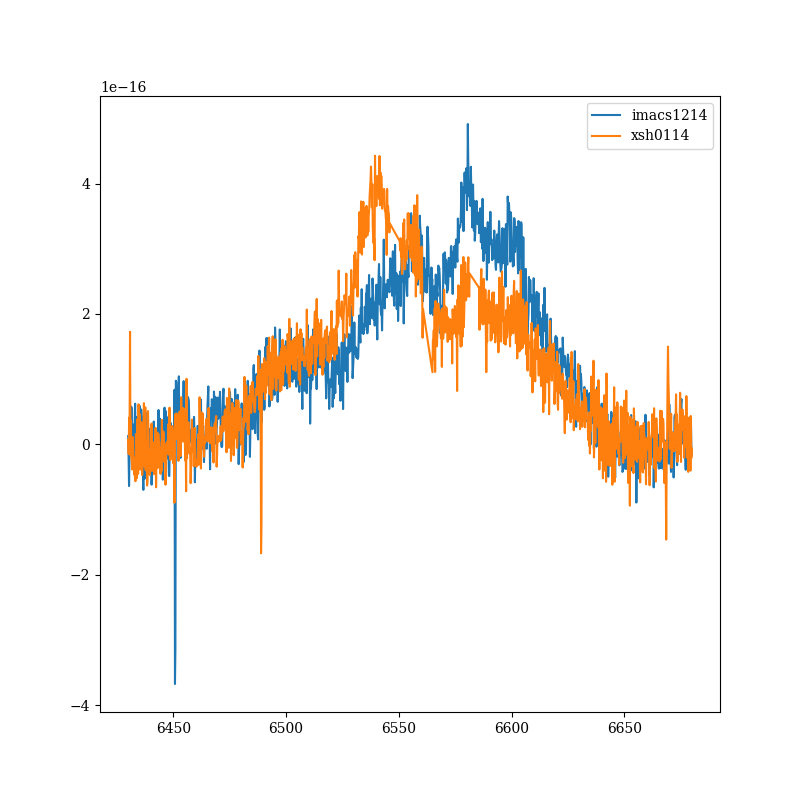

In [212]:
fig, ax = plt.subplots(figsize=(8,8))

specname = 'imacs1214'
specdata = np.loadtxt('./spectra/Halpha/%s_Halpha_spec.txt'%specname)
ax.plot(specdata[:,0], specdata[:,1], label=specname)

specname = 'xsh0114'
specdata = np.loadtxt('./spectra/Halpha/%s_Halpha_spec.txt'%specname)
ax.plot(specdata[:,0], specdata[:,1], label=specname)

#specname = 'xsh0121'
#specdata = np.loadtxt('./spectra/Halpha/%s_Halpha_spec.txt'%specname)
#ax.plot(specdata[:,0], specdata[:,1], label=specname)


ax.legend(loc=0)

In [229]:
from scipy import signal

0.20871007287820073


<IPython.core.display.Javascript object>


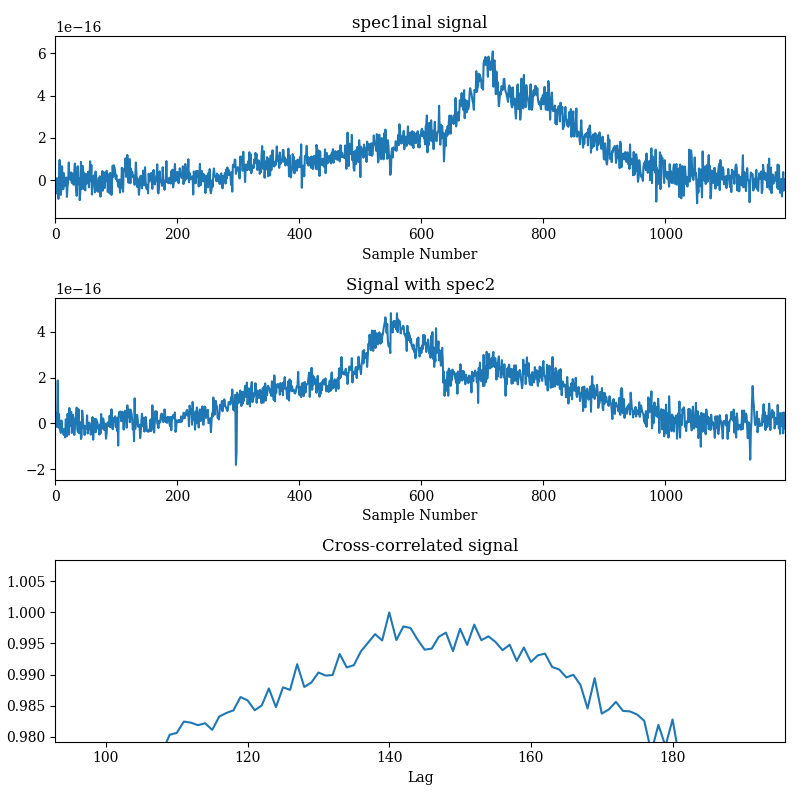

In [235]:
specname = 'xsh0121'
specdata = np.loadtxt('./spectra/Halpha/%s_Halpha_spec.txt'%specname)
spec1 = specdata[:,1]

specname = 'xsh0114'
specdata = np.loadtxt('./spectra/Halpha/%s_Halpha_spec.txt'%specname)
spec2 = specdata[:,1]


print( (np.max(specdata[:,0])-np.min(specdata[:,0]))/len(specdata) )


corr = signal.correlate(spec1, spec2)
lags = signal.correlation_lags(len(spec2), len(spec1))
corr /= np.max(corr)

fig, (ax_spec1, ax_spec2, ax_corr) = plt.subplots(3, 1, figsize=(8, 8))
ax_spec1.plot(spec1)
ax_spec1.set_title('spec1inal signal')
ax_spec1.set_xlabel('Sample Number')
ax_spec2.plot(spec2)
ax_spec2.set_title('Signal with spec2')
ax_spec2.set_xlabel('Sample Number')
ax_corr.plot(lags, corr)
ax_corr.set_title('Cross-correlated signal')
ax_corr.set_xlabel('Lag')
ax_spec1.margins(0, 0.1)
ax_spec2.margins(0, 0.1)
ax_corr.margins(0, 0.1)
fig.tight_layout()


In [34]:
def solve_Kepler_equation(t, P, e):
    '''
    M = E - e*sin(E) where M = 2*\pi/P (t-t0)
    '''
    M = 2*np.pi/P*t
    #print(M)
    gE = lambda E: E - e*np.sin(E) - M
    Ei = M                              #E_i
    Eip1 = Ei - gE(Ei)/(1-e*np.cos(Ei)) #E_{i+1}
    while np.absolute(Eip1-Ei)>1e-5:
        Ei = Eip1
        Eip1 = Ei - gE(Ei)/(1-e*np.cos(Ei))
        
    return Ei
    
    
def RV_kepler_orbit(ts, P_value=12.4, e=0.9, M1_value=1.4, M2_value=10, I_degree=90, Vz_value=0, w = 0, display=0):
    '''
    the full solution of radial velocity
    vr = Vz + K*(cos(w+f)+e*cos(w)) where K = m2/(m1+m2)*(n*a*sinI/np.sqrt(1-e**2))

    K = m^2/(m1+m2)^{2/3}* G(2\pi/P)^{1/3} sini/\sqrt(1-e^2) therefore quite degenerate
    '''

    P = P_value *units.day
    M1 = M1_value*units.M_sun #black hole
    M2 = M2_value*units.M_sun #companion star
    Mtot  = M1+ M2 #total binary mass
    a =  (constants.G * Mtot/ (2*np.pi/P)**2)**(1./3)
    print("semi major axis [solar radius]: ", a.to('R_sun'))
    print("the pericenter distance[solar radius]: ", a.to('R_sun')*(1-e))
    
    n = np.pi*2/P
    fs = np.array([solve_Kepler_equation(t_value, P_value, e) for t_value in ts])

    if display:
        fig, ax = plt.subplots(figsize=(6,6))
        ax.plot(ts, fs/np.pi*180, 'ko')


    Vz = Vz_value*units.km/units.second
    I = I_degree/180.*np.pi
    K  = M2/(M1+M2)*(n*a*np.sin(I)/np.sqrt(1-e**2))
    print( "radial velocity 'amplitude' K: [km/s]:",  K.to('km/s'))

    vrs = Vz + K*(np.cos(w+fs)+e*np.cos(w))

    return vrs
    
    

In [229]:
#for sn2022jli

m1_value = 1.4 #the compact remnant; the accretor
m1 = m1_value*units.M_sun
m2_value = 15 #the companion star; the donor 
m2 = m2_value*units.M_sun
P = 12.4*units.day

a = (constants.G*(m1+m2)/(4*np.pi**2)*P**2)**(1.0/3)
print( (a/units.R_sun).cgs )

n = 2*np.pi/P

K0 = m2/(m1+m2)*n*a 

print(K0.cgs)

57.27962906176845
21375390.228289522 cm / s


t0_22jli #discovery date
bump_peak_jd - trise #bump minimum

In [187]:
print(t0_22jli)
print(139.1+t0_22jli)
print(bump_peak_jd-trise-12.4*7)

2459704.67
2459843.77
2459833.176


In [38]:
print(bump_peak_jd)

2459922.976


['specname', 'phase', 'bump_phase', 'v', 'intf', 'nth']
  specname   phase        nth        
------------ ----- ------------------
binospec0121 261.9 10.766693613572512
binospec0120 260.9  10.68585286983767
     xsh0121 260.9  10.68585286983767
     xsh0118 257.9 10.443330638633142
     xsh0114 253.9 10.119967663693773
binospec0113 252.9 10.039126919958932
binospec0112 251.9  9.958286176224089
binospec1227 235.9   8.66483427646661
   imacs1214 224.0  7.702829426029515
     not1125 203.8  6.069846402570642
    dbsp1102 180.8  4.210509296669267
     not1031 179.8  4.129668552934425
    dbsp1011 159.1  2.456265157645775
     not0921 139.1 0.8394502829489274


<IPython.core.display.Javascript object>


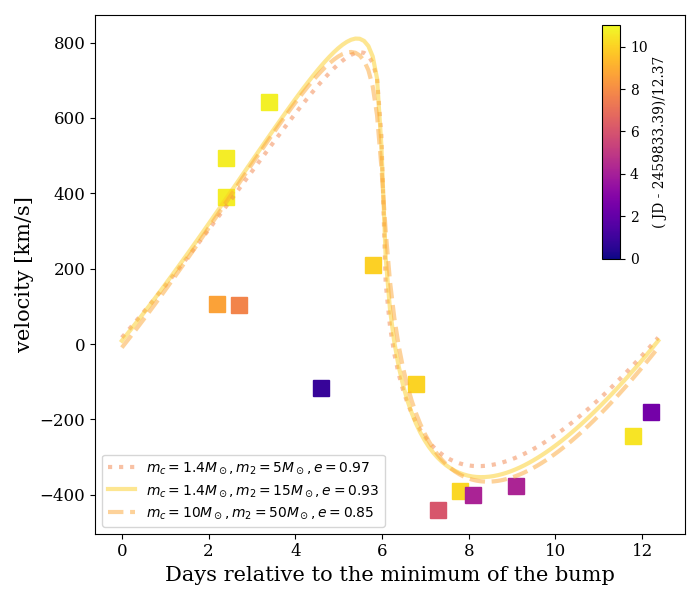

10.766693613572512
10.68585286983767
10.68585286983767
10.443330638633142
10.119967663693773
10.039126919958932
9.958286176224089
8.66483427646661
7.702829426029515
6.069846402570642
4.210509296669267
4.129668552934425
2.456265157645775
0.8394502829489274
[ 6.37        6.46975806  6.56951613  6.66927419  6.76903226  6.86879032
  6.96854839  7.06830645  7.16806452  7.26782258  7.36758065  7.46733871
  7.56709677  7.66685484  7.7666129   7.86637097  7.96612903  8.0658871
  8.16564516  8.26540323  8.36516129  8.46491935  8.56467742  8.66443548
  8.76419355  8.86395161  8.96370968  9.06346774  9.16322581  9.26298387
  9.36274194  9.4625      9.56225806  9.66201613  9.76177419  9.86153226
  9.96129032 10.06104839 10.16080645 10.26056452 10.36032258 10.46008065
 10.55983871 10.65959677 10.75935484 10.8591129  10.95887097 11.05862903
 11.1583871  11.25814516 11.35790323 11.45766129 11.55741935 11.65717742
 11.75693548 11.85669355 11.95645161 12.05620968 12.15596774 12.25572581
 12.35548387  0

In [72]:
ttemp = bump_peak_jd-trise-12.37*7
P = 12.37

tempdata = Ha_result.copy()
tempdata = tempdata[tempdata['specname']!='not0203'] # remove those after disappearance of narrow Halpha
tempdata = tempdata[tempdata['specname']!='not0208']
tempdata = tempdata[tempdata['specname']!='binospec0131']


nth_period = (tempdata['phase'].data+ t0_22jli-ttemp)/P
tempdata.add_column(Column(nth_period, name='nth'))

print(tempdata.colnames)
print(tempdata[['specname', 'phase', 'nth']])

tmin_bump_ref = 2459956.5 -125


cmap = mpl.cm.plasma
norm = mpl.colors.Normalize(vmin=0, vmax=11)

fig, ax = plt.subplots(figsize=(7,6))


for x, y, specname, phase in tempdata[['bump_phase', 'v', 'specname', 'phase']]:
    #color = cmap(np.floor((phase+t0_22jli-ttemp)/P)/11)
    print((phase+t0_22jli-ttemp)/P)
    color = cmap((phase+t0_22jli-ttemp)/P/11)
    ax.plot(x, y, 's', color=color, ms=12)
    #ax.text(x,y,specname)
    
    
    
ts = np.linspace(0, P, 125)    
#vrs = RV_kepler_orbit( np.mod(ts-1, P), w=285./180*np.pi, P_value=P, e = 0.9, M1_value=1.4, M2_value=15, I_degree=90, Vz_value=0) #
print(np.mod(ts-6, P))

m2 = 5
mc = 1.4
e = 0.97
vrs = RV_kepler_orbit(np.mod(ts-6, P), w=245./180*np.pi, P_value=P, e = e, M1_value= mc, M2_value=m2, I_degree=-90, Vz_value=0)
color = cmap(0.7)
ax.plot(ts, vrs, ':', color=color, alpha=0.5, lw=3, label=r'$m_c= %s M_\odot, m_2 = %s M_\odot, e=%s$'%(mc, m2, e))

e = 0.93
m2 = 15
mc = 1.4
vrs = RV_kepler_orbit(np.mod(ts-6, P), w=245./180*np.pi, P_value=P, e = e, M1_value=mc, M2_value=m2, I_degree=-90, Vz_value=0)
color = cmap(0.9)
ax.plot(ts, vrs, color=color, alpha=0.5, lw=3, label=r'$m_c= %s M_\odot, m_2 = %s M_\odot, e=%s$'%(mc, m2, e))


e  =0.85
m2 = 50
mc = 10
vrs = RV_kepler_orbit(np.mod(ts-6, P), w=245./180*np.pi, P_value=P, e = e, M1_value=mc, M2_value=m2, I_degree=-90, Vz_value=0)
color = cmap(0.8)
ax.plot(ts, vrs, '--', color=color, alpha=0.5, lw=3, label=r'$m_c= %s M_\odot, m_2 = %s M_\odot, e=%s$'%(mc, m2, e))



ax.legend(loc=3)

# vrs = RV_kepler_orbit(np.mod(ts-7, P), w=20./180*np.pi, P_value=P, e = 0.5, M1_value=1.4, M2_value=15, I_degree=-90, Vz_value=0)
# color = cmap(5)
# ax.plot(ts, vrs, color=color, alpha=0.5, lw=3)

axcolorbar =  ax.inset_axes([0.86, 0.53, 0.03, 0.45])
plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), cax=axcolorbar, orientation='vertical', label=r'( JD - %s)/12.37'%str(np.round(ttemp,2)), anchor=(0, 0.5))

ax.tick_params(labelsize=12)
ax.set_xlabel('Days relative to the minimum of the bump', fontsize=15)
ax.set_ylabel('velocity [km/s]', fontsize=15)

plt.tight_layout()

#plt.savefig('../plots/sn2022jli_velocity_evolution_Halpha.pdf')

In [43]:
print(t0_22jli)

2459704.67


<IPython.core.display.Javascript object>


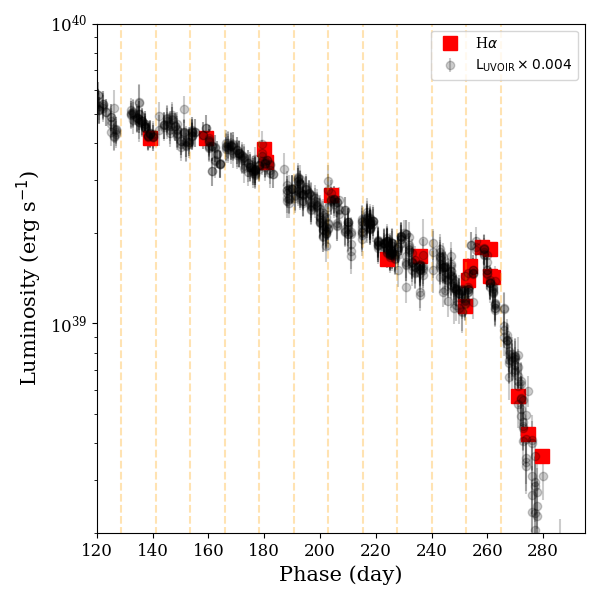

In [50]:
fig, ax = plt.subplots(figsize=(6,6))

tempdata = Ha_result.copy()
#tempdata = tempdata[tempdata['specname']!='not0203']
#tempdata = tempdata[tempdata['specname']!='binospec0131']


D = 22.5*units.Mpc #pc
factor = (4*np.pi*D**2).cgs.value #
tempdata.add_column(Column(tempdata['intf'].data * factor, name='L_Halpha'))


Halpha_to_UVOIR = 0.004
boldata = Table.read('/Users/chenping/Ping/SN2022jli/SN2022jli_bolometric_LC_20230301.csv', format='ascii.csv')
boldata['phase'] = boldata['phase']+ tmaxg_22jli - t0_22jli
boldata['eL'] = boldata['eL']
ax.errorbar(boldata['phase'], boldata['L']*Halpha_to_UVOIR, yerr= boldata['eL']*Halpha_to_UVOIR, fmt='ko', alpha=0.2, label=r'$\mathrm{L_{UVOIR}}\times 0.004$')



ax.plot(tempdata['phase'], tempdata['L_Halpha'], 'rs', ms=10, label=r'H$\alpha$')
# for x, y, specname in tempdata[['phase', 'L_Halpha', 'specname']]:
#     ax.text(x,y,specname, color='r')

ax.vlines( bump_peak_jd-trise-12.37*7 + np.arange(12)*12.37 - t0_22jli, ymin=1e38, ymax=1e40, colors='orange', linestyles='dashed', alpha=0.3)

    
ax.legend(loc=0)
ax.set_xlim([120, 295])
ax.set_ylim([2e38, 1e40])
ax.set_yscale('log')
ax.tick_params(labelsize=12)
    
ax.set_xlabel('Phase (day)', fontsize=15)
ax.set_ylabel(r'Luminosity (erg s$^{-1}$)', fontsize=15)

plt.tight_layout()

#plt.savefig('./plots/sn2022jli_Halpha_luminosity.pdf')

['specname', 'phase', 'bump_phase', 'v', 'intf', 'nth']
  specname   phase        nth        
------------ ----- ------------------
     not0208 279.7 12.205658852075294
     not0203 274.7 11.801455133401081
binospec0131 270.9 11.494260307186094
binospec0121 261.9 10.766693613572512
binospec0120 260.9  10.68585286983767
     xsh0121 260.9  10.68585286983767
     xsh0118 257.9 10.443330638633142
     xsh0114 253.9 10.119967663693773
binospec0113 252.9 10.039126919958932
binospec0112 251.9  9.958286176224089
binospec1227 235.9   8.66483427646661
   imacs1214 224.0  7.702829426029515
     not1125 203.8  6.069846402570642
    dbsp1102 180.8  4.210509296669267
     not1031 179.8  4.129668552934425
    dbsp1011 159.1  2.456265157645775
     not0921 139.1 0.8394502829489274


<IPython.core.display.Javascript object>


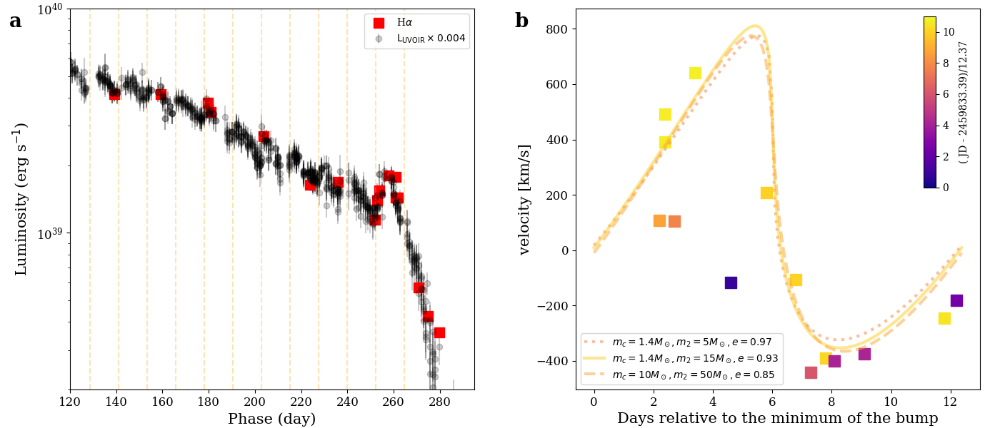

10.766693613572512
10.68585286983767
10.68585286983767
10.443330638633142
10.119967663693773
10.039126919958932
9.958286176224089
8.66483427646661
7.702829426029515
6.069846402570642
4.210509296669267
4.129668552934425
2.456265157645775
0.8394502829489274
[ 6.37        6.46975806  6.56951613  6.66927419  6.76903226  6.86879032
  6.96854839  7.06830645  7.16806452  7.26782258  7.36758065  7.46733871
  7.56709677  7.66685484  7.7666129   7.86637097  7.96612903  8.0658871
  8.16564516  8.26540323  8.36516129  8.46491935  8.56467742  8.66443548
  8.76419355  8.86395161  8.96370968  9.06346774  9.16322581  9.26298387
  9.36274194  9.4625      9.56225806  9.66201613  9.76177419  9.86153226
  9.96129032 10.06104839 10.16080645 10.26056452 10.36032258 10.46008065
 10.55983871 10.65959677 10.75935484 10.8591129  10.95887097 11.05862903
 11.1583871  11.25814516 11.35790323 11.45766129 11.55741935 11.65717742
 11.75693548 11.85669355 11.95645161 12.05620968 12.15596774 12.25572581
 12.35548387  0

<ipython-input-65-707263db901a>:134: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


In [65]:
ttemp = bump_peak_jd-trise-12.37*7
P = 12.37

tempdata = Ha_result.copy()



nth_period = (tempdata['phase'].data+ t0_22jli-ttemp)/P
tempdata.add_column(Column(nth_period, name='nth'))

print(tempdata.colnames)
print(tempdata[['specname', 'phase', 'nth']])

tmin_bump_ref = 2459956.5 -125


cmap = mpl.cm.plasma
norm = mpl.colors.Normalize(vmin=0, vmax=11)

#fig, (ax0, ax) = plt.subplots(1,2, figsize=(14,6))

fig= plt.figure(figsize=(14,6))
Ncol = 2
Nrow = 1
gs0 = GridSpec(Nrow, Ncol, figure=fig, hspace=0.0, wspace=0.25, left=0.07, right=0.98, bottom=0.09, top=0.98)

ax0 = fig.add_subplot(gs0[0, 0])
ax = fig.add_subplot(gs0[0, 1])






D = 22.5*units.Mpc #pc
factor = (4*np.pi*D**2).cgs.value #
tempdata.add_column(Column(tempdata['intf'].data * factor, name='L_Halpha'))


Halpha_to_UVOIR = 0.004
boldata = Table.read('/Users/chenping/Ping/SN2022jli/SN2022jli_bolometric_LC_20230301.csv', format='ascii.csv')
boldata['phase'] = boldata['phase']+ tmaxg_22jli - t0_22jli
boldata['eL'] = boldata['eL']
ax0.errorbar(boldata['phase'], boldata['L']*Halpha_to_UVOIR, yerr= boldata['eL']*Halpha_to_UVOIR, fmt='ko', alpha=0.2, label=r'$\mathrm{L_{UVOIR}}\times 0.004$')



ax0.plot(tempdata['phase'], tempdata['L_Halpha'], 'rs', ms=10, label=r'H$\alpha$')
# for x, y, specname in tempdata[['phase', 'L_Halpha', 'specname']]:
#     ax.text(x,y,specname, color='r')

ax0.vlines( bump_peak_jd-trise-12.37*7 + np.arange(12)*12.37 - t0_22jli, ymin=1e38, ymax=1e40, colors='orange', linestyles='dashed', alpha=0.3)

    
ax0.legend(loc=0)
ax0.set_xlim([120, 295])
ax0.set_ylim([2e38, 1e40])
ax0.set_yscale('log')
ax0.tick_params(labelsize=12)
    
ax0.set_xlabel('Phase (day)', fontsize=15)
ax0.set_ylabel(r'Luminosity (erg s$^{-1}$)', fontsize=15)








tempdata = tempdata[tempdata['specname']!='not0203'] # remove those after disappearance of narrow Halpha
tempdata = tempdata[tempdata['specname']!='not0208']
tempdata = tempdata[tempdata['specname']!='binospec0131']



for x, y, specname, phase in tempdata[['bump_phase', 'v', 'specname', 'phase']]:
    #color = cmap(np.floor((phase+t0_22jli-ttemp)/P)/11)
    print((phase+t0_22jli-ttemp)/P)
    color = cmap((phase+t0_22jli-ttemp)/P/11)
    ax.plot(x, y, 's', color=color, ms=12)
    #ax.text(x,y,specname)
    
    
    
ts = np.linspace(0, P, 125)    
#vrs = RV_kepler_orbit( np.mod(ts-1, P), w=285./180*np.pi, P_value=P, e = 0.9, M1_value=1.4, M2_value=15, I_degree=90, Vz_value=0) #
print(np.mod(ts-6, P))

m2 = 5
mc = 1.4
e = 0.97
vrs = RV_kepler_orbit(np.mod(ts-6, P), w=245./180*np.pi, P_value=P, e = e, M1_value= mc, M2_value=m2, I_degree=-90, Vz_value=0)
color = cmap(0.7)
ax.plot(ts, vrs, ':', color=color, alpha=0.5, lw=3, label=r'$m_c= %s M_\odot, m_2 = %s M_\odot, e=%s$'%(mc, m2, e))

e = 0.93
m2 = 15
mc = 1.4
vrs = RV_kepler_orbit(np.mod(ts-6, P), w=245./180*np.pi, P_value=P, e = e, M1_value=mc, M2_value=m2, I_degree=-90, Vz_value=0)
color = cmap(0.9)
ax.plot(ts, vrs, color=color, alpha=0.5, lw=3, label=r'$m_c= %s M_\odot, m_2 = %s M_\odot, e=%s$'%(mc, m2, e))


e  =0.85
m2 = 50
mc = 10
vrs = RV_kepler_orbit(np.mod(ts-6, P), w=245./180*np.pi, P_value=P, e = e, M1_value=mc, M2_value=m2, I_degree=-90, Vz_value=0)
color = cmap(0.8)
ax.plot(ts, vrs, '--', color=color, alpha=0.5, lw=3, label=r'$m_c= %s M_\odot, m_2 = %s M_\odot, e=%s$'%(mc, m2, e))



ax.legend(loc=3)

# vrs = RV_kepler_orbit(np.mod(ts-7, P), w=20./180*np.pi, P_value=P, e = 0.5, M1_value=1.4, M2_value=15, I_degree=-90, Vz_value=0)
# color = cmap(5)
# ax.plot(ts, vrs, color=color, alpha=0.5, lw=3)

axcolorbar =  ax.inset_axes([0.86, 0.53, 0.03, 0.45])
plt.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), cax=axcolorbar, orientation='vertical', label=r'( JD - %s)/12.37'%str(np.round(ttemp,2)), anchor=(0, 0.5))

ax.tick_params(labelsize=12)
ax.set_xlabel('Days relative to the minimum of the bump', fontsize=15)
ax.set_ylabel('velocity [km/s]', fontsize=15)



ax0.set_title('a', fontsize=20, loc='left', pad=20, x=-0.15, y=0.9, fontweight='bold')
ax.set_title('b', fontsize=20, loc='left', pad=20, x=-0.15, y=0.9, fontweight='bold')



plt.tight_layout()

#plt.savefig('../plots/sn2022jli_velocity_evolution_Halpha.pdf')




In [99]:
print(specs_22jli.keys())

dict_keys(['psh0511', 'efosc0524', 'efosc0820', 'sedm0629', 'sedm0707', 'sedm0719', 'sedm0726', 'sedm0804', 'sedm0811', 'sedm0816', 'sedm0818', 'sedm0823', 'sedm0828', 'sedm0908', 'sedm0916', 'sedm1002', 'sedm1005', 'sedm1011', 'sedm1014', 'sedm1021', 'sedm1022', 'sedm1030', 'sedm1115', 'sedm1127', 'sedm1211', 'not0806', 'not0921', 'not1031', 'not1125', 'dbsp0820', 'dbsp1011', 'dbsp1102', 'sedm1220', 'imacs1214', 'binospec1227', 'efosc1223', 'binospec0112', 'binospec0113', 'xsh0114', 'spectable'])


## all optical spectra

In [475]:
import pandas as pd
pd.set_option('display.max_rows', None, 'display.max_columns', None)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [476]:
bump_peak_jd = 2459923.9475376885

specnames = []
phases = []
bump_phases = []
jds = []
dates = []
specfiles = []
telescopes = []
instruments = []
exptimes = []
for specname in specs_22jli.keys():
    if specname == 'spectable':
        continue
    specnames.append(specname)
    phases.append(specs_22jli[specname]['phase'])
    jd = specs_22jli[specname]['jd']
    bump_phase = np.mod( jd-bump_peak_jd, 12.5 )
    jds.append(jd)
    bump_phases.append(bump_phase)
    #print(jd)
    date = Time(jd, format='jd').iso.split(' ')[0]
    #print(date)
    obstime = date  + '.' + str(int((jd-Time(date, format='iso').jd)*1000))
    #print(obstime)
    dates.append(obstime)
    specfiles.append(specs_22jli[specname]['specfile'])
    telescopes.append(specs_22jli[specname]['telescope'])
    instruments.append(specs_22jli[specname]['instrument'])
    exptimes.append(specs_22jli[specname]['exptime'])
    
spectable = Table([specnames, phases, bump_phases, dates, jds, specfiles, telescopes, instruments, exptimes], names=['specname', 'phase', 'bump_phase', 'date', 'jd', 'specfile' ,'telescope','instrument','exptime'])
specpd = pd.DataFrame(np.array([specnames,  dates, phases, bump_phases, jds, specfiles, telescopes, instruments, exptimes]).transpose(), columns=['specname',  'date', 'phase', 'bump_phase', 'jd', 'specfile' ,'telescope','instrument','exptime'])
specpd.phase = specpd.phase.astype(float)
specpd.sort_values(['phase'], inplace=True, axis=0)
print(spectable[spectable['instrument']!='SEDM'])
display(specpd)

spectable.sort('phase')
spectable.write('./spectra/spec_table.csv', format='ascii.csv', overwrite=True)

##### prepare the log table of spectroscopy observations

specpd.drop(columns=['specname', 'jd', 'bump_phase', 'specfile'], inplace=True)
print(specpd.to_latex(index=False, escape=False))



  specname         phase             bump_phase     ... instrument exptime
------------ ------------------ ------------------- ... ---------- -------
     psh0511  5.973749999888241  11.696212311275303 ...      other     999
   efosc0524 19.247025463264436  12.469487774651498 ...     EFOSC2     999
     not0806  93.02682870393619  11.249291015323251 ...     ALFOSC     999
     not0921 139.05163659714162   7.274098908528686 ...     ALFOSC     999
     not1031  179.8275067708455  10.549969082232565 ...     ALFOSC    1200
     not1125 203.83123391214758   9.553696223534644 ...     ALFOSC    1200
     not0203 274.65999725693837    5.38245956832543 ...     ALFOSC    1200
     not0208 279.65413533570245  10.376597647089511 ...     ALFOSC    1200
    dbsp0820  106.8300000000745 0.05246231146156788 ...       DBSP     300
    dbsp1011  159.1044675926678  2.3269299040548503 ...       DBSP     600
    dbsp1102  180.8300000000745  11.552462311461568 ...       DBSP     420
   imacs1214 223.96744212

,specname,date,phase,bump_phase,jd,specfile,telescope,instrument,exptime
0,psh0511,2022-05-11.143,5.974,11.696212311275303,2459710.64375,./spectra/tns/tns_2022jli_2022-05-11_03-27-00_...,other,other,999
1,efosc0524,2022-05-24.417,19.247,12.469487774651498,2459723.917025463,./spectra/tns/tns_2022jzy_2022-05-24_10-00-31_...,NTT,EFOSC2,999
2,sedm0629,2022-06-29.423,55.254,10.976166015025228,2459759.9237037036,./spectra/fritz/spec_auto_robot_lstep1__crr_b_...,P60,SEDM,1800
3,sedm0707,2022-07-07.424,63.254,6.4766868483275175,2459767.924224537,./spectra/fritz/spec_auto_robot_lstep1__crr_b_...,P60,SEDM,1800
4,sedm0719,2022-07-19.453,75.284,6.00637434842065,2459779.953912037,./spectra/fritz/spec_auto_robot_lstep1__crr_b_...,P60,SEDM,1800
5,sedm0726,2022-07-26.338,82.169,0.39116601506248116,2459786.8387037036,./spectra/fritz/spec_auto_robot_lstep1__crr_b_...,P60,SEDM,1800
6,sedm0804,2022-08-04.418,91.249,9.471374348271638,2459795.918912037,./spectra/fritz/spec_auto_robot_lstep1__crr_b_...,P60,SEDM,1800
27,not0806,2022-08-06.196,93.027,11.249291015323251,2459797.696828704,./spectra/fritz/spectrum_1d.ascii,NOT,ALFOSC,999
7,sedm0811,2022-08-11.310,98.141,3.863249348476529,2459802.810787037,./spectra/fritz/spec_auto_robot_lstep1__crr_b_...,P60,SEDM,1800
8,sedm0816,2022-08-16.288,103.119,8.841409070882946,2459807.7889467594,./spectra/fritz/spec_auto_robot_lstep1__crr_b_...,P60,SEDM,1800


\begin{tabular}{lrlll}
\toprule
          date &   phase &      telescope & instrument & exptime \\
\midrule
2022-05-11.143 &   5.974 &          other &      other &     999 \\
2022-05-24.417 &  19.247 &            NTT &     EFOSC2 &     999 \\
2022-06-29.423 &  55.254 &            P60 &       SEDM &    1800 \\
2022-07-07.424 &  63.254 &            P60 &       SEDM &    1800 \\
2022-07-19.453 &  75.284 &            P60 &       SEDM &    1800 \\
2022-07-26.338 &  82.169 &            P60 &       SEDM &    1800 \\
2022-08-04.418 &  91.249 &            P60 &       SEDM &    1800 \\
2022-08-06.196 &  93.027 &            NOT &     ALFOSC &     999 \\
2022-08-11.310 &  98.141 &            P60 &       SEDM &    1800 \\
2022-08-16.288 & 103.119 &            P60 &       SEDM &    1800 \\
2022-08-18.325 & 105.155 &            P60 &       SEDM &    1800 \\
  2022-08-20.0 & 106.830 &           P200 &       DBSP &     300 \\
2022-08-23.371 & 110.202 &            P60 &       SEDM &    1800 \\
2022-08

In [110]:
bump_phases = np.mod((spectable['jd']-bump_peak_jd), 12.5)
print(bump_phases)

bump_phase_col = Column(bump_phases, name='bump_phase')
#spectable.add_column(bump_phase_col)

         jd        
-------------------
 11.696212311275303
 12.469487774651498
 10.976166015025228
 6.4766868483275175
   6.00637434842065
0.39116601506248116
  9.471374348271638
 11.249291015323251
  3.863249348476529
  8.841409070882946
                ...
 0.6718025892041624
  4.689904441125691
   9.65127018187195
 1.1338286194950342
  4.143747033551335
    7.6299391631037
  8.624221570789814
  9.603056501131505
  4.163480829913169
  5.143457681871951
  1.642230830155313
Length = 42 rows


In [524]:
print(spectable)

  specname         phase             bump_phase     ... instrument exptime
------------ ------------------ ------------------- ... ---------- -------
    sedm0629 55.253703703638166  10.976166015025228 ...       SEDM    1800
    sedm0707 63.254224536940455  6.4766868483275175 ...       SEDM    1800
    sedm0719  75.28391203703359    6.00637434842065 ...       SEDM    1800
    sedm0726  82.16870370367542 0.39116601506248116 ...       SEDM    1800
    sedm0804  91.24891203688458   9.471374348271638 ...       SEDM    1800
     not0806  93.02682870393619  11.249291015323251 ...     ALFOSC     999
    sedm0811  98.14078703708947   3.863249348476529 ...       SEDM    1800
    sedm0816 103.11894675949588   8.841409070882946 ...       SEDM    1800
    sedm0818 105.15502314828336  10.877485459670424 ...       SEDM    1800
    dbsp0820  106.8300000000745 0.05246231146156788 ...       DBSP     300
         ...                ...                 ... ...        ...     ...
binospec0113 252.90175925

In [529]:
import pickle

specs_22jli['spectable'] = spectable

specs_22jli['notes'] = 'smoothed spectra for IMACS and XSHOOTER are included;  NOT/ALFOSC problematic spectra (0921, 1031) are corrected'

#if save the data
outfile = '/Users/chenping/SNeData/Ping_collections/SNe_spectra/2022jli.20230330.p'
if os.path.exists(outfile):
    os.remove(outfile)
with open(outfile, 'wb') as fp:
    pickle.dump(specs_22jli, fp, protocol=pickle.HIGHEST_PROTOCOL)


#### optical spectra calibration prepare

In [406]:
from scipy.interpolate import interp1d


In [75]:
#lcs_all = Table.read('./SN2022jli_magtable.csv', format='ascii')
#print(np.isnan(lcs_all['r']))

<IPython.core.display.Javascript object>


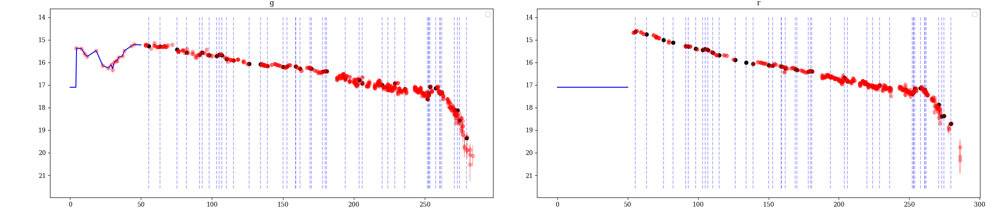

18:52:33 No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
18:52:33 No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
0 55.253703703638166
1 63.254224536940455
2 75.28391203703359
3 82.16870370367542
4 91.24891203688458
5 93.02682870393619
6 98.14078703708947
7 103.11894675949588
8 105.15502314828336
9 106.8300000000745
10 110.2017129631713
11 115.08446759264916
12 126.21718750009313
13 134.04640046320856
14 139.05163659714162
15 150.13574074069038
16 152.97965277777985
17 158.9891666667536
18 159.1044675926678
19 162.02922453731298
20 169.00908564822748
21 170.2023611110635
22 178.16789351869375
23 179.8275067708455
24 180.8300000000745
25 193.96365740755573
26 203.83123391214758
27 205.90872685192153
28 219.9493402778171
29 223.96744212973863
30 228.9288078704849
31 235.921

In [519]:
#lcs_fritz = Table.read('./photometry/Fritz_LCs_tableDownload_20221220.csv', format='ascii.csv')
#lcs_fritz = lcs_fritz[~lcs_fritz['mag'].mask]

lcs_all = Table.read('./SN2022jli_magtable.csv', format='ascii')



#flts = [ 'g',  'r', 'i']
flts = ['g','r']
colors = {'sedm':'r', 'ztf':'k', 'ioo':'c', 'uvot':'m'}

fillvalues = { 'g': 17.1, 'r':17.1, 'i':16.5}

flt_mags_specific = {} #
flt_mags_specific['not1124'] = {'u':20, 'g':18.5, 'r':17.5, 'i':17.5}

data_model_dict = {}
for flt in flts:
    #fltdata = lcs_fritz[lcs_fritz['filter']=='ztf'+flt]
    #data_model_dict[flt] = interp1d(fltdata['mjd']+2400000.5-t0_22jli, fltdata['mag'], kind='linear', bounds_error=False, fill_value=fillvalues[flt])
    
    fltdata = lcs_all[~np.isnan(lcs_all[flt])]
    data_model_dict[flt] = interp1d(fltdata['jd']+ tmaxg_22jli -t0_22jli, fltdata[flt], kind='linear', bounds_error=False, fill_value=fillvalues[flt])
    
fitepochs = spectable['phase'].data

#for i,phase in enumerate(fitepochs):
#    print(int(np.floor(int(i)/7)))
    

fig = plt.figure(figsize=(23, 5))
Nrow = 1
Ncol = len(flts)
gs = GridSpec(Nrow, Ncol, left=0.05, bottom=0.09, right=0.98,top=0.96)
gs.update(wspace=0.1, hspace=0.25)

axes = {}

color='r'

for i,flt in enumerate(flts):
    irow = int(i/Ncol)
    icol = np.mod(i,Ncol)
    #print(irow, icol)
    ax = plt.subplot(gs[irow, icol])
    axes[flt] = ax
    
    #fltdata = lcs_fritz[lcs_fritz['filter']=='ztf'+flt]
    #ax.errorbar(fltdata['mjd']+2400000.5-t0_22jli, fltdata['mag'], yerr =fltdata['magerr'], fmt=color+'o')
        
    fltdata = lcs_all[~np.isnan(lcs_all[flt])]
    ax.errorbar(fltdata['jd'] +tmaxg_22jli -t0_22jli, fltdata[flt], yerr=fltdata['e'+flt], fmt=color+'o', alpha=0.3)
        
    ax.legend(loc=0)
    ts = np.linspace(0,50, 100)
    ax.plot(ts, data_model_dict[flt](ts), 'b')
    ax.vlines(fitepochs, ymin=14, ymax=21.6, colors='b', linestyles='dashed', alpha=0.3)
    ax.invert_yaxis()
    ax.set_title(flt)
    
plt.savefig('./plots/temporal_SED_build.png')

sed_flux_dict = {}
sed_mag_dict = {}
###
for i, (phase, specname) in enumerate(zip(fitepochs, spectable['specname'])):
    print(i, phase)
    flts = []
    mags = []
    magserr =[]
    for flt in data_model_dict.keys():
        flts.append(flt)
        
        if specname in flt_mags_specific.keys():
            mag = flt_mags_specific[specname][flt]
        else:
            mag = data_model_dict[flt](phase)
        mags.append(mag)

        ax = axes[flt]
        ax.plot(phase, mag, 'ko')
        
        if flt in ['UVW2', 'UVM2', 'UVW1', 'U', 'B']:    
            magserr.append(0.1)
        else:
            magserr.append(0.05)
        
    magssys = ['AB']*len(flts)    
    
    #print(flts, mags, magserr, magssys)
    magtable = Table([flts, mags, magserr, magssys], names=['flt', 'mag', 'magerr' ,'sys'])

    magtable = magtable[magtable['mag']!=0]
    #print(magtable)
    abmag_table = get_SED_AB_mag(magtable, target_name='2022jli', A_V=None, correct_gal_extinction=False)
    sed_flux_table = get_SED_flux(abmag_table, waveeff_dict= None)
    sed_flux_dict[specname] = sed_flux_table
    sed_mag_dict[specname] = abmag_table

plt.tight_layout()

<ipython-input-543-41681e42718b>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(12,7))


<IPython.core.display.Javascript object>


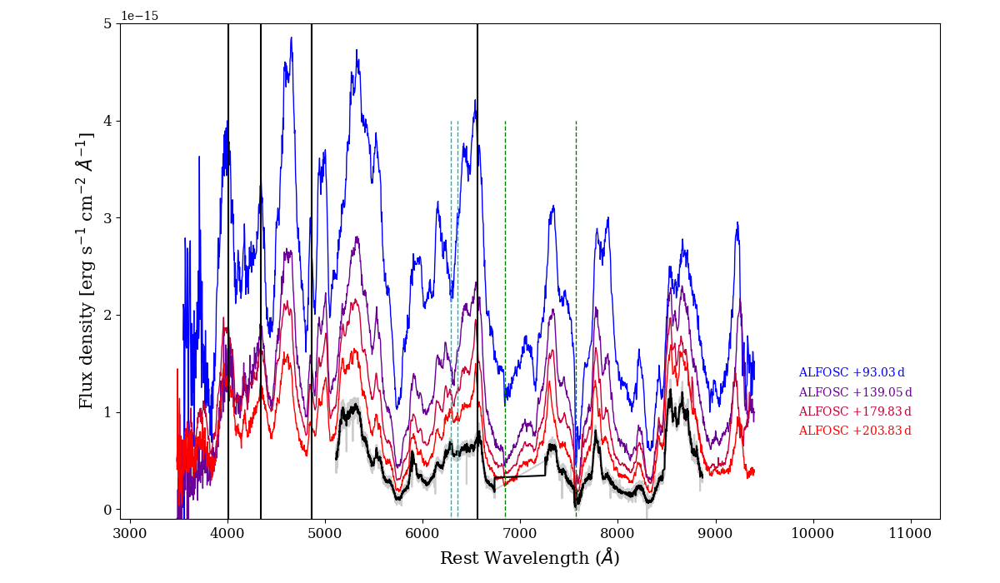

0 not0806
1 not0921
2 not1031
3 not1125


In [543]:
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]

notspectable = spectable[spectable['instrument']=='ALFOSC']

epoch_max = np.max(notspectable['phase'])
epoch_min = np.min(notspectable['phase'])

fig, ax = plt.subplots(figsize=(12,7))
ax.set_position([0.12,0.11,0.82,0.85])


f0 = 1e-15
fspace = 2e-16
j = 0
for i,(specname, phase, instru) in enumerate(notspectable[['specname','phase', 'instrument']]):
    print(i, specname)
    
    specdata = specs_22jli[specname]['spec_photcal'].copy()
    sampleindice = (specdata[:,0]>5000)*(specdata[:,0]<7000)
    fluxanchor = np.mean(specdata[sampleindice,1])
    
    #specdata[:,1] = specdata[:,1]*(f0/fluxanchor)
    offset = f0-j*fspace
    
    offset = 0
        
    color_id = (phase - epoch_min)/(epoch_max-epoch_min)
    color = (color_id, 0, 1-color_id)
    

    lw=1
    alpha=1
    
    xs = specdata[:,0]/(1+z_22jli)
    ys = specdata[:,1]+offset
    ys = ys[xs<9400]
    xs = xs[xs<9400]
    
    ax.plot(xs, ys, color=color, lw=lw, alpha=alpha)
    

    textoffset = 4e-16
    #print(j, fspace)
    ax.text(9850, f0-j*fspace + textoffset,   '{} +{:.2f}$\,$d '.format(instru, phase), va='center', fontsize=10, color=color)

    j += 1

    
    
imacsspec = np.loadtxt('./spectra/magellan_imacs/SN2022jli_IMACS_20221214.txt')
ax.plot(imacsspec[:,0]/(1+z_22jli), imacsspec[:,1], 'k', alpha=0.2)    
ax.plot(imacsspec[:,0]/(1+z_22jli), savgol_filter(imacsspec[:,1], 31, 2), 'k')
    
    
    
    
#ax.plot(telluriclines['waveobs']*10/(1+z_22vqz), tellsmooth1*3e-16+2.15e-14, 'g', alpha=0.2)  
    
ax.vlines(np.array([6880, 7614])/(1+z_22jli), ymin=-2.3e-14, ymax=4e-15, color='g', linestyles='dashed', lw=1, alpha=1) #telluric line

vshift = -400
ax.vlines(np.array([6300, 6363])*(1+vshift/300000), ymin=-2.3e-14, ymax=4e-15, color='c', linestyles='dashed', lw=1, alpha=1)

ax.vlines([4012,4340,4861,6563], ymin = -9.5e-15, ymax=7.5e-15, linestyles='solid', colors='k')



ax.set_xlim([2900,11300])
ax.set_ylim([-1e-16, 5e-15])

#ax.set_yticks([])
ax.tick_params(labelsize=12)
ax.set_xlabel('Rest Wavelength ($\AA$)', fontsize=15)
ax.set_ylabel('Flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]', fontsize=15)

plt.savefig('./plots/spec_NOT_ALFOSC.pdf')
plt.savefig('./plots/spec_NOT_ALFOSC.png')

##### any difference between spectra in the dip and on the peak

ALFOSC +139.05 spectrum is in the dip and DBSP +159.10 is in the middle of the peak and the dip
the other ALFOSC and DBSP spectra are all near the bump peaks


<IPython.core.display.Javascript object>


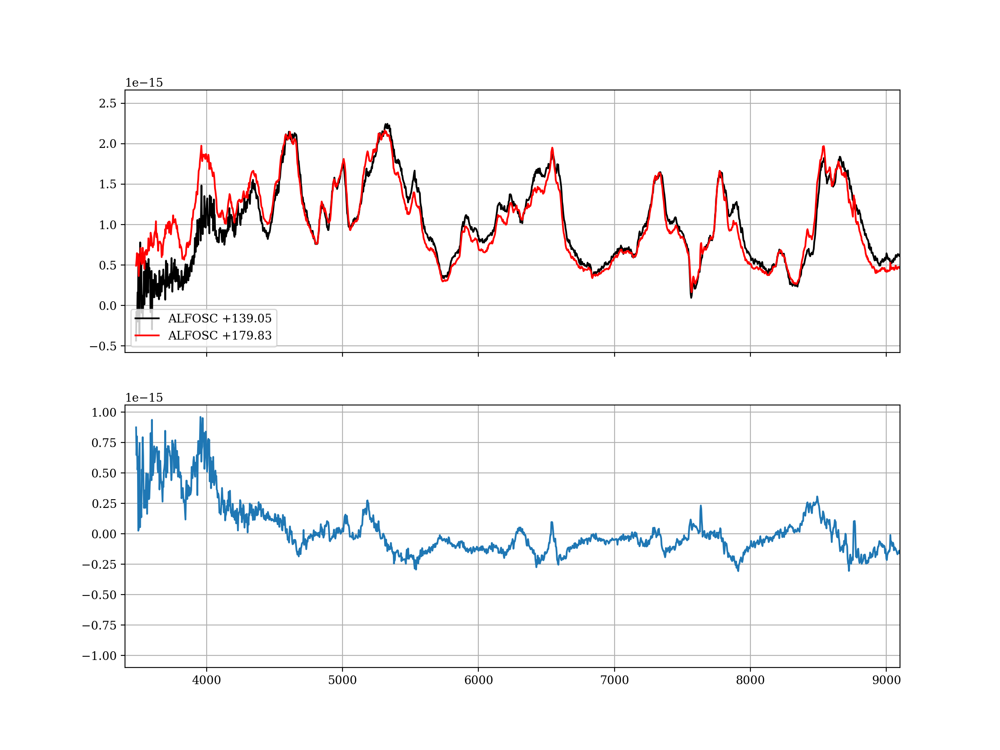

In [265]:
spec1 = specs_22jli['not0921']['spec_photcal']
spec2 = specs_22jli['not1031']['spec_photcal']

fig, (ax, ax2) = plt.subplots(2,1, figsize=(12,9), sharex=True)
ax.plot(spec1[:,0]/(1+z_22jli), spec1[:,1]*0.8, 'k', label='ALFOSC +139.05')
ax.plot(spec2[:,0]/(1+z_22jli), spec2[:,1], 'r', label='ALFOSC +179.83')

spec1_interp = interp1d(spec1[:,0], spec1[:,1]*0.8, bounds_error=False, fill_value=0)
ax2.plot(spec2[:,0]/(1+z_22jli), spec2[:,1] - spec1_interp(spec2[:,0]))

ax.set_xlim([3400, 9100])

ax.grid()
ax2.grid()

ax.legend(loc=3)

<IPython.core.display.Javascript object>


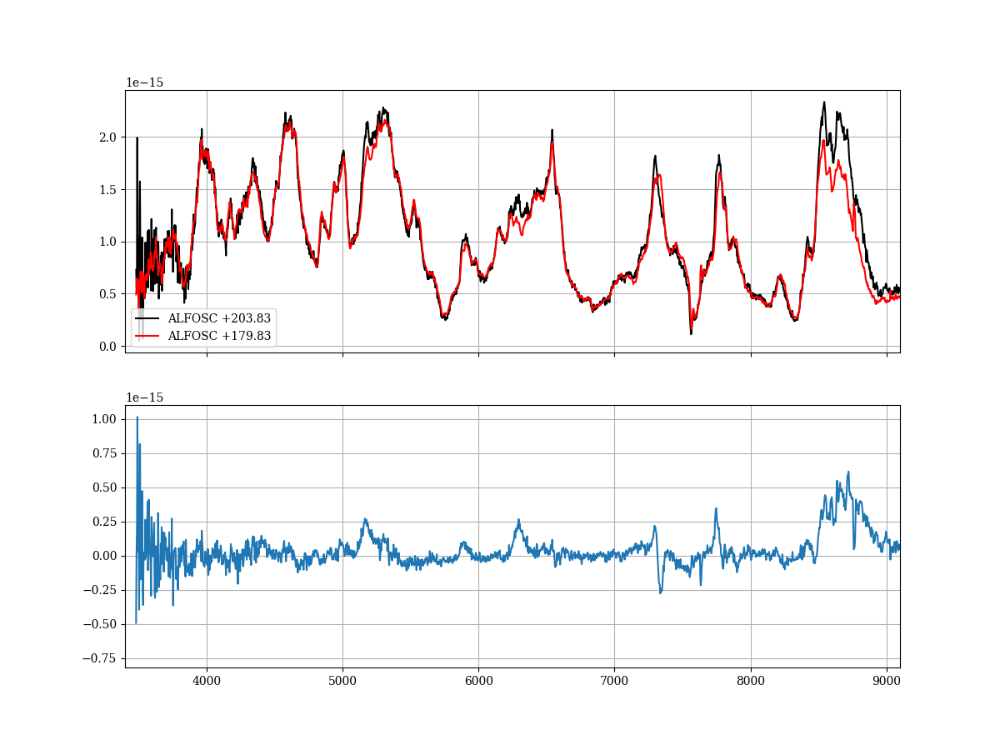

In [218]:
spec1 = specs_22jli['not1125']['spec_photcal']
spec2 = specs_22jli['not1031']['spec_photcal']

scalefac = 1.38

fig, (ax, ax2) = plt.subplots(2,1, figsize=(12,9), sharex=True)
ax.plot(spec1[:,0]/(1+z_22jli), spec1[:,1]*scalefac, 'k', label='ALFOSC +203.83')
ax.plot(spec2[:,0]/(1+z_22jli), spec2[:,1], 'r', label='ALFOSC +179.83')

spec1_interp = interp1d(spec1[:,0], spec1[:,1]*scalefac, bounds_error=False, fill_value=0)
ax2.plot(spec2[:,0]/(1+z_22jli),  spec1_interp(spec2[:,0]) - spec2[:,1])

ax.set_xlim([3400, 9100])

ax.grid()
ax2.grid()

ax.legend(loc=3)

<IPython.core.display.Javascript object>


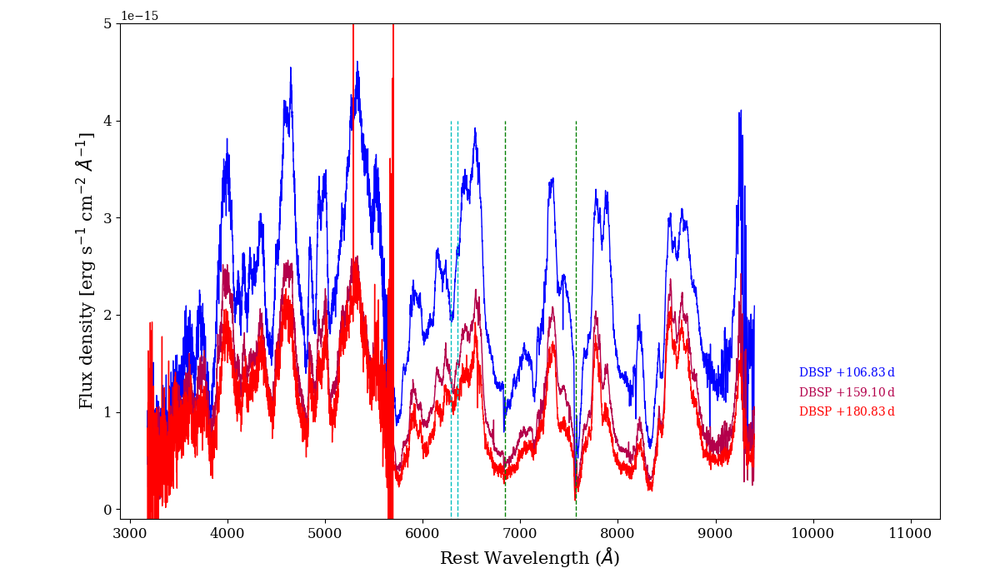

0 dbsp0820
1 dbsp1011
2 dbsp1102


In [214]:
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]

notspectable = spectable[spectable['instrument']=='DBSP']

epoch_max = np.max(notspectable['phase'])
epoch_min = np.min(notspectable['phase'])

fig, ax = plt.subplots(figsize=(12,7))
ax.set_position([0.12,0.11,0.82,0.85])


f0 = 1e-15
fspace = 2e-16
j = 0
for i,(specname, phase, instru) in enumerate(notspectable[['specname','phase', 'instrument']]):
    print(i, specname)
    
    specdata = specs_22jli[specname]['spec_photcal'].copy()
    sampleindice = (specdata[:,0]>5000)*(specdata[:,0]<7000)
    fluxanchor = np.mean(specdata[sampleindice,1])
    
    #specdata[:,1] = specdata[:,1]*(f0/fluxanchor)
    offset = f0-j*fspace
    
    offset = 0
        
    color_id = (phase - epoch_min)/(epoch_max-epoch_min)
    color = (color_id, 0, 1-color_id)
    

    lw=1
    alpha=1
    
    xs = specdata[:,0]/(1+z_22jli)
    ys = specdata[:,1]+offset
    ys = ys[xs<9400]
    xs = xs[xs<9400]
    
    ax.plot(xs, ys, color=color, lw=lw, alpha=alpha)
    

    textoffset = 4e-16
    #print(j, fspace)
    ax.text(9850, f0-j*fspace + textoffset,   '{} +{:.2f}$\,$d '.format(instru, phase), va='center', fontsize=10, color=color)

    j += 1

    
#ax.plot(telluriclines['waveobs']*10/(1+z_22vqz), tellsmooth1*3e-16+2.15e-14, 'g', alpha=0.2)  
    
ax.vlines(np.array([6880, 7614])/(1+z_22jli), ymin=-2.3e-14, ymax=4e-15, color='g', linestyles='dashed', lw=1, alpha=1) #telluric line

vshift = -400
ax.vlines(np.array([6300, 6363])*(1+vshift/300000), ymin=-2.3e-14, ymax=4e-15, color='c', linestyles='dashed', lw=1, alpha=1)


ax.set_xlim([2900,11300])
ax.set_ylim([-1e-16, 5e-15])

#ax.set_yticks([])
ax.tick_params(labelsize=12)
ax.set_xlabel('Rest Wavelength ($\AA$)', fontsize=15)
ax.set_ylabel('Flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]', fontsize=15)

plt.savefig('./plots/spec_P200_DBSP.pdf')
plt.savefig('./plots/spec_P200_DBSP.png')

### all SEDM spectra

<IPython.core.display.Javascript object>


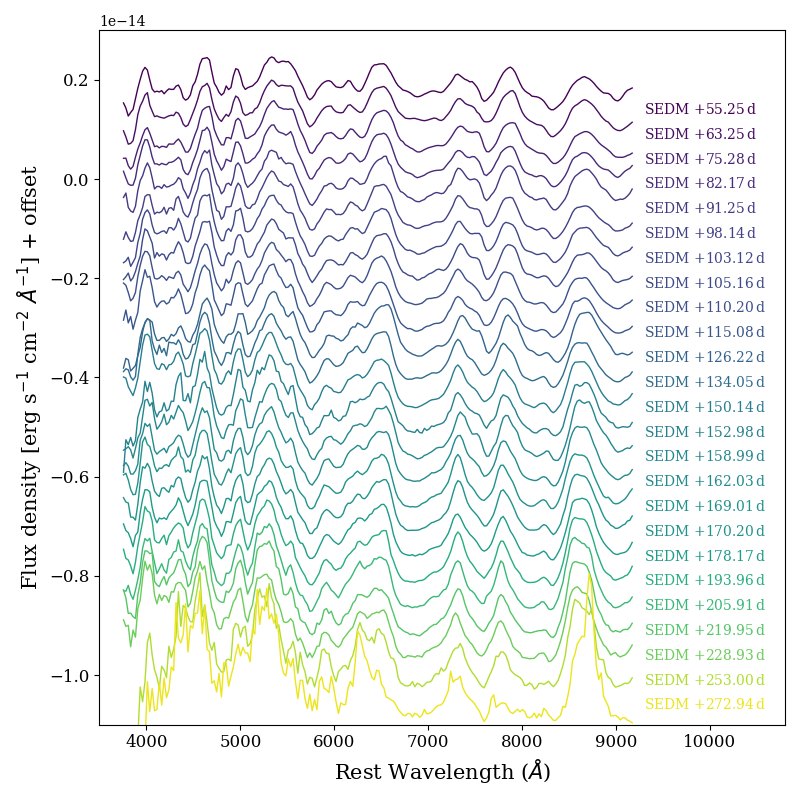

0 sedm0629
1 sedm0707
2 sedm0719
3 sedm0726
4 sedm0804
5 sedm0811
6 sedm0816
7 sedm0818
8 sedm0823
9 sedm0828
10 sedm0908
11 sedm0916
12 sedm1002
13 sedm1005
14 sedm1011
15 sedm1014
16 sedm1021
17 sedm1022
18 sedm1030
19 sedm1115
20 sedm1127
21 sedm1211
22 sedm1220
23 sedm0113
24 sedm0202
19:18:12 Assigning font /b'F1' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif.ttf'
19:18:12 Assigning font /b'F2' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf'
19:18:12 Assigning font /b'F3' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf'
19:18:12 Embedding font /opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf.
19:18:12 Writing TrueType font.
19:18:12 SUBSET /opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf characters: Å
19:18:12 Took 0.000s to load font
19:18:12 Reading 'm

19:18:13 Closing glyph list over 'GSUB': 7 glyphs before
19:18:13 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:18:13 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:18:13 Closed glyph list over 'GSUB': 7 glyphs after
19:18:13 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:18:13 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:18:13 Took 0.006s to close glyph list over 'GSUB'
19:18:13 Closing glyph list over 'MATH': 7 glyphs before
19:18:13 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:18:13 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:18:13 Reading 'MATH' table from disk
19:18:13 Decompiling 'MATH' table
19:18:13 Closed glyph list over 'MATH': 7 glyphs after
19:18:13 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:18:13 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:18:13 Took 0.005s to close glyph list over 'MATH'
19:18:13 Closing gly

19:18:13 Glyph IDs:   [0, 1, 2, 3, 11, 12, 14, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 39, 40, 41, 48, 53, 54, 58, 62, 64, 68, 70, 71, 72, 73, 74, 75, 76, 79, 80, 81, 82, 85, 86, 87, 88, 89, 91, 92, 2255, 3311, 3312, 3313, 3314, 3315]
19:18:13 Reading 'MATH' table from disk
19:18:13 Decompiling 'MATH' table
19:18:13 Closed glyph list over 'MATH': 64 glyphs after
19:18:13 Glyph names: ['.notdef', '.null', 'D', 'E', 'F', 'M', 'R', 'S', 'W', 'a', 'bracketleft', 'bracketright', 'c', 'd', 'e', 'eight', 'f', 'fi', 'five', 'fl', 'four', 'g', 'h', 'i', 'l', 'm', 'minus', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'parenleft', 'parenright', 'period', 'plus', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'uni239B', 'uni239C', 'uni239D', 'uni239E', 'uni239F', 'uni23A0', 'uni23A1', 'uni23A2', 'uni23A3', 'uni23A4', 'uni23A5', 'uni23A6', 'uniFB00', 'uniFB03', 'uniFB04', 'v', 'x', 'y', 'zero']
19:18:13 Glyph IDs:   [0, 1, 2, 3, 11, 12, 14, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 

In [551]:
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]


fig, ax = plt.subplots(figsize=(8,8))
#ax.set_position([0.12,0.05,0.82,0.92])

spectable = spectable[spectable['specname']!='psh0511']
spectable = spectable[spectable['specname']!='efosc0820']
spectable = spectable[spectable['specname']!='efosc0524']
spectable = spectable[spectable['specname']!='efosc1223']


spectable_plot = spectable.copy()
spectable_plot = spectable_plot[spectable_plot['instrument']=='SEDM']

epoch_max = np.max(spectable['phase'])
epoch_min = np.min(spectable['phase'])


#cmap = mpl.cm.twilight_shifted
#cmap = mpl.cm.twilight
cmap = mpl.cm.viridis
norm = mpl.colors.Normalize(vmin=epoch_min, vmax=epoch_max)




f0 = 1e-15
fspace = 5e-16
j = 0
for i,(specname, phase, instru) in enumerate(spectable_plot[['specname','phase', 'instrument']]):
    print(i, specname)
    
    if 'spec_photcal_smooth' in specs_22jli[specname].keys():
        specdata = specs_22jli[specname]['spec_photcal_smooth'].copy()
    else:
        specdata = specs_22jli[specname]['spec_photcal'].copy()
    sampleindice = (specdata[:,0]>5000)*(specdata[:,0]<7000)
    fluxanchor = np.mean(specdata[sampleindice,1])
    
    specdata[:,1] = specdata[:,1]*(f0/fluxanchor)
        
    offset = f0-j*fspace
        
#     color_id = (phase - epoch_min)/(epoch_max-epoch_min)
#     color = (1-color_id, 0, color_id)

    color = cmap( (phase - epoch_min )/(epoch_max-epoch_min) )

    lw=1
    alpha=1
    
    xs = specdata[:,0]/(1+z_22jli)
    ys = specdata[:,1]+offset
    ys = ys[xs<9400]
    xs = xs[xs<9400]
    
    if instru == 'XSHOOTER':
        ys = ys[xs>3200]
        xs = xs[xs>3200]
    
    
    ax.plot(xs, ys, color=color, lw=lw, alpha=alpha)
    

    textoffset = 4e-16
    #print(j, fspace)
    ax.text(9300, f0-j*fspace + textoffset,   '{} +{:.2f}$\,$d '.format(instru, phase), va='center', fontsize=10, color=color)

    j += 1
    
    if specname == 'binospec0928':
        ytell = np.max(ys[(xs>7300)*(xs<7600)])
        ax.plot(xs[ys==ytell]+280, ytell+1e-16, 'o', ms=10, mec='g', mfc='none')
        ax.plot(xs[ys==ytell]+280, ytell+1e-16, '+', ms=10, mec='g', mfc='none')
        ytell = np.max(ys[(xs>6600)*(xs<6800)])
        ax.plot(xs[ys==ytell]+250, ytell+8e-17, 'o', ms=10, mec='g', mfc='none')
        ax.plot(xs[ys==ytell]+250, ytell+8e-17, '+', ms=10, mec='g', mfc='none')    
    
#ax.plot(telluriclines['waveobs']*10/(1+z_22vqz), tellsmooth1*3e-16+2.15e-14, 'g', alpha=0.2)  
    
#ax.vlines(np.array([6880, 7614])/(1+z_22jli), ymin=-2.3e-14, ymax=4e-15, color='g', linestyles='dashed', lw=1, alpha=1)
#ax.vlines(np.array([6300, 6363]), ymin=-2.3e-14, ymax=4e-15, color='c', linestyles='dashed', lw=1, alpha=1)
#ax.vlines(np.array([4861, 6563]), ymin=-3e-14, ymax=4e-15, color='c', linestyles='dashed', lw=1, alpha=1)



ax.set_xlim([3500,10800])

ax.set_ylim([-1.1e-14, 3e-15])

#ax.set_yticks([])
ax.tick_params(labelsize=12)
ax.set_xlabel('Rest Wavelength ($\AA$)', fontsize=15)
ax.set_ylabel('Flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$] + offset', fontsize=15)

plt.tight_layout()

plt.savefig('./plots/spec_all_opt_SEDM.pdf')


### all optical spectral except SEDM

<IPython.core.display.Javascript object>


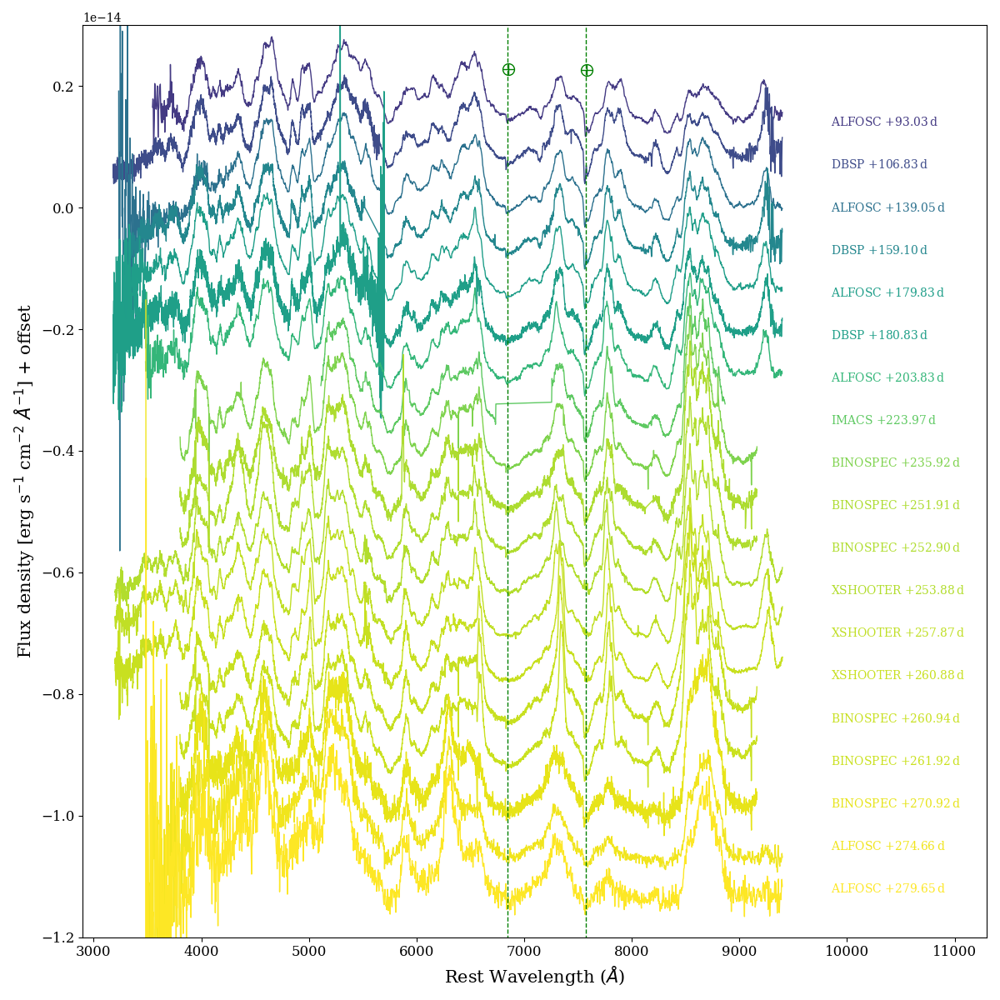

0 not0806
1 dbsp0820
2 not0921
3 dbsp1011
4 not1031
5 dbsp1102
6 not1125
7 imacs1214
8 binospec1227
9 binospec0112
10 binospec0113
11 xsh0114
12 xsh0118
13 xsh0121
14 binospec0120
15 binospec0121
16 binospec0131
17 not0203
18 not0208
19:23:12 Assigning font /b'F1' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif.ttf'
19:23:12 Assigning font /b'F2' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf'
19:23:12 Assigning font /b'F3' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf'
19:23:12 Embedding font /opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf.
19:23:12 Writing TrueType font.
19:23:12 SUBSET /opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf characters: Å
19:23:12 Took 0.000s to load font
19:23:12 Reading 'maxp' table from disk
19:23:12 Decompiling 'maxp' table
1

19:23:12 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:23:12 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:23:12 Closed glyph list over 'GSUB': 7 glyphs after
19:23:12 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:23:12 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:23:12 Took 0.007s to close glyph list over 'GSUB'
19:23:12 Closing glyph list over 'MATH': 7 glyphs before
19:23:12 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:23:12 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:23:12 Reading 'MATH' table from disk
19:23:12 Decompiling 'MATH' table
19:23:12 Closed glyph list over 'MATH': 7 glyphs after
19:23:12 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:23:12 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:23:12 Took 0.004s to close glyph list over 'MATH'
19:23:12 Closing glyph list over 'glyf': 7 glyphs before
19:23:12 Glyph names

19:23:12 Glyph IDs:   [0, 1, 2, 3, 11, 12, 14, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 36, 37, 38, 39, 40, 41, 43, 44, 47, 48, 49, 50, 51, 53, 54, 55, 58, 59, 62, 64, 68, 70, 71, 72, 73, 74, 75, 76, 79, 80, 81, 82, 85, 86, 87, 88, 89, 91, 92, 2255, 3311, 3312, 3313, 3314, 3315]
19:23:12 Reading 'MATH' table from disk
19:23:12 Decompiling 'MATH' table
19:23:12 Closed glyph list over 'MATH': 75 glyphs after
19:23:12 Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'E', 'F', 'H', 'I', 'L', 'M', 'N', 'O', 'P', 'R', 'S', 'T', 'W', 'X', 'a', 'bracketleft', 'bracketright', 'c', 'd', 'e', 'eight', 'f', 'fi', 'five', 'fl', 'four', 'g', 'h', 'i', 'l', 'm', 'minus', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'parenleft', 'parenright', 'period', 'plus', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'uni239B', 'uni239C', 'uni239D', 'uni239E', 'uni239F', 'uni23A0', 'uni23A1', 'uni23A2', 'uni23A3', 'uni23A4', 'uni23A5', 'uni23A6', 'uniFB00', 'uniFB03', 'uniFB04', 'v', 'x', '

In [560]:
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]


fig, ax = plt.subplots(figsize=(12,12))
#ax.set_position([0.12,0.05,0.82,0.92])

spectable = spectable[spectable['specname']!='psh0511']
spectable = spectable[spectable['specname']!='efosc0820']
spectable = spectable[spectable['specname']!='efosc0524']
spectable = spectable[spectable['specname']!='efosc1223']


spectable_plot = spectable.copy()
spectable_plot = spectable_plot[spectable_plot['instrument']!='SEDM']

epoch_max = np.max(spectable['phase'])
epoch_min = np.min(spectable['phase'])


#cmap = mpl.cm.twilight_shifted
#cmap = mpl.cm.twilight
cmap = mpl.cm.viridis
norm = mpl.colors.Normalize(vmin=epoch_min, vmax=epoch_max)




f0 = 1e-15
fspace = 7e-16
j = 0
for i,(specname, phase, instru) in enumerate(spectable_plot[['specname','phase', 'instrument']]):
    print(i, specname)
    
    if 'spec_photcal_smooth' in specs_22jli[specname].keys():
        specdata = specs_22jli[specname]['spec_photcal_smooth'].copy()
    else:
        specdata = specs_22jli[specname]['spec_photcal'].copy()
    sampleindice = (specdata[:,0]>5000)*(specdata[:,0]<7000)
    fluxanchor = np.mean(specdata[sampleindice,1])
    
    specdata[:,1] = specdata[:,1]*(f0/fluxanchor)
        
    offset = f0-j*fspace
        
#     color_id = (phase - epoch_min)/(epoch_max-epoch_min)
#     color = (1-color_id, 0, color_id)

    color = cmap( (phase - epoch_min )/(epoch_max-epoch_min) )

    lw=1
    alpha=1
    
    xs = specdata[:,0]/(1+z_22jli)
    ys = specdata[:,1]+offset
    ys = ys[xs<9400]
    xs = xs[xs<9400]
    
    if instru == 'XSHOOTER':
        ys = ys[xs>3200]
        xs = xs[xs>3200]
    
    
    ax.plot(xs, ys, color=color, lw=lw, alpha=alpha)
    

    textoffset = 4e-16
    #print(j, fspace)
    ax.text(9850, f0-j*fspace + textoffset,   '{} +{:.2f}$\,$d '.format(instru, phase), va='center', fontsize=10, color=color)

    j += 1
    
    if specname == 'not0806':
        ytell = np.max(ys[(xs>7300)*(xs<7600)])
        ax.plot(xs[ys==ytell]+240, ytell+1e-16, 'o', ms=10, mec='g', mfc='none')
        ax.plot(xs[ys==ytell]+240, ytell+1e-16, '+', ms=10, mec='g', mfc='none')
        ytell = np.max(ys[(xs>6600)*(xs<6800)])
        ax.plot(xs[ys==ytell]+250, ytell, 'o', ms=10, mec='g', mfc='none')
        ax.plot(xs[ys==ytell]+250, ytell, '+', ms=10, mec='g', mfc='none')    
    
#ax.plot(telluriclines['waveobs']*10/(1+z_22vqz), tellsmooth1*3e-16+2.15e-14, 'g', alpha=0.2)  
    
ax.vlines(np.array([6880, 7614])/(1+z_22jli), ymin=-2.3e-14, ymax=4e-15, color='g', linestyles='dashed', lw=1, alpha=1)
#ax.vlines(np.array([6300, 6363]), ymin=-2.3e-14, ymax=4e-15, color='c', linestyles='dashed', lw=1, alpha=1)
#ax.vlines(np.array([4861, 6563]), ymin=-3e-14, ymax=4e-15, color='c', linestyles='dashed', lw=1, alpha=1)



ax.set_xlim([2900,11300])

ax.set_ylim([-1.2e-14, 3e-15])

#ax.set_yticks([])
ax.tick_params(labelsize=12)
ax.set_xlabel('Rest Wavelength ($\AA$)', fontsize=15)
ax.set_ylabel('Flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$] + offset', fontsize=15)


plt.tight_layout()
plt.savefig('./plots/spec_all_opt_exclude_SEDM.pdf')


<IPython.core.display.Javascript object>


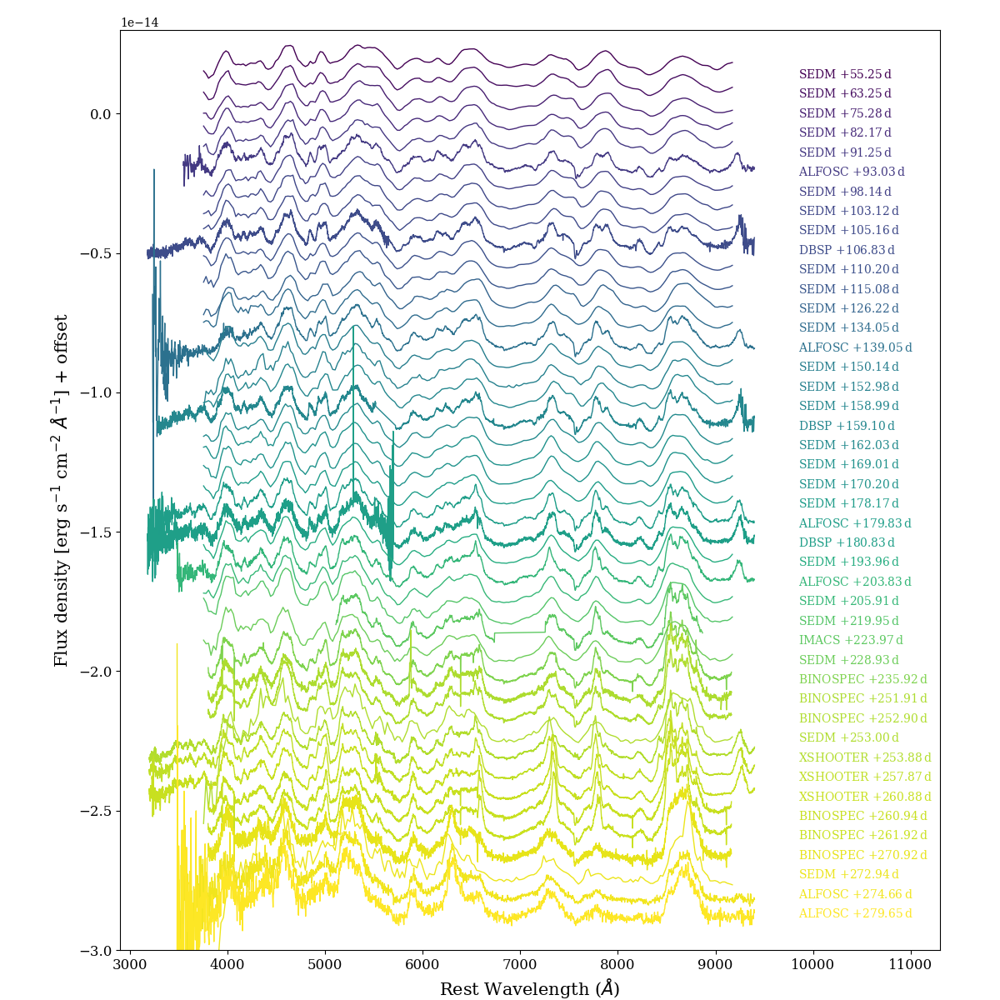

0 sedm0629
1 sedm0707
2 sedm0719
3 sedm0726
4 sedm0804
5 not0806
6 sedm0811
7 sedm0816
8 sedm0818
9 dbsp0820
10 sedm0823
11 sedm0828
12 sedm0908
13 sedm0916
14 not0921
15 sedm1002
16 sedm1005
17 sedm1011
18 dbsp1011
19 sedm1014
20 sedm1021
21 sedm1022
22 sedm1030
23 not1031
24 dbsp1102
25 sedm1115
26 not1125
27 sedm1127
28 sedm1211
29 imacs1214
30 sedm1220
31 binospec1227
32 binospec0112
33 binospec0113
34 sedm0113
35 xsh0114
36 xsh0118
37 xsh0121
38 binospec0120
39 binospec0121
40 binospec0131
41 sedm0202
42 not0203
43 not0208
19:03:48 Assigning font /b'F1' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif.ttf'
19:03:48 Assigning font /b'F2' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf'
19:03:48 Assigning font /b'F3' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf'
19:03:49 Embedding font /opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/f

19:03:49 Decompiling 'head' table
19:03:49 Took 0.011s to load 'glyf'
19:03:49 Took 0.000s to prune 'glyf'
19:03:49 glyf pruned
19:03:49 Took 0.001s to close glyph list over 'cmap'
19:03:49 Added gid0 to subset
19:03:49 Added first four glyphs to subset
19:03:49 Closing glyph list over 'GSUB': 7 glyphs before
19:03:49 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:03:49 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:03:49 Closed glyph list over 'GSUB': 7 glyphs after
19:03:49 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:03:49 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:03:49 Took 0.006s to close glyph list over 'GSUB'
19:03:49 Closing glyph list over 'MATH': 7 glyphs before
19:03:49 Glyph names: ['.notdef', '.null', 'minus', 'nonmarkingreturn', 'one', 'space', 'two']
19:03:49 Glyph IDs:   [0, 1, 2, 3, 20, 21, 3228]
19:03:49 Reading 'MATH' table from disk
19:03:49 Decompiling 'MATH' table
19:03:49 Closed gl

19:03:49 Took 0.007s to close glyph list over 'GSUB'
19:03:49 Closing glyph list over 'MATH': 63 glyphs before
19:03:49 Glyph names: ['.notdef', '.null', 'A', 'B', 'C', 'D', 'E', 'F', 'H', 'I', 'L', 'M', 'N', 'O', 'P', 'R', 'S', 'T', 'W', 'X', 'a', 'bracketleft', 'bracketright', 'c', 'd', 'e', 'eight', 'f', 'fi', 'five', 'fl', 'four', 'g', 'h', 'i', 'l', 'm', 'minus', 'n', 'nine', 'nonmarkingreturn', 'o', 'one', 'parenleft', 'parenright', 'period', 'plus', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'uniFB00', 'uniFB03', 'uniFB04', 'v', 'x', 'y', 'zero']
19:03:49 Glyph IDs:   [0, 1, 2, 3, 11, 12, 14, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 36, 37, 38, 39, 40, 41, 43, 44, 47, 48, 49, 50, 51, 53, 54, 55, 58, 59, 62, 64, 68, 70, 71, 72, 73, 74, 75, 76, 79, 80, 81, 82, 85, 86, 87, 88, 89, 91, 92, 2255, 3311, 3312, 3313, 3314, 3315]
19:03:49 Reading 'MATH' table from disk
19:03:49 Decompiling 'MATH' table
19:03:49 Closed glyph list over 'MATH': 75 glyphs after
19:03:49 

In [533]:
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]


fig, ax = plt.subplots(figsize=(12,12))
ax.set_position([0.12,0.05,0.82,0.92])

spectable = spectable[spectable['specname']!='psh0511']
spectable = spectable[spectable['specname']!='efosc0820']
spectable = spectable[spectable['specname']!='efosc0524']
spectable = spectable[spectable['specname']!='efosc1223']


epoch_max = np.max(spectable['phase'])
epoch_min = np.min(spectable['phase'])


#cmap = mpl.cm.twilight_shifted
#cmap = mpl.cm.twilight
cmap = mpl.cm.viridis
norm = mpl.colors.Normalize(vmin=epoch_min, vmax=epoch_max)




f0 = 1e-15
fspace = 7e-16
j = 0
for i,(specname, phase, instru) in enumerate(spectable[['specname','phase', 'instrument']]):
    print(i, specname)
    
    if 'spec_photcal_smooth' in specs_22jli[specname].keys():
        specdata = specs_22jli[specname]['spec_photcal_smooth'].copy()
    else:
        specdata = specs_22jli[specname]['spec_photcal'].copy()
    sampleindice = (specdata[:,0]>5000)*(specdata[:,0]<7000)
    fluxanchor = np.mean(specdata[sampleindice,1])
    
    specdata[:,1] = specdata[:,1]*(f0/fluxanchor)
        
    offset = f0-j*fspace
        
#     color_id = (phase - epoch_min)/(epoch_max-epoch_min)
#     color = (1-color_id, 0, color_id)

    color = cmap( (phase - epoch_min )/(epoch_max-epoch_min) )

    lw=1
    alpha=1
    
    xs = specdata[:,0]/(1+z_22jli)
    ys = specdata[:,1]+offset
    ys = ys[xs<9400]
    xs = xs[xs<9400]
    
    if instru == 'XSHOOTER':
        ys = ys[xs>3200]
        xs = xs[xs>3200]
    
    
    ax.plot(xs, ys, color=color, lw=lw, alpha=alpha)
    

    textoffset = 4e-16
    #print(j, fspace)
    ax.text(9850, f0-j*fspace + textoffset,   '{} +{:.2f}$\,$d '.format(instru, phase), va='center', fontsize=10, color=color)

    j += 1
    
    if specname == 'binospec0928':
        ytell = np.max(ys[(xs>7300)*(xs<7600)])
        ax.plot(xs[ys==ytell]+280, ytell+1e-16, 'o', ms=10, mec='g', mfc='none')
        ax.plot(xs[ys==ytell]+280, ytell+1e-16, '+', ms=10, mec='g', mfc='none')
        ytell = np.max(ys[(xs>6600)*(xs<6800)])
        ax.plot(xs[ys==ytell]+250, ytell+8e-17, 'o', ms=10, mec='g', mfc='none')
        ax.plot(xs[ys==ytell]+250, ytell+8e-17, '+', ms=10, mec='g', mfc='none')    
    
#ax.plot(telluriclines['waveobs']*10/(1+z_22vqz), tellsmooth1*3e-16+2.15e-14, 'g', alpha=0.2)  
    
#ax.vlines(np.array([6880, 7614])/(1+z_22jli), ymin=-2.3e-14, ymax=4e-15, color='g', linestyles='dashed', lw=1, alpha=1)
#ax.vlines(np.array([6300, 6363]), ymin=-2.3e-14, ymax=4e-15, color='c', linestyles='dashed', lw=1, alpha=1)
#ax.vlines(np.array([4861, 6563]), ymin=-3e-14, ymax=4e-15, color='c', linestyles='dashed', lw=1, alpha=1)



ax.set_xlim([2900,11300])

ax.set_ylim([-3e-14, 3e-15])

#ax.set_yticks([])
ax.tick_params(labelsize=12)
ax.set_xlabel('Rest Wavelength ($\AA$)', fontsize=15)
ax.set_ylabel('Flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$] + offset', fontsize=15)

plt.savefig('./plots/spec_all_opt.pdf')
#plt.savefig('./plots/spec_all_opt.png')

0 psh0511
1 efosc0524
2 sedm0629
3 sedm0707
4 sedm0719
5 sedm0726
6 sedm0804
7 not0806
8 sedm0811
9 sedm0816
10 sedm0818
11 dbsp0820
12 sedm0823
13 sedm0828
14 sedm0908
15 sedm0916
16 not0921
17 sedm1002
18 sedm1005
19 sedm1011
20 dbsp1011
21 sedm1014
22 sedm1021
23 sedm1022
24 sedm1030
25 not1031
26 dbsp1102
27 sedm1115
28 not1125
29 sedm1127
30 sedm1211
31 imacs1214
32 sedm1220
33 binospec1227
34 binospec0112
35 binospec0113
36 sedm0113
37 xsh0114
38 xsh0118
39 xsh0121
40 binospec0120
41 binospec0121
42 binospec0131
43 sedm0202
44 not0203
[0, 0, 2.1129932093818824e-11, 1.9877734800337436e-11, 1.607065561240922e-11, 1.468918567499647e-11, 1.3300231962154335e-11, 1.3829623721221968e-11, 1.1838065934376692e-11, 1.1444204490363671e-11, 1.2079747729302626e-11, 1.3969854959098992e-11, 1.0290650892059816e-11, 9.533577526103079e-12, 8.18580551652762e-12, 7.632896660844396e-12, 7.870064712625406e-12, 6.906798331343116e-12, 6.814646094660291e-12, 6.9016231962472545e-12, 7.967461882584763e-12, 

<ipython-input-77-02c0121c7e48>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(6,6))


<IPython.core.display.Javascript object>


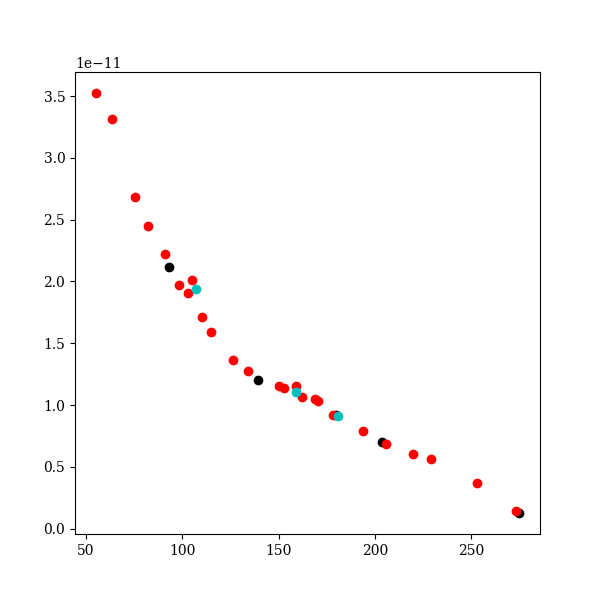

In [77]:
#get the spec photometry 

intflux_list = []

for i,(specname, phase, instru) in enumerate(spectable[['specname','phase', 'instrument']]):
    print(i, specname)
    if instru not in ['SEDM', 'DBSP', 'ALFOSC']:
        intflux_list.append(0)
        continue
    specdata = specs_22jli[specname]['spec_photcal'].copy()    
    intflux = trapz(specdata[:,1], x=specdata[:,0])
    intflux_list.append(intflux)
    
print(intflux_list)
spectable_intflux_added = spectable.copy()
spectable_intflux_added.add_column(Column(intflux_list, name='intflux'))


fig, ax = plt.subplots(figsize=(6,6))
mask = spectable_intflux_added['instrument'] == 'ALFOSC'
ax.plot(spectable_intflux_added['phase'][mask], spectable_intflux_added['intflux'][mask]*1.1*1.39, 'ko', label='ALFOSC')

spectable_intflux_added['intflux'][mask] = spectable_intflux_added['intflux'][mask]*1.1*1.39 #1.1 is wavelength coverage compare with DBSP; 1.39 is to include NIR

mask = spectable_intflux_added['instrument'] == 'SEDM'
ax.plot(spectable_intflux_added['phase'][mask], spectable_intflux_added['intflux'][mask]*1.2*1.39, 'ro', label='SEDM')
spectable_intflux_added['intflux'][mask] = spectable_intflux_added['intflux'][mask]*1.2*1.39

mask = spectable_intflux_added['instrument'] == 'DBSP'
ax.plot(spectable_intflux_added['phase'][mask], spectable_intflux_added['intflux'][mask]*1.39, 'co', label='DBSP')
spectable_intflux_added['intflux'][mask] = spectable_intflux_added['intflux'][mask]*1.39


spectable_intflux_added.write('./SN2022jli_specphot_bolometric_LC.csv', format='ascii.csv', overwrite=1)

<IPython.core.display.Javascript object>


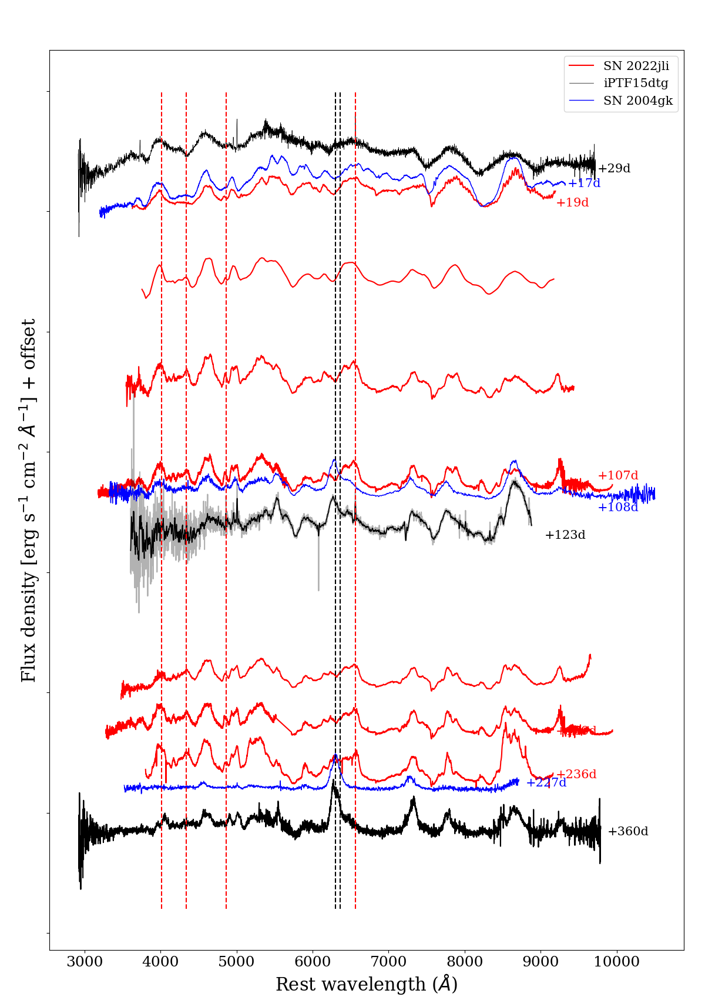

In [364]:
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]

fig, ax = plt.subplots(1,1, figsize=(12,17))
ax.set_position([0.07,0.05,0.9,0.9])

#=----------------------------- first epoch comparison 
#####
specname = 'efosc0524'
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.2 + 5e-15
ax.plot(xs, ys, 'r', label='SN 2022jli')
ax.text(9200, np.mean(ys[-10:])-2e-16, '+{:.0f}d'.format(phase), color='r', va='center', fontsize=15)


specname = '29.1d'
phase = 29
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
ys = spec[:,1]*20 + 5.5e-15
ax.plot(xs, ys, 'k', lw=0.5, label='iPTF15dtg')
ax.text(9750, np.mean(ys[-10:]), '+{:.0f}d'.format(phase), color='k', va='center', fontsize=15)



specname = '17.2d'
phase = 17
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
ys = spec[:,1]*3e-16 + 5e-15
ax.plot(xs, ys, 'b', lw=1, label='SN 2004gk')
ax.text(9350, np.mean(ys[-10:]), '+{:.0f}d'.format(phase), color='b', va='center', fontsize=15)


ax.legend(loc=1, fontsize=15)


#####
specname = 'sedm0629'
spec = specs_22jli[specname]['spec']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.2 + 3e-15
ax.plot(xs, ys, 'r',)

specname = 'not0806'
spec = specs_22jli[specname]['spec']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.2 + 1e-15
ax.plot(xs, ys, 'r',)


#--------------------------- comparison ---------
#####
specname = 'dbsp0820'  #107d after discovery
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*1e-17*0.2 - 1e-15
ax.plot(xs, ys, 'r',)
ax.text(9750, np.mean(ys[-10:])+2e-16, '+{:.0f}d'.format(phase), color='r', va='center', fontsize=15)



specname = '123.3d'
phase = 123
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
ys = spec[:,1]*20 - 2e-15
ax.plot(xs, ys, 'k', alpha=0.3)
ys_smooth = savgol_filter(ys, 25, 3)
ax.plot(xs, ys_smooth, 'k', label='', alpha=1, lw=1.2)
ax.text(9050, np.mean(ys[-10:])-2.5e-16, '+{:.0f}d'.format(phase), color='k', va='center', fontsize=15)


specname = '108.0d'
phase = 108
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
ys = spec[:,1]*1e-15 -1e-15
ax.plot(xs, ys, 'b', lw=1)
ax.text(9750, np.mean(ys[-10:])-2.5e-16, '+{:.0f}d'.format(phase), color='b', va='center', fontsize=15)



#specname = 'efosc0820'
#spec = specs_22jli[specname]['spec']
#xs = spec[:,0]/(1+z_22jli)
#ys = spec[:,1] - 5e-15
#ax.plot(xs, ys)


#specname = 'sedm0916' #134d
#spec = specs_22jli[specname]['spec']
#xs = spec[:,0]/(1+z_22jli)
#ys = spec[:,1]*2*0.2 - 3e-15
#ax.plot(xs, ys, 'r',)



#
specname = 'not0921'  #139d
spec = specs_22jli[specname]['spec']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*1e-17*0.3 - 5e-15
ax.plot(xs, ys, 'r',)


specname = 'dbsp1011'  #159d
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']

xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*1e-17*0.3 - 6e-15
ax.plot(xs, ys, 'r',)
ax.text(9200, np.mean(ys[-10:]), '+{:.0f}d'.format(phase), color='r', va='center', fontsize=15)

showthis = 0
if showthis:
    specname = 'not1031'  #179d
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]*0.2- 7e-15
    ax.plot(xs, ys, 'r',)
    ax.text(9200, np.mean(ys[-10:]), '+{:.0f}d'.format(phase), color='r', va='center', fontsize=15)


specname = 'binospec1227'  #236
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]- 7e-15
ax.plot(xs, ys, 'r',)
ax.text(9200, np.mean(ys[-10:]), '+{:.0f}d'.format(phase), color='r', va='center', fontsize=15)


#in the future


specname = '359.6d'
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
ys = spec[:,1]*20 - 8e-15
ax.plot(xs, ys, 'k')
ax.text(9880, np.mean(ys[-100:]), '+360d', color='k', va='center', fontsize=15)

specname = '226.5d'
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
ys = spec[:,1]*6e-15 - 7e-15
ax.plot(xs, ys, 'b', lw=1)
ax.text(8800, np.mean(ys[-100:]), '+227d', color='b', va='center', fontsize=15)


ax.vlines([6300,6363], ymin = -9.5e-15, ymax=7.5e-15, linestyles='dashed', colors='k')
ax.vlines([4012,4340,4861,6563], ymin = -9.5e-15, ymax=7.5e-15, linestyles='dashed', colors='r')

ax.set_yticklabels([])

#ax.set_xlim([2900,11900])
#ax.set_ylim([-0.1e-14, 1.15e-14])

#ax.set_yticks([])
ax.tick_params(labelsize=18)
ax.set_xlabel('Rest wavelength ($\AA$)', fontsize=22)
ax.set_ylabel('Flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$] + offset', fontsize=22)

plt.savefig('./plots/spec_figure.pdf')

<IPython.core.display.Javascript object>


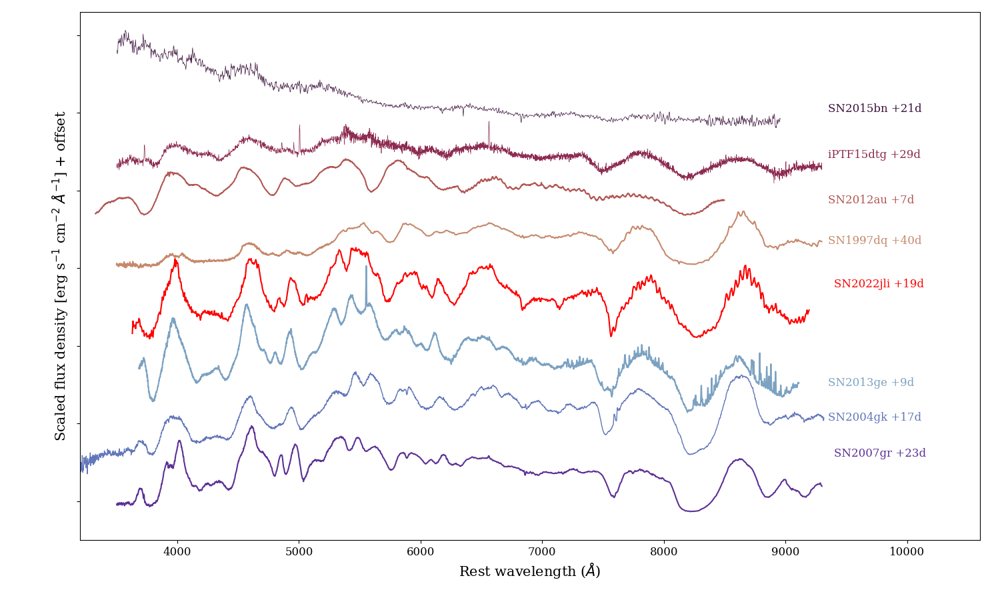

In [40]:
#this plot focus on the early-time spectra (before the second peak of 2022jli)

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]

wide_version = 1
if wide_version:
    fig, ax = plt.subplots(1,1, figsize=(15,9)) #wide version
else:
    fig, ax = plt.subplots(1,1, figsize=(6,6)) #narrow version

ax.set_position([0.08,0.1,0.9,0.88])


import pickle

#if previous saved result available
#outfile = '/Users/chenping/SNeData/Ping_collections/SNe_spectra/2022jli.20230212.p'
outfile = '/Users/chenping/SNeData/Ping_collections/SNe_spectra/2022jli.20230330.p'
with open(outfile, 'rb') as fp:
    specs_22jli = pickle.load(fp)

spectable = specs_22jli['spectable']
spectable.sort('phase')

#--------------------------- comparison ---------
#####


specname = 'efosc0524'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.3

xs_new, ys_new = spectrum_extinction_effect(xs, ys, -EBV, extmodel='gal3', compare_display=False)


#ax.plot(xs, ys, 'r', alpha=0.3, label='SN2022jli %sd')
ax.plot(xs_new, ys_new*0.5, 'r', label='SN2022jli %sd')

if wide_version:
    ax.text(9400, np.mean(ys_new[-10:]), 'SN2022jli +{:.0f}d'.format(phase), color='r', va='center', fontsize=12)
else:
    ax.text(9400, np.mean(ys_new[-10:])-3e-16, 'SN2022jli'.format(phase), color='r', va='center', fontsize=12)
    ax.text(9400, np.mean(ys_new[-10:])-5e-16, '(+{:.0f}d)'.format(phase), color='r', va='center', fontsize=12)


cmap = mpl.cm.twilight_shifted
#cmap = mpl.cm.twilight
norm = mpl.colors.Normalize(vmin=0, vmax=1)


specname = '9.3d'
phase = 9.3
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
offset = -1e-15
ys = spec[:,1]*3e-16 +offset
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, label='SN2013ge 9.3d')
if wide_version:
    ax.text(9350, np.mean(ys[-10:]), 'SN2013ge +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:])+1e-16, 'SN2013ge', color=color, va='center', fontsize=12)
    ax.text(9350, np.mean(ys[-10:])-1e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)

    
# specname = '20.3d'
# phase = 20.3
# spec = specinfo_13ge[specname]['spec']
# xs = spec[:,0]/(1+z_13ge)
# ys = spec[:,1]*4e-16 - 6e-16
# ax.plot(xs, ys, 'g', label='SN2013ge 20.3d')
# if wide_version:
#     ax.text(9350, np.mean(ys[-10:]), 'SN2013ge +{:.0f}d'.format(phase), color='g', va='center', fontsize=12)
# else:
#     ax.text(9350, np.mean(ys[-10:])-4e-16, 'SN2013ge', color='g', va='center', fontsize=15)
#     ax.text(9350, np.mean(ys[-10:])-5e-16, '(+{:.0f}d)'.format(phase), color='g', va='center', fontsize=12)



specname = '17.2d'
phase = 17
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
offset = - 1.5e-15
ys = spec[:,1]*3e-16 +offset
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, lw=1, label='SN 2004gk')
if wide_version:
    ax.text(9350, np.mean(ys[-10:]), 'SN2004gk +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:]), 'SN2004gk', color=color, va='center', fontsize=12)
    ax.text(9350, np.mean(ys[-10:])-2e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)



specname = '23.3d'
phase = 23.3
spec = specinfo_2007gr[specname]['spec']
xs = spec[:,0]/(1+z_07gr)
offset = - 2.2e-15
ys = spec[:,1]*5e-17 + offset
mask = (xs>3500)*(xs<9300)
ys = ys[mask]
xs = xs[mask]
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, label='2007gr '+specname)
if wide_version:
    ax.text(9400, np.mean(ys[-10:])+4e-16, 'SN2007gr +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9400, np.mean(ys[-10:])+1e-16, 'SN2007gr'.format(phase), color=color, va='center', fontsize=12)
    ax.text(9400, np.mean(ys[-10:])-1e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)

    
    
#####---------


specname = '39.6d'
phase = 39.6
spec = specinfo_97dq[specname]['spec']
xs = spec[:,0]/(1+z_97dq)
offset = 1e-15
ys = spec[:,1]*1e-16 + offset
mask = (xs>3500)*(xs<9300)
ys = ys[mask]
xs = xs[mask]
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, label='SN1997dq 39.6d')
if wide_version:
    ax.text(9350, np.mean(ys[-10:]), 'SN1997dq +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:]), 'SN1997dq', color=color, va='center', fontsize=12)
    ax.text(9350, np.mean(ys[-10:])-2e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)

    
specname = '6.6d'
phase = 6.6
spec = specinfo_12au[specname]['spec']
xs = spec[:,0]/(1+z_12au)
offset = 1.5e-15
ys = spec[:,1]*6e-17 + offset
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, label='SN2012au 6.6d')    
if wide_version:
    ax.text(9350, np.mean(ys[-10:]), 'SN2012au +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:]), 'SN2012au', color=color, va='center', fontsize=12)
    ax.text(9350, np.mean(ys[-10:])-2e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)
    

specname = '29.1d'
phase = 29
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
offset = 2e-15
ys = spec[:,1]*12 + offset
mask = (xs>3500)*(xs<9300)
ys = ys[mask]
xs = xs[mask]
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, lw=0.5, label='iPTF15dtg')
if wide_version:
    ax.text(9350, np.mean(ys[-10:])+1.6e-16, 'iPTF15dtg +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:])+2e-16, 'iPTF15dtg', color=color, va='center', fontsize=12)
    texth = ax.text(9350, np.mean(ys[-10:]), '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)
    #texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))


specname = '21.0d'
phase = 21
spec = specinfo_15bn[specname]['spec']
xs = spec[:,0]/(1+z_15bn)
offset = 2.8e-15
ys = spec[:,1] + offset
mask = (xs>3500)*(xs<9300)
ys = ys[mask]
xs = xs[mask]
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, lw=0.5, label='SN2015bn')
if wide_version:
    ax.text(9350, np.mean(ys[-10:])+1.6e-16, 'SN2015bn +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:])+2e-16, 'SN2015bn', color=color, va='center', fontsize=12)
    texth = ax.text(9350, np.mean(ys[-10:]), '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)
    #texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))

    
    
marklines = 0
if marklines:
    ax.vlines([6300,6363], ymin = -9.5e-15, ymax=7.5e-15, linestyles='dashed', colors='k')
    ax.vlines([4102,4340,4861,6563], ymin = -9.5e-15, ymax=7.5e-15, linestyles='dashed', colors='g')

ax.set_yticklabels([])

ax.set_xlim([3200,10600])

#ax.set_yticks([])
ax.tick_params(labelsize=12)
ax.set_xlabel('Rest wavelength ($\AA$)', fontsize=15)
ax.set_ylabel('Scaled flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$] + offset', fontsize=15)



ax.set_ylim([-2.5e-15, 4.3e-15])
#plt.savefig('./plots/spec_figure_compare_earlytime.png')

plt.savefig('./plots/spec_figure_compare_earlytime.pdf')

In [ ]:
# photospheric spectra comparison and ejecta velocity plot together

<IPython.core.display.Javascript object>


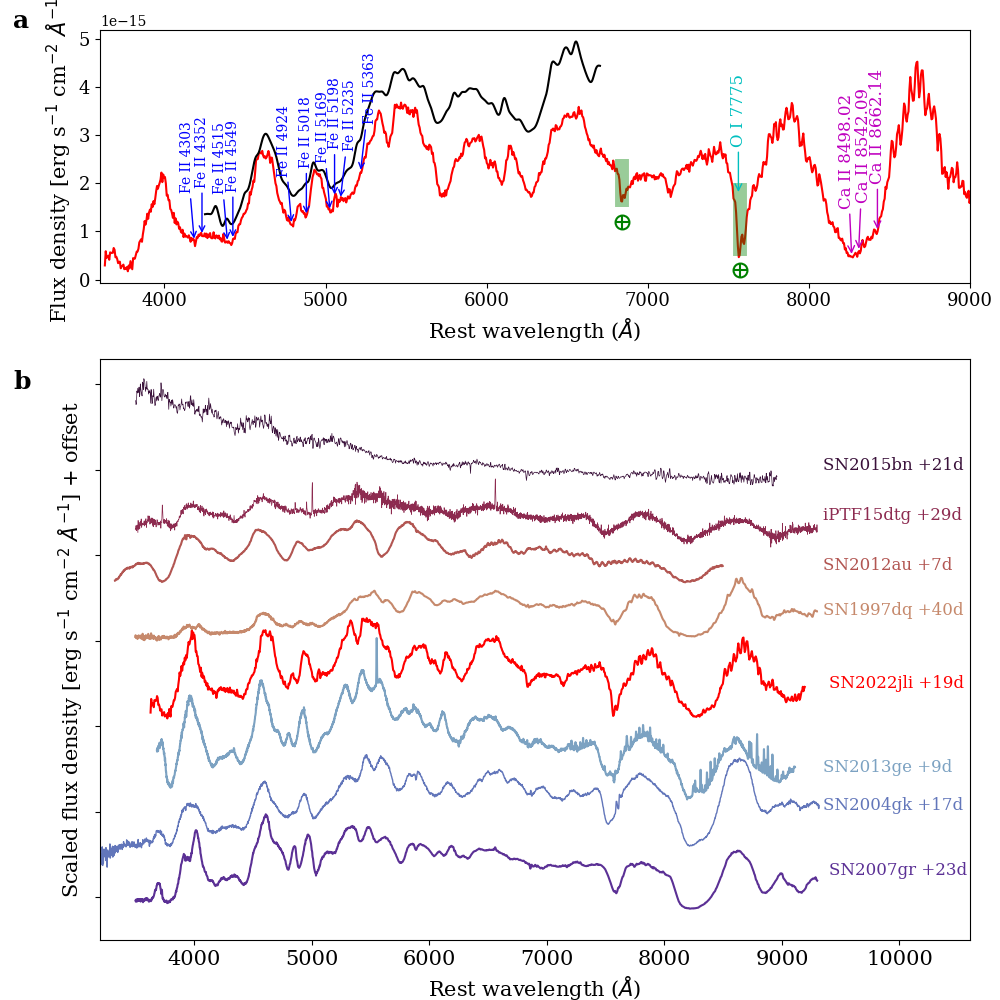

In [68]:
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'

jd = Time('2022-05-24T10:00:31', format='isot').jd 
phase = jd-t0_22jli

specdata = np.loadtxt('./spectra/tns/tns_2022jzy_2022-05-24_10-00-31_ESO-NTT_EFOSC2-NTT_ePESSTO+.asci')

spec_interp = interp1d(specdata[:,0]/(1+z_22jli), specdata[:,1])

fig = plt.figure(figsize=(10,10))
gs0 = GridSpec(3, 1, figure=fig, hspace=0.3, wspace=0., left=0.1, right=0.97, bottom=0.06, top=0.97)

ax1 = fig.add_subplot(gs0[0, 0])

ax1.plot(specdata[:,0]/(1+z_22jli), specdata[:,1], 'r', label='SN2022jli efosc0524')
ax1.set_xlim([3600, 9000])


spec0 = np.loadtxt('spectra/tns/tns_2022jli_2022-05-11_03-27-00_Other_Other_PSH.dat')

ax1.plot(spec0[:,0]/(1+z_22jli), spec0[:,1]*2e-15, 'k', label='SN2022jli other0511')


ax1.set_xlabel(r'Rest wavelength ($\AA$)', fontsize=15)
ax1.set_ylabel(r'Flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]', fontsize=15)


FeII_lines = [4303, 4352, 4515, 4549, 4924, 5018, 5169, 5198, 5235, 5363]
vshift_FeII = -8200.
for i, w in enumerate(FeII_lines):

    w_shifted = w*(1+vshift_FeII/300000)
    f = spec_interp(w_shifted)
    if i in [0, 2, 4, 6]:
        wadd = -45
    elif i in [8, 9]:
        wadd = 60
#    elif i ==9:
#        wadd = 30
    else:
        wadd = 0
    ax1.annotate("Fe II %s"%(str(w)),color='b', xy=(w_shifted, f), ha='center', va='bottom', xycoords='data',
            xytext=(w_shifted+wadd, f+1e-15), textcoords='data', arrowprops=dict(arrowstyle="->", connectionstyle="arc3", color='b'), rotation=90, fontsize=10)

CaII_lines = [8498.02, 8542.09, 8662.14]
vshift_CaII = -8200.
for i,w in enumerate(CaII_lines):
    w_shifted = w*(1+vshift_CaII/300000)
    f = spec_interp(w_shifted)
    if i==0:
        wadd = -30
    elif i ==1:
        wadd = 30
    else:
        wadd = 0
    ax1.annotate("Ca II %s"%(str(w)),color='m', xy=(w_shifted, f), ha='center', va='bottom', xycoords='data',
            xytext=(w_shifted+wadd, f+1e-15), textcoords='data', arrowprops=dict(arrowstyle="->", connectionstyle="arc3", color='m'), rotation=90, fontsize=12)    

w = 7775
vshift_OI = -8200
w_shifted = w*(1+vshift_OI/300000)
f = spec_interp(w_shifted) + 1.2e-15
wadd=0
ax1.annotate("O I %s"%(str(w)),color='c', xy=(w_shifted, f), ha='center', va='bottom', xycoords='data',
            xytext=(w_shifted+wadd, f+1e-15), textcoords='data', arrowprops=dict(arrowstyle="->", connectionstyle="arc3", color='c'), rotation=90, fontsize=12)     
    
    
    
ax1.vlines(np.array([6880])/(1+z_22jli), ymin=1.5e-15, ymax=2.5e-15, color='g', linestyles='solid', lw=10, alpha=0.4)
ax1.vlines(np.array([7614])/(1+z_22jli), ymin=5e-16, ymax=2e-15, color='g', linestyles='solid', lw=10, alpha=0.4)
ax1.plot(6880/(1+z_22jli), 1.2e-15, 'o', ms=10, mfc='none', mec='g', mew=1.5)
ax1.plot(6880/(1+z_22jli), 1.2e-15, '+', ms=10, mfc='none', mec='g', mew=1.5)

ax1.plot(7614/(1+z_22jli), 2e-16, 'o', ms=10, mfc='none', mec='g', mew=1.5)
ax1.plot(7614/(1+z_22jli), 2e-16, '+', ms=10, mfc='none', mec='g', mew=1.5)


ax1.tick_params(labelsize=13)



##---------------------------------

ax = fig.add_subplot(gs0[1:3, 0])

#####


specname = 'efosc0524'  #
spec = specs_22jli[specname]['spec']
phase = specs_22jli[specname]['phase']
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*0.3

xs_new, ys_new = spectrum_extinction_effect(xs, ys, -EBV, extmodel='gal3', compare_display=False)


#ax.plot(xs, ys, 'r', alpha=0.3, label='SN2022jli %sd')
ax.plot(xs_new, ys_new*0.5, 'r', label='SN2022jli %sd')

if wide_version:
    ax.text(9400, np.mean(ys_new[-10:])-3e-16, 'SN2022jli +{:.0f}d'.format(phase), color='r', va='center', fontsize=12)
else:
    ax.text(9400, np.mean(ys_new[-10:])-3e-16, 'SN2022jli'.format(phase), color='r', va='center', fontsize=12)
    ax.text(9400, np.mean(ys_new[-10:])-5e-16, '(+{:.0f}d)'.format(phase), color='r', va='center', fontsize=12)


cmap = mpl.cm.twilight_shifted
#cmap = mpl.cm.twilight
norm = mpl.colors.Normalize(vmin=0, vmax=1)


specname = '9.3d'
phase = 9.3
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
offset = -1e-15
ys = spec[:,1]*3e-16 +offset
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, label='SN2013ge 9.3d')
if wide_version:
    ax.text(9350, np.mean(ys[-10:]), 'SN2013ge +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:])+1e-16, 'SN2013ge', color=color, va='center', fontsize=12)
    ax.text(9350, np.mean(ys[-10:])-1e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)

    
# specname = '20.3d'
# phase = 20.3
# spec = specinfo_13ge[specname]['spec']
# xs = spec[:,0]/(1+z_13ge)
# ys = spec[:,1]*4e-16 - 6e-16
# ax.plot(xs, ys, 'g', label='SN2013ge 20.3d')
# if wide_version:
#     ax.text(9350, np.mean(ys[-10:]), 'SN2013ge +{:.0f}d'.format(phase), color='g', va='center', fontsize=12)
# else:
#     ax.text(9350, np.mean(ys[-10:])-4e-16, 'SN2013ge', color='g', va='center', fontsize=15)
#     ax.text(9350, np.mean(ys[-10:])-5e-16, '(+{:.0f}d)'.format(phase), color='g', va='center', fontsize=12)



specname = '17.2d'
phase = 17
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
offset = - 1.5e-15
ys = spec[:,1]*3e-16 +offset
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, lw=1, label='SN 2004gk')
if wide_version:
    ax.text(9350, np.mean(ys[-10:]), 'SN2004gk +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:]), 'SN2004gk', color=color, va='center', fontsize=12)
    ax.text(9350, np.mean(ys[-10:])-2e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)



specname = '23.3d'
phase = 23.3
spec = specinfo_2007gr[specname]['spec']
xs = spec[:,0]/(1+z_07gr)
offset = - 2.2e-15
ys = spec[:,1]*5e-17 + offset
mask = (xs>3500)*(xs<9300)
ys = ys[mask]
xs = xs[mask]
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, label='2007gr '+specname)
if wide_version:
    ax.text(9400, np.mean(ys[-10:])+1e-16, 'SN2007gr +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9400, np.mean(ys[-10:])+1e-16, 'SN2007gr'.format(phase), color=color, va='center', fontsize=12)
    ax.text(9400, np.mean(ys[-10:])-1e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)

    
    
#####---------


specname = '39.6d'
phase = 39.6
spec = specinfo_97dq[specname]['spec']
xs = spec[:,0]/(1+z_97dq)
offset = 1e-15
ys = spec[:,1]*1e-16 + offset
mask = (xs>3500)*(xs<9300)
ys = ys[mask]
xs = xs[mask]
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, label='SN1997dq 39.6d')
if wide_version:
    ax.text(9350, np.mean(ys[-10:]), 'SN1997dq +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:]), 'SN1997dq', color=color, va='center', fontsize=12)
    ax.text(9350, np.mean(ys[-10:])-2e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)

    
specname = '6.6d'
phase = 6.6
spec = specinfo_12au[specname]['spec']
xs = spec[:,0]/(1+z_12au)
offset = 1.5e-15
ys = spec[:,1]*6e-17 + offset
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, label='SN2012au 6.6d')    
if wide_version:
    ax.text(9350, np.mean(ys[-10:]), 'SN2012au +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:]), 'SN2012au', color=color, va='center', fontsize=12)
    ax.text(9350, np.mean(ys[-10:])-2e-16, '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)
    

specname = '29.1d'
phase = 29
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
offset = 2e-15
ys = spec[:,1]*12 + offset
mask = (xs>3500)*(xs<9300)
ys = ys[mask]
xs = xs[mask]
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, lw=0.5, label='iPTF15dtg')
if wide_version:
    ax.text(9350, np.mean(ys[-10:])+1.6e-16, 'iPTF15dtg +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:])+2e-16, 'iPTF15dtg', color=color, va='center', fontsize=12)
    texth = ax.text(9350, np.mean(ys[-10:]), '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)
    #texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))


specname = '21.0d'
phase = 21
spec = specinfo_15bn[specname]['spec']
xs = spec[:,0]/(1+z_15bn)
offset = 2.8e-15
ys = spec[:,1] + offset
mask = (xs>3500)*(xs<9300)
ys = ys[mask]
xs = xs[mask]
color = cmap((offset+3e-15)/6e-15)
ax.plot(xs, ys, color=color, lw=0.5, label='SN2015bn')
if wide_version:
    ax.text(9350, np.mean(ys[-10:])+1.6e-16, 'SN2015bn +{:.0f}d'.format(phase), color=color, va='center', fontsize=12)
else:
    ax.text(9350, np.mean(ys[-10:])+2e-16, 'SN2015bn', color=color, va='center', fontsize=12)
    texth = ax.text(9350, np.mean(ys[-10:]), '(+{:.0f}d)'.format(phase), color=color, va='center', fontsize=12)
    #texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))

    
    
marklines = 0
if marklines:
    ax.vlines([6300,6363], ymin = -9.5e-15, ymax=7.5e-15, linestyles='dashed', colors='k')
    ax.vlines([4102,4340,4861,6563], ymin = -9.5e-15, ymax=7.5e-15, linestyles='dashed', colors='g')

ax.set_yticklabels([])

ax.set_xlim([3200,10600])

#ax.set_yticks([])
ax.tick_params(labelsize=15)
ax.set_xlabel('Rest wavelength ($\AA$)', fontsize=15)
ax.set_ylabel('Scaled flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$] + offset', fontsize=15)



ax.set_ylim([-2.5e-15, 4.3e-15])

ax1.set_title('a', fontsize=18, loc='left', pad=20, x=-0.1, y=0.9, fontweight='bold')
ax.set_title('b', fontsize=18, loc='left',  pad=20, x=-0.1, y=0.9, fontweight='bold')


plt.savefig('./plots/ejecta_velocity_wideversion_photspec_compare.pdf')

In [74]:
#This plot focuses on the late-time comparison 


matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'serif'
#matplotlib.rcParams['font.sans-serif'] = ["Helvetica"]

wide_version = 1
if wide_version:
    fig, ax = plt.subplots(1,1, figsize=(12,9)) #wide version
else:
    fig, ax = plt.subplots(1,1, figsize=(9,12)) #narrow version

ax.set_position([0.06,0.08,0.9,0.9])


xref1 = 6150 #in rest frame
xref2 = 6500
specname = 'not1125'  #
spec = specs_22jli[specname]['spec_photcal']
mask = (spec[:,0]>(xref1*(1+z_22jli)))*(spec[:,0]<(xref2*(1+z_22jli)))
xsref = spec[mask,0]
ysref = spec[mask,1]
refflux = trapz(ysref, xsref)
print(refflux)

#--------------------------- comparison ---------
#####

showthis = 1
if showthis:
    specname = 'not1125'  #
    print(specname)
    spec = specs_22jli[specname]['spec_photcal']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]
    mask = (xs>xref1)*(xs<xref2)
    intflux = trapz(ys[mask], xs[mask])
    print(intflux)
    scalefactor = refflux/intflux
    print(scalefactor)
    mask = (xs>3500)*(xs<9500)
    ys = ys[mask]*scalefactor
    xs = xs[mask]
    ys_smooth = savgol_filter(ys, 15, 2)
    ax.plot(xs, ys, 'r', alpha=0.2, label='SN2022jli %sd')    
    ax.plot(xs, ys_smooth, 'r', label='SN2022jli %sd')
    if wide_version:
        ax.text(8900, np.mean(ys[-10:])+2e-16, 'SN2022jli +{:.0f}d'.format(phase), color='r', va='center', fontsize=15)
    else:
        ax.text(9400, np.mean(ys[-10:])+2e-16, 'SN2022jli'.format(phase), color='r', va='center', fontsize=15)
        ax.text(9400, np.mean(ys[-10:])+1e-16, '(+{:.0f}d)'.format(phase), color='r', va='center', fontsize=15)
    
    
    
    
showthis=1
if showthis:
    specname = 'binospec0131'  #
    spec = specs_22jli[specname]['spec']
    phase = specs_22jli[specname]['phase']
    xs = spec[:,0]/(1+z_22jli)
    ys = spec[:,1]
    mask = (xs>xref1)*(xs<xref2)
    intflux = trapz(ys[mask], xs[mask])
    print(intflux)
    scalefactor = refflux/intflux
    print(scalefactor)
    mask = (xs>3500)*(xs<9500)
    xs = xs[mask]
    ys = ys[mask]*scalefactor - 5e-16
    ys_smooth = savgol_filter(ys, 15, 2)
    ax.plot(xs, ys, 'r', alpha=0.2, )
    ax.plot(xs, ys_smooth, 'r', label='SN2022jli %sd')
    if wide_version:
        ax.text(8900, np.mean(ys[-10:])+1e-16, 'SN2022jli +{:.0f}d'.format(phase), color='r', va='center', fontsize=15)


cmap = mpl.cm.twilight_shifted
#cmap = mpl.cm.twilight
norm = mpl.colors.Normalize(vmin=0, vmax=1)
        
        
specname = '359.6d'
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = 1e-15
ys = ys[mask]*scalefactor + offset
ys_smooth = savgol_filter(ys, 15, 2)
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, alpha=0.2, label='iPTF15dtg 359.6d')
ax.plot(xs, ys_smooth, color=color, label='iPTF15dtg 359.6d')
if wide_version:
    texth = ax.text(8800, np.mean(ys[-100:])+4e-16, 'iPTF15dtg +360d', color=color, va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
else:
    texth = ax.text(9400, np.mean(ys[-100:])+2e-16, 'iPTF15dtg', color='k', va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
    texth = ax.text(9400, np.mean(ys[-100:])+1e-16, '(+360d)', color='k', va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))


specname = '321.6d'
spec = specinfo_12au[specname]['spec']
xs = spec[:,0]/(1+z_12au)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = 1.5e-15
ys = ys[mask]*scalefactor + offset
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, label='SN2012au 321.6d')
if wide_version:
    ax.text(8800, np.mean(ys[-100:])+3e-16, 'SN2012au +322d', color=color, va='center', fontsize=15)
else:
    ax.text(8800, np.mean(ys[-100:])+2e-16, 'SN2012au', color='m', va='center', fontsize=15)
    ax.text(8800, np.mean(ys[-100:])+1e-16, '(+322d)', color='m', va='center', fontsize=15)

    
    
specname = '242.6d'
spec = specinfo_97dq[specname]['spec']
xs = spec[:,0]/(1+z_97dq)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = 2e-15
ys = ys[mask]*scalefactor + offset
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, label='SN1997dq 242.6d')
if wide_version:
    texth = ax.text(8900, np.mean(ys[-100:])+3e-16, 'SN1997dq +243d', color=color, va='center', fontsize=15)
    #texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
else:
    texth = ax.text(9400, np.mean(ys[-100:])+1.0e-16, 'SN1997dq', color='c', va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))    
    texth = ax.text(9400, np.mean(ys[-100:])+0.5e-16, '(+243d)', color='c', va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
    

specname = '350.0d'
spec = specinfo_15bn[specname]['spec']
xs = spec[:,0]/(1+z_15bn)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = 2.5e-15
ys = ys[mask]*scalefactor + offset
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, label='SN2015bn 350.0d')
if wide_version:
    texth = ax.text(8900, np.mean(ys[-100:])+3e-16, 'SN2015bn +350d', color=color, va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
else:
    ax.text(8800, np.mean(ys[-100:])+2e-16, 'SN2015bn', color='m', va='center', fontsize=15)
    ax.text(8800, np.mean(ys[-100:])+1e-16, '(+350d)', color='m', va='center', fontsize=15)
    

specname = '412.0d'
spec = specinfo_07bi[specname]['spec']
xs = spec[:,0]/(1+z_07bi)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = 3e-15
ys = ys[mask]*scalefactor + offset
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, label='SN2007bi 412.0d')
if wide_version:
    ax.text(8900, np.mean(ys[-100:])+3e-16, 'SN2007bi +412d', color=color, va='center', fontsize=15)
else:
    ax.text(8800, np.mean(ys[-100:])+2e-16, 'SN2007bi', color='m', va='center', fontsize=15)
    ax.text(8800, np.mean(ys[-100:])+1e-16, '(+412d)', color='m', va='center', fontsize=15)

    
    
    
#---------
    
specname = '226.5d'
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = -1e-15
ys = ys[mask]*scalefactor + offset
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, lw=1, label='2004gk 226.5d')
if wide_version:
    ax.text(8800, np.mean(ys[-100:]), 'SN2004gk +227d', color=color, va='center', fontsize=15)
else:
    ax.text(8800, np.mean(ys[-100:]), 'SN2004gk', color='b', va='center', fontsize=15)
    ax.text(8800, np.mean(ys[-100:])-1e-16, '(+227d)', color='b', va='center', fontsize=15)



specname = '160.6d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset =  -1.5e-15
ys = ys[mask]*scalefactor +offset
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, label='SN2013ge 160.6d')
if wide_version:
    texth = ax.text(8900, np.mean(ys[-100:])+3e-16, 'SN2013ge +161d', color=color, va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
else:
    texth = ax.text(9400, np.mean(ys[-100:])+2e-16, 'SN2013ge', color='g', va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
    texth = ax.text(9400, np.mean(ys[-100:])+1e-16, '(+161d)', color='g', va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
    
    
specname = '337.3d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = -2e-15
ys = ys[mask]*scalefactor + offset
color = cmap((offset+4e-15)/8e-15)
ys_smooth = savgol_filter(ys, 15, 2)
ax.plot(xs, ys, color=color, alpha=0.2, label='SN2013ge 337.3d')
ax.plot(xs, ys_smooth, color=color, label='SN2013ge 337.3d')
if wide_version:
    texth = ax.text(8900, np.mean(ys[-100:])+3e-16, 'SN2013ge +337d', color=color, va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
else:
    texth = ax.text(9400, np.mean(ys[-100:])+2e-16, 'SN2013ge', color='g', va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))    
    texth = ax.text(9400, np.mean(ys[-100:])+1e-16, '(+337d)', color='g', va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))    
    
    
specname = '183.0d'
spec = specinfo_2007gr[specname]['spec']
xs = spec[:,0]/(1+z_07gr)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = -2.5e-15
ys = ys[mask]*scalefactor +offset
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, label='2007gr 183.0')
if wide_version:
    texth = ax.text(8900, np.mean(ys[-100:])+2e-16, 'SN2007gr +183d', color=color, va='center', fontsize=15)
    texth.set_bbox(dict(facecolor='white', alpha=0.9, edgecolor='white'))
else:
    ax.text(9300, np.mean(ys[-100:])+1e-16, 'SN2007gr', color='y', va='center', fontsize=15)
    ax.text(9300, np.mean(ys[-100:]), '(+183d)', color='y', va='center', fontsize=15)

specname = '441.5d'
spec = specinfo_2007gr[specname]['spec']
xs = spec[:,0]/(1+z_07gr)
ys = spec[:,1]
mask = (xs>xref1)*(xs<xref2)
intflux = trapz(ys[mask], xs[mask])
print(intflux)
scalefactor = refflux/intflux
print(scalefactor)
mask = (xs>3500)*(xs<9500)
xs = xs[mask]
offset = -3.3e-15
ys = ys[mask]*scalefactor + offset
ys_smooth = savgol_filter(ys, 15, 2)
color = cmap((offset+4e-15)/8e-15)
ax.plot(xs, ys, color=color, alpha=0.2, label='2007gr 381.6d')
ax.plot(xs, ys_smooth, color=color, label='2007gr 381.6d')
if wide_version:
    ax.text(8900, np.mean(ys[-100:])+3e-16, 'SN2007gr +442d', color=color, va='center', fontsize=15)
else:
    ax.text(9300, np.mean(ys[-100:])+1e-16, 'SN2007gr', color='y', va='center', fontsize=15)
    ax.text(9300, np.mean(ys[-100:]), '(+442d)', color='y', va='center', fontsize=15)


    
#ax.legend(loc=0)

#ax.plot(spec_18ibb[:,0]/(1+z_18ibb), spec_18ibb[:,1]*100-5.5e-15)

marklines = 1
if marklines:
#    ax.vlines([6300,6363], ymin = -9.5e-15, ymax=7.5e-15, linestyles='dashed', colors='k')
    ax.vlines([4861,6563], ymin = -9.5e-15, ymax=7.5e-15, linestyles='dashed', colors='g')


ax.set_yticklabels([])

#ax.set_xlim([3000,10400])
ax.set_xlim([3400,10100])

#ax.set_yticks([])
ax.tick_params(labelsize=18)
ax.set_xlabel('Rest wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Scaled flux density [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$] + offset', fontsize=20)



ax.set_ylim([-3.5e-15, 4.6e-15])
#plt.savefig('./plots/spec_figure_compare_latetime.png')
plt.savefig('./plots/spec_figure_compare_latetime.pdf')

<IPython.core.display.Javascript object>

2.909288189492597e-13
not1125
2.893374629032918e-13
1.0054999999999992
5.0934082615899707e-14
5.711869224055537


NameError: name 'specinfo_15dtg' is not defined

## FIRE 2022-08-25

jd_iso_convert.py 2022-08-26T07:46:30 iso2jd
2022-08-26T07:46:30 ---> 2459817.823958333

In [516]:
print(2459817.823958333 - t0_22jli)

print(63.4*8) #exposure time

113.15395833319053
507.2


In [517]:
specdir = '/Users/chenping/Ping/SN2022jli/spectra/magellan_fire_20220825'

specfiles = [specfile for specfile in os.listdir(specdir) if specfile.endswith('f.txt')]

optspec = Table.read('/Users/chenping/Ping/SN2022jli/spectra/ZTF22aapubuy_DBSP_2022-08-20T00_00_00.csv',format='ascii.csv')

sofi0930 = np.loadtxt('./spectra/sofi/sn2022jli_SOFI_20220930.txt')
sofi1013 = np.loadtxt('./spectra/sofi/SN2022jli_SOFI_20221013.txt')

hip77 = np.loadtxt('./spectra/magellan_fire_20220825/hip77_spec.txt')
hip77_02 = np.loadtxt('./spectra/magellan_fire_20220825/hip77_spec_0117.txt')

In [518]:
print(specfiles)

['fire_0108_sub.f.txt', 'fire_0111_sub.f.txt', 'fire_0109_sub.f.txt', 'fire_0110_sub.f.txt', 'fire_0115_sub.f.txt', 'fire_0112_sub.f.txt', 'fire_0114_sub.f.txt']


In [519]:
telluriclines= np.loadtxt('/Users/chenping/SNeData/Ping_collections/Telluric/telluric_example.dat')  #wavelength in vacuum 
tellsmooth = savgol_filter(telluriclines[:,1], 151, 3)

tell_wave_air = wavelength_convert_air_vacuum(telluriclines[:,0], verbose=0) #wavelength convertion to air 
print(telluriclines)

[[3.10000000e+03 9.99938377e-01]
 [3.10009300e+03 9.99938377e-01]
 [3.10018601e+03 9.99938377e-01]
 ...
 [2.60978285e+04 2.74993346e-03]
 [2.60986114e+04 3.12626969e-03]
 [2.60993944e+04 3.21362744e-02]]


<IPython.core.display.Javascript object>


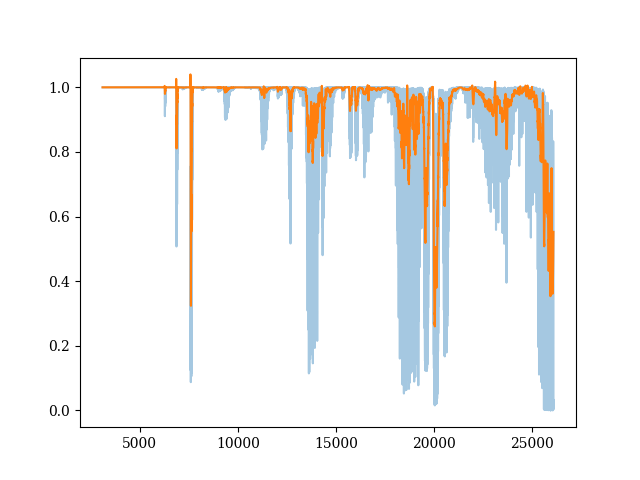

In [520]:
fig, ax = plt.subplots()

ax.plot(tell_wave_air, telluriclines[:,1], alpha=0.4)
ax.plot(tell_wave_air, tellsmooth)

<IPython.core.display.Javascript object>


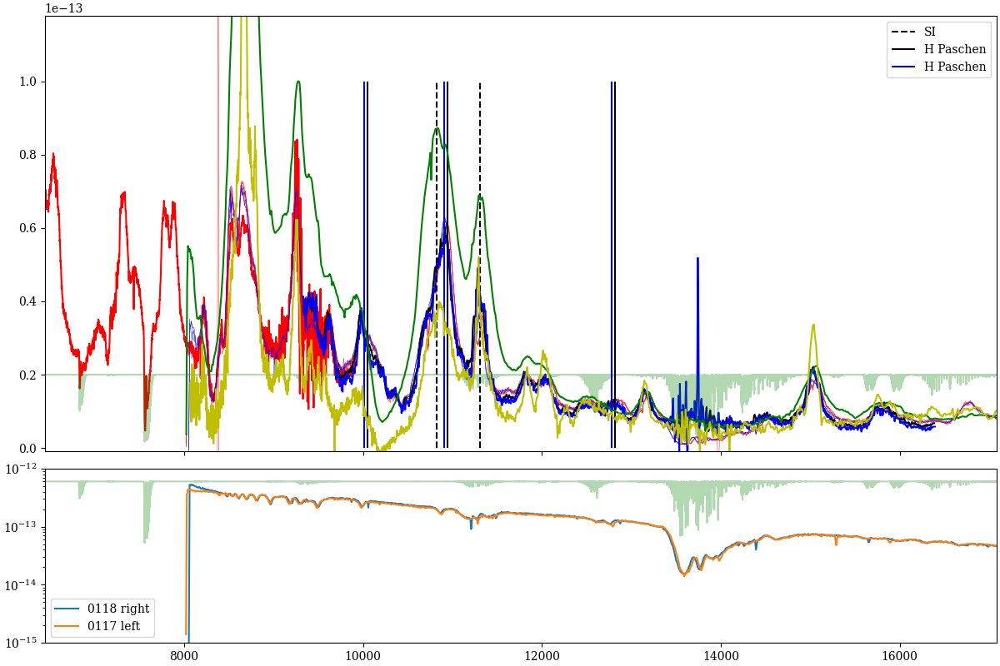

(-1e-15, 1.3e-13)

In [521]:
fig, (ax, ax2) = plt.subplots(2,1, figsize=(12,8),  constrained_layout=True, sharex=True, gridspec_kw={'height_ratios': [5,2]})
#ax.set_position([0.05,0.1,0.92,0.8])

#ax.plot(optspec['wavelength']/(1+0.0055), optspec['flux']*2.2e-16, 'r')
optspec = specs_22jli['dbsp0820']['spec_photcal']
ax.plot(optspec[:,0]/(1+0.0055), optspec[:,1]*23, 'r')

specdataref = np.loadtxt(os.path.join(specdir, specfiles[0]))

for specfile in specfiles:
    if specfile[5:9] in ['0108', '0111', '0112','0115']:
        color='r'
    else:
        color='b'
    specdata = np.loadtxt(os.path.join(specdir, specfile))
    
    scalefactor = np.median(specdataref[:,1]/specdata[:,1])
    ax.plot(specdata[:,0]/(1+0.0055), specdata[:,1]*scalefactor, color=color, lw=0.3)
    
show_22jli_sofi = 1
if show_22jli_sofi:
    ax.plot(sofi0930[:,0]/(1+0.0055), sofi0930[:,1]*1e2, 'k')
    ax.plot(sofi1013[:,0]/(1+0.0055), sofi1013[:,1]*1e2, 'b')

show_tellu_spec = 1
if show_tellu_spec:
    ax.plot(tell_wave_air/(1+0.0055), telluriclines[:,1]*2e-14, 'g', alpha=0.3)
    
    
ax2.plot(hip77[:,0]/(1+0.0055), hip77[:,1], label='0118 right')
ax2.plot(hip77_02[:,0]/(1+0.0055), hip77_02[:,1], label='0117 left')
ax2.plot(tell_wave_air/(1+0.0055), telluriclines[:,1]*6e-13, 'g', alpha=0.3)
ax2.set_yscale('log')
ax2.set_ylim([1e-15, 1e-12])
ax2.legend(loc=0)

#ax.vlines(np.array([1.0938, 1.2818, 1.8750, 2.1655])*1e4, ymin=0, ymax=1e-13, colors='r', linestyles='dashed', label='H')

'''
## below from Shahbandeh et a. 2022
ax.vlines(np.array([1.0938, 1.2818, 1.8750, 2.1655])*1e4, ymin=0, ymax=1e-13, colors='r', linestyles='dashed', label='H')
ax.vlines(np.array([1.083, 1.7002, 2.0581])*1e4, ymin=0, ymax=1e-13, colors='b', linestyles='dashed', label='HeI')
ax.vlines(np.array([0.9093, 0.9406, 0.9658, 1.0693, 1.2614, 2.1259])*1e4, ymin=0, ymax=1e-13, colors='c', linestyles='dashed', label='CI')
ax.vlines(np.array([0.9246,1.1290])*1e4, ymin=0, ymax=1e-13, colors='m', linestyles='dashed', label='OI')
ax.vlines(np.array([1.1828, 1.4878, 1.5033])*1e4, ymin=0, ymax=1e-13, colors='y', linestyles='dashed', label='MgI')
ax.vlines(np.array([0.9227, 1.0092, 1.0927, 2.1369])*1e4, ymin=0, ymax=1e-13, colors='y', linestyles='solid', label='MgII')
ax.vlines(np.array([0.9223, 1.0457])*1e4, ymin=0, ymax=1e-13, colors='k', linestyles='dashed', label='SI')
ax.vlines(np.array([0.8538, 0.8662, 0.8921, 1.1839, 1.1950])*1e4, ymin=0, ymax=1e-13, colors='g', linestyles='dashed', label='CaII')


##below from Flors 2018 
ax.vlines(np.array([0.5528, 0.7155,0.7172,0.7388,0.7453,0.7687,0.8617,1.2570,1.2943,1.3206,1.5335,1.5995,1.6440])*1e4, ymin=0, ymax=1e-13, colors='k', linestyles='solid', label='FeII')
ax.vlines(np.array([0.9345, 1.0190,1.0248, 1.5474])*1e4, ymin=0, ymax=1e-13, colors='m', linestyles='solid', label='CoII')

'''
##below from https://ui.adsabs.harvard.edu/abs/2017ApJ...846...50M/abstract Figure 4
ax.vlines(np.array([1.082, 1.131])*1e4, ymin=0, ymax=1e-13, colors='k', linestyles='dashed', label='SI')

ax.vlines(np.array([1.005, 1.094, 1.282, 1.875])*1e4, ymin=0, ymax=1e-13, colors='k', linestyles='solid', label='H Paschen')
ax.vlines(np.array([1.005, 1.094, 1.282, 1.875])*1e4*(1-1000./300000), ymin=0, ymax=1e-13, colors='b', linestyles='solid', label='H Paschen')



ions= ['FeII', 'CI']
ions= ['MgII' ,'MgI']
ions= ['SI']
ions = []
#ions = np.unique(lines['Ion'].data)

for ion in ions:
    lines_ion = lines[lines['Ion']==ion]
    ax.vlines(lines_ion['lambda_rest'].data*1e4, ymin=0, ymax=1e-13, colors='m', linestyles='solid', label=ion)

#ax.set_yscale('log')


### add comparison sne
show_2020oi = 0
if show_2020oi:
    ax.plot(spec_2020oi['x']*1e4, 10**spec_2020oi['Curve1']*4e-14-3e-14, 'k') #the wavelength has already been shifted to z=0
    ax.plot(spec_2020oi_02['x']*1e4, 10**spec_2020oi_02['Curve1']*4e-14-3e-14, 'k') #the wavelength has already been shifted to z=0

show_2017eaw = 0
if show_2017eaw:
    ax.plot(spec_2017eaw['x']*1e4, spec_2017eaw['Curve1']*2e2, 'b') #the wavelength has already been shifted to z=0


show_2012au = 1
if show_2012au:
    specname = '83.6d'
    spec = specinfo_12au[specname]['spec']
    xs = spec[:,0]*1e4/(1+z_12au)
    ys = spec[:,1]*5
    ax.plot(xs, ys, 'g')


    specname = '318.6d'
    spec = specinfo_12au[specname]['spec']
    xs = spec[:,0]*1e4/(1+z_12au)
    ys = spec[:,1]*50
    ax.plot(xs, ys, 'y')
    
    
ax.legend(loc=0)

#ax.set_ylim([1e-15, 1.3e-13])

ax.set_ylim([-1e-15, 1.3e-13])
#ax.set_xlim([3000,26000])

#ax.set_yscale('log')
#ax.set_xscale('log')

<IPython.core.display.Javascript object>


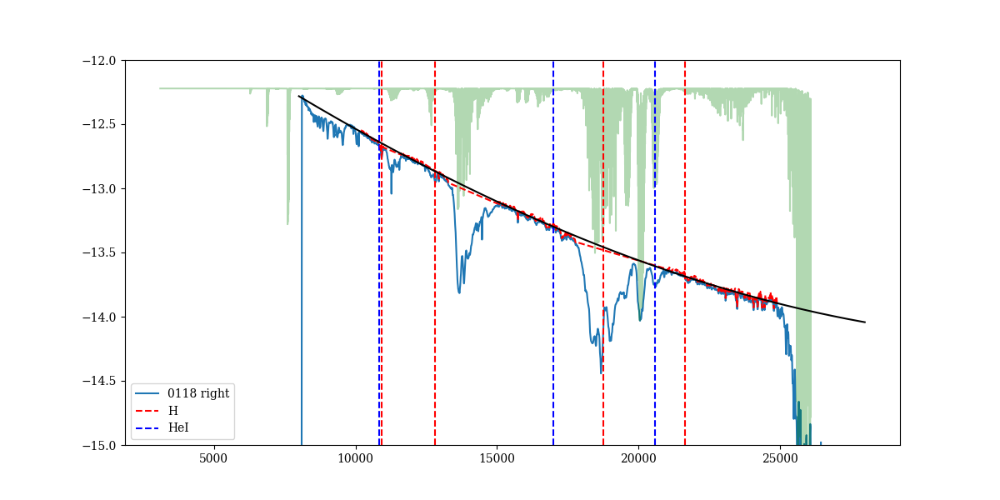

<ipython-input-125-a680dc7a1ec6>:7: RuntimeWarning: invalid value encountered in log10
  ys = np.log10(hip77[:,1])


<IPython.core.display.Javascript object>


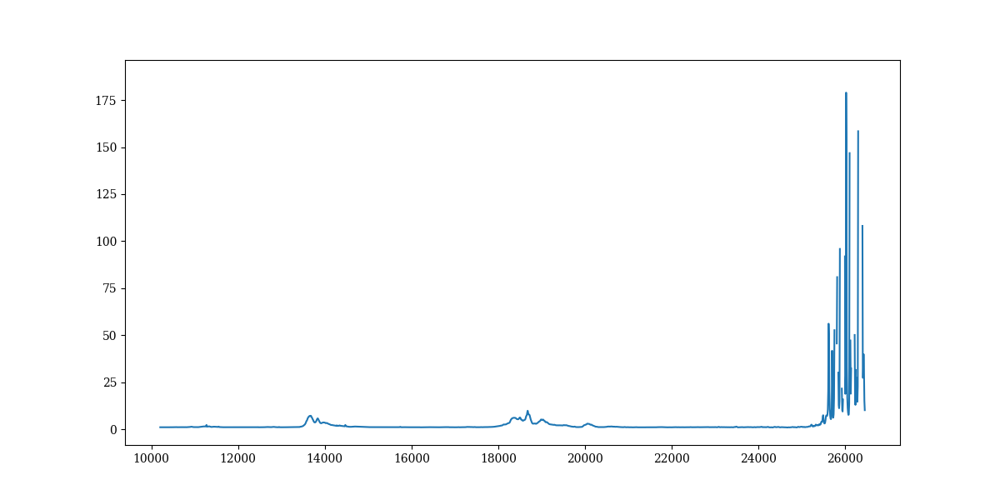

<IPython.core.display.Javascript object>


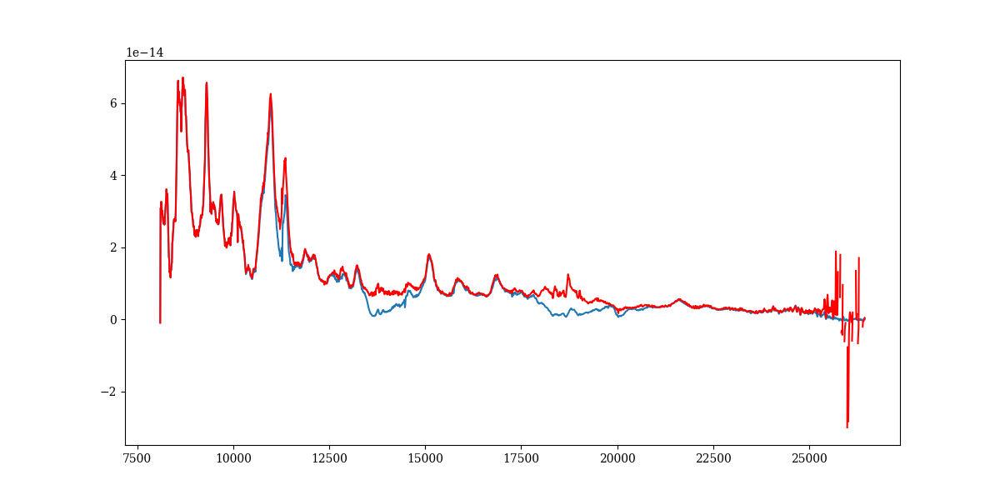

In [125]:
##try to do telluric correction of the FIRE NIR spectrum  

fig, ax = plt.subplots(figsize=(12,6))


xs  = hip77[:,0]
ys = np.log10(hip77[:,1])
ax.plot(xs, ys, label='0118 right')
#ax.plot(hip77_02[:,0], np.log10(hip77_02[:,1]), label='0117 left')
ax.plot(tell_wave_air, np.log10(telluriclines[:,1]*6e-13), 'g', alpha=0.3)

ax.vlines(np.array([1.0938, 1.2818, 1.8750, 2.1655])*1e4, ymin=-15, ymax=-12, colors='r', linestyles='dashed', label='H')
ax.vlines(np.array([1.083, 1.7002, 2.0581])*1e4, ymin=-15, ymax=-12, colors='b', linestyles='dashed', label='HeI')

tellu_regions = [[8000, 10200], [11000, 11600], [12450, 12900], [13300, 15000], [17800,21050], [24900, 28000]]
realline_regions = [[]]
tellu_mask = np.ones_like(xs, dtype=bool)

for w1, w2 in tellu_regions:
    tellu_mask[(xs>w1)*(xs<w2)] =  False
    
ax.plot(xs[tellu_mask], ys[tellu_mask]+0.02, 'r--')
    
polyobj = polyfit(xs[tellu_mask], ys[tellu_mask]+0.02, np.ones_like(xs[tellu_mask])*0.01, 3)
xs_model = np.linspace(8000, 28000, 1000)
ys_model = poly3(polyobj.params, xs_model)

ax.plot(xs_model, ys_model, 'k')


tellu_corr_model = 10**(poly3(polyobj.params, xs[xs>10200]) - ys[xs>10200])



#ax.set_yscale('log')
#ax.set_ylim([1e-15, 1e-12])
ax.set_ylim([-15, -12])
ax.legend(loc=0)


fig, ax = plt.subplots(figsize=(12,6))

ax.plot(xs[xs>10200], tellu_corr_model)

#ax.plot(np.linspace(8000, 28000, 1000), tell)

xs_new = xs[xs>10200]

line_mask = (xs_new>10820)*(xs_new<11030)
model_interp = interp1d( xs_new[~line_mask], tellu_corr_model[~line_mask], fill_value=1, bounds_error=False)

fig, ax = plt.subplots(figsize=(12,6))
specdata = np.loadtxt(os.path.join(specdir, 'fire_0109_sub.f.txt'))
xs = specdata[:,0]
ys = specdata[:,1]
ax.plot(xs, ys)
ax.plot(xs, ys*model_interp(xs), 'r')


fire_spec_0825_tellcorr = np.array([xs, ys*model_interp(xs)]).transpose()

np.savetxt('./spectra/FIRE/SN2022jli_FIRE_20220825_tellcorr.txt', fire_spec_0825_tellcorr)

##### check/correct the wavelength 

In [134]:
skylines = np.loadtxt('./spectra/magellan_fire_20220825/skyspec_0109.txt')
arc1 = np.loadtxt('./spectra/magellan_fire_20220825/arc1_left.w.txt')
arc2 = np.loadtxt('./spectra/magellan_fire_20220825/arc2_right.w.txt')

In [118]:
def single_gaussian(p, x): 
        ''' 
        INPUTS:
                p: a sequence of parameters, amplitude, center, dispersion and zerolevel
                x: indepedent variable
        '''
    
        A, mu, sigma, zerolev = p 
        return (A*np.exp(-(x-mu)*(x-mu)/(2*sigma*sigma)) + zerolev)

In [136]:
ohlines = Table.read('/Users/chenping/SNeData/Ping_collections/linelist/spec_wavelength_calibration/ohlines_fixwidth.dat', format='ascii.fixed_width')
print(ohlines)

near1 = Table.read('/Users/chenping/Ping/spectra_reduction/Magellan_FIRE/NeAr_fire.lst', format='ascii')
near2 = Table.read('/Users/chenping/Ping/spectra_reduction/Magellan_FIRE/NeAr_fire2.lst', format='ascii')
print(near1)

   w     f  
------- ----
10831.2  0.4
10899.3  0.1
10927.3 0.24
10952.3  0.1
10976.3 0.35
11010.3  0.1
11030.3 0.28
11073.3 0.05
11090.3 0.15
11141.3 0.02
    ...  ...
21580.7 0.15
21711.1 0.25
21802.2  0.7
21873.5 0.35
21955.6  0.9
22125.5  0.8
22247.9 0.28
22312.7  0.5
22460.3  0.1
22518.0 0.25
22742.0 0.15
Length = 267 rows
   col1   col2 col3
--------- ---- ----
 8264.534  0.0   Ar
8300.3263  0.0   Ne
8377.6065  0.0   Ne
 8408.213  0.0   Ar
 8424.638  0.0   Ar
8495.3598  0.0   Ne
  8521.44  0.0   Ar
8591.2583  0.0   Ne
  8783.75  0.0   Ne
 8853.867  0.0   Ne
      ...  ...  ...
16519.618  0.0   Ar
16940.331  0.0   Ar
17444.639  0.0   Ar
17914.451  0.0   Ar
19822.914  0.0   Ar
19971.182  0.0   Ar
20621.856  0.0   Ar
20991.839  0.0   Ar
21540.086  0.0   Ar
22083.206  0.0   Ar
23139.519  0.0   Ar
Length = 44 rows


###### sky OH lines

[8.07131164e-168 5.10703907e-167 3.21709619e-166 ... 7.14795710e-017
 4.07391467e-017 2.31159487e-017]


<IPython.core.display.Javascript object>


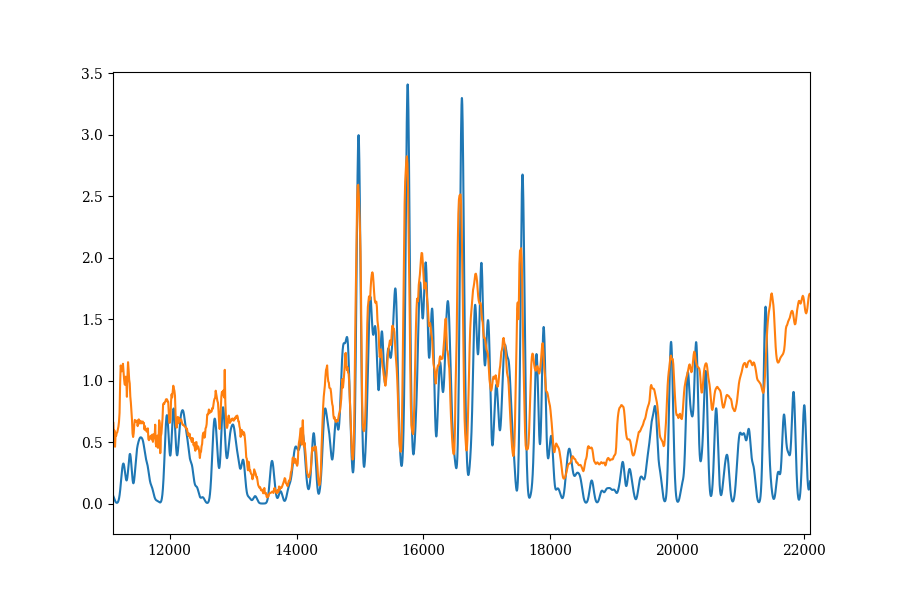

In [133]:

w1 =  10000
w2 = 23000
fwhm= 30
xs = np.arange(w1, w2, 2)
ys = np.zeros(len(xs))
for x, y in ohlines[['w', 'f']]:
    if not y:
        y  = 0.1
    p = [y, x, fwhm, 0]
    #print(p)
    y = single_gaussian(p, xs)
    ys = ys+y
print(ys)
fig, ax = plt.subplots(figsize=(9, 6))
ax.plot(xs/(1+0.0055), ys)

ax.plot(skylines[:,0]/(1+0.0055), skylines[:,1]*1e-4)

##### arc lines

[0. 0. 0. ... 0. 0. 0.]


<IPython.core.display.Javascript object>


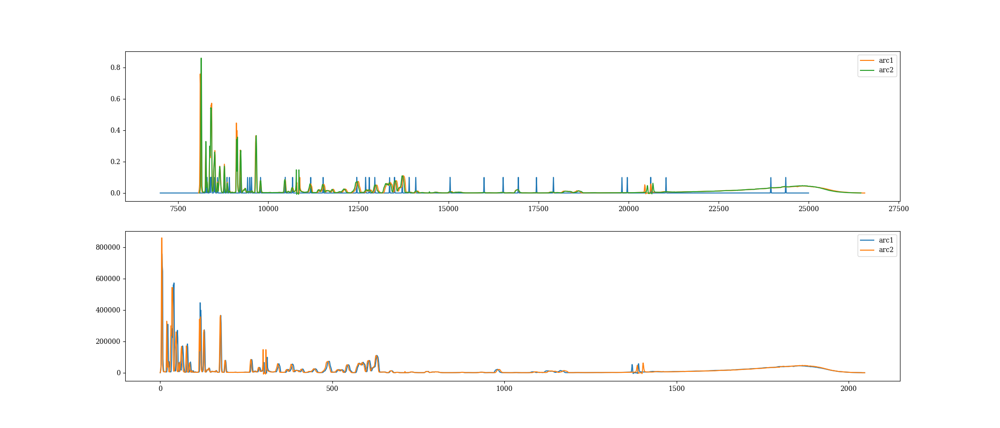

In [154]:

w1 =  7000
w2 = 25000
fwhm= 5
xs = np.arange(w1, w2, 2)
ys = np.zeros(len(xs))
for x, y in near2[['col1', 'col2']]:
    y = 0.1
    p = [y, x, fwhm, 0]
    #print(p)
    y = single_gaussian(p, xs)
    ys = ys+y
print(ys)

fig, (ax, ax2) = plt.subplots(2,1,figsize=(21, 9))
ax.plot(xs, ys)

ax.plot(arc1[:,0], arc1[:,1]*1e-6, label='arc1')
ax.plot(arc2[:,0], arc2[:,1]*1e-6, label='arc2')

ax.legend(loc=0)

ax2.plot(arc1[:,1], label='arc1')
ax2.plot(arc2[:,1], label='arc2')
ax2.legend(loc=0)
#ax2.set_yscale('log')



##TEST TO remove sky continuum


In [92]:
wend = 25000/(1+0.0055)
print('FIRE spectrum wavelength covers to 25000 angstrom which converts to rest wavelength of %s for 2022jli'%wend)

FIRE spectrum wavelength covers to 25000 angstrom which converts to rest wavelength of 24863.252113376428 for 2022jli


In [42]:
print(lines[(lines['lambda_rest']>1.56)*(lines['lambda_rest']<1.62)])

Ion  lambda_rest No.ofLinesinBlend ... LineStrength5000K LineStrength10000K
---- ----------- ----------------- ... ----------------- ------------------
 SiI      1.5888                 1 ...             0.251              0.292
CoII      1.6064                 1 ...             0.276              0.223
CoII      1.5759                 1 ...             0.230              0.169


<IPython.core.display.Javascript object>


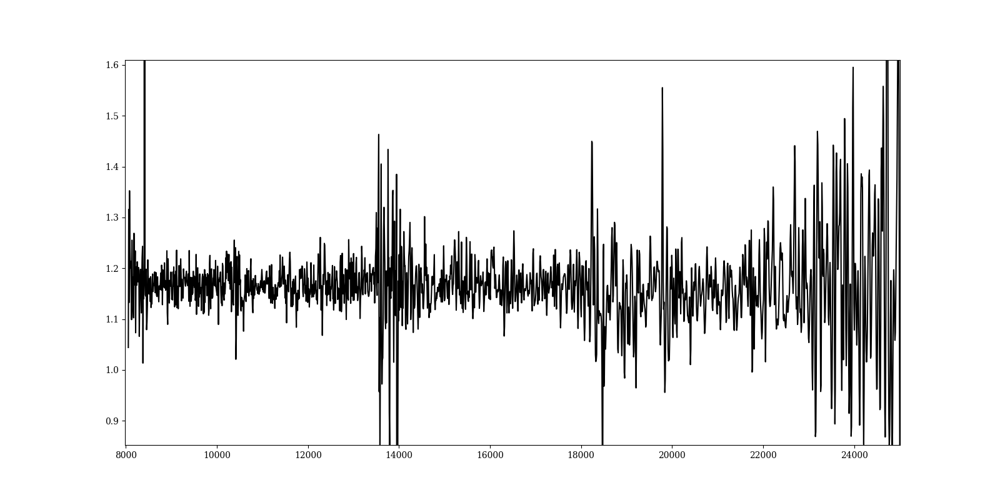

In [74]:
fig, ax = plt.subplots(figsize=(16,8))


specdata1 = np.loadtxt(os.path.join(specdir, specfiles[0]))
specdata2 = np.loadtxt(os.path.join(specdir, specfiles[1]))
ax.plot(specdata[:,0]/(1+0.0055), specdata1[:,1]/specdata2[:,1], 'k')

In [18]:
(21470-21655)/21655*300000

-2562.9184945740017

### FIRE 2022-12-14


jd_iso_convert.py 2022-12-15T01:25:58 iso2jd
2022-12-15T01:25:58 ---> 2459928.559699074

In [128]:
print(2459928.559699074-t0_22jli)

223.88969907397404


<IPython.core.display.Javascript object>


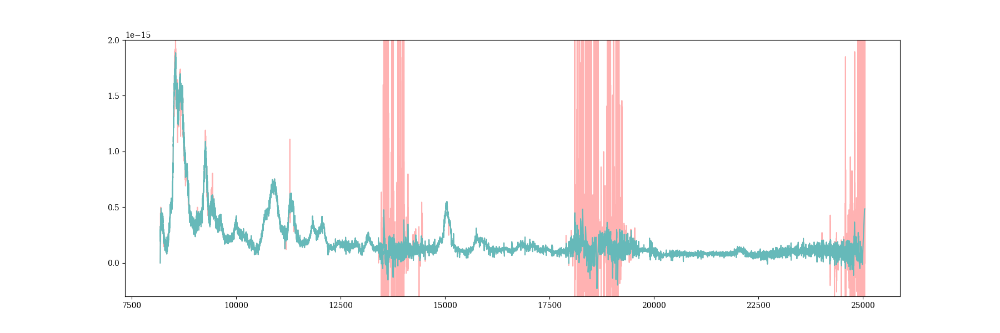

(-3e-16, 2e-15)

In [508]:
#try to remove the spikes

fire1214 = np.loadtxt('./spectra/magellan_fire_20221214/SN2022jli_FIRE_20221214.txt')

fig, ax = plt.subplots(figsize=(18,6))

xs = fire1214[:,0]/(1+z_22jli)
ys = fire1214[:,1]*1e-18*1.6
ax.plot(xs, ys, color='r', alpha=0.3)

specdf = spike_remove_main(xs, ys,  DELTA = 1e-16, HIGH_CLIP = 2e-15, LOW_CLIP = -2e-15, SPAN = 25, display=0)
ys_sf = specdf.y_interpolated.values #spike free

ax.plot(xs, ys_sf, color='c', alpha=0.6)

ax.set_ylim([-3e-16, 2e-15])

### line identification

show the characteristic features detected in SN 2022jli spectra

<IPython.core.display.Javascript object>


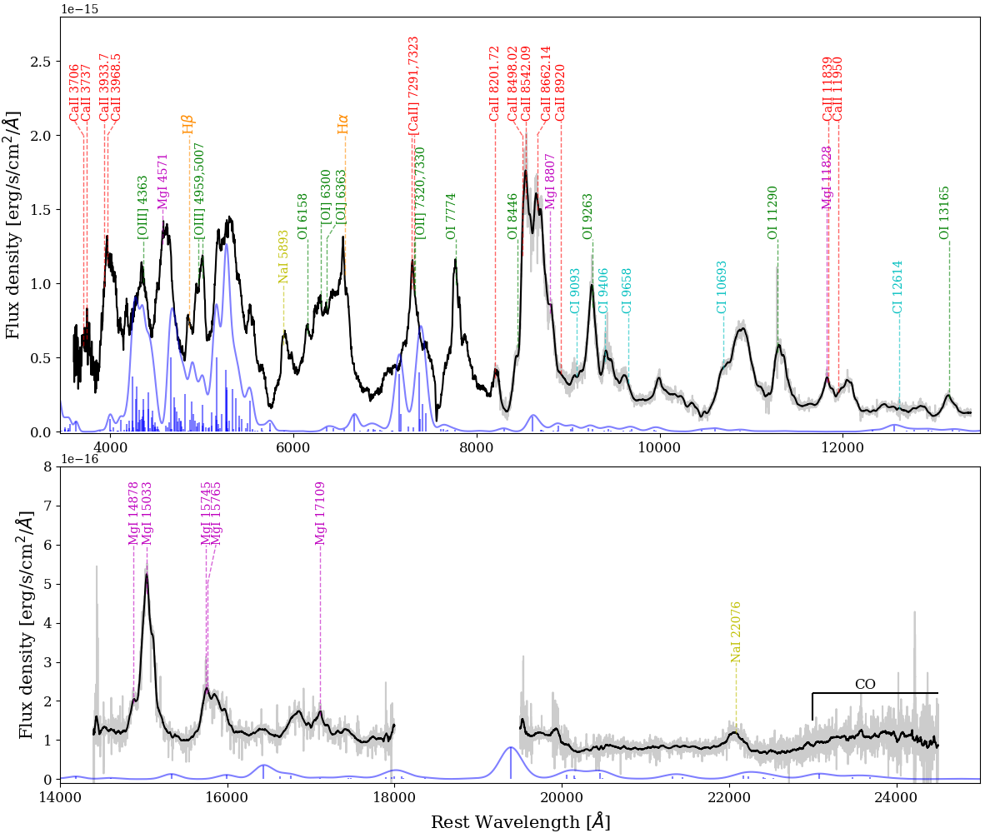

(27328,)
(27328,)
15:23:28 Assigning font /b'F1' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif.ttf'
15:23:28 Assigning font /b'F2' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf'
15:23:28 Assigning font /b'F3' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf'
15:23:28 Embedding font /opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf.
15:23:28 Writing TrueType font.
15:23:28 SUBSET /opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf characters: αβÅ
15:23:28 Took 0.000s to load font
15:23:28 Reading 'maxp' table from disk
15:23:28 Decompiling 'maxp' table
15:23:28 Took 0.001s to load 'maxp'
15:23:28 Took 0.000s to prune 'maxp'
15:23:28 maxp pruned
15:23:28 Reading 'cmap' table from disk
15:23:28 Decompiling 'cmap' table
15:23:28 Reading 'post' table from disk
15:23:2

15:23:28 Glyph IDs:   [0, 1, 2, 3, 21]
15:23:28 Closed glyph list over 'GSUB': 5 glyphs after
15:23:28 Glyph names: ['.notdef', '.null', 'nonmarkingreturn', 'space', 'two']
15:23:28 Glyph IDs:   [0, 1, 2, 3, 21]
15:23:28 Took 0.006s to close glyph list over 'GSUB'
15:23:28 Closing glyph list over 'MATH': 5 glyphs before
15:23:28 Glyph names: ['.notdef', '.null', 'nonmarkingreturn', 'space', 'two']
15:23:28 Glyph IDs:   [0, 1, 2, 3, 21]
15:23:28 Reading 'MATH' table from disk
15:23:28 Decompiling 'MATH' table
15:23:28 Closed glyph list over 'MATH': 5 glyphs after
15:23:28 Glyph names: ['.notdef', '.null', 'nonmarkingreturn', 'space', 'two']
15:23:28 Glyph IDs:   [0, 1, 2, 3, 21]
15:23:28 Took 0.005s to close glyph list over 'MATH'
15:23:28 Closing glyph list over 'glyf': 5 glyphs before
15:23:28 Glyph names: ['.notdef', '.null', 'nonmarkingreturn', 'space', 'two']
15:23:28 Glyph IDs:   [0, 1, 2, 3, 21]
15:23:28 Closed glyph list over 'glyf': 5 glyphs after
15:23:28 Glyph names: ['.notde

15:23:28 Glyph IDs:   [0, 1, 2, 3, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 38, 41, 43, 44, 48, 49, 50, 53, 58, 62, 64, 68, 70, 71, 72, 74, 75, 76, 79, 80, 81, 85, 86, 87, 88, 89, 91, 92, 2255, 2363, 2364, 2365, 2366, 2367, 2368]
15:23:28 Took 0.004s to close glyph list over 'MATH'
15:23:28 Closing glyph list over 'glyf': 52 glyphs before
15:23:28 Glyph names: ['.notdef', '.null', 'C', 'F', 'H', 'I', 'M', 'N', 'O', 'R', 'W', 'a', 'bracketleft', 'bracketright', 'c', 'comma', 'd', 'e', 'eight', 'five', 'four', 'g', 'h', 'i', 'l', 'm', 'minus', 'n', 'nine', 'nonmarkingreturn', 'one', 'period', 'r', 's', 'seven', 'six', 'slash', 'space', 't', 'three', 'two', 'u', 'uni23A1', 'uni23A2', 'uni23A3', 'uni23A4', 'uni23A5', 'uni23A6', 'v', 'x', 'y', 'zero']
15:23:28 Glyph IDs:   [0, 1, 2, 3, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 38, 41, 43, 44, 48, 49, 50, 53, 58, 62, 64, 68, 70, 71, 72, 74, 75, 76, 79, 80, 81, 85, 86, 87, 88, 89, 91, 92, 2255, 2363, 2364, 2365, 2366, 236

In [426]:
fire1214 = np.loadtxt('./spectra/magellan_fire_20221214/SN2022jli_FIRE_20221214.txt')

#2022jli
#nir

#flux density 
D1 = 22.5*1e6*units.pc
D2 = 12.2*1e6*units.pc
#factor = (4*np.pi*D1**2).cgs.value #
#factor = (4*np.pi*D2**2).cgs.value #
factor = 1


fig, (ax, ax2) = plt.subplots(2,1,figsize=(12,10))
ax.set_position([0.06, 0.48, 0.92, 0.5])
ax2.set_position([0.06, 0.06, 0.92, 0.38])

#optical
specname = 'not1125'  #
spec = specs_22jli[specname]['spec_photcal']
phase = specs_22jli[specname]['phase']
xs_opt = spec[:,0]/(1+z_22jli)
ys_opt = spec[:,1]*factor
mask = (xs_opt<8250)*(xs_opt>3600)
ax.plot(xs_opt[mask], ys_opt[mask], 'k',)

#nir
xs = fire1214[:,0]/(1+z_22jli)
ys = fire1214[:,1]*1e-18*1.6*factor
y_smooth = savgol_filter(ys, 101, 3)
# mask = xs>8200
# ax.plot(xs[mask], ys[mask], color='k', alpha=0.2)
# ax.plot(xs[mask], y_smooth[mask], color='k')


mask1 = (xs>8200)*(xs<13400)
ax.plot(xs[mask1], ys[mask1], color='k', alpha=0.2)
ax.plot(xs[mask1], y_smooth[mask1], color='k')
mask2 = (xs>14400)*(xs<18000)
ax2.plot(xs[mask2], ys[mask2], color='k', alpha=0.2)
ax2.plot(xs[mask2], y_smooth[mask2], color='k')
mask3 = (xs>19500)*(xs<24500)
ax2.plot(xs[mask3], ys[mask3], color='k', alpha=0.2)
ax2.plot(xs[mask3], y_smooth[mask3], color='k')


xs = np.append(xs_opt, xs)
ys = np.append(ys_opt, y_smooth)

print(xs.shape)
print(ys.shape)

##2012au
show_2012au = 0
if show_2012au:
    specname = '318.6d'
    spec = specinfo_12au[specname]['spec']
    xs = spec[:,0]*1e4/(1+z_12au)
    ys = spec[:,1]
    ax.plot(xs, ys*0.5, 'k', label='SN2012au 318.6d')


show_22jli_sofi = 0
if show_22jli_sofi:
    ax.plot(sofi0930[:,0]/(1+0.0055), sofi0930[:,1]*1.5, 'k')
    ax.plot(sofi1013[:,0]/(1+0.0055), sofi1013[:,1]*1.5, 'b')


    
    
## below from Shahbandeh et a. 2022 "Carnegie Supernova Project-II: Near-infrared Spectroscopy of Stripped-envelope Core-collapse Supernovae"
#ax.vlines(np.array([1.0938, 1.2818, 1.8750, 2.1655])*1e4, ymin=0, ymax=1e-13, colors='r', linestyles='dashed', label='H')
#ax.vlines(np.array([1.083, 1.7002, 2.0581])*1e4, ymin=0, ymax=1e-13, colors='b', linestyles='dashed', label='HeI')
#ax.vlines(np.array([0.9093, 0.9406, 0.9658, 1.0693, 1.2614, 2.1259])*1e4, ymin=0, ymax=1e-13, colors='c', linestyles='dashed', label='CI')
#ax.vlines(np.array([0.9246,1.1290])*1e4, ymin=0, ymax=1e-13, colors='m', linestyles='dashed', label='OI')
#ax.vlines(np.array([1.1828, 1.4878, 1.5033])*1e4, ymin=0, ymax=1e-13, colors='y', linestyles='dashed', label='MgI')
#ax.vlines(np.array([0.9227, 1.0092, 1.0927, 2.1369])*1e4, ymin=0, ymax=1e-13, colors='y', linestyles='solid', label='MgII')
#ax.vlines(np.array([0.9223, 1.0457])*1e4, ymin=0, ymax=1e-13, colors='k', linestyles='dashed', label='SI')
#ax.vlines(np.array([0.8538, 0.8662, 0.8921, 1.1839, 1.1950])*1e4, ymin=0, ymax=1e-13, colors='g', linestyles='dashed', label='CaII')    ###no idea how these values are obtained... NIST gives 8201.72, 8248.80, 8254.73, 8498.02, 8542.09, 8662.14, 8912.07, 8927.36
    
lineymin = 1e-17*factor
lineymax = 2e-15*factor
    
show_HeI_lines = 0
if show_HeI_lines:
    ax.vlines([5015.7, 5875.6, 6678, 7065, 10830, 17002, 18685, 20587], ymin=lineymin, ymax=lineymax, linestyles='dashed', colors='r')
    
show_H_lines = 0
if show_H_lines:
    vshift = 0
    ax.vlines(np.array([4340, 4861, 6563, 10940, 12820, 18750])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', colors='y')   
    
show_CI_lines = 1
if show_CI_lines:
    vshift = 0
    #ax.vlines(np.array([9093, 9406, 9658, 10693, 12614, 21259])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', lw=1, colors='c')   
    ion = 'CI'
    lineymax_CI = 8e-16
    for lamb in [9093, 9406, 9658, 10693, 12614]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_CI, linestyles='dashed', lw=1, alpha=0.6, colors='c')        
        ax.text( lamb, lineymax_CI, ion+' '+str(lamb), color='c', rotation=90, va='bottom', ha='center')        
        
    
show_NaI_lines = 1
if show_NaI_lines:
    vshift = 0
    ion = 'NaI'

    #ax.vlines(np.array([5890, 5896, 22062.42, 22089.69])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', lw=1, colors='y') 
    #ax.vlines(np.array([5893, 22076])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax_NaI, linestyles='dashed', lw=1, colors='y')
    for lamb in [5893, ]:
        lineymax_NaI = 1e-15
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_NaI, linestyles='dashed', lw=1, alpha=0.6, colors='y')        
        ax.text( lamb-50, lineymax_NaI, ion+' '+str(lamb), color='y', rotation=90, va='bottom', ha='left')    
    for lamb in [22076]:
        lineymax_NaI = 3e-16
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax2.vlines(lamb, ymin=linemin, ymax=lineymax_NaI, linestyles='dashed', lw=1, alpha=0.6, colors='y')        
        ax2.text( lamb-50, lineymax_NaI, ion+' '+str(lamb), color='y', rotation=90, va='bottom', ha='left')    


show_MgI = 1
if show_MgI:
    vshift = 0
    ion = 'MgI'
    #ax.vlines(np.array([4571, 8807, 11828, 14878, 15033, 15740.7, 15749, 15765.839, 17108.631])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax_MgI, linestyles='dashed', lw=1, colors='m')       #8807 from Fig 25 of https://www.aanda.org/articles/aa/pdf/2019/01/aa34535-18.pdf

    for lamb in [4571, 8807, 11828]:
        lineymax_MgI = 1.5e-15
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_MgI, linestyles='dashed', lw=1, alpha=0.6, colors='m')
        ax.text(lamb-50, lineymax_MgI, ion+' '+str(lamb), color='m', rotation=90, va='bottom', ha='left')
    
    for lamb in [14878, 15033, 15745, 17109]:
        lineymax_MgI = 6e-16
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax2.vlines(lamb, ymin=linemin, ymax=lineymax_MgI, linestyles='dashed', lw=1, alpha=0.6, colors='m')
        ax2.text(lamb-50, lineymax_MgI, ion+' '+str(lamb), color='m', rotation=90, va='bottom', ha='left')    
    
    for lamb in [15765]:
        lineymax_MgI = 5e-16
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax2.vlines(lamb, ymin=linemin, ymax=lineymax_MgI, linestyles='dashed', lw=1, alpha=0.6, colors='m')
        ax2.plot([lamb, lamb+100], [lineymax_MgI, lineymax_MgI+1e-16], '--', lw=1, alpha=0.6, color='m')
        ax2.text(lamb-50+100, lineymax_MgI+1e-16, ion+' '+str(lamb), color='m', rotation=90, va='bottom', ha='left')       
    
    
show_MgII = 0 #no prominent MgII lines
if show_MgII:
    vshift = 0
    ax.vlines(np.array([9227, 10092, 10927, 21369])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='solid', lw=2, alpha=0.4, colors='b')       
    
show_OI = 1
if show_OI:
    vshift = 0
    ion= 'OI'
    lineymax_OI = 1.3e-15
    #ax.vlines(np.array([6158, 7774, 8446, 9263, 11290, 13165])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax_OI, linestyles='dashed', lw=1, alpha=0.6, colors='g')    
    
    for lamb in [6158, 7774, 8446, 9263, 11290, 13165]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_OI, linestyles='dashed', lw=1, alpha=0.6, colors='g')
        ax.text( lamb-100, lineymax_OI, ion+' '+str(lamb), color='g', rotation=90, va='bottom', ha='left')

    
show_CaII = 1
if show_CaII:
    vshift = 0
    #ax.vlines(np.array([3706, 3737, 3933.7, 3968.5, 8201.72, 8248.80, 8254.73, 8498.02, 8542.09, 8662.14, 8912.07, 8927.36, 11839, 11950])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', lw=1, alpha=0.6, colors='r')       
    ion = 'CaII'
    lineymax_CaII = 2e-15
    for lamb in [3737, 3933.7,  8201.72,  8542.09,  8920, 11839, 11950]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_CaII+1e-16, linestyles='dashed', lw=1, alpha=0.6, colors='r')
        ax.text( lamb-50, lineymax_CaII+1e-16, ion+' '+str(lamb), color='r', rotation=90, va='bottom', ha='left')
        
    for lamb in [3706,  8498.02]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_CaII, linestyles='dashed', lw=1, alpha=0.6, colors='r')
        ax.plot([lamb, lamb-100], [lineymax_CaII, lineymax_CaII+1e-16], '--', lw=1, alpha=0.6, color='r')
        ax.text( lamb-50-100, lineymax_CaII+1e-16, ion+' '+str(lamb), color='r', rotation=90, va='bottom', ha='left')    
        
    for lamb in [3968.5, 8662.14]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_CaII, linestyles='dashed', lw=1, alpha=0.6, colors='r')
        ax.plot([lamb, lamb+100], [lineymax_CaII, lineymax_CaII+1e-16], '--', lw=1, alpha=0.6, color='r')
        ax.text( lamb-50+100, lineymax_CaII+1e-16, ion+' '+str(lamb), color='r', rotation=90, va='bottom', ha='left')            
        
    
show_CaIIfbd = 1
if show_CaIIfbd:
    vshift = 0
    #ax.vlines(np.array([7291, 7323])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='solid', lw=2, alpha=0.6, colors='y')           
    for lamb in [7291, 7323]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_CaII, linestyles='dashed', lw=1, alpha=0.6, colors='r')    
    
    ax.text(7306-50, lineymax_CaII, '[CaII] 7291,7323', color='r', rotation=90, va='bottom', ha='left')    
    
    
show_SIIfbd = 0 # no prominent [SII] lines
if show_SIIfbd:
    vshift = 0    
    ax.vlines(np.array([4068.60, 4076.35, 6716.44, 6730.82, 10286.7, 10320.5,10336.4,10370.5])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='solid', lw=2, alpha=0.6, colors='y')      
    
    
show_OIfbd = 1
if show_OIfbd:
    vshift = 0
    #ax.vlines(np.array([6300, 6363])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', lw=1, alpha=0.6, colors='g')        
    ion= '[OI]'
    lineymax_OI = 1.3e-15    
    for lamb in [6300]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_OI, linestyles='dashed', lw=1, alpha=0.6, colors='g')
        ax.plot([lamb, lamb], [lineymax_OI, lineymax_OI+1e-16], '--', lw=1, alpha=0.6, color='g')
        ax.text( lamb, lineymax_OI+1e-16, ion+' '+str(lamb), color='g', rotation=90, va='bottom', ha='left')

    for lamb in [6363]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_OI, linestyles='dashed', lw=1, alpha=0.6, colors='g')
        ax.plot([lamb, lamb+100], [lineymax_OI, lineymax_OI+1e-16], '--', lw=1, alpha=0.6, color='g')
        ax.text( lamb+100, lineymax_OI+1e-16, ion+' '+str(lamb), color='g', rotation=90, va='bottom', ha='left')        
    
show_OIIfbd = 1
if show_OIIfbd:
    vshift = 0
    #ax.vlines(np.array([7320, 7330])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', lw=1, alpha=0.6, colors='r')
    for lamb in [7320, 7330]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_OI, linestyles='dashed', lw=1, alpha=0.6, colors='g')    
    
    ax.text(7325, lineymax_OI, '[OII] 7320,7330', color='g', rotation=90, va='bottom', ha='left')
    
show_OIIIfbd = 1
if show_OIIIfbd:
    vshift = 0
    lineymax_OIII = 1.3e-15  
    for lamb in [4959, 5007]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_OIII, linestyles='dashed', lw=1, alpha=0.6, colors='g')    
    for lamb in [4363]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_OIII, linestyles='dashed', lw=1, alpha=0.6, colors='g')        
    ax.text((4959+5007)/2.0, lineymax_OIII, '[OIII] 4959,5007', color='g', rotation=90, va='bottom', ha='center')    
    ax.text(4363, lineymax_OIII, '[OIII] 4363', color='g', rotation=90, va='bottom', ha='center')    
    
    
    
##below from Flors 2018 
#ax.vlines(np.array([0.5528, 0.7155,0.7172,0.7388,0.7453,0.7687,0.8617,1.2570,1.2943,1.3206,1.5335,1.5995,1.6440])*1e4, ymin=0, ymax=1e-13, colors='k', linestyles='solid', label='FeII')
#ax.vlines(np.array([0.9345, 1.0190,1.0248, 1.5474])*1e4, ymin=0, ymax=1e-13, colors='m', linestyles='solid', label='CoII')    
    
show_FeII = 1
if show_FeII:
    vshift = 0
    #ax.vlines(np.array([0.5528, 0.7155,0.7172,0.7388,0.7453,0.7687,0.8617,1.2570,1.2943,1.3206,1.5335,1.5995,1.6440])*1e4*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', lw=1, alpha=0.6, colors='b')         
    
    FeII_specfile = '/Users/chenping/Ping/simfit/SimFITLib/modules/NebularIaSpec/temp_mockspec_data.txt'
    FeII_linefile = '/Users/chenping/Ping/simfit/SimFITLib/modules/NebularIaSpec/temp_mockline_data.txt'
    
    FeII_spec = np.loadtxt(FeII_specfile)
    ax.plot(FeII_spec[:,0], FeII_spec[:,1]*5e-16, 'b', alpha=0.5)
    ax2.plot(FeII_spec[:,0], FeII_spec[:,1]*5e-16, 'b', alpha=0.5)
    
    FeII_lines= Table.read(FeII_linefile, format='ascii')
    ax.vlines(FeII_lines['wavelength'], ymin=0, ymax=FeII_lines['relf']*5e-16, colors='b', alpha=0.5)
    ax2.vlines(FeII_lines['wavelength'], ymin=0, ymax=FeII_lines['relf']*5e-16, colors='b', alpha=0.5)
    
    
show_Halpha_Hbeta = 1
if show_Halpha_Hbeta:
    vshift = 0
    for lamb in [6563, 4861]:
        linemin = np.mean( ys[ (xs>(lamb-40))*(xs<(lamb+40)) ] )
        lineymax_Halpha = 2e-15
        ax.vlines(lamb, ymin=linemin, ymax=lineymax_Halpha, linestyles='dashed', lw=1, alpha=0.6, colors='darkorange')    
    
    ax.text(6563, lineymax_Halpha, r'H$\alpha$', color='darkorange', rotation=90, va='bottom', ha='center', fontsize=12)    
    ax.text(4861, lineymax_Halpha, r'H$\beta$', color='darkorange', rotation=90, va='bottom', ha='center', fontsize=12)
    
show_CO_band = 1
if show_CO_band:
    ax2.vlines(23000, ymin=1.5e-16, ymax=2.2e-16, colors='k')
    ax2.hlines(2.2e-16, xmin=23000, xmax=24500, colors='k')
    ax2.text(23500, 2.3e-16, 'CO',color='k', fontsize=12)
    
#ax.set_ylim([-5e-16,2.3e-15])
ax.set_ylim(np.array([-1e-17, 2.8e-15])*factor)
ax2.set_ylim(np.array([-1e-17, 8e-16])*factor)
ax.set_xlim([3450,13500])
ax2.set_xlim([14000,25000])

ax2.set_xlabel('Rest Wavelength [$\AA$]', fontsize=15)
ax.set_ylabel('Flux density [erg/s/cm$^2$/$\AA$]', fontsize=15)
ax2.set_ylabel('Flux density [erg/s/cm$^2$/$\AA$]', fontsize=15)
ax.tick_params(labelsize=12)
ax2.tick_params(labelsize=12)

#ax.set_xlim([7000,12000])
#plt.savefig('./plots/SN2022jli_opt_NIR_spec_zoom.png')

#plt.tight_layout()


#plt.savefig('./plots/SN2022jli_opt_NIR_spec_line_iden.png')
plt.savefig('./plots/SN2022jli_opt_NIR_spec_line_iden.pdf')

### Xshooter 0114

<IPython.core.display.Javascript object>


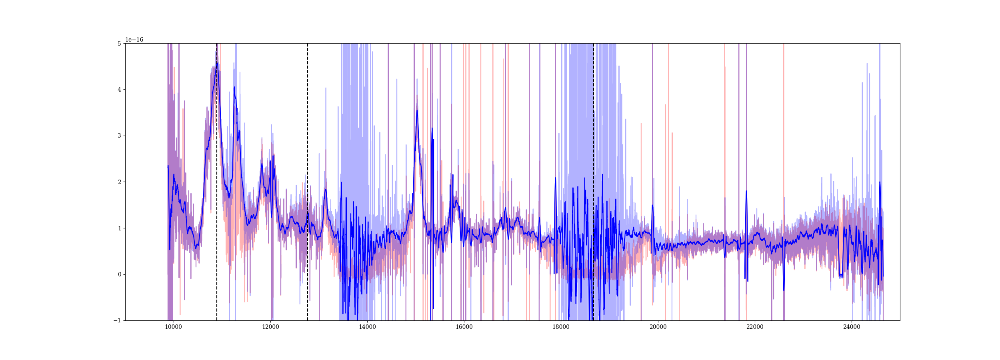

(-1e-16, 5e-16)

In [342]:

fig, ax = plt.subplots(figsize=(25,9))

# xs = fire1214[:,0]/(1+z_22jli)
# ys = fire1214[:,1]*1e-18
# ax.plot(xs, ys, color='r', alpha=0.3)
# y_smooth = savgol_filter(ys, 101, 3)
# ax.plot(xs, y_smooth, color='r')


xsh0113_nir = np.loadtxt('./spectra/xshooter/SN2022jli_xshooter_NIR_20230113.txt')
xs = xsh0113_nir[:,0]/(1+z_22jli)
ys = xsh0113_nir[:,1]*1.5
ax.plot(xs, ys, color='r', alpha=0.3)


xsh0113_nir_tell = np.loadtxt('/Users/chenping/Ping/spectra_reduction/XSHOOTER/reflex_data/reflex_end_products/sn2022jli_20230114_NIR/spec_tellcor.txt')

xs = xsh0113_nir_tell[:,0]/(1+z_22jli)
ys = xsh0113_nir_tell[:,1]*1.5
ax.plot(xs, ys, color='b', alpha=0.3)


y_smooth = savgol_filter(ys, 101, 3)
ax.plot(xs, y_smooth, color='b')

show_H_lines = 1
if show_H_lines:
    vshift = -1150
    lineymin = -1e-16
    lineymax = 5e-16
    ax.vlines(np.array([4340, 4861, 6563, 10940, 12820, 18750])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', colors='k')  

ax.set_xlim([9000,25000])
ax.set_ylim([-1e-16, 5e-16])

<IPython.core.display.Javascript object>


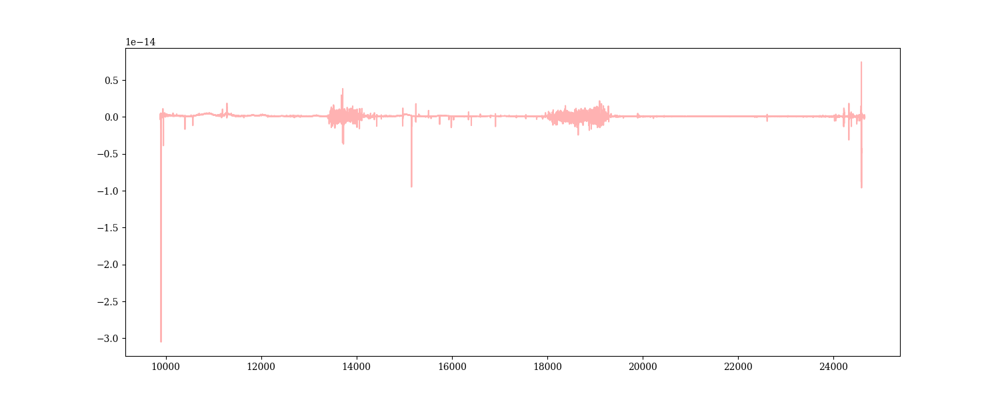

<IPython.core.display.Javascript object>


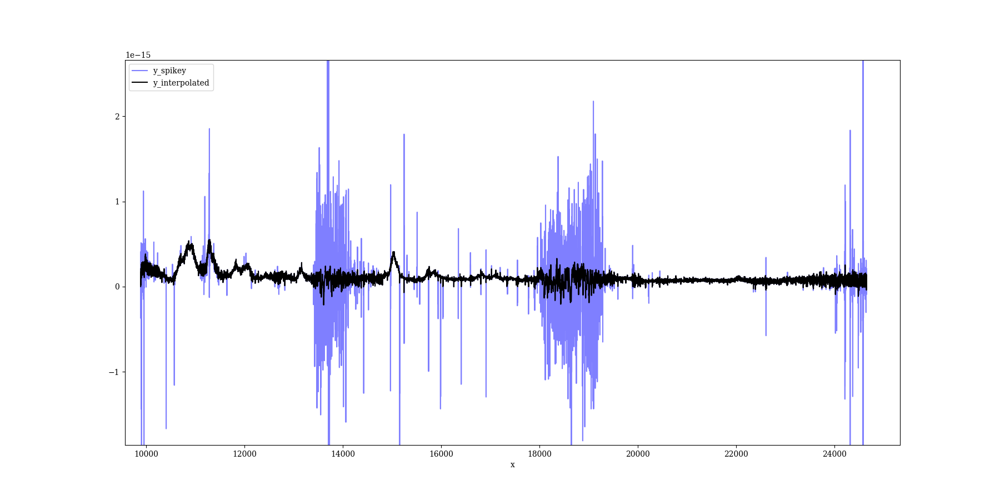

<IPython.core.display.Javascript object>


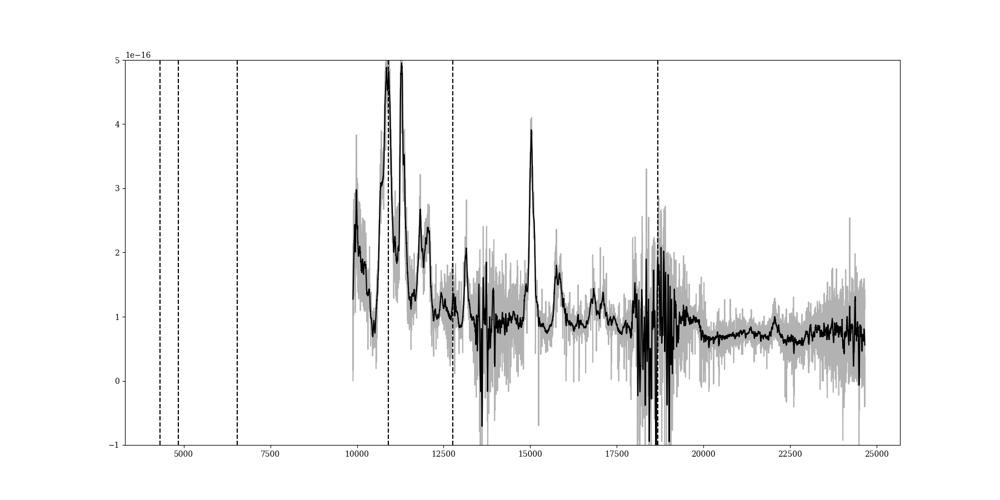

(-1e-16, 5e-16)

In [499]:
xsh0117_nir = np.loadtxt('./spectra/xshooter/SN2022jli_xshooter_NIR_20230117.txt')


xsh0117_nir = np.loadtxt('/Users/chenping/Ping/spectra_reduction/XSHOOTER/reflex_data/reflex_end_products/sn2022jli_20230118_NIR/SN2022jli_xshooter_NIR_20230117_tellcor.txt')


fig, ax = plt.subplots(figsize=(15,6))

# specdata=  specs_22jli['xsh0118']['spec_photcal']
# ax.plot(specdata[:,0]/(1+z_22jli), specdata[:,1], 'b')

xs = xsh0117_nir[:,0]/(1+z_22jli)
ys = xsh0117_nir[:,1]*1.35
ax.plot(xs, ys, color='r', alpha=0.3)


specdf = spike_remove_main(xs, ys,  DELTA = 8e-17, HIGH_CLIP = 1e-15, LOW_CLIP = -9e-16, SPAN = 25, display=True)
ys_sf = specdf.y_interpolated.values #spike free


fig, ax = plt.subplots(figsize=(18,9))

ax.plot(xs, ys_sf, 'k', alpha=0.3)


y_smooth = savgol_filter(ys_sf, 81, 2)
ax.plot(xs, y_smooth, color='k')





show_H_lines = 1
if show_H_lines:
    vshift = -1150
    lineymin = -1e-16
    lineymax = 5e-16
    ax.vlines(np.array([4340, 4861, 6563, 10940, 12820, 18750])*(1+vshift/300000.), ymin=lineymin, ymax=lineymax, linestyles='dashed', colors='k')  

ax.set_ylim([-1e-16, 5e-16])

### NIR spec plot


In [405]:
import logging
import numpy as np
import pandas as pd
import sys

logging.basicConfig(datefmt='%H:%M:%S',
                    stream=sys.stdout, level=logging.DEBUG,
                    format='%(asctime)s %(message)s')


def clip_data(unclipped, high_clip, low_clip):
    ''' Clip unclipped between high_clip and low_clip. 
    unclipped contains a single column of unclipped data.'''
    
    # convert to np.array to access the np.where method
    np_unclipped = np.array(unclipped)
    # clip data above HIGH_CLIP or below LOW_CLIP
    cond_high_clip = (np_unclipped > high_clip) | (np_unclipped < low_clip)
    np_clipped = np.where(cond_high_clip, np.nan, np_unclipped)
    return np_clipped.tolist()


def create_obs_specdata(x,y):
    '''
    creat dataframe of observed spectrum
    '''
    df = pd.DataFrame(list(zip(x,y)), columns=['x', 'y_spikey'])
    return df

def ewma_fb(df_column, span):
    ''' Apply forwards, backwards exponential weighted moving average (EWMA) to df_column. '''
    # Forwards EWMA.
    fwd = pd.Series.ewm(df_column, span=span).mean()
    # Backwards EWMA.
    bwd = pd.Series.ewm(df_column[::-1],span=10).mean()
    # Add and take the mean of the forwards and backwards EWMA.
    stacked_ewma = np.vstack(( fwd, bwd[::-1] ))
    fb_ewma = np.mean(stacked_ewma, axis=0)
    return fb_ewma
    
def remove_outliers(spikey, fbewma, delta):
    ''' Remove data from df_spikey that is > delta from fbewma. '''
    np_spikey = np.array(spikey)
    np_fbewma = np.array(fbewma)
    cond_delta = (np.abs(np_spikey-np_fbewma) > delta)
    np_remove_outliers = np.where(cond_delta, np.nan, np_spikey)
    return np_remove_outliers

def spike_remove_main(xs, ys, DELTA = 3e-18, HIGH_CLIP = 4e-17, LOW_CLIP = -2e-17, SPAN = 50, display=False):
    
    #DELTA: Distance away from the FBEWMA that data should be removed.
    #HIGH_CLIP: clip data above this value:
    #LOW_CLIP: clip data below this value:
    #SPAN: How many samples to run the FBEWMA over.
    
    df = create_obs_specdata(xs, ys)
    df['y_clipped'] = clip_data(df['y_spikey'].tolist(), HIGH_CLIP, LOW_CLIP)
    df['y_ewma_fb'] = ewma_fb(df['y_clipped'], SPAN)
    df['y_remove_outliers'] = remove_outliers(df['y_clipped'].tolist(), df['y_ewma_fb'].tolist(), DELTA)
    df['y_interpolated'] = df['y_remove_outliers'].interpolate(extrapolate=True)
    
    if display:
        ax = df.plot(x='x', y='y_spikey',  color='blue', alpha=0.5, figsize=(18,9))
        ax2 = df.plot(x='x', y='y_interpolated', color='black', ax=ax)
    return df
    

<IPython.core.display.Javascript object>


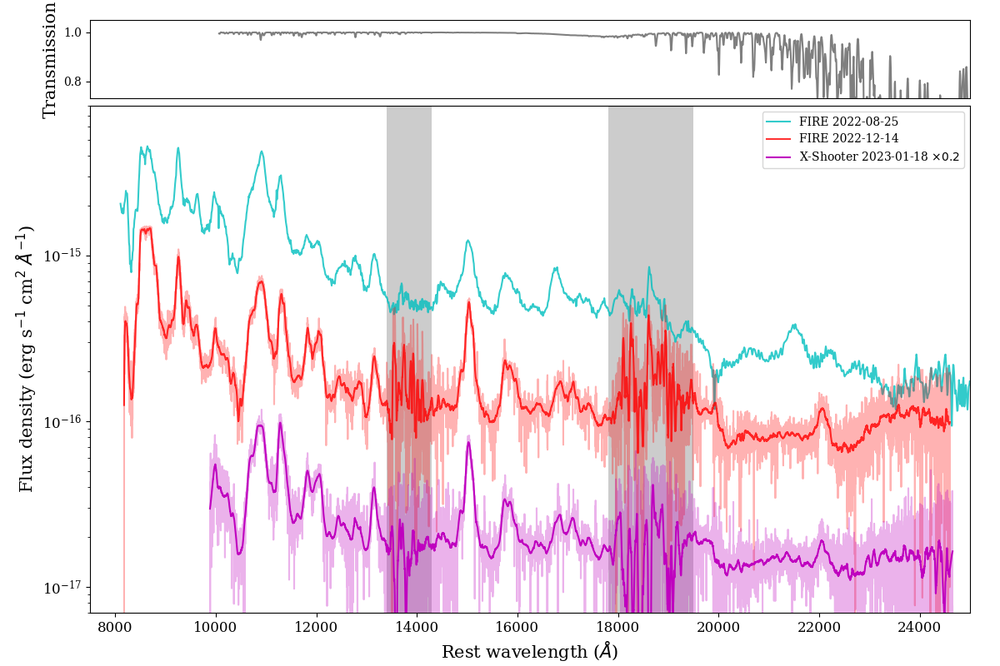

14:37:36 Assigning font /b'F1' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif.ttf'
14:37:36 Assigning font /b'F2' = '/opt/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Oblique.ttf'
14:37:36 vmin 7e-18 vmax 8e-15
14:37:36 ticklocs array([1.e-19, 1.e-18, 1.e-17, 1.e-16, 1.e-15, 1.e-14, 1.e-13])
14:37:36 vmin 7e-18 vmax 8e-15
14:37:36 ticklocs array([1.e-19, 1.e-18, 1.e-17, 1.e-16, 1.e-15, 1.e-14, 1.e-13])
14:37:36 vmin 7e-18 vmax 8e-15
14:37:36 ticklocs array([2.e-19, 3.e-19, 4.e-19, 5.e-19, 6.e-19, 7.e-19, 8.e-19, 9.e-19,
       2.e-18, 3.e-18, 4.e-18, 5.e-18, 6.e-18, 7.e-18, 8.e-18, 9.e-18,
       2.e-17, 3.e-17, 4.e-17, 5.e-17, 6.e-17, 7.e-17, 8.e-17, 9.e-17,
       2.e-16, 3.e-16, 4.e-16, 5.e-16, 6.e-16, 7.e-16, 8.e-16, 9.e-16,
       2.e-15, 3.e-15, 4.e-15, 5.e-15, 6.e-15, 7.e-15, 8.e-15, 9.e-15,
       2.e-14, 3.e-14, 4.e-14, 5.e-14, 6.e-14, 7.e-14, 8.e-14, 9.e-14,
       2.e-13, 3.e-13, 4.e-13, 5.e-13, 6.e-1

14:37:36 Decompiling 'post' table
14:37:36 Took 0.016s to load 'cmap'
14:37:36 Took 0.000s to prune 'cmap'
14:37:36 cmap pruned
14:37:36 kern dropped
14:37:36 Took 0.000s to load 'post'
14:37:36 Took 0.000s to prune 'post'
14:37:36 post pruned
14:37:36 FFTM dropped
14:37:36 Reading 'GPOS' table from disk
14:37:36 Decompiling 'GPOS' table
14:37:36 Took 0.001s to load 'GPOS'
14:37:36 Took 0.002s to prune 'GPOS'
14:37:36 GPOS pruned
14:37:36 Reading 'GSUB' table from disk
14:37:36 Decompiling 'GSUB' table
14:37:36 Took 0.001s to load 'GSUB'
14:37:36 Took 0.005s to prune 'GSUB'
14:37:36 GSUB pruned
14:37:36 Reading 'name' table from disk
14:37:36 Decompiling 'name' table
14:37:36 Took 0.002s to load 'name'
14:37:36 Reading 'fvar' table from disk
14:37:36 Reading 'STAT' table from disk
14:37:36 Took 0.001s to prune 'name'
14:37:36 name pruned
14:37:36 Reading 'glyf' table from disk
14:37:36 Decompiling 'glyf' table
14:37:36 Reading 'loca' table from disk
14:37:36 Decompiling 'loca' table
14

14:37:36 Glyph IDs:   [0, 1, 2, 3, 11, 12, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 40, 41, 44, 53, 54, 55, 59, 68, 70, 71, 72, 74, 75, 76, 79, 80, 81, 82, 85, 86, 87, 88, 89, 90, 91, 92, 2255]
14:37:36 Closed glyph list over 'GSUB': 44 glyphs after
14:37:36 Glyph names: ['.notdef', '.null', 'E', 'F', 'I', 'R', 'S', 'T', 'X', 'a', 'c', 'd', 'e', 'eight', 'five', 'four', 'g', 'h', 'hyphen', 'i', 'l', 'm', 'minus', 'n', 'nonmarkingreturn', 'o', 'one', 'parenleft', 'parenright', 'period', 'r', 's', 'seven', 'six', 'space', 't', 'three', 'two', 'u', 'v', 'w', 'x', 'y', 'zero']
14:37:36 Glyph IDs:   [0, 1, 2, 3, 11, 12, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 40, 41, 44, 53, 54, 55, 59, 68, 70, 71, 72, 74, 75, 76, 79, 80, 81, 82, 85, 86, 87, 88, 89, 90, 91, 92, 2255]
14:37:36 Took 0.007s to close glyph list over 'GSUB'
14:37:36 Closing glyph list over 'MATH': 44 glyphs before
14:37:36 Glyph names: ['.notdef', '.null', 'E', 'F', 'I', 'R', 'S', 'T', 'X', 'a', 'c', 'd', 'e', 'eight', 'f

In [418]:

fire_spec_0825_tellcorr = np.loadtxt('./spectra/FIRE/SN2022jli_FIRE_20220825_tellcorr.txt')


#fig, ax = plt.subplots(figsize=(15,8))


fig = plt.figure(figsize=(12,8))
gs0 = GridSpec(7, 1, figure=fig, hspace=0.1, wspace=0.5, left=0.09, right=0.97, bottom=0.08, top=0.97)

ax0 = fig.add_subplot(gs0[0, 0])
ax = fig.add_subplot(gs0[1:7, 0])




#mark telluric region 
cmap = mpl.cm.gray
norm = mpl.colors.Normalize(vmin=0, vmax=1)

# tellu_model = interp1d(tell_wave_air, telluriclines[:,1])
# for w in np.linspace(10000, 26000, 10000):
#     ax.vlines(w, ymin=7e-18, ymax=8e-15, colors=cmap(tellu_model(w)), lw=3)


xs = fire_spec_0825_tellcorr[:,0]/(1+z_22jli)
ys = fire_spec_0825_tellcorr[:,1]*0.068

mask = (xs>8100)*(xs<25000)
ys = ys[mask]
xs = xs[mask]
ax.plot(xs, ys, 'c', alpha=0.8, label='FIRE 2022-08-25')


spec =  np.loadtxt('./spectra/magellan_fire_20221214/SN2022jli_FIRE_20221214.txt')
xs = spec[:,0]/(1+z_22jli)
ys = spec[:,1]*1e-18*1.6

mask = (xs>8100)*(xs<24600)
ys = ys[mask]
xs = xs[mask]


specdf = spike_remove_main(xs, ys,  DELTA = 1e-16, HIGH_CLIP = 1.5e-15, LOW_CLIP = -3e-16, SPAN = 25, display=0)
ys_sf = specdf.y_interpolated.values #spike free


ax.plot(xs, ys_sf, 'r', alpha=0.3)
y_smooth = savgol_filter(ys_sf, 101, 3)
ax.plot(xs, y_smooth, color='r', alpha=0.8, label='FIRE 2022-12-14')




#xsh0113_nir = np.loadtxt('./spectra/xshooter/SN2022jli_xshooter_NIR_20230117.txt')
xsh0117_nir = np.loadtxt('/Users/chenping/Ping/spectra_reduction/XSHOOTER/reflex_data/reflex_end_products/sn2022jli_20230118_NIR/SN2022jli_xshooter_NIR_20230117_tellcor.txt')

hdu = fits.open('/Users/chenping/Ping/spectra_reduction/XSHOOTER/reflex_data/reflex_end_products/sn2022jli_20230118_NIR/SN2022jli_EPOCH_2_SCIENCE_TELLURIC_CORR.fits')
ws = (hdu[4].header['CRVAL1'] + np.arange(len(hdu[0].data))*hdu[0].header['CDELT1'])*10
fs = hdu[4].data
ax0.plot(ws, fs, color='k', alpha=0.5, )

xs = xsh0117_nir[:,0]/(1+z_22jli)
ys = xsh0117_nir[:,1]*1.35

specdf = spike_remove_main(xs, ys,  DELTA = 1e-16, HIGH_CLIP = 1e-15, LOW_CLIP = -9e-16, SPAN = 25, display=False)
ys_sf = specdf.y_interpolated.values #spike free


ax.plot(xs, ys_sf*0.2, color='m', alpha=0.3)
y_smooth = savgol_filter(ys_sf, 201, 3)
ax.plot(xs, y_smooth*0.2, color='m', label=r'X-Shooter 2023-01-18 $\times 0.2$')



ax.legend(loc=0)


#ax.set_ylim([0, 1e-14])

ax.set_yscale('log')

ylim1 = 7e-18
ylim2 = 8e-15
ax.fill_between([13400,14300], [ylim2, ylim2], [ylim1, ylim1], alpha=0.2, color='k', edgecolor='none')
ax.fill_between([17800,19500], [ylim2, ylim2], [ylim1, ylim1], alpha=0.2, color='k', edgecolor='none')

ax.set_ylim([ylim1, ylim2])

ax0.set_xticks([])
ax0.set_xlim([7500, 25000])
ax.set_xlim([7500, 25000])

ax0.set_ylabel('Transmission', fontsize=15)

ax.set_xlabel(r'Rest wavelength ($\AA$)', fontsize=15)
ax.set_ylabel(r'Flux density (erg s$^{-1}$ cm$^2$ $\AA^{-1}$)', fontsize=15)

ax.tick_params(labelsize=12)

#plt.savefig('./plots/sn2022jli_NIR_spectra.png')
plt.savefig('./plots/sn2022jli_NIR_spectra.pdf')

## comparison sne

#### 2020oi

Radio Spectra of SN 2020oi: Effects of Radiative Cooling on the Deduced Source Properties https://ui.adsabs.harvard.edu/abs/2022ApJ...936...98B/abstract

The Final Months of Massive Star Evolution from the Circumstellar Environment around SN Ic 2020oi https://ui.adsabs.harvard.edu/abs/2021ApJ...918...34M/abstract

Near-infrared and Optical Observations of Type Ic SN 2020oi and Broad-lined Type Ic SN 2020bvc: Carbon Monoxide, Dust, and High-velocity Supernova Ejecta https://ui.adsabs.harvard.edu/abs/2021ApJ...908..232R/abstract

A Non-equipartition Shock Wave Traveling in a Dense Circumstellar Environment around SN 2020oi https://ui.adsabs.harvard.edu/abs/2020ApJ...903..132H/abstract

In [30]:
spec_2020oi = Table.read('/Users/chenping/Ping/SN2022jli/comparison_sne/2020oi/2020oi_NIR_spec_63d.csv', format='ascii.csv')

spec_2020oi_02 = Table.read('/Users/chenping/Ping/SN2022jli/comparison_sne/2020oi/2020oi_optical_spec_67d.csv', format='ascii.csv')

In [31]:
print(spec_2020oi)

   x     Curve1 
------- --------
0.84417  0.26756
 0.8458  0.28343
0.84743  0.30025
0.84907  0.31806
 0.8507   0.3569
0.85233  0.37807
0.85723  0.43415
 0.8605   0.4599
0.86213   0.4816
0.86703  0.49282
    ...      ...
2.42325 0.016836
2.42978 0.016836
2.43795 0.016452
2.44448 0.016452
2.45101 0.017031
2.45918 0.016836
2.46407 0.017031
2.47061 0.017031
2.47551  0.01763
2.48204 0.018461
2.48694  0.01763
Length = 408 rows


### 2017eaw

In [10]:
spec_2017eaw = Table.read('/Users/chenping/Ping/SN2022jli/comparison_sne/2017eaw/2017eaw_NIR_spec_169d.csv') #extracted from https://arxiv.org/pdf/1808.00683.pdf  # spectrum aleary in rest frame of the SN
z_2017eaw = 0.000133 

   x       Curve1  
-------- ----------
0.761504  7.582e-17
0.763421  7.087e-17
0.764379   7.38e-17
0.765338  8.447e-17
0.766297  8.916e-17
0.767255 1.0205e-16
0.768214 1.0918e-16
0.769173 1.1681e-16
0.770131 1.2001e-16
0.772048 1.1217e-16
     ...        ...
2.489909 1.6362e-17
2.492785 1.5926e-17
2.494702 1.4886e-17
 2.49662 1.3914e-17
2.500454 1.3914e-17
2.504289 1.3544e-17
2.506206 1.2832e-17
 2.51004 1.3006e-17
2.511958 1.3728e-17
2.513875 1.4687e-17
2.516751 1.4296e-17
Length = 951 rows


<IPython.core.display.Javascript object>


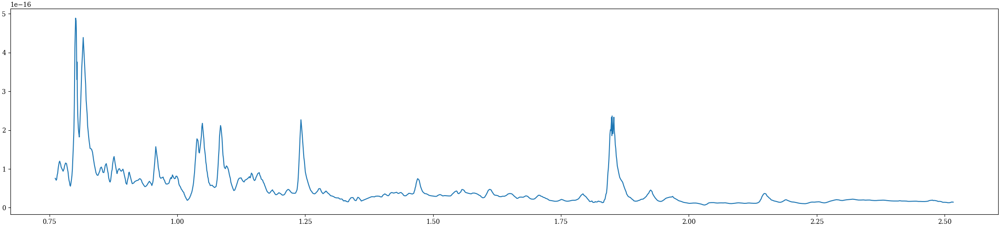

In [11]:
print(spec_2017eaw)

fig, ax = plt.subplots(figsize=(22,5), constrained_layout=True)
ax.plot(spec_2017eaw['x'], spec_2017eaw['Curve1'])

### iPTF15dtg


In [12]:
t0_15dtg = 2457333.448 #Taddia et al 2016 we adopt the average between the epochs of last non-detection and discovery as the explosion date (texplo = JD 2 457 333.448   0.483),
 
z_15dtg = 0.0524


iptf15dtg_dir = './comparison_sne/iPTF15dtg/'
spectable_15dtg_wiserep = Table.read('./comparison_sne/iPTF15dtg/wiserep_spectra.csv', format='ascii.csv')
#print(spectable_2013ge_wiserep.keys())

specinfo_15dtg = {}


phases = []
specnames = []
for jd, specfile in spectable_15dtg_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- t0_15dtg
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(iptf15dtg_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(iptf15dtg_dir, specfile), skiprows=1) 
    specinfo_15dtg[specname] = {}
    specinfo_15dtg[specname]['phase'] = phase
    specinfo_15dtg[specname]['spec'] = specdata
    
spectable_15dtg_wiserep.add_column(Column(phases, name='phase'))
spectable_15dtg_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_15dtg_wiserep))

printtable = spectable_15dtg_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

16
specname                      Ascii file                            JD             phase       
-------- --------------------------------------------------- --------------- ------------------
    3.2d         iPTF15dtg_2457336.60_TNG_DOLORES_iPTF.ascii       2457336.6 3.1520000002346933
    4.5d          iPTF15dtg_2457337.98_Keck1_LRIS_iPTF.ascii      2457337.98  4.532000000122935
   17.0d         iPTF15dtg_2457350.46_TNG_DOLORES_iPTF.ascii      2457350.46 17.012000000104308
   25.4d      iPTF15dtg_2457358.85_DCT_Deveny-LMI_iPTF.ascii 2457358.8499884 25.401988400146365
   29.1d          iPTF15dtg_2457362.50_Keck1_LRIS_iPTF.ascii       2457362.5  29.05200000014156
   34.0d          iPTF15dtg_2457367.43_NOT_ALFOSC_iPTF.ascii      2457367.43   33.9820000003092
   64.9d         iPTF15dtg_2457398.32_TNG_DOLORES_iPTF.ascii      2457398.32  64.87199999997392
   82.9d          iPTF15dtg_2457416.37_NOT_ALFOSC_iPTF.ascii      2457416.37  82.92200000025332
   97.0d 41012_2016-02-11_22-04-48.00

<IPython.core.display.Javascript object>


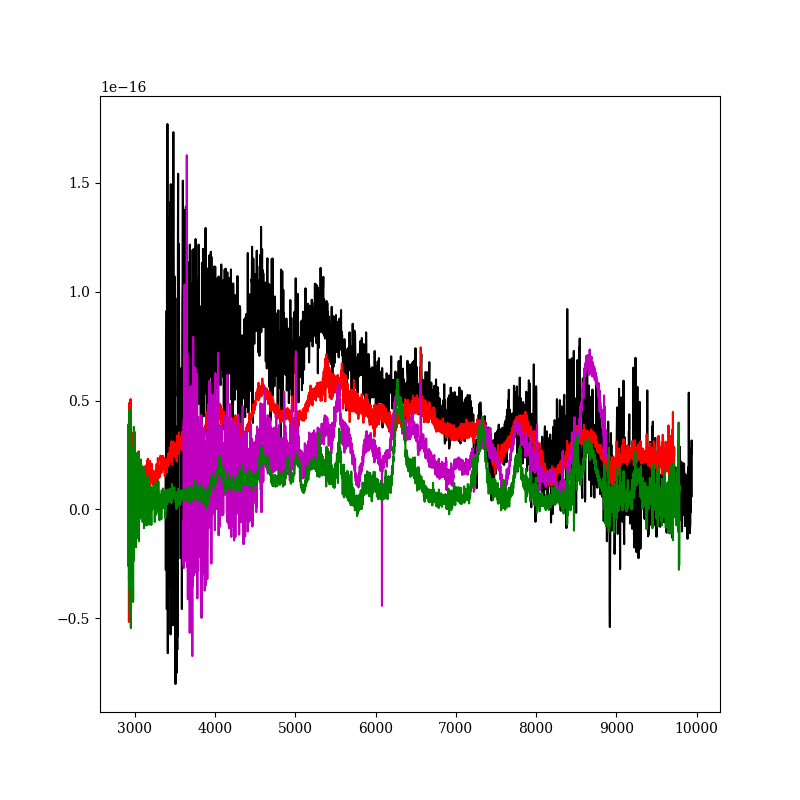

In [13]:
fig, ax = plt.subplots(figsize=(8,8))

specname = '17.0d'
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
ys = spec[:,1]
ax.plot(xs, ys, 'k')


specname = '29.1d'
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
ys = spec[:,1]
ax.plot(xs, ys, 'r')



specname = '123.3d'
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
ys = spec[:,1]
ax.plot(xs, ys, 'm')



specname = '359.6d'
spec = specinfo_15dtg[specname]['spec']
xs = spec[:,0]/(1+z_15dtg)
ys = spec[:,1]
ax.plot(xs, ys, 'g')

### SN 2004gk

2014AJ....147...99M Optical Spectra of 73 Stripped-envelope Core-collapse Supernovae

In [14]:
t0_04gk = 2453335 #discovery date https://ui.adsabs.harvard.edu/abs/2004IAUC.8446....1Q/abstract
 
z_04gk = 0.000407

sn04gk_dir = './comparison_sne/2004gk/'
spectable_04gk_wiserep = Table.read('./comparison_sne/2004gk/wiserep_spectra.csv', format='ascii.csv')
print(spectable_04gk_wiserep.keys())

specinfo_04gk = {}


phases = []
specnames = []
for jd, specfile in spectable_04gk_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- t0_04gk
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn04gk_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn04gk_dir, specfile), skiprows=1) 
    specinfo_04gk[specname] = {}
    specinfo_04gk[specname]['phase'] = phase
    specinfo_04gk[specname]['spec'] = specdata
    
spectable_04gk_wiserep.add_column(Column(phases, name='phase'))
spectable_04gk_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_04gk_wiserep))

printtable = spectable_04gk_wiserep[['specname', 'Ascii file','JD', 'phase','Publish']]
printtable.pprint_all()

['Obj. ID', 'IAU name', 'Internal name/s', 'Obj. RA', 'Obj. DEC', 'Obj. Type', 'Redshift', 'Spec. ID', 'Obs-date', 'JD', 'From', 'Telescope', 'Instrument', 'Observer/s', 'Reducer/s', 'Source group', 'Public', 'Associated groups', 'End prop. period', 'Ascii file', 'Fits file', 'Spec. type', 'Spec. quality', 'Extinction-Corrected', 'WL Medium', 'WL Units', 'Flux Unit Coefficient', 'Spec. units', 'Flux Calibrated By', 'Exp-time', 'Aperture (slit)', 'HA', 'Airmass', 'Dichroic', 'Grism', 'Grating', 'Blaze', 'Lambda-min', 'Lambda-max', 'Del-Lambda', 'Contrib', 'Publish', 'Remarks', 'Created by', 'Creation date']
37
specname                          Ascii file                                 JD             phase              Publish      
-------- ------------------------------------------------------------ --------------- ------------------ -------------------
    8.0d SN2004gk_2004-12-03_13-12-00_FLWO-1.5m_FAST_CfA-Stripped.flm      2453343.05  8.049999999813735 2014AJ....147...99M
   14.0d

<IPython.core.display.Javascript object>


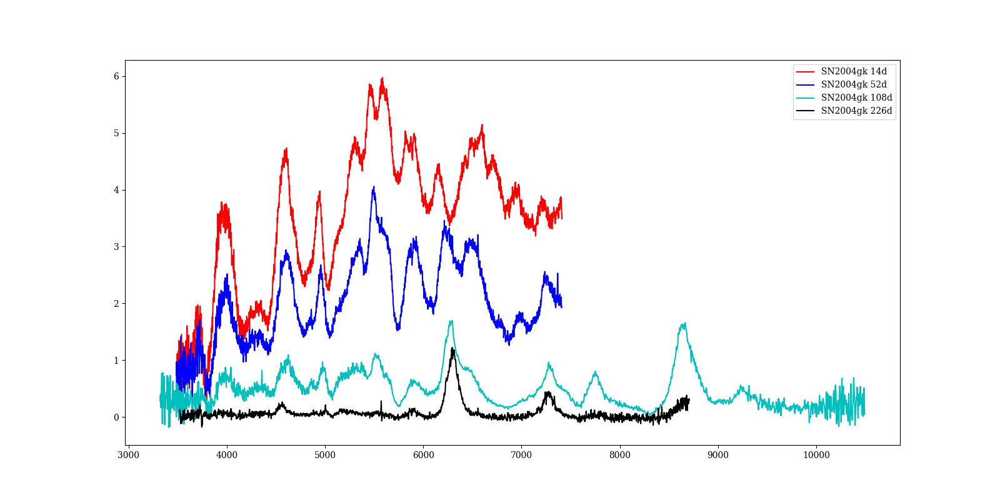

In [15]:
fig,ax = plt.subplots(figsize=(16,8))


specname = '14.0d'
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
ys = spec[:,1]
ax.plot(xs, ys, 'r', label='SN2004gk 14d')


specname = '52.0d'
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
ys = spec[:,1]
ax.plot(xs, ys, 'b', label='SN2004gk 52d')

specname = '108.0d'
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
ys = spec[:,1]*2
ax.plot(xs, ys, 'c', label='SN2004gk 108d')

specname = '226.5d'
spec = specinfo_04gk[specname]['spec']
xs = spec[:,0]/(1+z_04gk)
ys = spec[:,1]*10
ax.plot(xs, ys, 'k', label='SN2004gk 226d')

#ax.set_xlim([7000, 25000])
#ax.set_ylim([0, 5e-14])

#ax.set_yscale('log')
ax.legend(loc=0)

### 2004aw

In [16]:
t0_04aw = 2453086.05 # B band maximum time table 7 of https://iopscience.iop.org/article/10.1088/0067-0049/213/2/19/pdf
 
z_04aw = 0.0163

sn04aw_dir = './comparison_sne/2004aw/'
spectable_04aw_wiserep = Table.read('./comparison_sne/2004aw/wiserep_spectra.csv', format='ascii.csv')
print(spectable_04aw_wiserep.keys())

specinfo_04aw = {}


phases = []
specnames = []
for jd, specfile in spectable_04aw_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- t0_04aw
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn04aw_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn04aw_dir, specfile), skiprows=1) 
    specinfo_04aw[specname] = {}
    specinfo_04aw[specname]['phase'] = phase
    specinfo_04aw[specname]['spec'] = specdata
    
spectable_04aw_wiserep.add_column(Column(phases, name='phase'))
spectable_04aw_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_04aw_wiserep))

printtable = spectable_04aw_wiserep[['specname', 'Ascii file','JD', 'phase','Publish']]
printtable.pprint_all()

['Obj. ID', 'IAU name', 'Internal name/s', 'Obj. RA', 'Obj. DEC', 'Obj. Type', 'Redshift', 'Spec. ID', 'Obs-date', 'JD', 'From', 'Telescope', 'Instrument', 'Observer/s', 'Reducer/s', 'Source group', 'Public', 'Associated groups', 'End prop. period', 'Ascii file', 'Fits file', 'Spec. type', 'Spec. quality', 'Extinction-Corrected', 'WL Medium', 'WL Units', 'Flux Unit Coefficient', 'Spec. units', 'Flux Calibrated By', 'Exp-time', 'Aperture (slit)', 'HA', 'Airmass', 'Dichroic', 'Grism', 'Grating', 'Blaze', 'Lambda-min', 'Lambda-max', 'Del-Lambda', 'Contrib', 'Publish', 'Remarks', 'Created by', 'Creation date']
44
specname                          Ascii file                                 JD              phase              Publish      
-------- ------------------------------------------------------------ --------------- ------------------- -------------------
   -0.3d SN2004aw_2004-03-21_06-57-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2453085.79 -0.2599999997764826 2014AJ....147...99M
    1

<IPython.core.display.Javascript object>


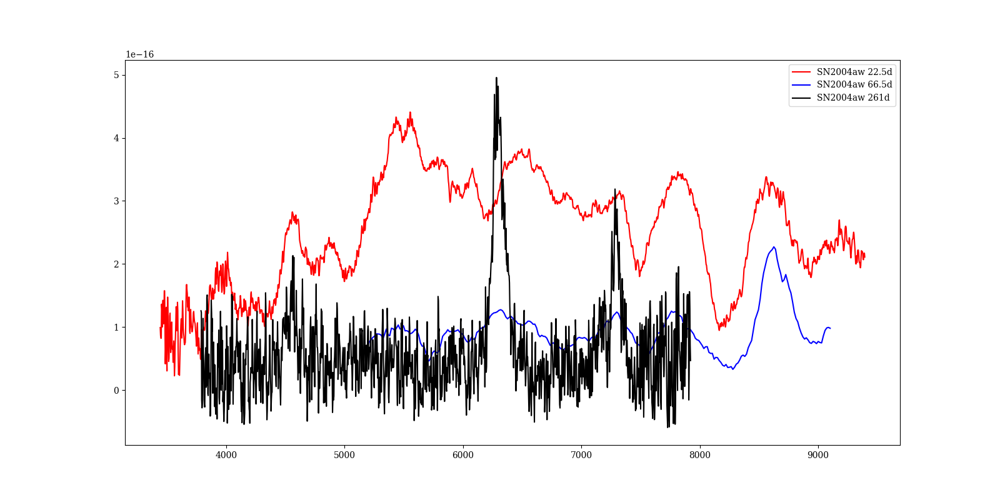

In [17]:
fig,ax = plt.subplots(figsize=(16,8))


specname = '16.5d'
spec = specinfo_04aw[specname]['spec']
xs = spec[:,0]/(1+z_04aw)
ys = spec[:,1]
ax.plot(xs, ys, 'r', label='SN2004aw 22.5d')


specname = '64.5d'
spec = specinfo_04aw[specname]['spec']
xs = spec[:,0]/(1+z_04aw)
ys = spec[:,1]
ax.plot(xs, ys, 'b', label='SN2004aw 66.5d')


specname = '261.5d'
spec = specinfo_04aw[specname]['spec']
xs = spec[:,0]/(1+z_04aw)
ys = spec[:,1]*10
ax.plot(xs, ys, 'k', label='SN2004aw 261d')

#ax.set_xlim([7000, 25000])
#ax.set_ylim([0, 5e-14])

#ax.set_yscale('log')
ax.legend(loc=0)

###  1997ef

In [18]:
TmaxB_97ef = 50713.4+2400000.5 #
 
z_97ef = 0.011805


sn2097ef_dir = './comparison_sne/1997ef/'
spectable_97ef_wiserep = Table.read('./comparison_sne/1997ef/wiserep_spectra.csv', format='ascii.csv')

specinfo_97ef = {}


phases = []
specnames = []
for jd, specfile in spectable_97ef_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- TmaxB_97ef
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn2097ef_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn2097ef_dir, specfile), skiprows=1) 
    specinfo_97ef[specname] = {}
    specinfo_97ef[specname]['phase'] = phase
    specinfo_97ef[specname]['spec'] = specdata
    
spectable_97ef_wiserep.add_column(Column(phases, name='phase'))
spectable_97ef_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_97ef_wiserep))

printtable = spectable_97ef_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

38
specname                          Ascii file                                 JD             phase       
-------- ------------------------------------------------------------ --------------- ------------------
   65.0d SN1997ef_1997-11-26_09-21-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2450778.89  64.99000000022352
   67.1d SN1997ef_1997-11-28_12-57-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2450781.04  67.14000000013039
   68.0d SN1997ef_1997-11-29_10-19-12_FLWO-1.5m_FAST_CfA-Stripped.flm      2450781.93  68.03000000026077
   69.0d SN1997ef_1997-11-30_08-24-00_FLWO-1.5m_FAST_CfA-Stripped.flm      2450782.85  68.95000000018626
   69.9d SN1997ef_1997-12-01_08-09-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2450783.84  69.93999999994412
   72.9d SN1997ef_1997-12-04_08-09-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2450786.84  72.93999999994412
   73.9d SN1997ef_1997-12-05_07-26-24_FLWO-1.5m_FAST_CfA-Stripped.flm      2450787.81  73.91000000014901
   74.0d   SN1997ef_1997-12-05_09-50-24_MMT_MMT-Blue

<IPython.core.display.Javascript object>


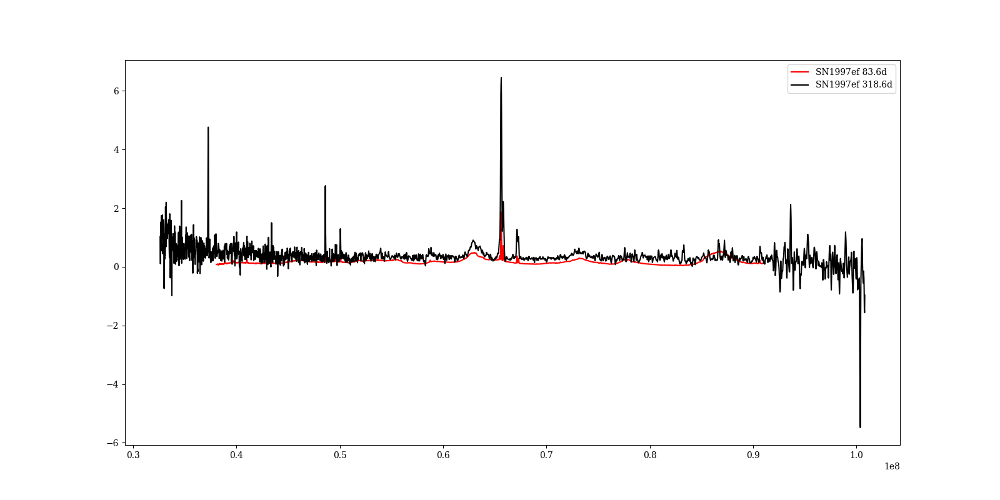

In [19]:
fig,ax = plt.subplots(figsize=(16,8))





specname = '184.6d'
spec = specinfo_97ef[specname]['spec']
xs = spec[:,0]*1e4/(1+z_97ef)
ys = spec[:,1]
ax.plot(xs, ys, 'r', label='SN1997ef 83.6d')


specname = '363.6d'
spec = specinfo_97ef[specname]['spec']
xs = spec[:,0]*1e4/(1+z_97ef)
ys = spec[:,1]*10
ax.plot(xs, ys, 'k', label='SN1997ef 318.6d')



#ax.set_xlim([7000, 25000])
#ax.set_ylim([0, 5e-14])

#ax.set_yscale('log')
ax.legend(loc=0)

### 1997dq


In [20]:
TmaxB_97dq = 50720.4+2400000.5 #
 
z_97dq = 0.003196


sn2097dq_dir = './comparison_sne/1997dq/'
spectable_97dq_wiserep = Table.read('./comparison_sne/1997dq/wiserep_spectra.csv', format='ascii.csv')

specinfo_97dq = {}


phases = []
specnames = []
for jd, specfile in spectable_97dq_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- TmaxB_97dq
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn2097dq_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn2097dq_dir, specfile), skiprows=1) 
    specinfo_97dq[specname] = {}
    specinfo_97dq[specname]['phase'] = phase
    specinfo_97dq[specname]['spec'] = specdata
    
spectable_97dq_wiserep.add_column(Column(phases, name='phase'))
spectable_97dq_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_97dq_wiserep))

printtable = spectable_97dq_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

20
specname                          Ascii file                                 JD             phase       
-------- ------------------------------------------------------------ --------------- ------------------
   39.1d SN1997dq_1997-11-07_12-57-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2450760.04 39.140000000130385
   39.6d          1997dq_1997-11-08_00-00-00_Lick-3m_KAST_SUSPECT.dat       2450760.5  39.60000000009313
   39.6d      SN_1997dq_1997-11-08_00-00-00_Lick-3m_KAST_UCB-SNDB.flm       2450760.5  39.60000000009313
   40.2d       SN1997dq_1997-11-08_13-30-43_Lick-3m_KAST_UCB-SNDB.flm 2450761.0629977  40.16299770027399
   54.1d SN1997dq_1997-11-22_12-57-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2450775.04 54.140000000130385
   57.1d SN1997dq_1997-11-25_12-57-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2450778.04 57.140000000130385
   61.1d SN1997dq_1997-11-29_12-57-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2450782.04 61.140000000130385
   66.1d SN1997dq_1997-12-04_12-00-00_FLWO-1.5m_FAST

<IPython.core.display.Javascript object>


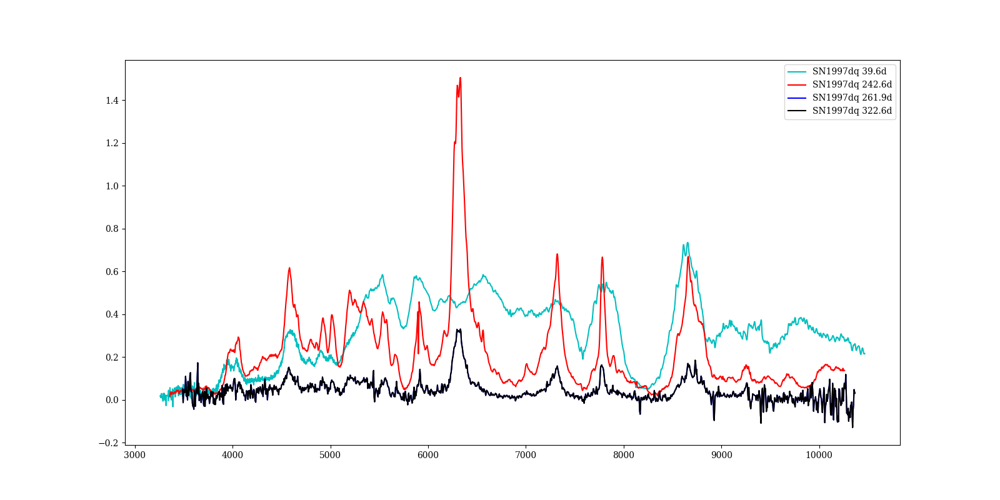

In [21]:
fig,ax = plt.subplots(figsize=(16,8))



specname = '39.6d'
spec = specinfo_97dq[specname]['spec']
xs = spec[:,0]/(1+z_97dq)
ys = spec[:,1]*0.1
ax.plot(xs, ys, 'c', label='SN1997dq '+specname)


specname = '242.6d'
spec = specinfo_97dq[specname]['spec']
xs = spec[:,0]/(1+z_97dq)
ys = spec[:,1]*1e15
ax.plot(xs, ys, 'r', label='SN1997dq '+specname)

specname = '261.9d'
spec = specinfo_97dq[specname]['spec']
xs = spec[:,0]/(1+z_97dq)
ys = spec[:,1]
ax.plot(xs, ys, 'b', label='SN1997dq '+specname)

specname = '322.6d'
spec = specinfo_97dq[specname]['spec']
xs = spec[:,0]/(1+z_97dq)
ys = spec[:,1]
ax.plot(xs, ys, 'k', label='SN1997dq '+specname)



#ax.set_xlim([7000, 25000])
#ax.set_ylim([0, 5e-14])

#ax.set_yscale('log')
ax.legend(loc=0)

### 2007bi

In [22]:
TmaxB_07bi = 2454566.5-412 #
 
z_07bi = 0.1279


sn2007bi_dir = './comparison_sne/2007bi/'
spectable_07bi_wiserep = Table.read('./comparison_sne/2007bi/wiserep_spectra.csv', format='ascii.csv')

specinfo_07bi = {}


phases = []
specnames = []
for jd, specfile in spectable_07bi_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- TmaxB_07bi
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn2007bi_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn2007bi_dir, specfile), skiprows=1) 
    specinfo_07bi[specname] = {}
    specinfo_07bi[specname]['phase'] = phase
    specinfo_07bi[specname]['spec'] = specdata
    
spectable_07bi_wiserep.add_column(Column(phases, name='phase'))
spectable_07bi_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_07bi_wiserep))

printtable = spectable_07bi_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

13
specname                        Ascii file                              JD             phase       
-------- ------------------------------------------------------- --------------- ------------------
   51.6d SN_2007bi_2007-04-15_14-26-52_Keck1_LRIS_UCB-SNDB_0.flm 2454206.1019907 51.601990699768066
   52.0d     2007bi_2007-04-16_00-00-00_Keck1_LRIS_PTFdryrun.flm       2454206.5               52.0
   52.4d SN_2007bi_2007-04-16_08-49-55_Keck1_LRIS_UCB-SNDB_0.flm 2454206.8679977 52.367997699882835
   58.0d                 2007bi_2007-04-22_Ekar_AFOSC_None.ascii       2454212.5               58.0
   60.0d               2007bi_2007-04-24_INT-2.5m_IDS_None.ascii       2454214.5               60.0
  112.0d              2007bi_2007-06-15_WHT-4.2m_ISIS_None.ascii       2454266.5              112.0
  148.0d              2007bi_2007-07-21_WHT-4.2m_ISIS_None.ascii       2454302.5              148.0
  412.0d  2007bi_2008-04-10_00-00-00_VLT-UT1_FORS2_PTFdryrun.dat       2454566.5              412

<IPython.core.display.Javascript object>


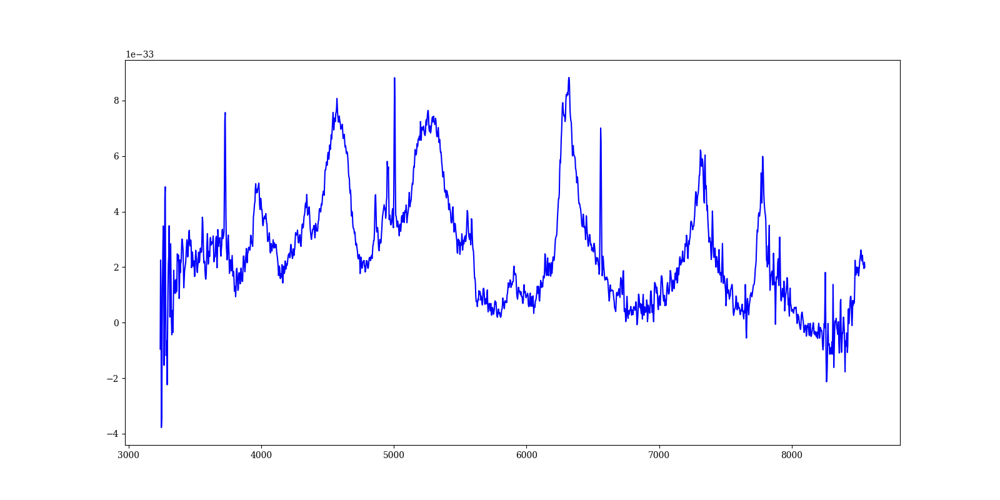

In [23]:
fig,ax = plt.subplots(figsize=(16,8))


specname = '412.0d'
spec = specinfo_07bi[specname]['spec']
xs = spec[:,0]/(1+z_07bi)
ys = spec[:,1]*1e-15
ax.plot(xs, ys, 'b', label='SN2007bi 412d')

### 2015bn

In [24]:
TmaxB_15bn = 2457102.5 #
 
z_15bn = 0.1136


sn2015bn_dir = './comparison_sne/2015bn/'
spectable_15bn_wiserep = Table.read('./comparison_sne/2015bn/wiserep_spectra.csv', format='ascii.csv')

specinfo_15bn = {}


phases = []
specnames = []
for jd, specfile in spectable_15bn_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- TmaxB_15bn
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn2015bn_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn2015bn_dir, specfile), skiprows=1) 
    specinfo_15bn[specname] = {}
    specinfo_15bn[specname]['phase'] = phase
    specinfo_15bn[specname]['spec'] = specdata
    
spectable_15bn_wiserep.add_column(Column(phases, name='phase'))
spectable_15bn_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_15bn_wiserep))

printtable = spectable_15bn_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

37
specname                         Ascii file                               JD             phase       
-------- --------------------------------------------------------- --------------- ------------------
  -32.0d    2015bn_2015-02-17_00-00-00_ESO-NTT_EFOSC2-NTT_None.txt       2457070.5              -32.0
  -31.0d  2015bn_2015-02-18_00-00-00_Magellan-Baade_IMACS_None.txt       2457071.5              -31.0
  -30.5d   2015bn_2015-02-18_12-00-00_ESO-NTT_EFOSC2-NTT_None.asci       2457072.0              -30.5
  -25.0d        2015bn_2015-02-24_00-00-00_ANU-2.3m_WiFeS_None.txt       2457077.5              -25.0
  -25.0d          2015bn_2015-02-24_00-00-00_ESO-NTT_Sofi_None.txt       2457077.5              -25.0
  -24.0d    2015bn_2015-02-25_00-00-00_ESO-NTT_EFOSC2-NTT_None.txt       2457078.5              -24.0
  -20.0d              2015bn_2015-03-01_00-00-00_LT_SPRAT_None.txt       2457082.5              -20.0
  -10.0d          2015bn_2015-03-11_00-00-00_MMT_MMT-Blue_None.txt       245709

<IPython.core.display.Javascript object>


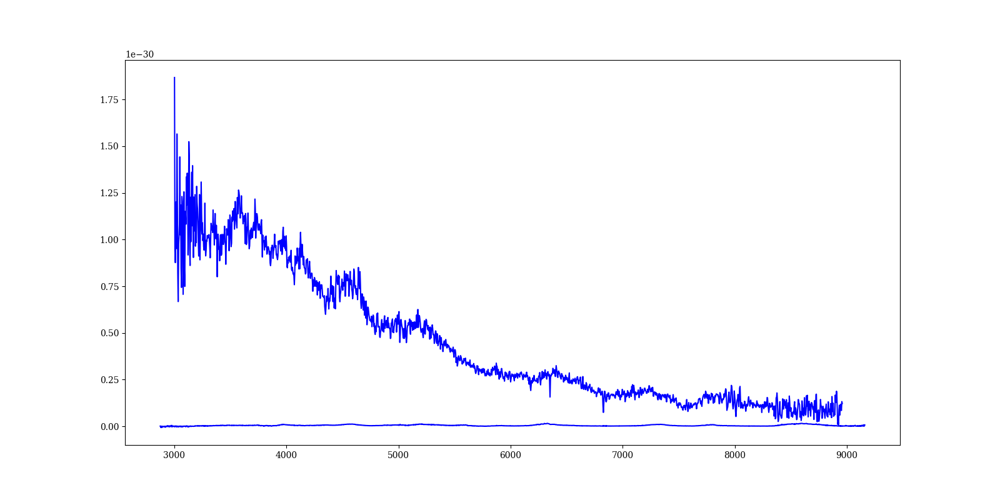

In [25]:
fig,ax = plt.subplots(figsize=(16,8))


specname = '21.0d'
spec = specinfo_15bn[specname]['spec']
xs = spec[:,0]/(1+z_15bn)
ys = spec[:,1]*1e-15
ax.plot(xs, ys, 'b', label='SN2015bn 21.0d')

specname = '350.0d'
spec = specinfo_15bn[specname]['spec']
xs = spec[:,0]/(1+z_15bn)
ys = spec[:,1]*1e-15
ax.plot(xs, ys, 'b', label='SN2015bn 350d')



### 2012au 

optical and NIR


https://www.wiserep.org/object/9568

In [26]:
TmaxB_12au = 56006.4+2400000.5 #from https://ui.adsabs.harvard.edu/abs/2021MNRAS.507.1229P/abstract
 
z_12au = 0.004483


sn2012au_dir = './comparison_sne/2012au/'
spectable_12au_wiserep = Table.read('./comparison_sne/2012au/wiserep_spectra.csv', format='ascii.csv')

specinfo_12au = {}


phases = []
specnames = []
for jd, specfile in spectable_12au_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- TmaxB_12au
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn2012au_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn2012au_dir, specfile), skiprows=1) 
    specinfo_12au[specname] = {}
    specinfo_12au[specname]['phase'] = phase
    specinfo_12au[specname]['spec'] = specdata
    
spectable_12au_wiserep.add_column(Column(phases, name='phase'))
spectable_12au_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_12au_wiserep))

printtable = spectable_12au_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

10
specname                         Ascii file                               JD              phase       
-------- --------------------------------------------------------- --------------- -------------------
   -4.9d   SN_2012au_2012-03-15_12-23-02_Keck1_LRIS_UCB-SNDB_0.flm 2456002.0159954  -4.884004599880427
   -3.4d      SN2012au_2012-03-17_00-00-00_FLWO-1.5m_FAST_None.flm       2456003.5 -3.3999999999068677
    6.6d        SN2012au_2012-03-27_00-00-00_MMT_MMT-Blue_None.flm       2456013.5   6.600000000093132
   31.6d SN2012au_2012-04-21_00-00-00_Magellan-Baade_FIRE_None.txt       2456038.5  31.600000000093132
   57.6d      SN2012au_2012-05-17_00-00-00_FLWO-1.5m_FAST_None.flm       2456064.5   57.60000000009313
   83.6d SN2012au_2012-06-12_00-00-00_Magellan-Baade_FIRE_None.txt       2456090.5   83.60000000009313
   88.0d   SN_2012au_2012-06-16_08-34-04_Keck1_LRIS_UCB-SNDB_0.flm 2456094.8569907    87.9569907002151
  273.6d        SN2012au_2012-12-19_00-00-00_MMT_MMT-Blue_None.flm    

<IPython.core.display.Javascript object>


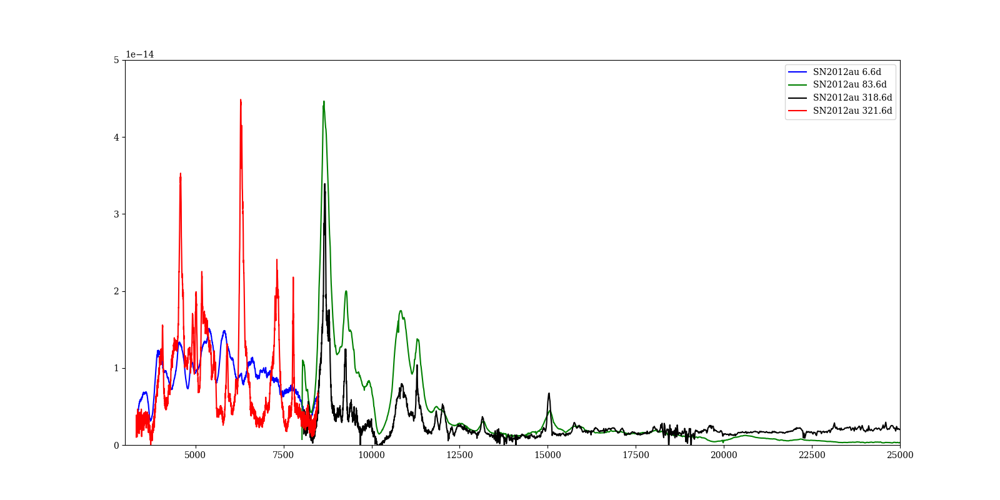

In [27]:
fig,ax = plt.subplots(figsize=(16,8))


specname = '6.6d'
spec = specinfo_12au[specname]['spec']
xs = spec[:,0]/(1+z_12au)
ys = spec[:,1]*1e-15
ax.plot(xs, ys, 'b', label='SN2012au 6.6d')


specname = '83.6d'
spec = specinfo_12au[specname]['spec']
xs = spec[:,0]*1e4/(1+z_12au)
ys = spec[:,1]
ax.plot(xs, ys, 'g', label='SN2012au 83.6d')


specname = '318.6d'
spec = specinfo_12au[specname]['spec']
xs = spec[:,0]*1e4/(1+z_12au)
ys = spec[:,1]*10
ax.plot(xs, ys, 'k', label='SN2012au 318.6d')


specname = '321.6d'
spec = specinfo_12au[specname]['spec']
xs = spec[:,0]/(1+z_12au)
ys = spec[:,1]*1e-13
ax.plot(xs, ys, 'r', label='SN2012au 321.6d')

ax.set_xlim([3000, 25000])
ax.set_ylim([0, 5e-14])

#ax.set_yscale('log')
ax.legend(loc=0)

### 2004aw

### 2002ap

Gal-Yam MNRAS 2002  Supernova 2002ap: the first month


In [28]:
TmaxB_02ap = 2452311.43
 
z_02ap = 0.002108


sn2002ap_dir = './comparison_sne/2002ap/'
spectable_02ap_wiserep = Table.read('./comparison_sne/2002ap/wiserep_spectra.csv', format='ascii.csv')

specinfo_02ap = {}


phases = []
specnames = []
for jd, specfile in spectable_02ap_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- TmaxB_02ap
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn2002ap_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn2002ap_dir, specfile), skiprows=1) 
    specinfo_02ap[specname] = {}
    specinfo_02ap[specname]['phase'] = phase
    specinfo_02ap[specname]['spec'] = specdata
    
spectable_02ap_wiserep.add_column(Column(phases, name='phase'))
spectable_02ap_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_02ap_wiserep))

printtable = spectable_02ap_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

57
specname                          Ascii file                                 JD              phase       
-------- ------------------------------------------------------------ --------------- -------------------
   -5.2d            SN2002ap_2002-01-31_16-39-56_Wise1m_FOSC_None.ASC 2452306.1943981 -5.2356019001454115
   -4.9d               SN2002ap_2002-02-01_00-00-00_HST_STIS_None.dat       2452306.5  -4.930000000167638
   -3.9d           2002ap_2002-02-02_00-00-00_Wise1m_FOSC_SUSPECT.dat       2452307.5  -3.930000000167638
   -2.9d           2002ap_2002-02-03_00-00-00_Wise1m_FOSC_SUSPECT.dat       2452308.5  -2.930000000167638
    0.2d SN2002ap_2002-02-06_02-38-24_FLWO-1.5m_FAST_CfA-Stripped.flm      2452311.61 0.17999999970197678
    1.2d SN2002ap_2002-02-07_02-09-36_FLWO-1.5m_FAST_CfA-Stripped.flm      2452312.59  1.1599999996833503
    1.8d            SN2002ap_2002-02-07_16-52-41_Wise1m_FOSC_None.ASC 2452313.2032523  1.7732522999867797
    2.1d SN2002ap_2002-02-08_01-55-12_FLWO-

<IPython.core.display.Javascript object>


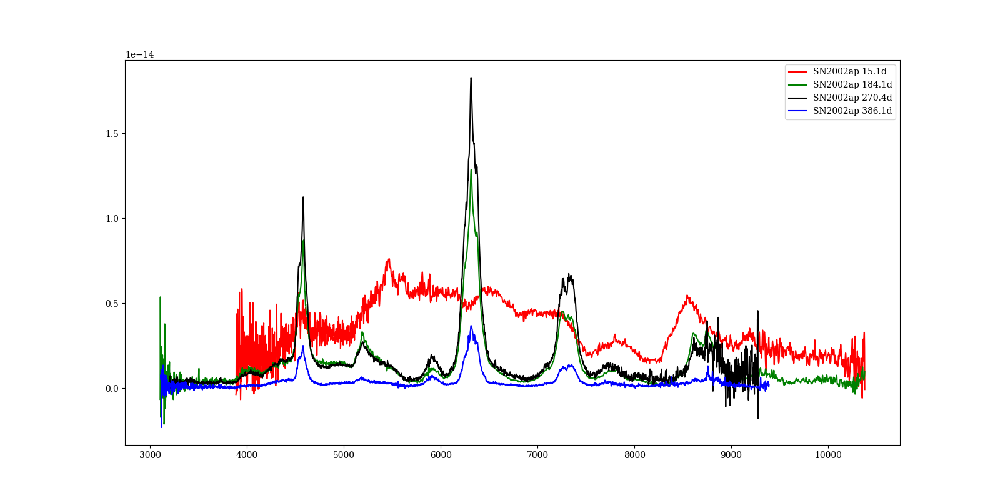

In [29]:
fig,ax = plt.subplots(figsize=(16,8))

specname = '15.1d'
spec = specinfo_02ap[specname]['spec']
xs = spec[:,0]/(1+z_02ap)
ys = spec[:,1]*1e-14
ax.plot(xs, ys, 'r', label='SN2002ap '+specname)

specname = '184.1d'
spec = specinfo_02ap[specname]['spec']
xs = spec[:,0]/(1+z_02ap)
ys = spec[:,1]*1e-14*0.5
ax.plot(xs, ys, 'g', label='SN2002ap '+specname)


specname = '270.4d'
spec = specinfo_02ap[specname]['spec']
xs = spec[:,0]/(1+z_02ap)
ys = spec[:,1]*1e-14
ax.plot(xs, ys, 'k', label='SN2002ap '+specname)


specname = '386.1d'
spec = specinfo_02ap[specname]['spec']
xs = spec[:,0]/(1+z_02ap)
ys = spec[:,1]*1e-15
ax.plot(xs, ys, 'b', label='SN2002ap '+specname)

#ax.set_xlim([7000, 25000])
#ax.set_ylim([0, 5e-14])

ax.legend(loc=0)

### 2018ibb

<IPython.core.display.Javascript object>


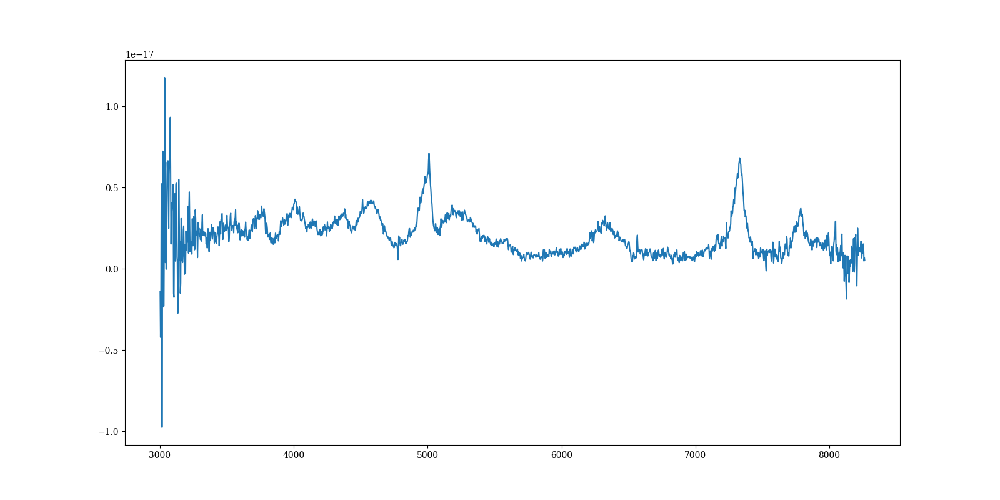

In [30]:
z_18ibb = 0.166
spec_18ibb = np.loadtxt('/Users/chenping/Ping/publications/_2018ibb/2018ibb_FORS2_300V_59112_hostsub_absfluxcal_extcorr.ascii')

fig,ax = plt.subplots(figsize=(16,8))

ax.plot(spec_18ibb[:,0]/(1+z_18ibb), spec_18ibb[:,1])

### 2013ge

In [23]:
TmaxB_13ge = 56615.7+2400000.5 #from table 7 of https://iopscience.iop.org/article/10.3847/0004-637X/821/1/57
 
z_13ge = 0.004356


sn2013ge_dir = '../data/comparison_sne/2013ge/'
spectable_13ge_wiserep = Table.read('../data/comparison_sne/2013ge/wiserep_spectra.csv', format='ascii.csv')

specinfo_13ge = {}


phases = []
specnames = []
for jd, specfile in spectable_13ge_wiserep[['JD', 'Ascii file']]:
    #print(jd, specfile)
    phase = jd- TmaxB_13ge
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    try:
        specdata = np.loadtxt(os.path.join(sn2013ge_dir, specfile))
    except:
        specdata = np.loadtxt(os.path.join(sn2013ge_dir, specfile), skiprows=1) 
    specinfo_13ge[specname] = {}
    specinfo_13ge[specname]['phase'] = phase
    specinfo_13ge[specname]['spec'] = specdata
    
spectable_13ge_wiserep.add_column(Column(phases, name='phase'))
spectable_13ge_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_13ge_wiserep))

printtable = spectable_13ge_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

40
specname                         Ascii file                               JD              phase       
-------- --------------------------------------------------------- --------------- -------------------
  -10.7d          2013ge_2013-11-09_00-00-00_MMT_MMT-Blue_None.flm       2456605.5 -10.700000000186265
   -9.7d          2013ge_2013-11-10_00-00-00_MMT_MMT-Blue_None.flm       2456606.5  -9.700000000186265
   -9.7d        2013ge_2013-11-10_00-00-00_MMT_MMT-Blue_None_0.flm       2456606.5  -9.700000000186265
   -8.7d          2013ge_2013-11-11_00-00-00_MMT_MMT-Blue_None.flm       2456607.5  -8.700000000186265
    0.3d   2013ge_2013-11-20_00-00-00_Magellan-Baade_FIRE_None.flm       2456616.5  0.2999999998137355
    1.3d         2013ge_2013-11-21_00-00-00_MMT_Hectospec_None.flm       2456617.5  1.2999999998137355
    8.8d SN_2013ge_2013-11-28_11-25-26_Lick-3m_KAST_UCB-SNDB_0.flm 2456624.9759954   8.775995399802923
    9.3d         2013ge_2013-11-29_00-00-00_MMT_Hectospec_None.flm    

In [32]:
specinfo_13ge['spectable'] = spectable_13ge_wiserep

#if save the data
outfile = '/Users/chenping/Ping/SN2022jli/comparison_sne/2013ge/2013ge_spec.p'
if os.path.exists(outfile):
    os.remove(outfile)
with open(outfile, 'wb') as fp:
    pickle.dump(specinfo_13ge, fp, protocol=pickle.HIGHEST_PROTOCOL)

<IPython.core.display.Javascript object>


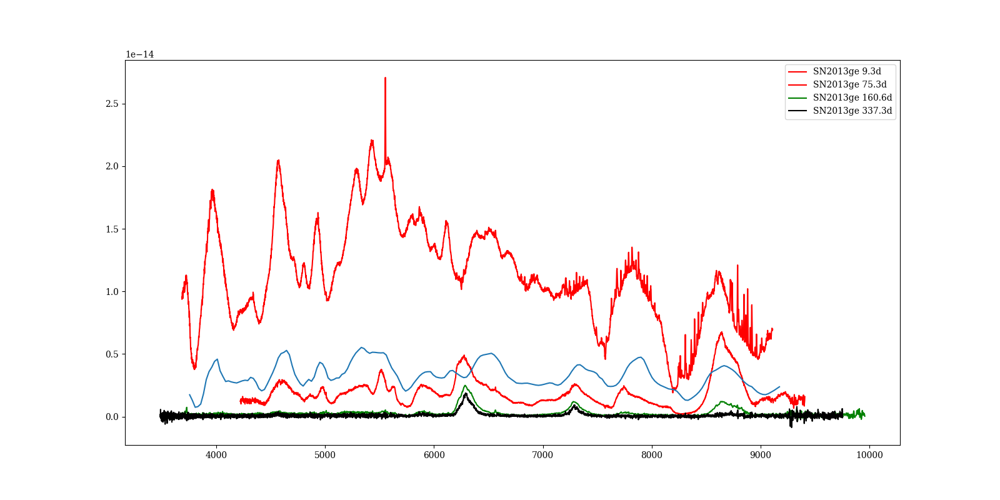

In [33]:
fig,ax = plt.subplots(figsize=(16,8))


specname = '9.3d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]*4e-15
ax.plot(xs, ys, 'r', label='SN2013ge 9.3d')

specname = '75.3d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]*4e-15
ax.plot(xs, ys, 'r', label='SN2013ge 75.3d')

specname = 'sedm0707'
specdata = specs_22jli[specname]['spec_photcal']
xs = specdata[:,0]/(1+z_22jli)
ys = specdata[:,1]
ax.plot(xs, ys)

# specname = '125.3d'
# spec = specinfo_13ge[specname]['spec']
# xs = spec[:,0]/(1+z_13ge)
# ys = spec[:,1]*0.15
# ax.plot(xs, ys, 'r', label='SN2013ge 125.3d')

specname = '160.6d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]*1e-14*0.5
ax.plot(xs, ys, 'g', label='SN2013ge 160.6d')


specname = '337.3d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]*1e-14
ax.plot(xs, ys, 'k', label='SN2013ge 337.3d')


# specname = '421.3d'
# spec = specinfo_13ge[specname]['spec']
# xs = spec[:,0]/(1+z_13ge)
# ys = spec[:,1]*1e-14
# ax.plot(xs, ys, 'b', label='SN2013ge 421.3d')

#ax.set_xlim([7000, 25000])
#ax.set_ylim([0, 5e-14])

ax.legend(loc=0)

In [34]:
print(specs_22jli.keys())

dict_keys(['psh0511', 'efosc0524', 'sedm0629', 'sedm0707', 'sedm0719', 'sedm0726', 'sedm0804', 'sedm0811', 'sedm0816', 'sedm0818', 'sedm0823', 'sedm0828', 'sedm0908', 'sedm0916', 'sedm1002', 'sedm1005', 'sedm1011', 'sedm1014', 'sedm1021', 'sedm1022', 'sedm1030', 'sedm1115', 'sedm1127', 'sedm1211', 'sedm1220', 'sedm0113', 'sedm0202', 'not0806', 'not0921', 'not1031', 'not1125', 'not0203', 'not0208', 'dbsp0820', 'dbsp1011', 'dbsp1102', 'imacs1214', 'binospec1227', 'binospec0112', 'binospec0113', 'binospec0120', 'binospec0121', 'binospec0131', 'xsh0114', 'xsh0118', 'xsh0121', 'spectable', 'notes'])


<IPython.core.display.Javascript object>


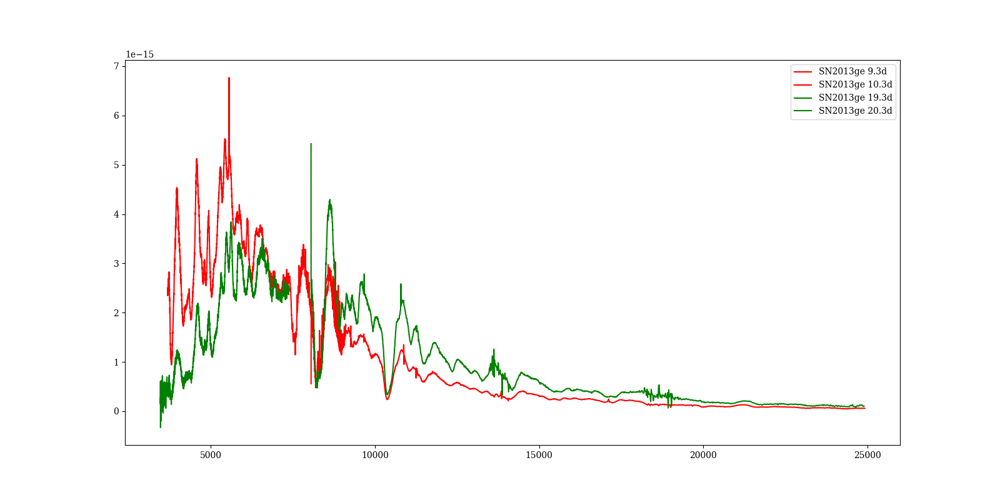

In [35]:
fig,ax = plt.subplots(figsize=(16,8))


specname = '9.3d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]*1e-15
ax.plot(xs, ys, 'r', label='SN2013ge 9.3d')

specname = '10.3d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]*0.1
ax.plot(xs, ys, 'r', label='SN2013ge 10.3d')

specname = '19.3d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]*0.15
ax.plot(xs, ys, 'g', label='SN2013ge 19.3d')

specname = '20.3d'
spec = specinfo_13ge[specname]['spec']
xs = spec[:,0]/(1+z_13ge)
ys = spec[:,1]*1e-15
ax.plot(xs, ys, 'g', label='SN2013ge 20.3d')



#ax.set_xlim([7000, 25000])
#ax.set_ylim([0, 5e-14])

ax.legend(loc=0)

### 2007gr

In [36]:

TmaxB_07gr = 2454337  #2007-08-24
t0_07gr = 2454325.5 #+/-2.5  from Hunter et al. 2009
 
z_07gr = 0.001728

print(TmaxB_07gr-t0_07gr)

sn2007gr_dir = '/Users/chenping/Ping/SN2022oqm/comparison_sne/2007gr/wiserep_spectra/'
spectable_2007gr_wiserep = Table.read('/Users/chenping/Ping/SN2022oqm/comparison_sne/2007gr/wiserep_spectra/wiserep_spectra.csv', format='ascii.csv')
#print(spectable_2007gr_wiserep.keys())

specinfo_2007gr = {}


phases = []
specnames = []
for jd, specfile in spectable_2007gr_wiserep[['JD', 'Ascii file']]:
    phase = jd- t0_07gr
    phases.append(phase)
    specname = str(np.around(phase,1))+'d'
    specnames.append(specname)
    specdata = np.loadtxt(os.path.join(sn2007gr_dir, specfile))
    specinfo_2007gr[specname] = {}
    specinfo_2007gr[specname]['phase'] = phase
    specinfo_2007gr[specname]['spec'] = specdata
    
spectable_2007gr_wiserep.add_column(Column(phases, name='phase'))
spectable_2007gr_wiserep.add_column(Column(specnames, name='specname'))

print(len(spectable_2007gr_wiserep))

printtable = spectable_2007gr_wiserep[['specname', 'Ascii file','JD', 'phase']]
printtable.pprint_all()

11.5
45
specname                          Ascii file                                 JD             phase       
-------- ------------------------------------------------------------ --------------- ------------------
    3.5d    SN_2007gr_2007-08-16_11-55-40_Lick-3m_KAST_UCB-SNDB_0.flm 2454328.9969907  3.496990699786693
    4.0d           2007gr_2007-08-17_00-00-00_Other_Other_SUSPECT.dat       2454329.5                4.0
    4.6d      SN_2007gr_2007-08-17_15-10-04_Keck1_LRIS_UCB-SNDB_0.flm 2454330.1319907  4.631990700028837
    5.0d           2007gr_2007-08-18_00-00-00_Other_Other_SUSPECT.dat       2454330.5                5.0
    7.0d           2007gr_2007-08-20_00-00-00_Other_Other_SUSPECT.dat       2454332.5                7.0
    8.0d           2007gr_2007-08-21_00-00-00_Other_Other_SUSPECT.dat       2454333.5                8.0
    8.5d    SN_2007gr_2007-08-21_12-15-50_Lick-3m_KAST_UCB-SNDB_0.flm 2454334.0109954    8.5109954001382
    9.0d           2007gr_2007-08-22_00-00-00_O

<IPython.core.display.Javascript object>


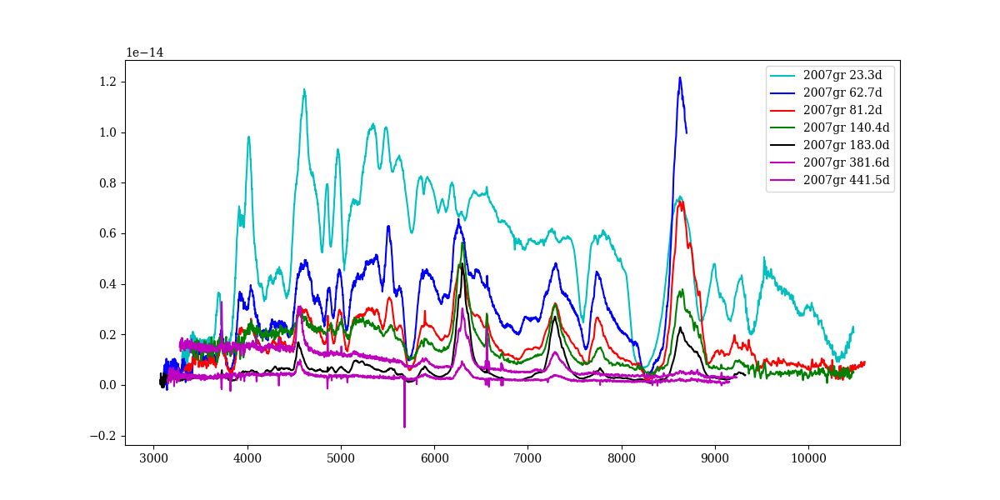

In [37]:
fig, ax = plt.subplots(figsize=(12,6))

#phase = '48.0d'
#spec = specinfo_2007gr[phase]['spec']
#ax.plot(spec[:,0]/(1+z_07gr), spec[:,1], 'c', label='2007gr '+phase)


phase = '23.3d'
spec = specinfo_2007gr[phase]['spec']
ax.plot(spec[:,0]/(1+z_07gr), spec[:,1]*5e-16, 'c', label='2007gr '+phase)

#'66.0d'
#spec = specinfo_2007gr[phase]['spec']
#ax.plot(spec[:,0]/(1+z_07gr), spec[:,1]*1e-15, 'y', label='2007gr '+phase)

phase = '62.7d'
spec = specinfo_2007gr[phase]['spec']
ax.plot(spec[:,0]/(1+z_07gr), spec[:,1]*1e-15, 'b', label='2007gr '+phase)

phase = '81.2d'
spec = specinfo_2007gr[phase]['spec']
ax.plot(spec[:,0]/(1+z_07gr), spec[:,1]*1e-15, 'r', label='2007gr '+phase)


phase = '140.4d'
spec = specinfo_2007gr[phase]['spec']
ax.plot(spec[:,0]/(1+z_07gr), spec[:,1]*1e-15, 'g', label='2007gr '+phase)


phase = '183.0d'
spec = specinfo_2007gr[phase]['spec']
ax.plot(spec[:,0]/(1+z_07gr), spec[:,1]*1e-15, 'k', label='2007gr '+phase)


phase = '381.6d'
spec = specinfo_2007gr[phase]['spec']
ax.plot(spec[:,0]/(1+z_07gr), spec[:,1]*2e-14, 'm', label='2007gr '+phase)


phase = '441.5d'
spec = specinfo_2007gr[phase]['spec']
ax.plot(spec[:,0]/(1+z_07gr), spec[:,1]*2e-14, 'm', label='2007gr '+phase)

ax.legend(loc=0)

### 1993J

### Carnegie Supernova Project-II: Near-infrared Spectroscopy of Stripped-envelope Core-collapse Supernovae


See /Users/chenping/SNeData/CSP/Shahbandeh2022


<IPython.core.display.Javascript object>


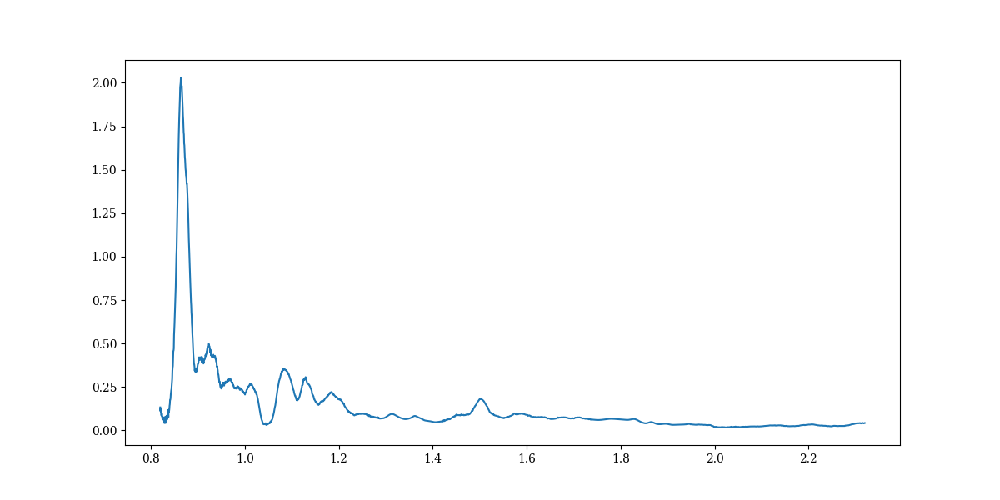

In [38]:
tpl_spec = np.loadtxt('/Users/chenping/SNeData/CSP/Shahbandeh2022/shahbandeh_template_he_poor.txt')

specphase = 80

spec = tpl_spec[tpl_spec[:,0]==specphase]

fig, ax = plt.subplots(figsize=(12,6))
ax.plot(spec[:,1], spec[:,2]) 